In [1]:
%load_ext autoreload
%autoreload 2
import numpy as np
import matplotlib.pyplot as plt
import sys
import coffea.util as util
import time
import json
import os
import copy
from hist import Hist
sys.path.append("../../analysisTools/")
import plotTools as ptools
import utils
import mplhep as hep
import utils
hep.style.use("CMS")
plt.rcParams['font.size'] = 16.0
from matplotlib.colors import Normalize, LogNorm
from copy import deepcopy
from tqdm import tqdm
from matplotlib.lines import Line2D
from matplotlib.patches import Patch

In [2]:
class histContainer:
    def __init__(self,path,noMeta=False,bkg=False):
        if noMeta:
            self.histos, self.metadata = util.load(path), None
        else:
            self.histos, self.metadata = util.load(path)
        self.hnames = list(self.histos.keys())
        if bkg:
            self.catSamps,self.catNames = utils.bkg_categories(self.histos['cutflow'])
            self.cats = list(self.catSamps.keys())
    def load(self,hname):
        return self.histos[hname]
    def load(self,hname):
        return self.histos[hname]
    def names(self,spec=None):
        if spec is not None:
            print("\n".join([h for h in self.hnames if spec in h]))
        else:
            print("\n".join(self.hnames))
            
def getPresentSamples(h,possibleSamples):
    for a in h.axes:
        if a.name=='samp':
            ax = a
            break
    nbins = len(ax.centers)
    avail = [ax.bin(i) for i in range(nbins)]
    return [p for p in possibleSamples if p in avail]

def make_label(row):
    m1 = int(row['m1'])
    delta = int(100*row['delta'])
    ct = int(row['ctau'])
    label = f"{delta}%, {m1} GeV, {ct} mm"
    return label

In [3]:
def plot_samples_sigBkg(loader_sig,loader_bkg,hname,selection,samples,labels,outName,outD,
                 xlabel=None,ylabel=None,title=None,xlim=None,ylim=None,
                 ncol_leg=1,figsize=None,logy=False,logx=False,rebin=1j,
                 save=True,show=False,density=False,yerr=True,histtype='errorbar',legend_loc='best'):
    if not figsize:
        figsize=(8,6)
    plt.figure(figsize=figsize)
    # load signal histograms
    h_sig = loader_sig.load(hname)[selection]
    histos_sig = [h_sig[{"samp":s}][::rebin] for s in samples]
    labels_sig = labels
    # load bkg histograms
    h_bkg = loader_bkg.load(hname)[selection]
    labels_bkg = loader_bkg.cats
    histos_bkg = []
    colors_bkg = []
    for cat in labels_bkg:
        trueSel = getPresentSamples(h_bkg,loader_bkg.catSamps[cat])
        histos_bkg.append(h_bkg[{"samp":trueSel}][{"samp":sum}][::rebin])
        colors_bkg.append(ptools.bkg_cmap[cat])
    # plot histograms
    colors_sig = ['k','g','b','c']
    hep.histplot(histos_bkg,label=labels_bkg,density=density,yerr=yerr,stack=True,histtype='fill',color=colors_bkg)
    hep.histplot(histos_sig,label=labels_sig,density=density,yerr=yerr,color=colors_sig,histtype=histtype,lw=2)
    if xlabel:
        plt.xlabel(xlabel)
    if ylabel:
        plt.ylabel(ylabel)
    else:
        if density:
            plt.ylabel("A.U.")
        else:
            plt.ylabel("Events")
    if xlim:
        plt.xlim(xlim)
    if ylim:
        plt.ylim(ylim)
    if title:
        plt.title(title)
    if logy:
        plt.yscale('log')
    if logx:
        plt.xscale('log')
    plt.legend(ncol=ncol_leg,fontsize=12,loc=legend_loc)
    #hep.cms.label("Simulation", data=False, year=2018)
    plt.tight_layout()
    if save:
        os.makedirs(outD,exist_ok=True)
        if density:
            plt.savefig(f"{outD}/{outName}_density.pdf")
        else:
            plt.savefig(f"{outD}/{outName}.pdf")
    if not show:
        plt.close()

In [4]:
from matplotlib.lines import Line2D
def make_cdf_summary_sigVsBkg(dfs,loader_sig,loader_bkg,hname_sig,hname_bkg,selection,outName,outD,right=True,
                 xlabel=None,ylabel=None,title=None,xlim=None,ylim=None,
                 ncol_leg=1,figsize=None,logy=False,logx=False,alpha=1,
                 save=True,show=False,legend_loc='best',category=False):
    if not figsize:
        figsize=(8,6)
    #fig,axes = plt.subplots(2,1,figsize=figsize,height_ratios=[3,1],sharex=True)
    fig,axes = plt.subplots(1,1,figsize=figsize)
    hsig = loader_sig.load(hname_sig)[selection]
    hbkg = loader_bkg.load(hname_bkg)[selection]
    for s in dfs.name:
        hsamp = hsig[{"samp":s}]
        if xlim:
            edges = xlim
        else:
            edges = hsamp.axes[0].edges[:-1] if right else hsamp.axes[0].edges[1:]
        x,eff_real = ptools.makeCDF(hsamp,edges[0],edges[-1],right=right,category=category)
        plt.plot(x,eff_real,color='green',alpha=0.5,lw=2)
    handles = [Line2D([],[],lw=2,color='green',label="Signals")]
    for bkg_cat in loader_bkg.cats:
        trueSel = getPresentSamples(hbkg,loader_bkg.catSamps[bkg_cat])
        hsamp = hbkg[{"samp":trueSel}][{"samp":sum}]
        x,eff_fake = ptools.makeCDF(hsamp,edges[0],edges[-1],right=right,category=category)
        h, = plt.plot(x,eff_fake,alpha=1,lw=2,label=bkg_cat,color=ptools.bkg_cmap[bkg_cat])
        handles.append(h)
    plt.legend(handles=handles,loc=legend_loc,ncol=ncol_leg)
    if xlabel:
        plt.xlabel(xlabel)
    if right:
        plt.ylabel("Cumulative Distribution (Right)")
    else:
        plt.ylabel("Cumulative Distribution (Left)")
    if ylim:
        plt.ylim(ylim)
    if title:
        plt.title(title)
    if logy:
        plt.yscale('log')
    if logx:
        plt.xscale('log')
    plt.grid()
    plt.tight_layout()
    if save:
        os.makedirs(outD,exist_ok=True)
        plt.savefig(f"{outD}/{outName}.pdf")
    if not show:
        plt.close()

# Selected vertex plots

In [5]:
hcs = histContainer("skimmed_signal_histos_vtxStudy.coffea")
hcb = histContainer("skimmed_bkg_histos_vtxStudy.coffea",bkg=True)
dfs = utils.get_dict_fromCutflow(hcs.load('cutflow'))
dfs['legend'] = dfs.apply(make_label,axis=1)
selected_signals = ["sig_2018_Mchi-10p5_dMchi-1p0_ctau-1",
                    "sig_2018_Mchi-11p0_dMchi-2p0_ctau-100",
                    "sig_2018_Mchi-52p5_dMchi-5p0_ctau-10",
                    "sig_2018_Mchi-77p0_dMchi-14p0_ctau-100"]
selected_labels = [dfs[dfs.name==s].legend.item() for s in selected_signals]

In [6]:
cuts = ['cut0','cut1','cut2','cut3','cut4','cut5','cut6']
cutDesc = hcs.load("cutDesc")
descriptions = ['All vertices',"Basic Selection","v1 Selection","v2 Selection","v3 Selection","v4 Selection","v5 Selection"]

/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not plac

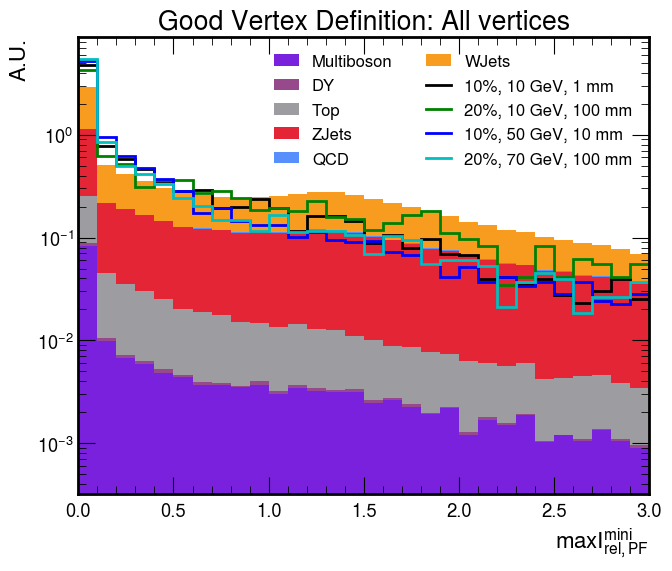

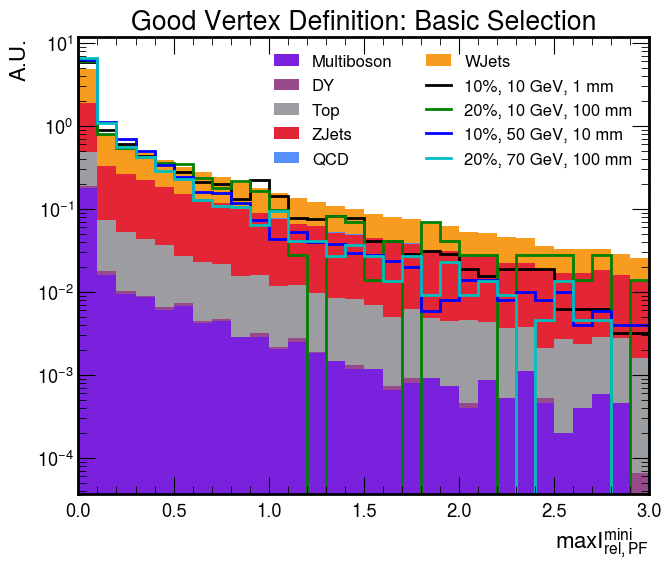

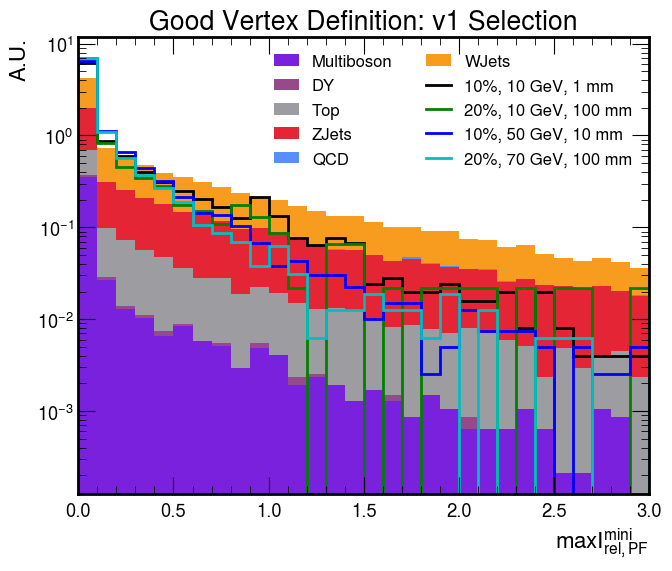

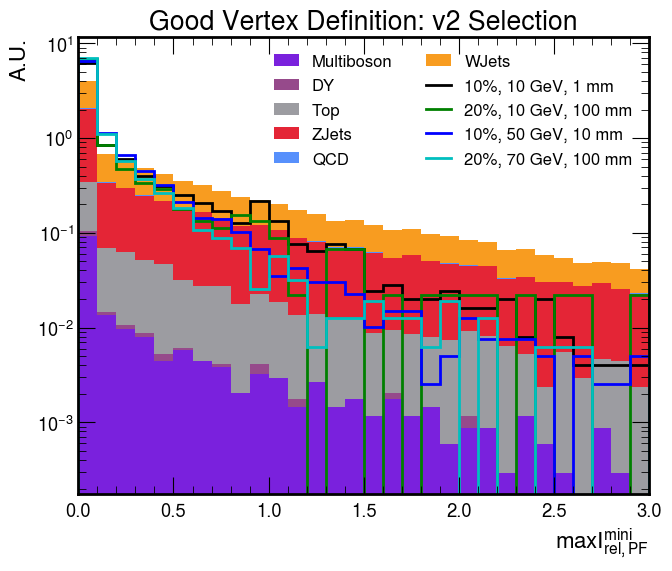

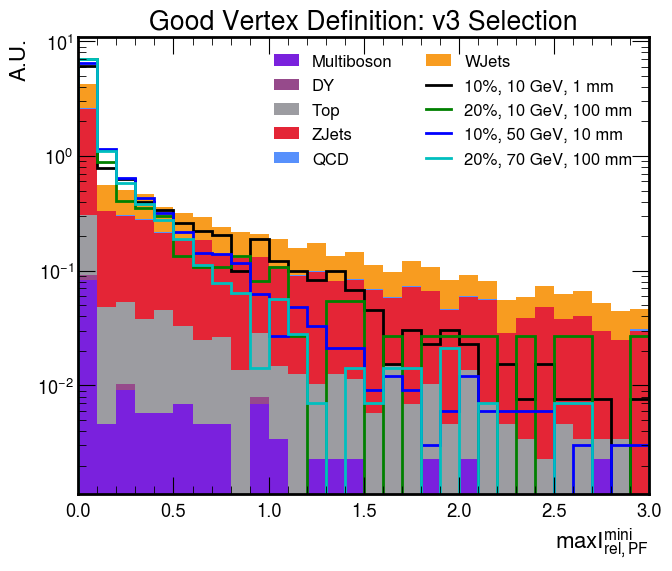

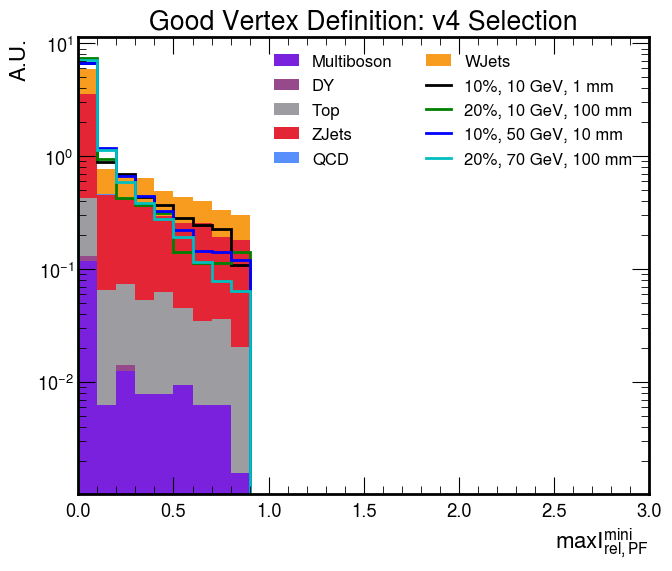

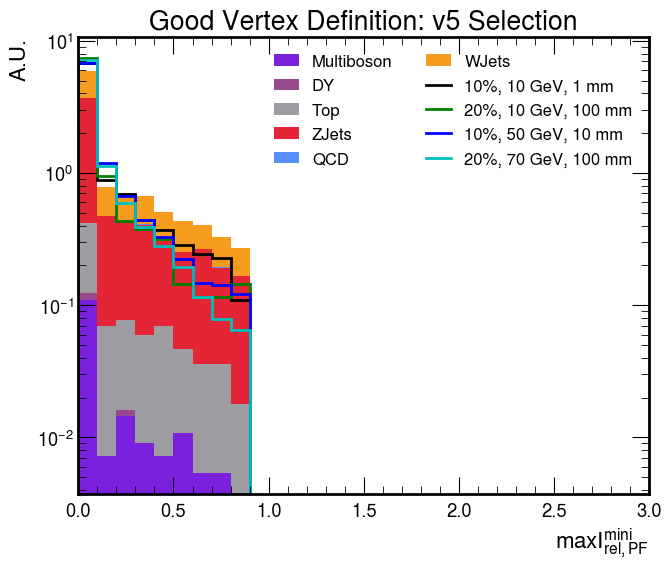

In [12]:
for i,cut in enumerate(cuts):
    CUT = cuts[i]
    outD = f"plots_vtxStudy/plots_observables/{CUT}"
    outName = "sel_vtx_maxMiniRelIsoEleCorr_selectedSignals"+f"_{CUT}"
    selection = {"cut":CUT,"vtype":sum}
    xlabel = "$\max I_{rel,PF}^{mini}$"
    title = f"Good Vertex Definition: {descriptions[i]}"
    plot_samples_sigBkg(hcs,hcb,"sel_vtx_maxMiniRelIsoCorr",selection,selected_signals,selected_labels,outName,outD,
                 figsize=(7,6),xlim=[0,3],ncol_leg=2,xlabel=xlabel,rebin=2j,
                        save=True,show=True,logy=True,density=True,title=title,histtype='step',yerr=False)

/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not plac

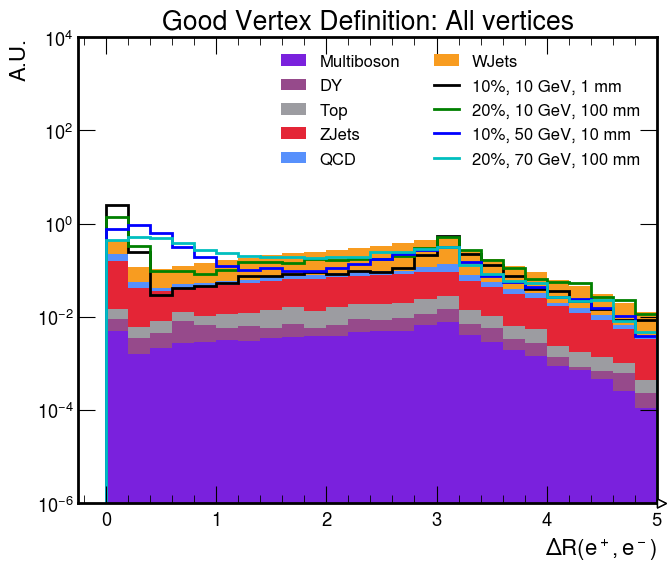

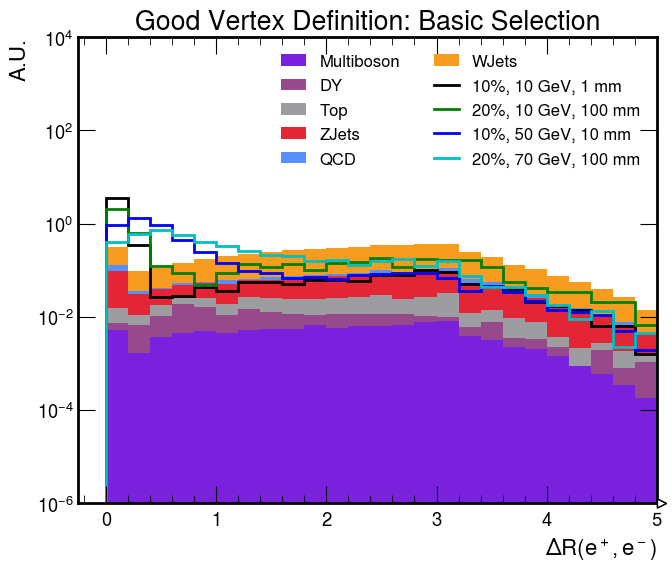

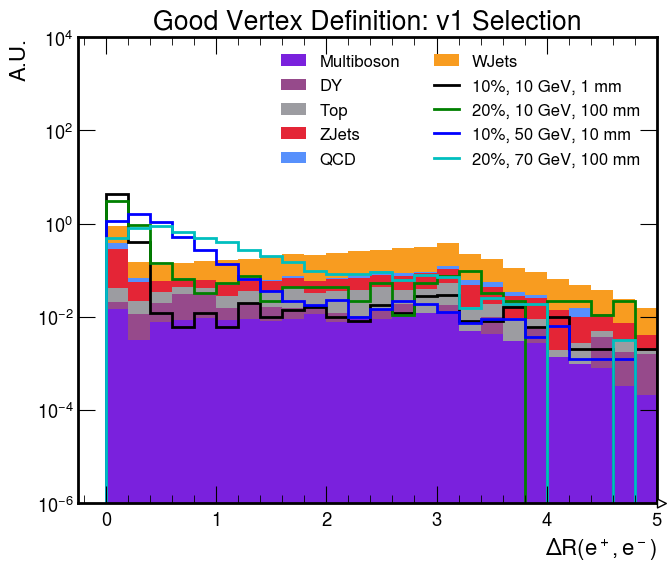

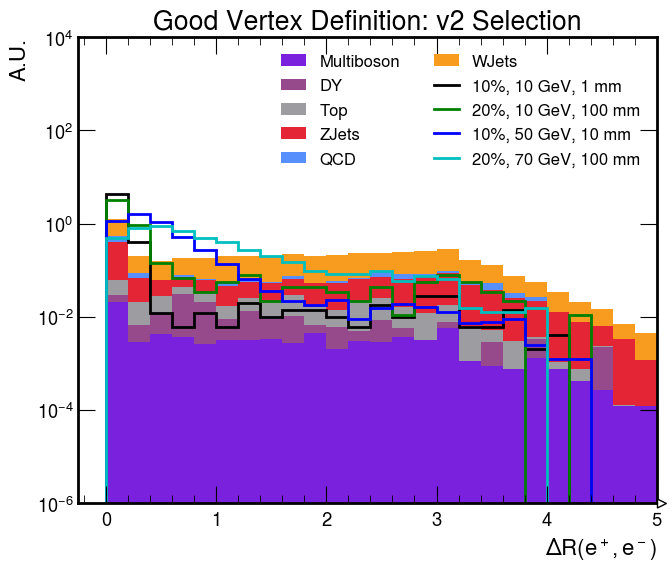

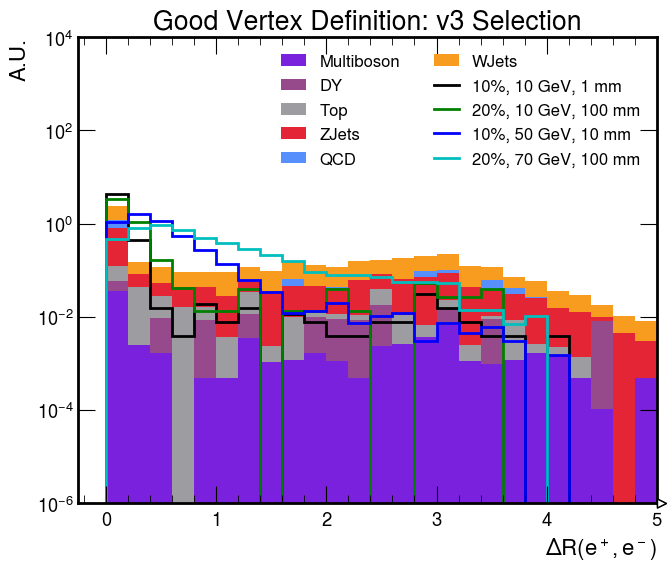

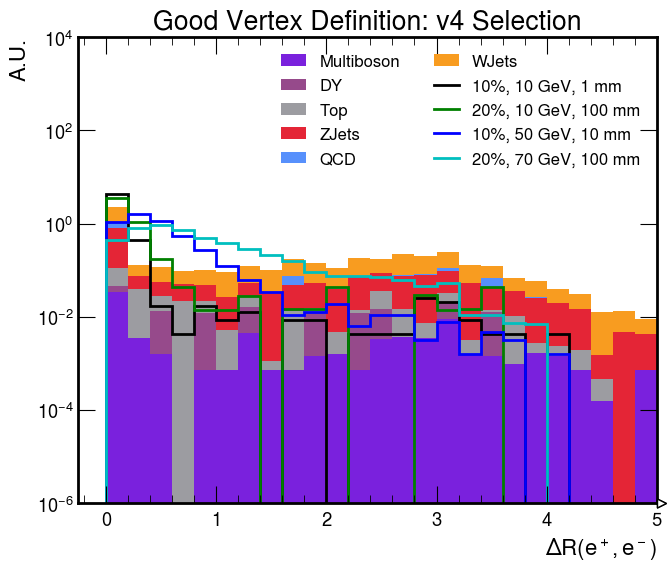

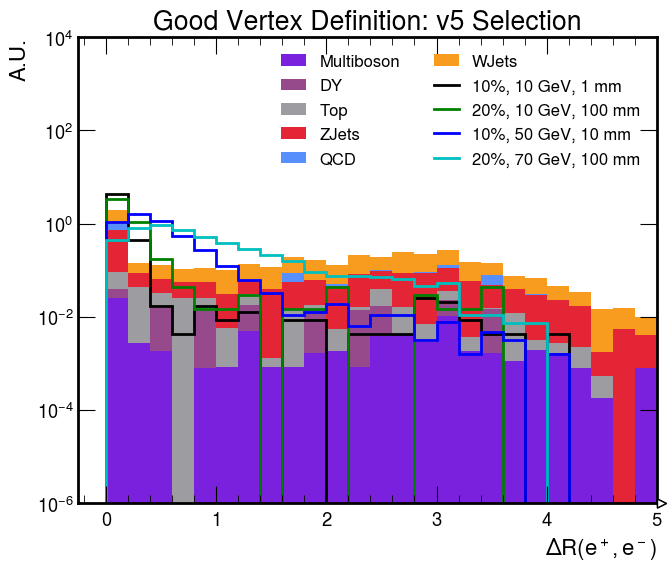

In [13]:
for i,cut in enumerate(cuts):
    CUT = cuts[i]
    outD = f"plots_vtxStudy/plots_observables/{CUT}"
    outName = "sel_vtx_dR_selectedSignals"+f"_{CUT}"
    selection = {"cut":CUT,"vtype":sum}
    xlabel = "$\Delta R(e^+,e^-)$"
    title = f"Good Vertex Definition: {descriptions[i]}"
    plot_samples_sigBkg(hcs,hcb,"sel_vtx_dR",selection,selected_signals,selected_labels,outName,outD,
                 figsize=(7,6),xlim=[None,5],ylim=[1e-6,1e4],ncol_leg=2,xlabel=xlabel,rebin=4j,
                        save=True,show=True,logy=True,density=True,title=title,histtype='step',yerr=False)

/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not plac

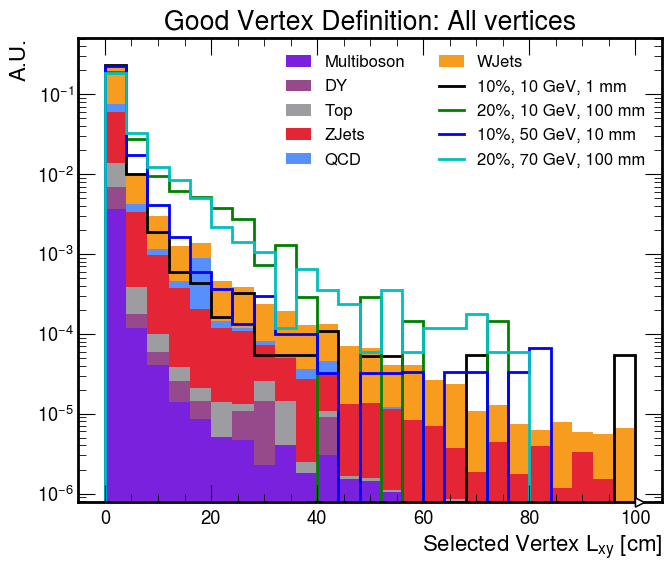

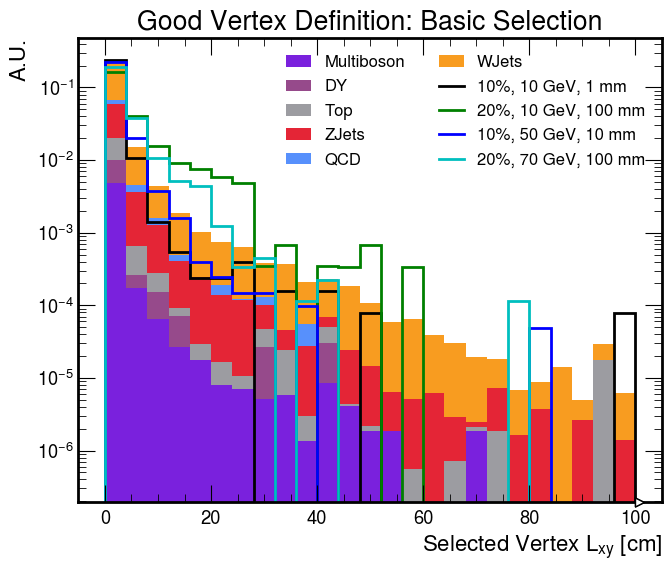

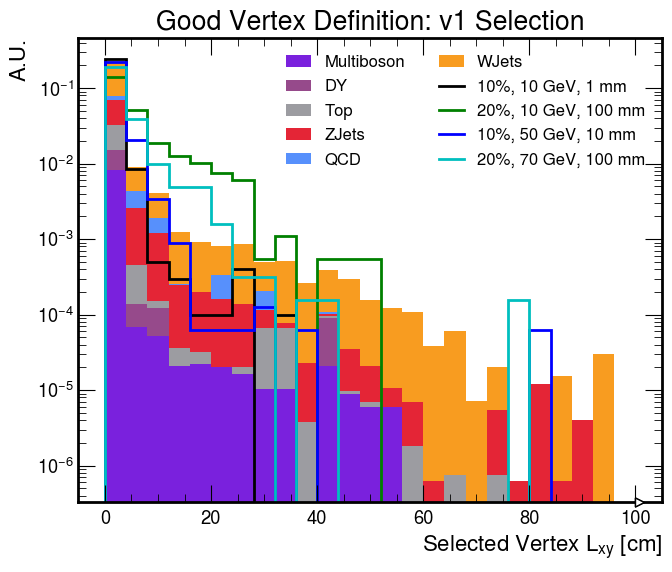

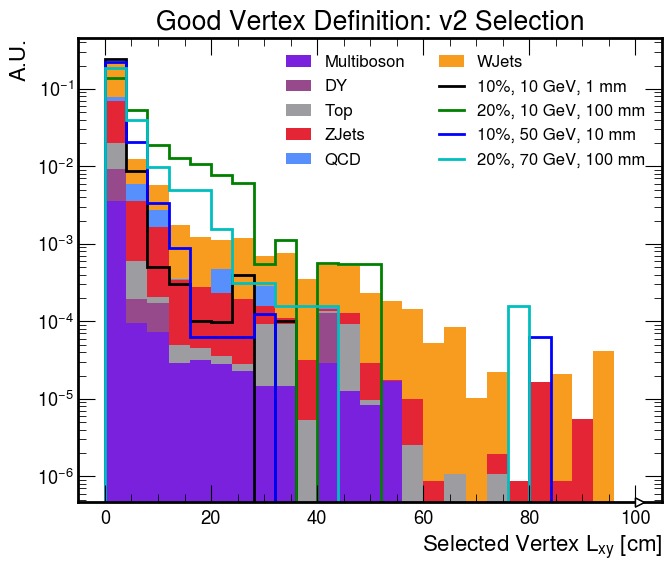

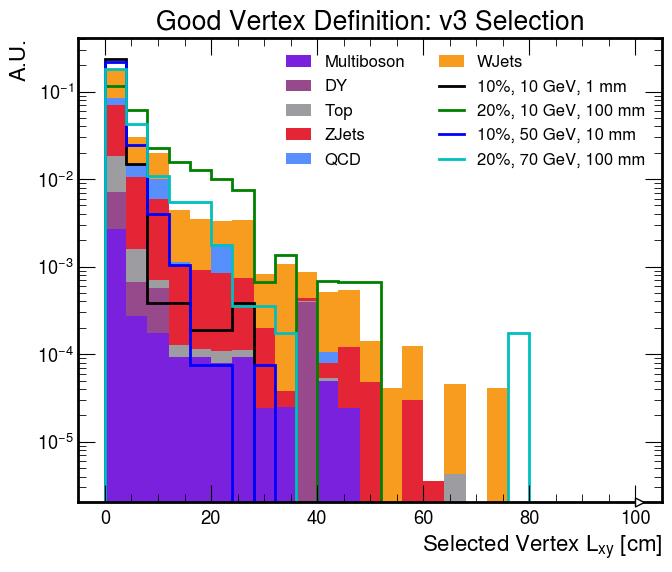

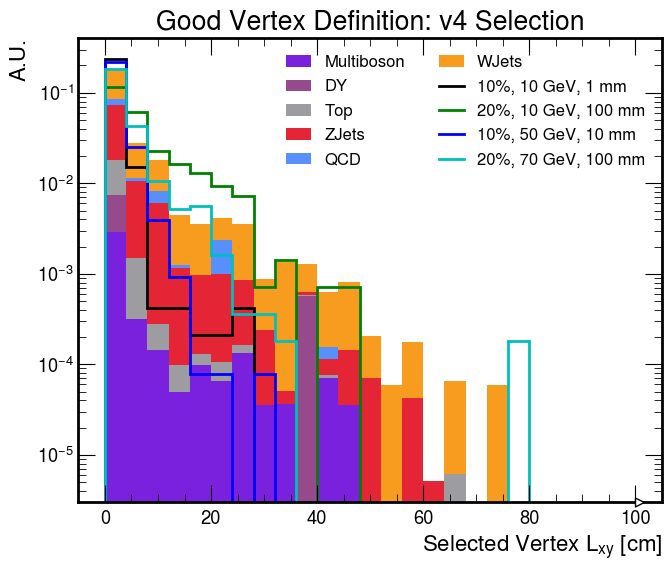

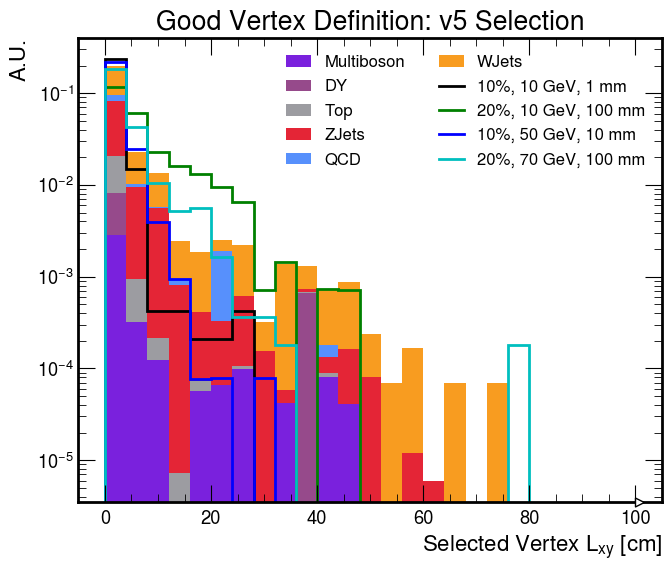

In [14]:
for i,CUT in enumerate(cuts):
    CUT = cuts[i]
    title = f"Good Vertex Definition: {descriptions[i]}"
    outD = f"plots_vtxStudy/plots_observables/{CUT}"
    outName = "sel_vtx_vxy100_selectedSignals"+f"_{CUT}"
    selection = {"cut":CUT,"vtype":sum}
    xlabel ="Selected Vertex $L_{xy}$ [cm]"
    plot_samples_sigBkg(hcs,hcb,"sel_vtx_vxy100",selection,selected_signals,selected_labels,outName,outD,
                 figsize=(7,6),xlim=[None,None],ncol_leg=2,xlabel=xlabel,rebin=4j,
                    save=True,show=True,logy=True,density=True,title=title,histtype='step',yerr=False)

/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not plac

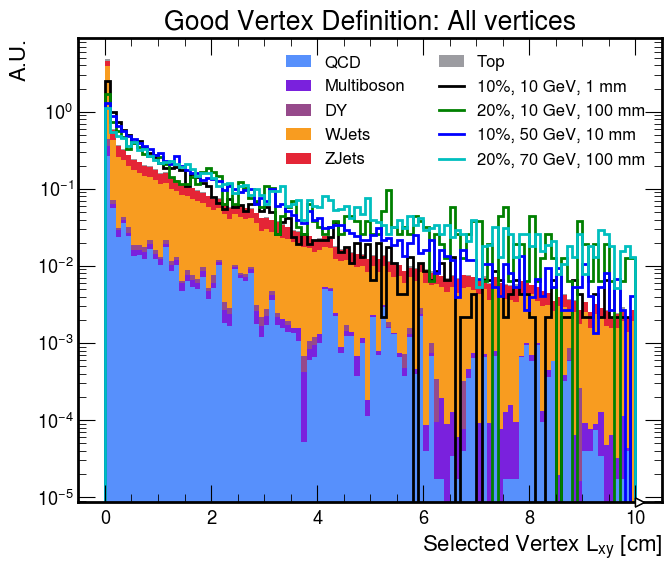

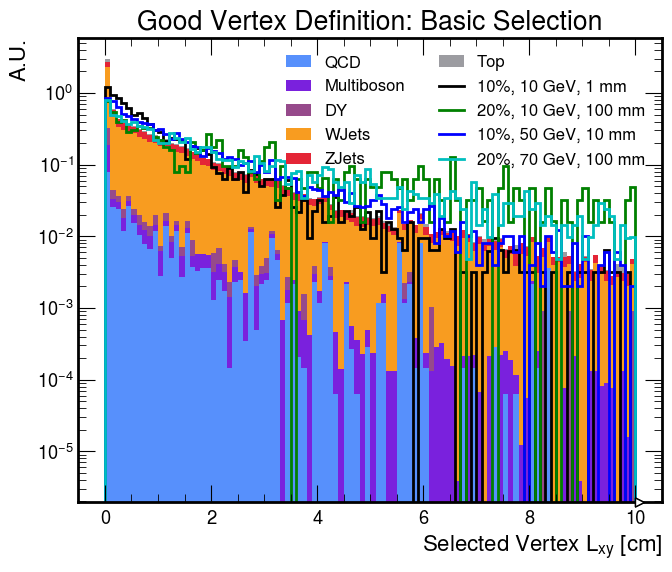

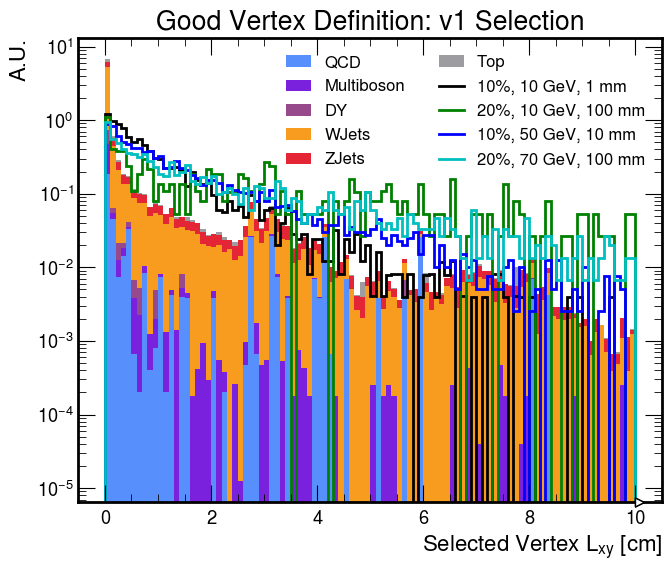

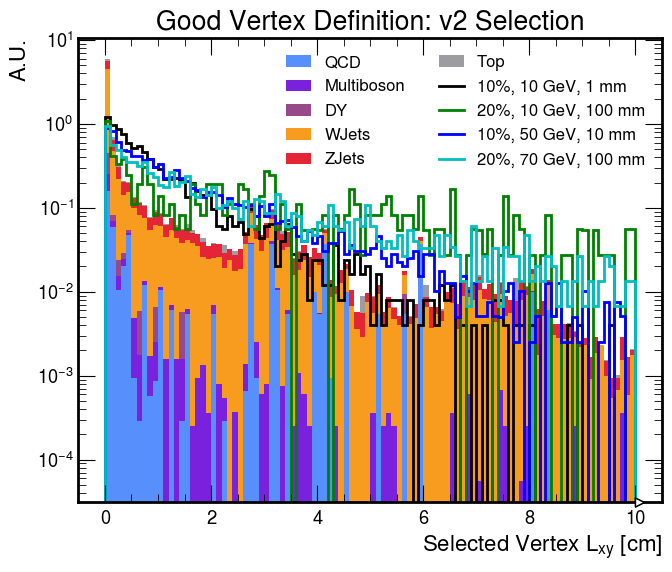

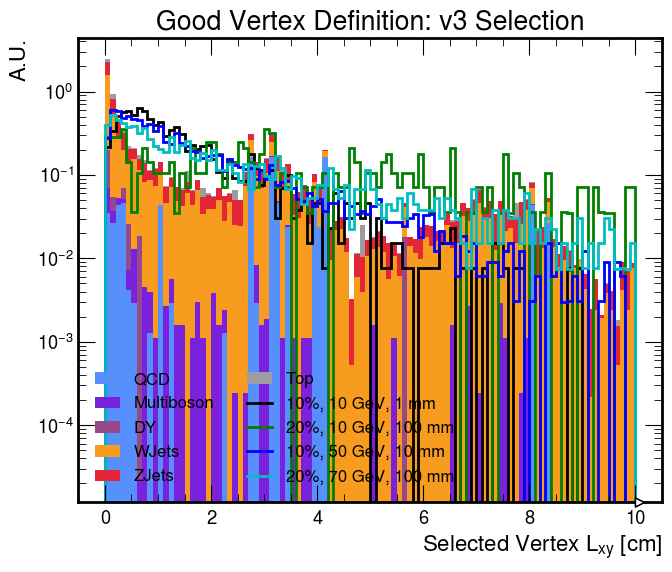

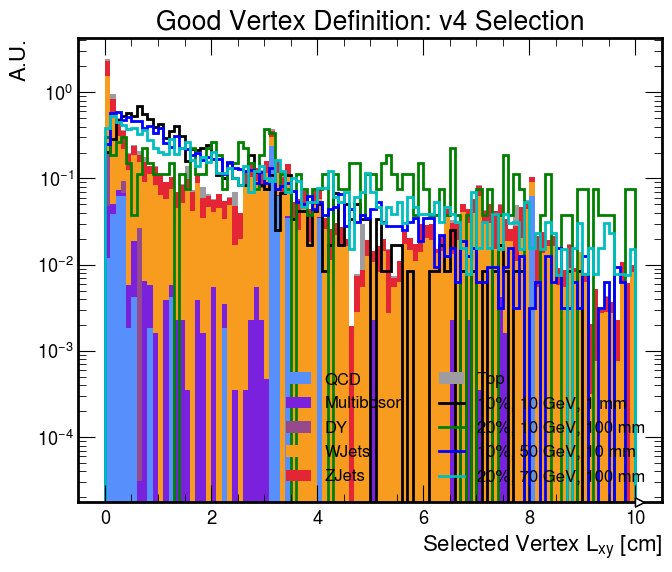

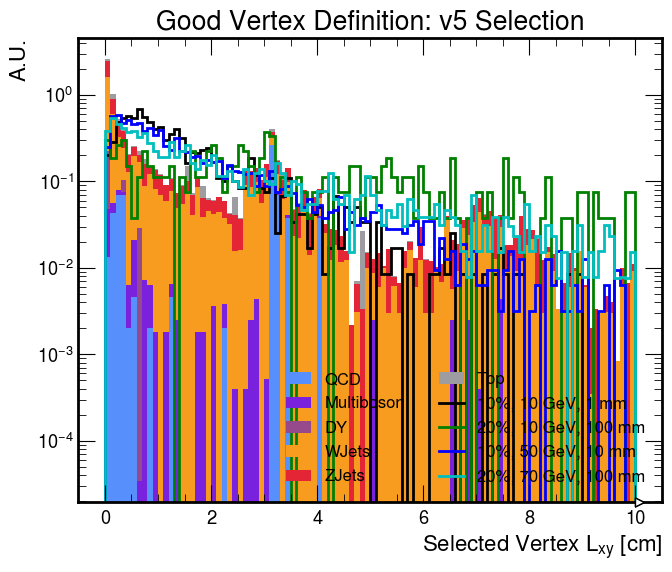

In [11]:
for i,CUT in enumerate(cuts):
    CUT = cuts[i]
    title = f"Good Vertex Definition: {descriptions[i]}"
    outD = f"plots_vtxStudy/plots_observables/{CUT}"
    outName = "sel_vtx_vxy10_selectedSignals"+f"_{CUT}"
    selection = {"cut":CUT,"vtype":sum}
    xlabel ="Selected Vertex $L_{xy}$ [cm]"
    plot_samples_sigBkg(hcs,hcb,"sel_vtx_vxy10",selection,selected_signals,selected_labels,outName,outD,
                 figsize=(7,6),xlim=[None,None],ncol_leg=2,xlabel=xlabel,rebin=1j,
                    save=True,show=True,logy=True,density=True,title=title,histtype='step',yerr=False)

/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not plac

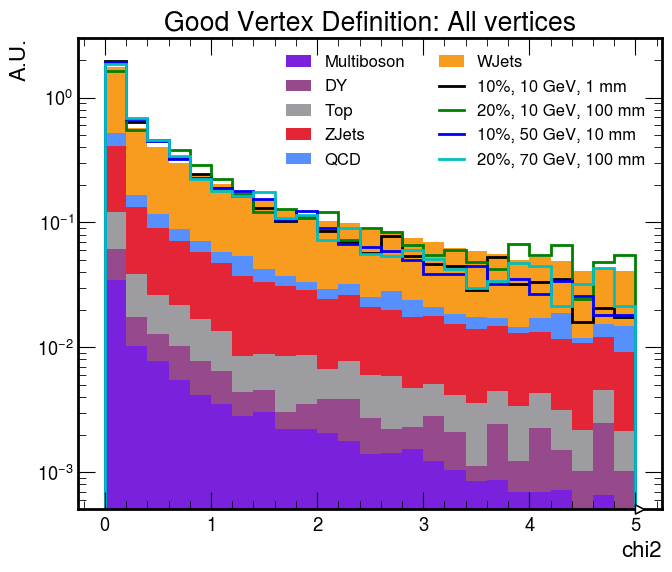

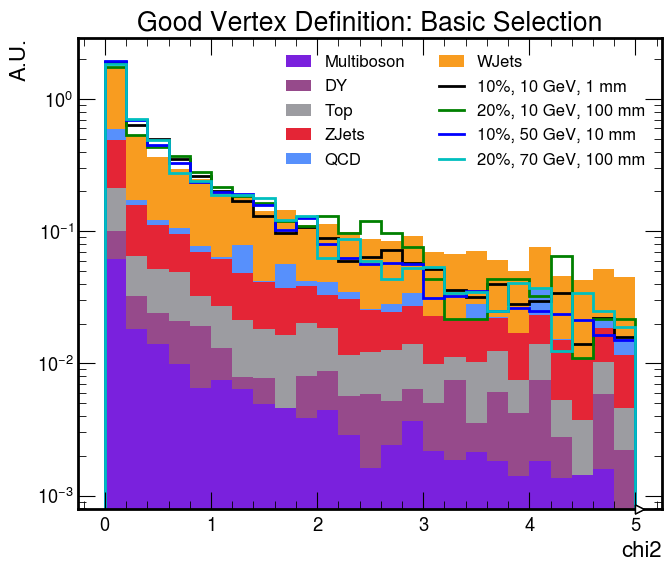

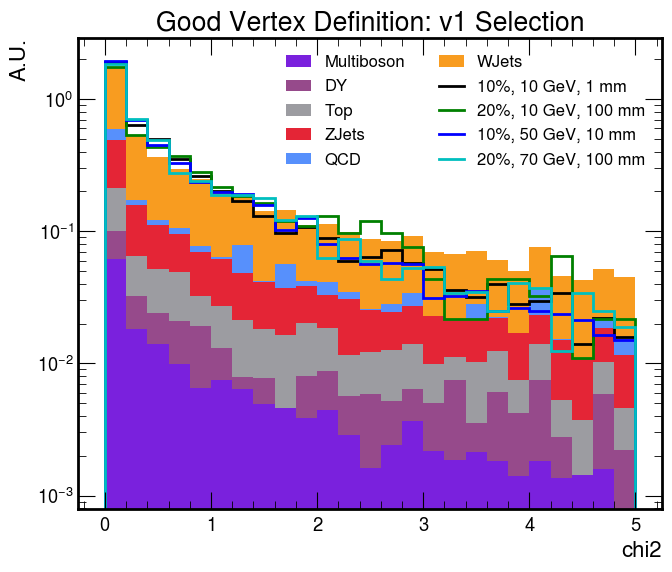

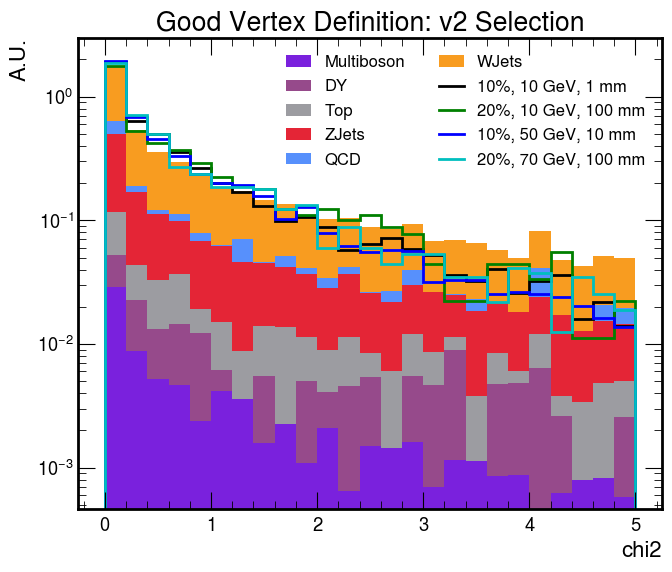

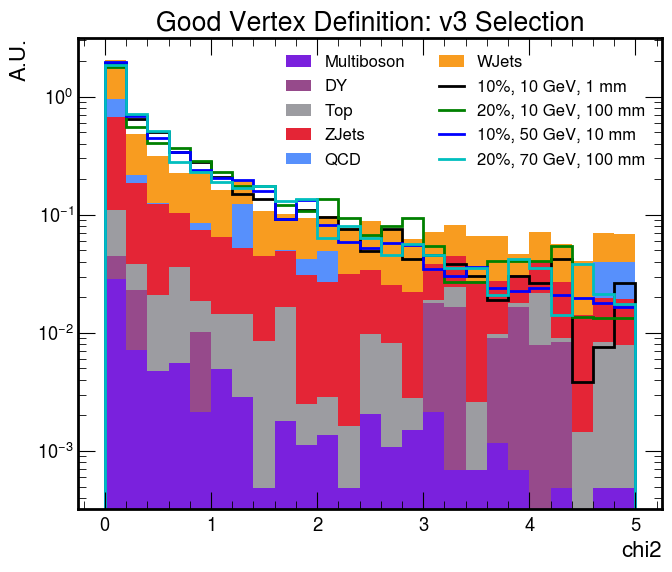

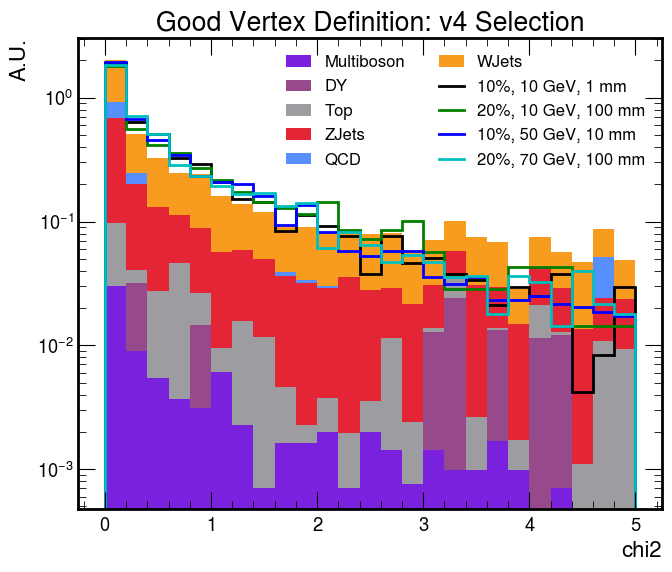

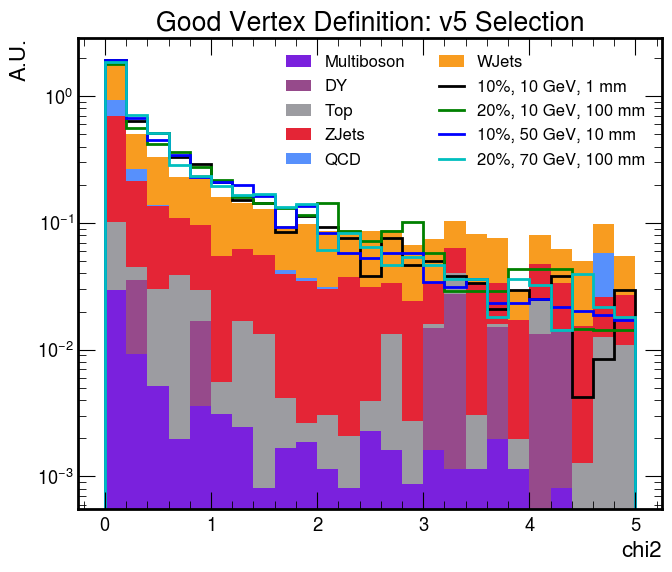

In [16]:
for i,CUT in enumerate(cuts):
    CUT = cuts[i]
    title = f"Good Vertex Definition: {descriptions[i]}"
    outD = f"plots_vtxStudy/plots_observables/{CUT}"
    outName = "sel_vtx_chi2_selectedSignals"+f"_{CUT}"
    selection = {"cut":CUT,"vtype":sum}
    xlabel ="Selected Vertex $\chi^2/df$"
    plot_samples_sigBkg(hcs,hcb,"sel_vtx_chi2",selection,selected_signals,selected_labels,outName,outD,
                 figsize=(7,6),xlim=[None,None],ncol_leg=2,rebin=4j,
                    save=True,show=True,logy=True,density=True,title=title,histtype='step',yerr=False)

/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not plac

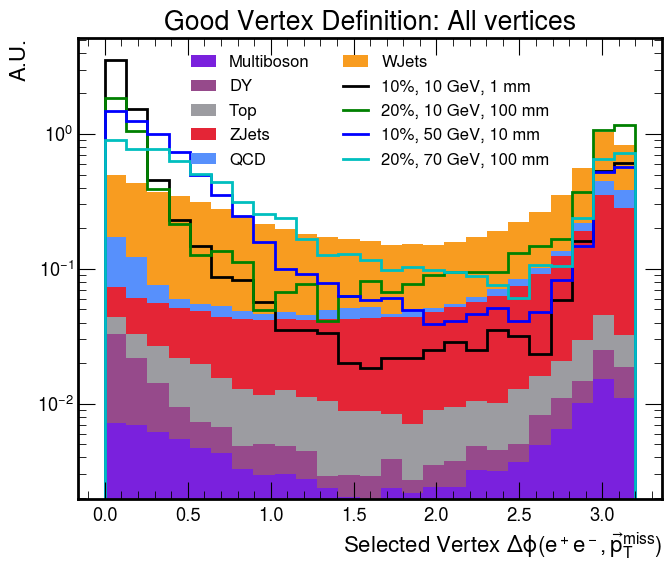

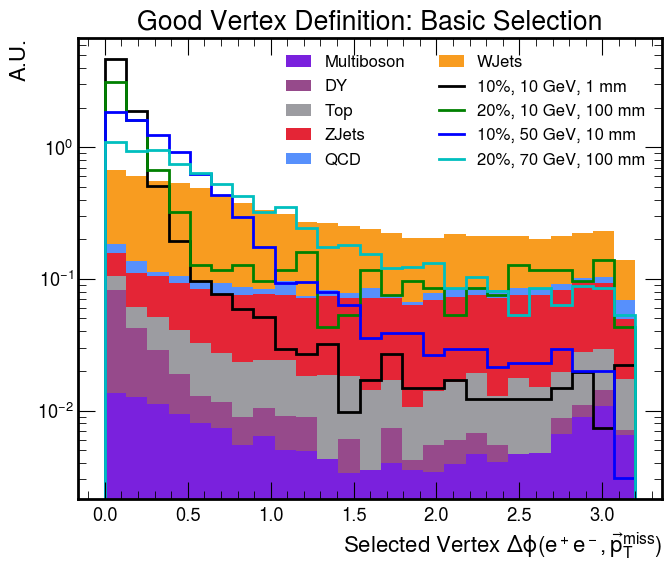

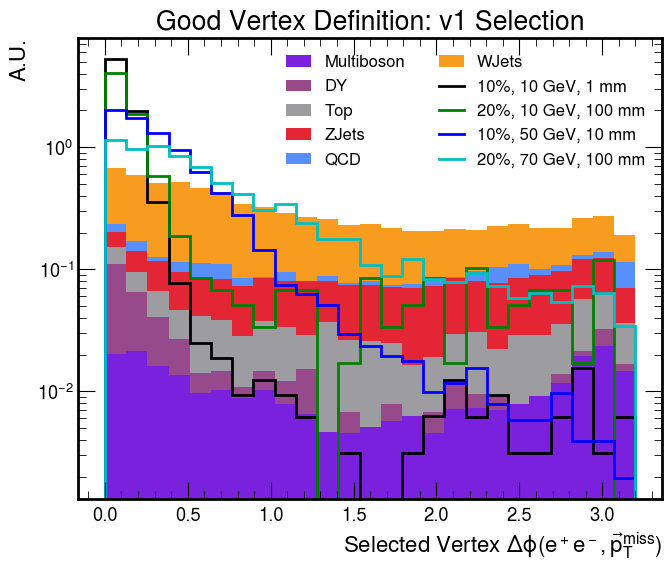

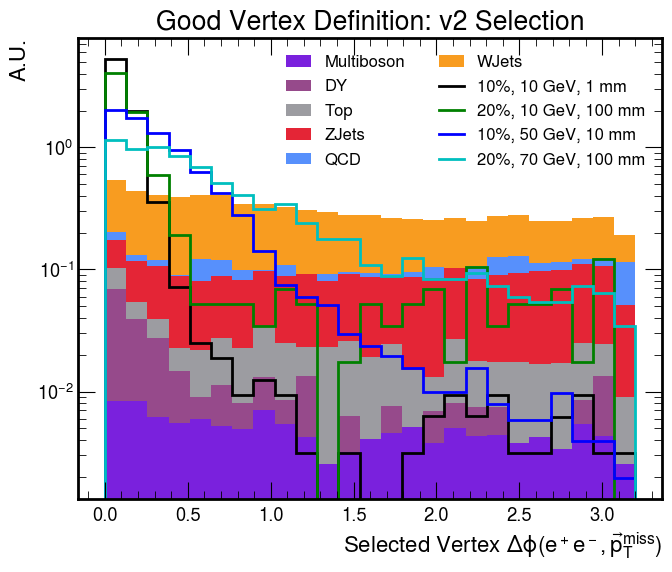

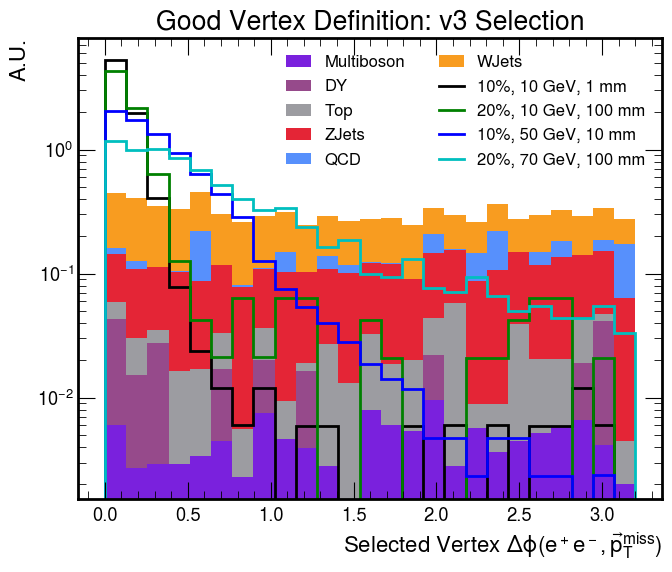

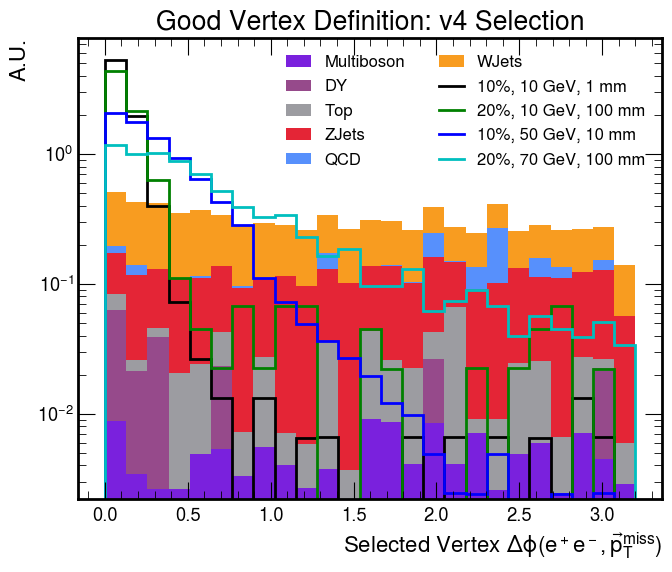

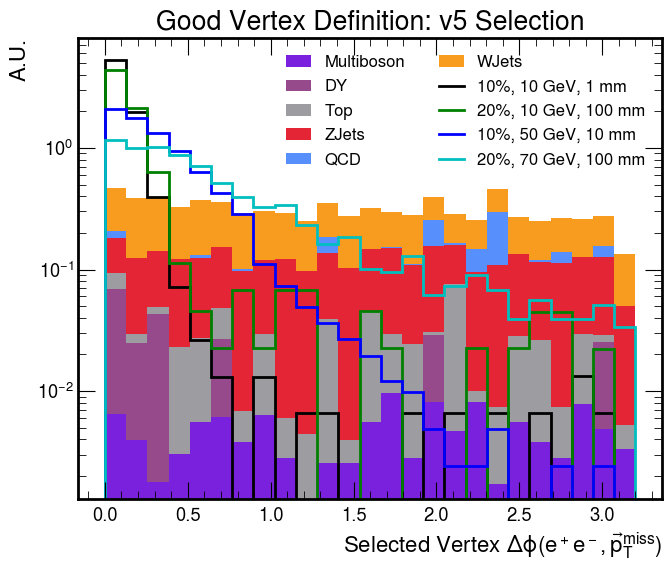

In [17]:
for i,CUT in enumerate(cuts):
    CUT = cuts[i]
    title = f"Good Vertex Definition: {descriptions[i]}"
    outD = f"plots_vtxStudy/plots_observables/{CUT}"
    outName = "sel_vtx_METdPhi_selectedSignals"+f"_{CUT}"
    selection = {"cut":CUT,"vtype":sum}
    xlabel = r"Selected Vertex $\Delta\phi(e^+e^-,\vec{p}_T^\mathrm{miss})$"
    plot_samples_sigBkg(hcs,hcb,"sel_vtx_METdPhi",selection,selected_signals,selected_labels,outName,outD,
                 figsize=(7,6),xlim=[None,None],ncol_leg=2,xlabel=xlabel,rebin=4j,
                    save=True,show=True,logy=True,density=True,title=title,histtype='step',yerr=False)

/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not plac

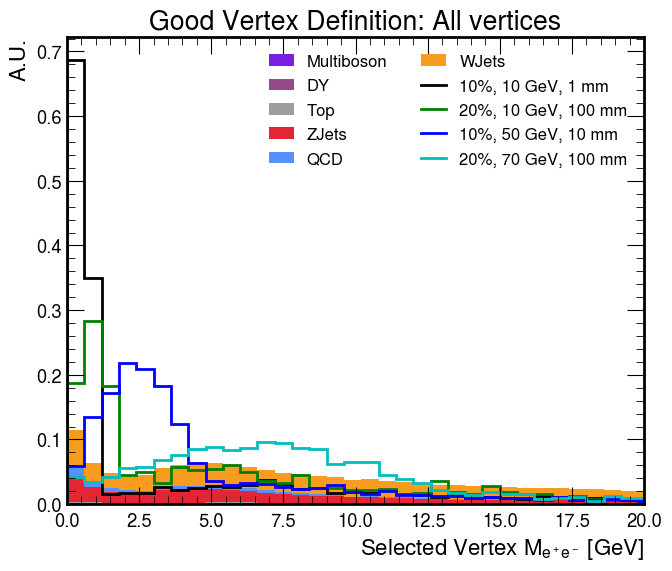

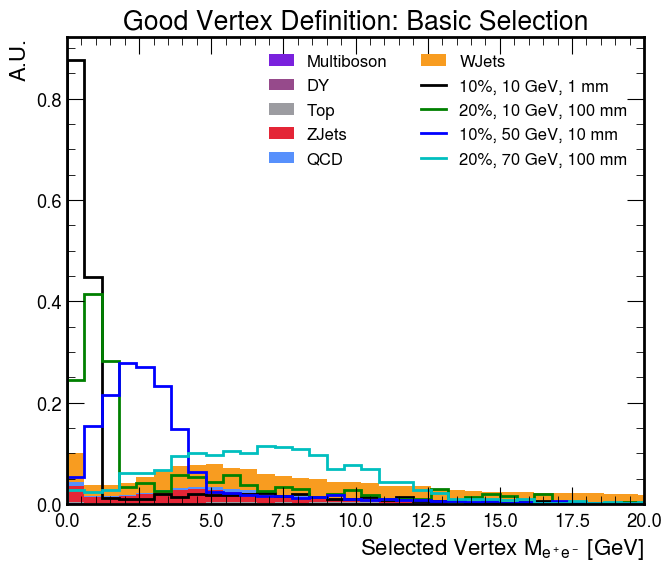

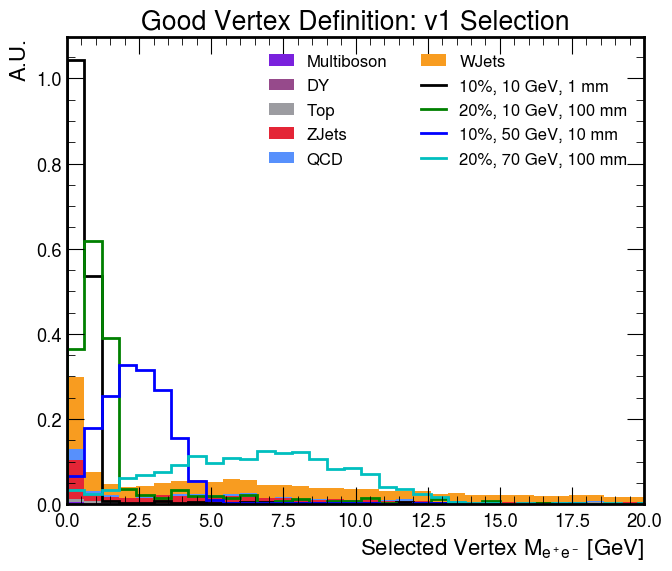

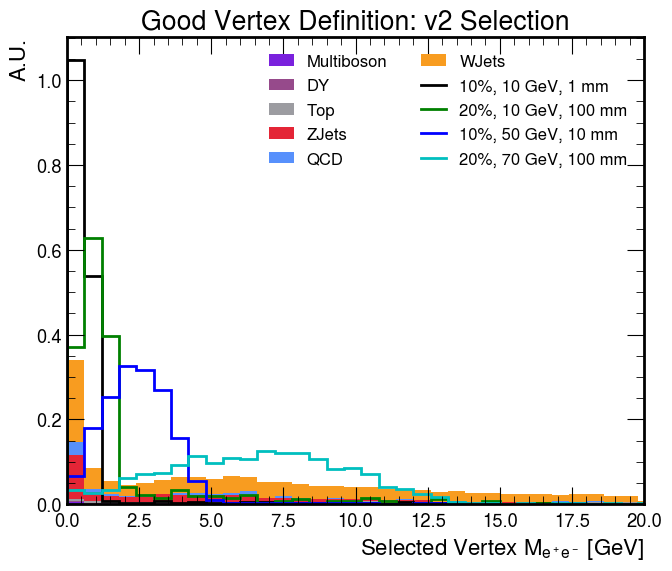

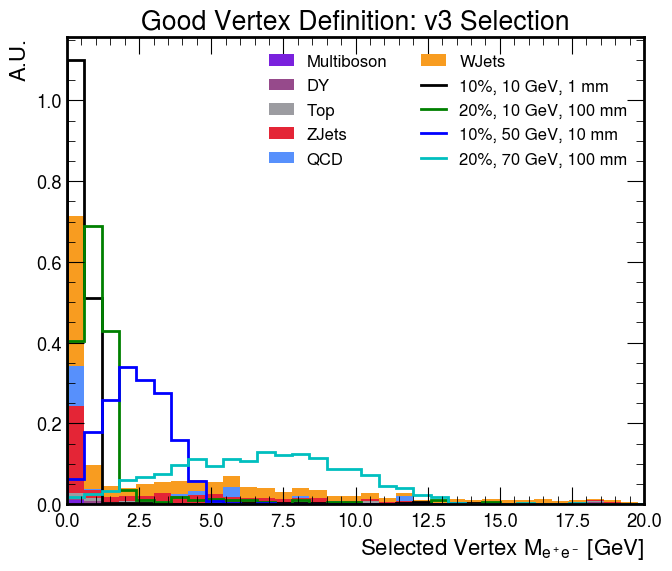

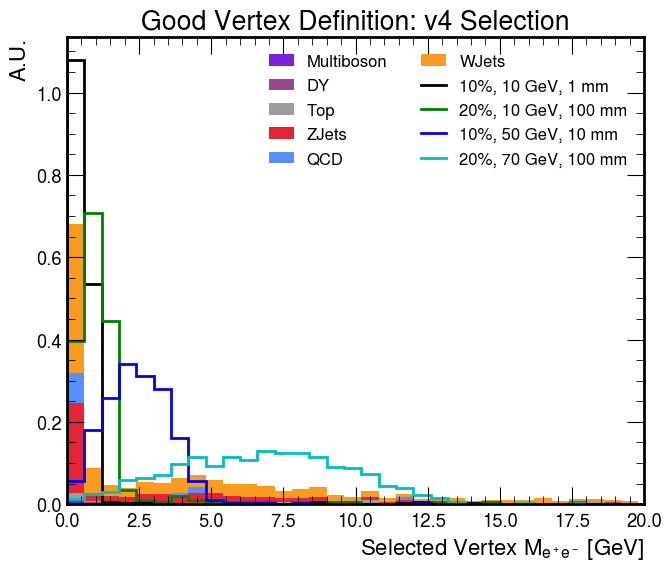

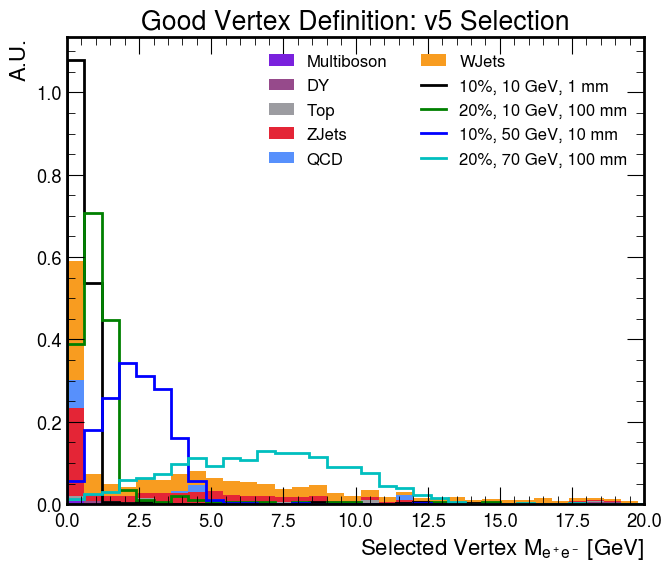

In [18]:
for i,CUT in enumerate(cuts):
    CUT = cuts[i]
    title = f"Good Vertex Definition: {descriptions[i]}"
    outD = f"plots_vtxStudy/plots_observables/{CUT}"
    outName = "sel_vtx_mass_selectedSignals"+f"_{CUT}"
    selection = {"cut":CUT,"vtype":sum}
    xlabel = r"Selected Vertex $M_{e^+e^-}$ [GeV]"
    plot_samples_sigBkg(hcs,hcb,"sel_vtx_mass",selection,selected_signals,selected_labels,outName,outD,
                 figsize=(7,6),xlim=[0,20],ncol_leg=2,xlabel=xlabel,rebin=2j,
                    save=True,show=True,logy=False,density=True,title=title,histtype='step',yerr=False)

/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not plac

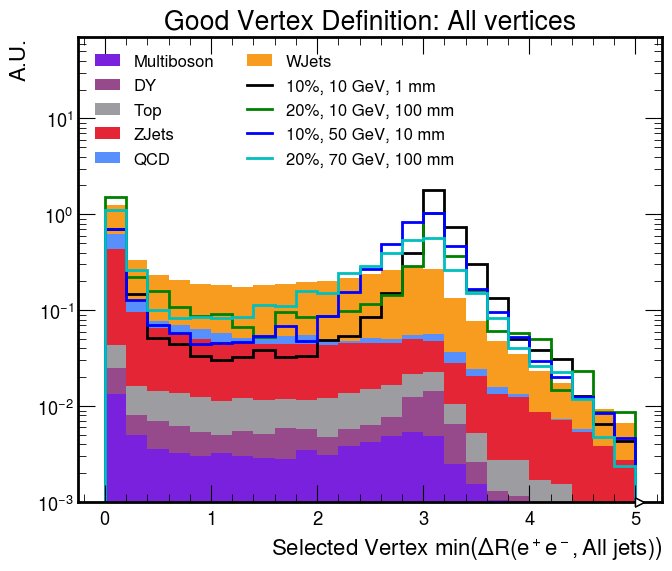

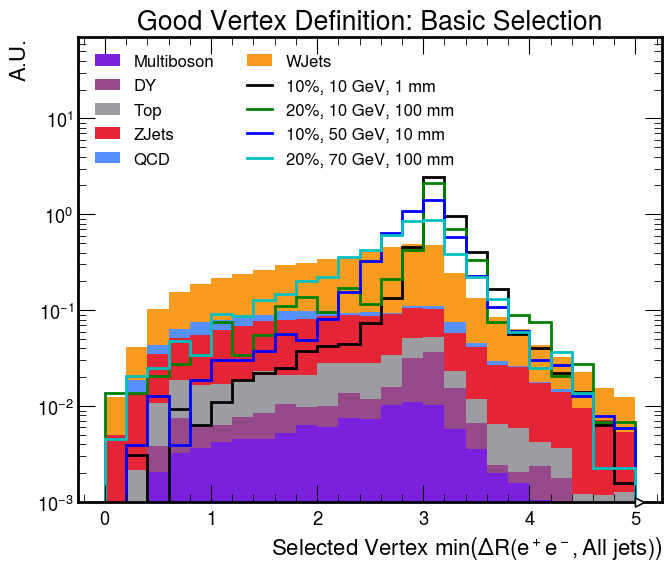

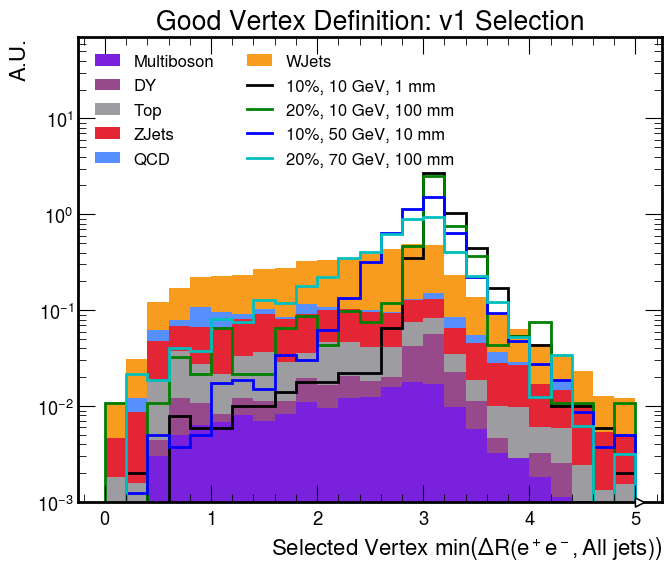

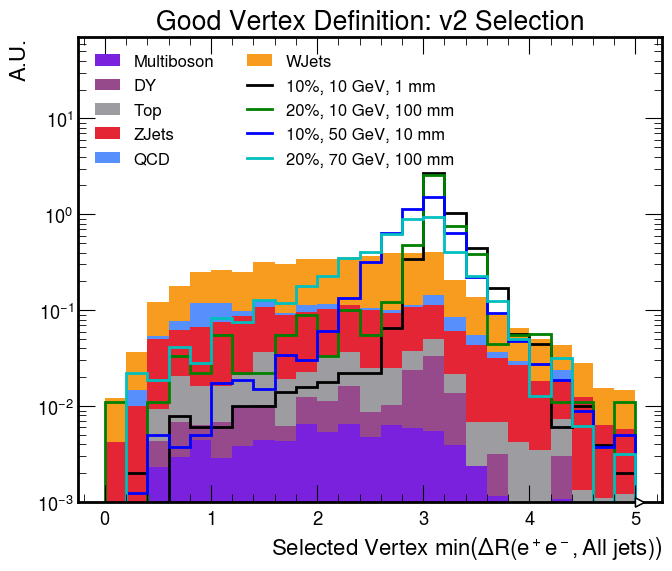

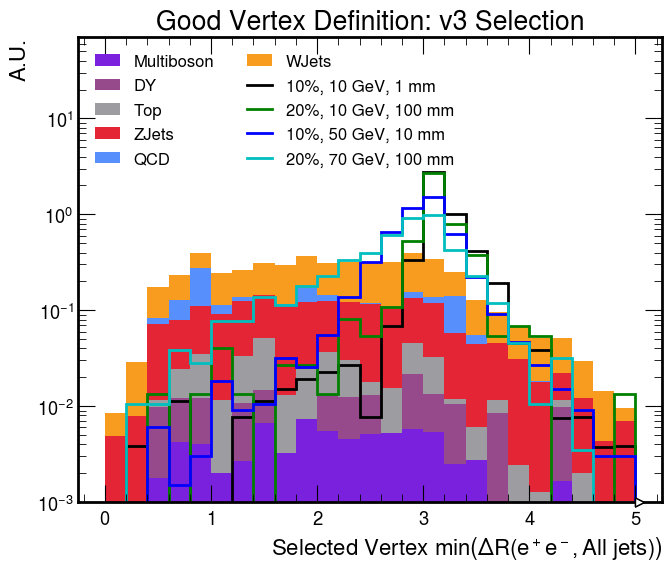

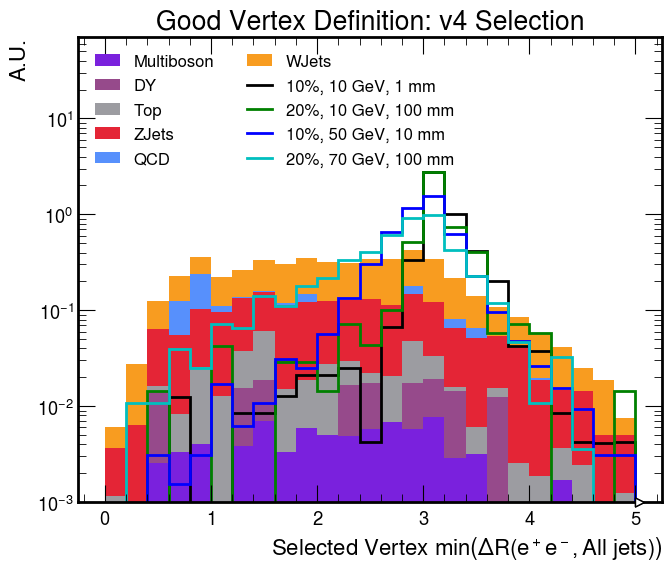

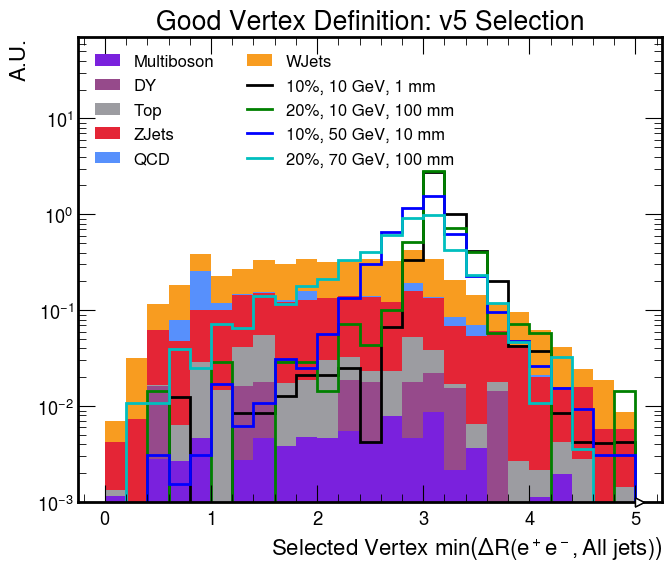

In [19]:
for i,CUT in enumerate(cuts):
    CUT = cuts[i]
    title = f"Good Vertex Definition: {descriptions[i]}"
    outD = f"plots_vtxStudy/plots_observables/{CUT}"
    outName = "sel_vtx_mindRj_selectedSignals"+f"_{CUT}"
    selection = {"cut":CUT,"vtype":sum}
    xlabel = r"Selected Vertex $\min\left(\Delta R(e^+e^-,\text{All jets})\right)$"
    plot_samples_sigBkg(hcs,hcb,"sel_vtx_mindRj",selection,selected_signals,selected_labels,outName,outD,
                 figsize=(7,6),xlim=[None,None],ylim=[1e-3,7e1],ncol_leg=2,xlabel=xlabel,rebin=4j,
                    save=True,show=True,logy=True,density=True,title=title,histtype='step',yerr=False,legend_loc='upper left')

/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not plac

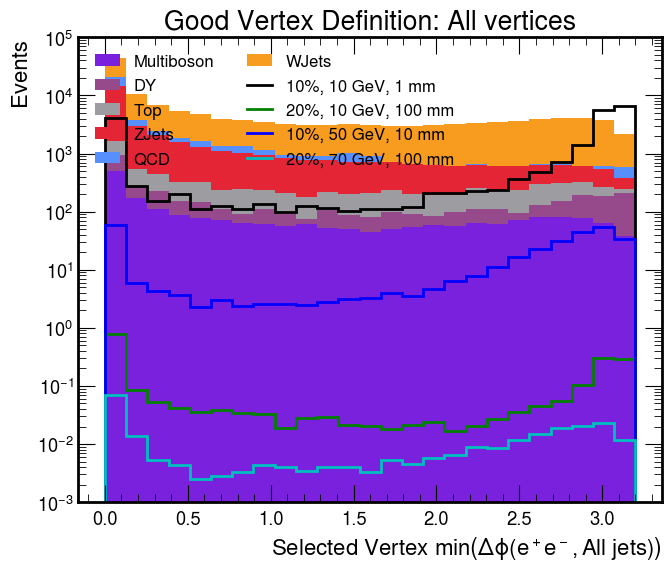

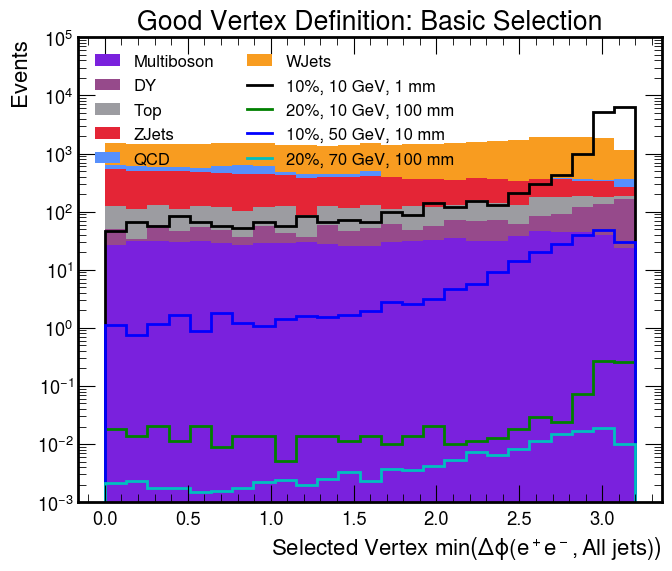

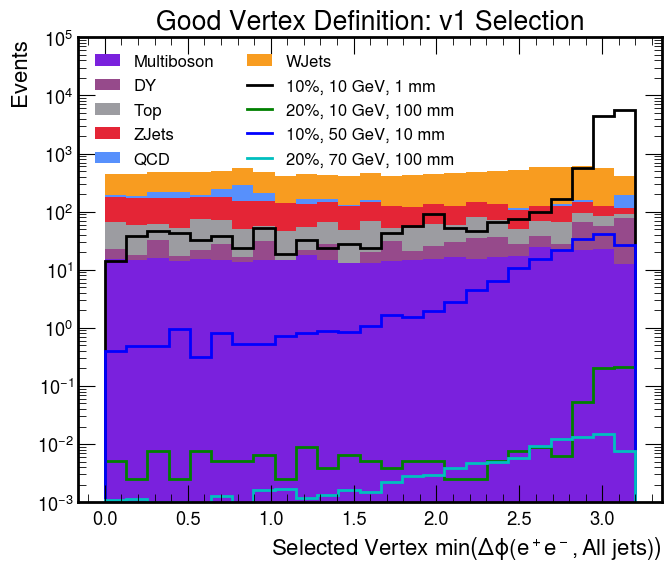

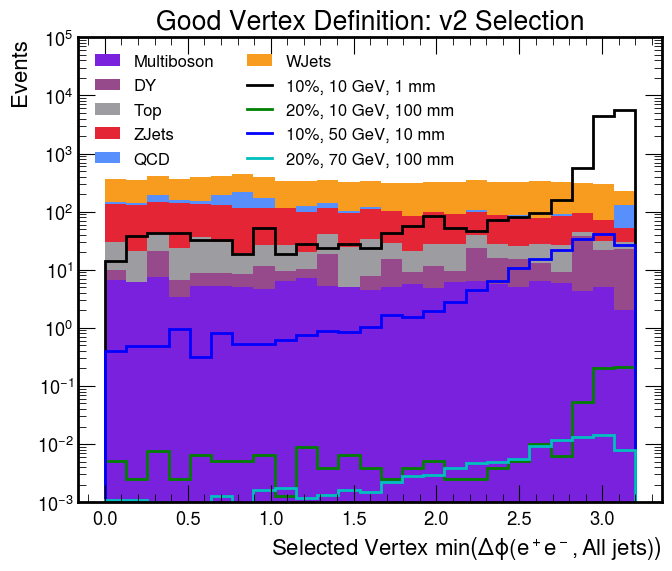

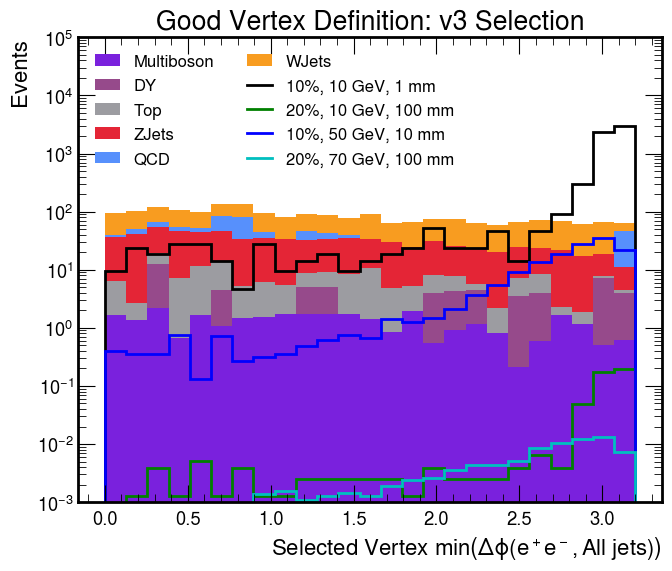

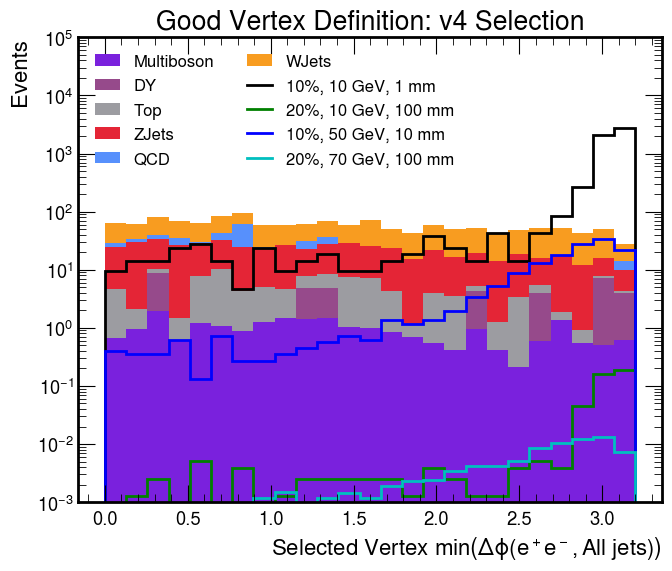

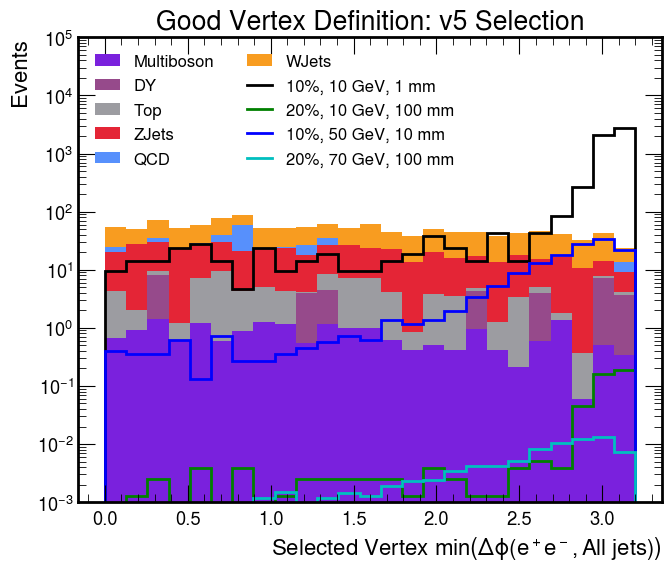

In [20]:
for i,CUT in enumerate(cuts):
    CUT = cuts[i]
    title = f"Good Vertex Definition: {descriptions[i]}"
    outD = f"plots_vtxStudy/plots_observables/{CUT}"
    outName = "sel_vtx_mindPhiJ_selectedSignals"+f"_{CUT}"
    selection = {"cut":CUT,"vtype":sum}
    xlabel = r"Selected Vertex $\min\left(\Delta \phi(e^+e^-,\text{All jets})\right)$"
    plot_samples_sigBkg(hcs,hcb,"sel_vtx_mindPhiJ",selection,selected_signals,selected_labels,outName,outD,
                 figsize=(7,6),xlim=[None,None],ylim=[1e-3,1e5],ncol_leg=2,xlabel=xlabel,rebin=4j,
                    save=True,show=True,logy=True,density=False,title=title,histtype='step',yerr=False,legend_loc='upper left')

/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not plac

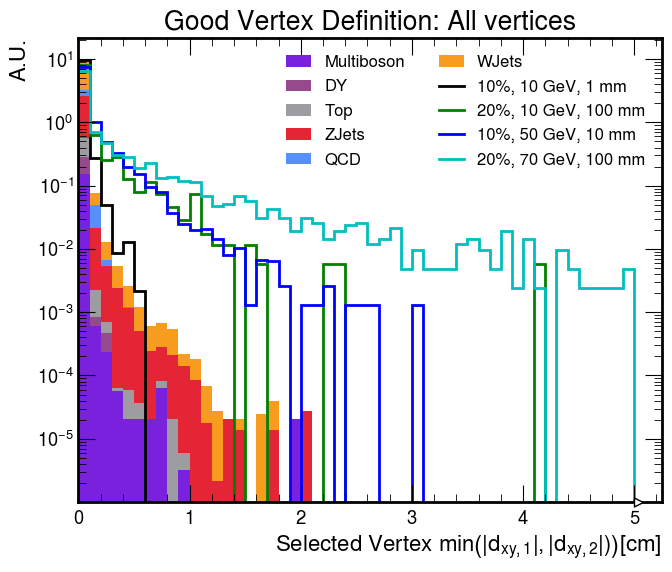

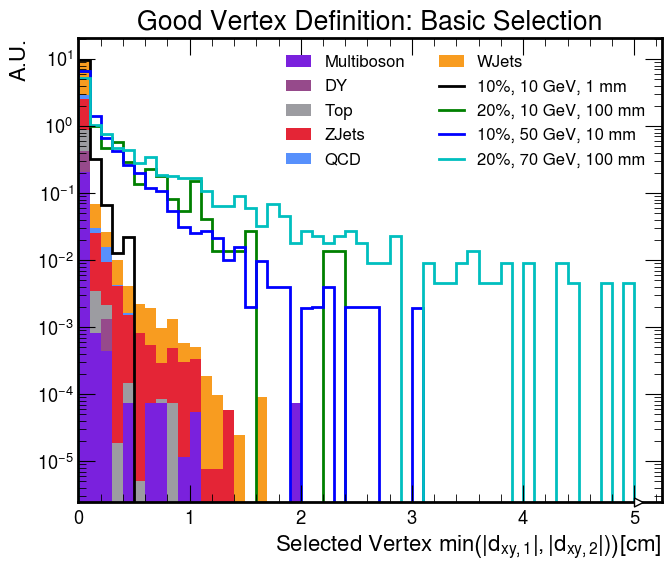

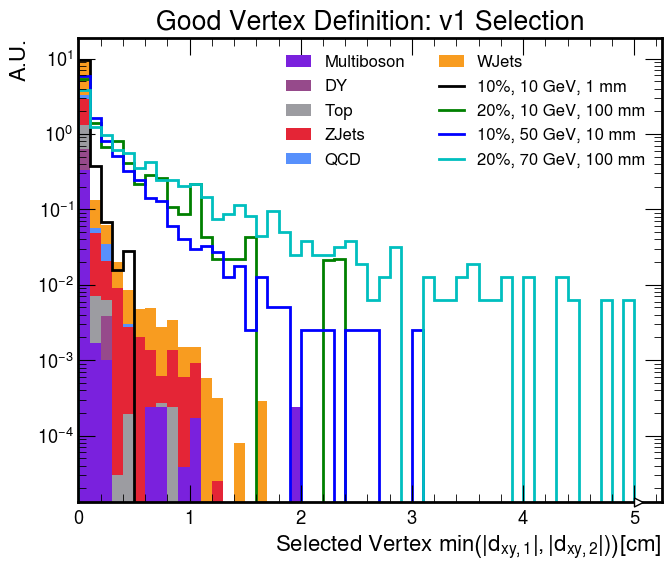

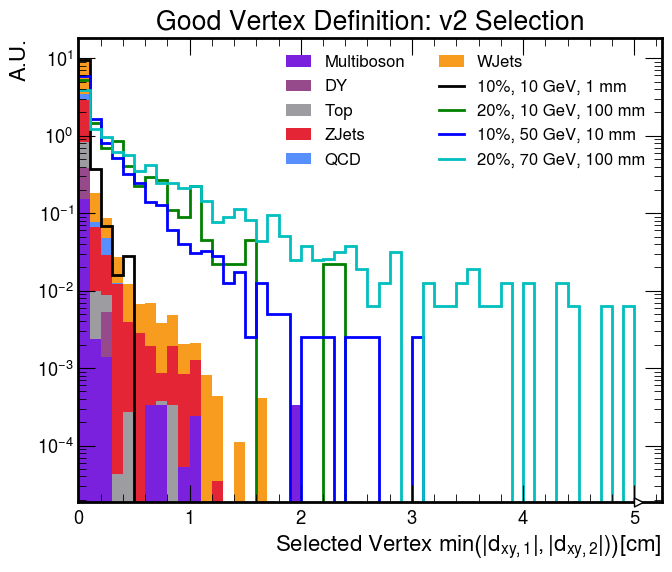

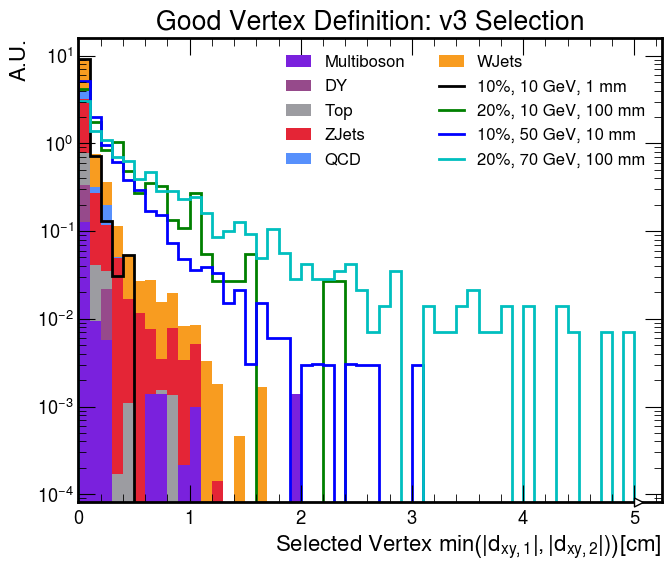

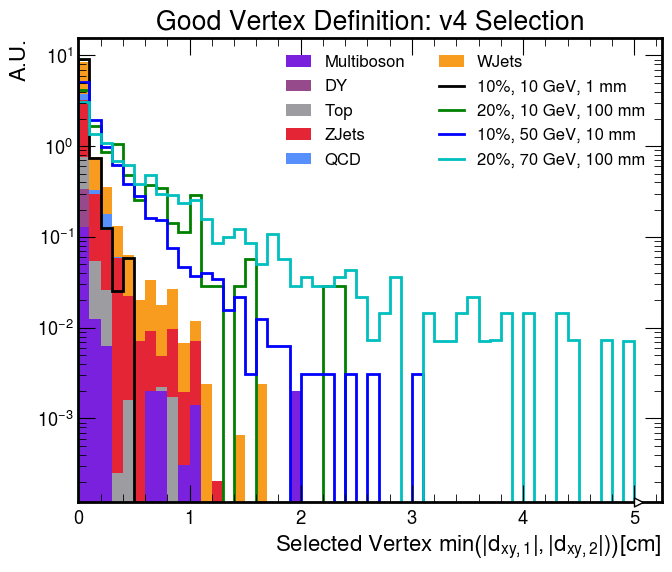

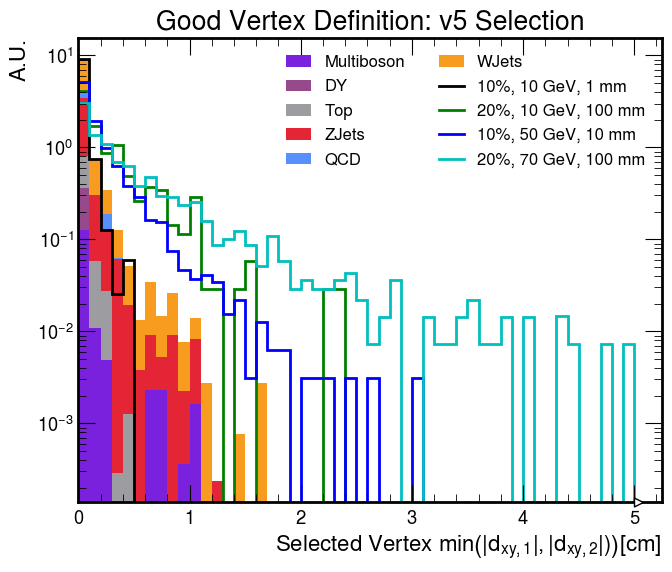

In [21]:
for i,CUT in enumerate(cuts):
    CUT = cuts[i]
    title = f"Good Vertex Definition: {descriptions[i]}"
    outD = f"plots_vtxStudy/plots_observables/{CUT}"
    outName = "sel_vtx_minDxy_selectedSignals"+f"_{CUT}"
    selection = {"cut":CUT,"vtype":sum}
    xlabel = r"Selected Vertex $\min\left(|d_{xy,1}|,|d_{xy,2}|)\right) [cm]$"
    plot_samples_sigBkg(hcs,hcb,"sel_vtx_mindxy",selection,selected_signals,selected_labels,outName,outD,
                 figsize=(7,6),xlim=[0,None],ncol_leg=2,xlabel=xlabel,rebin=10j,
                    save=True,show=True,logy=True,density=True,title=title,histtype='step',yerr=False)

/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not plac

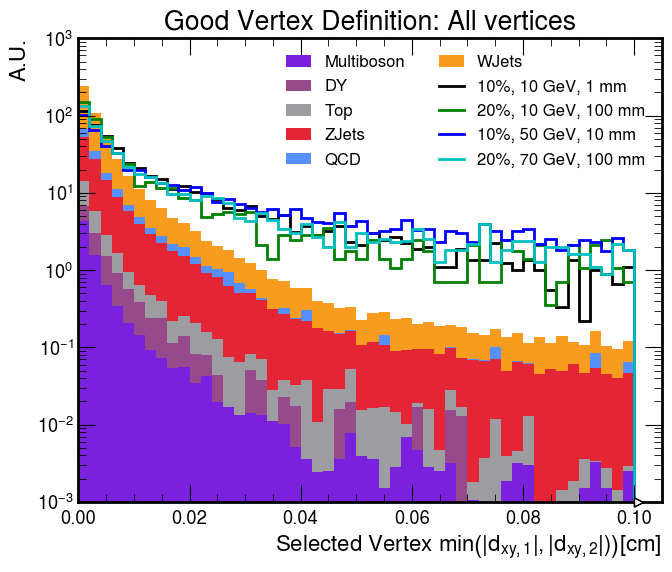

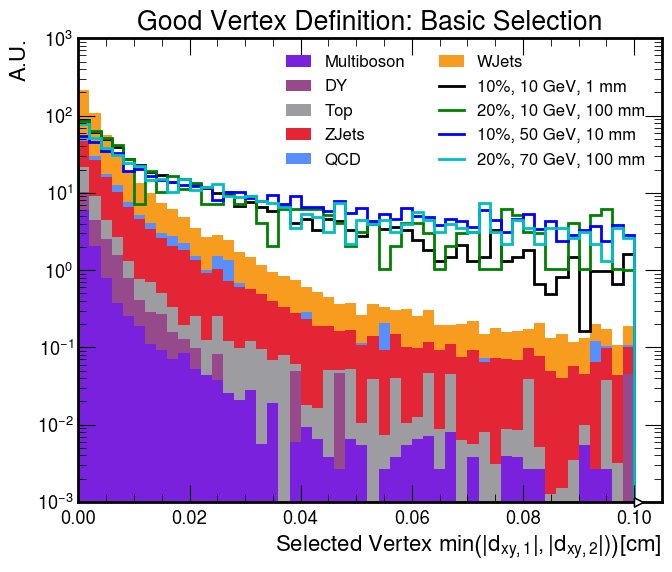

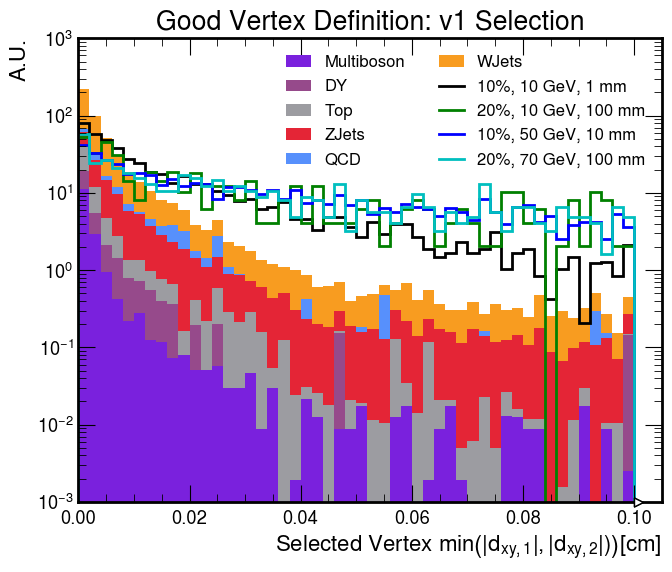

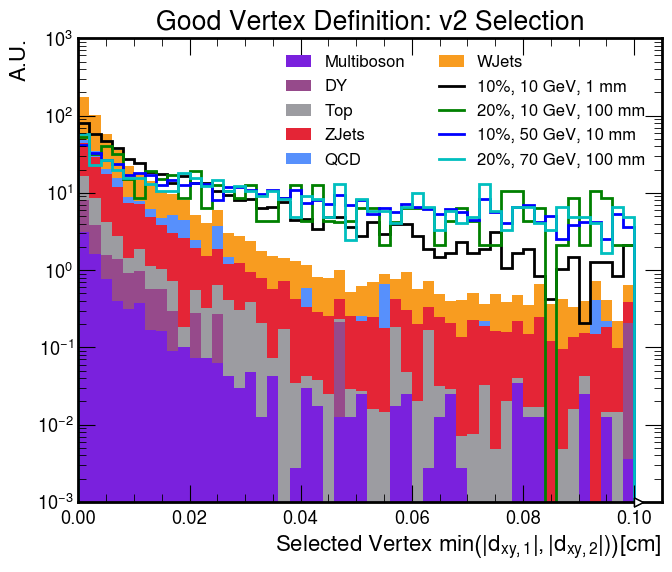

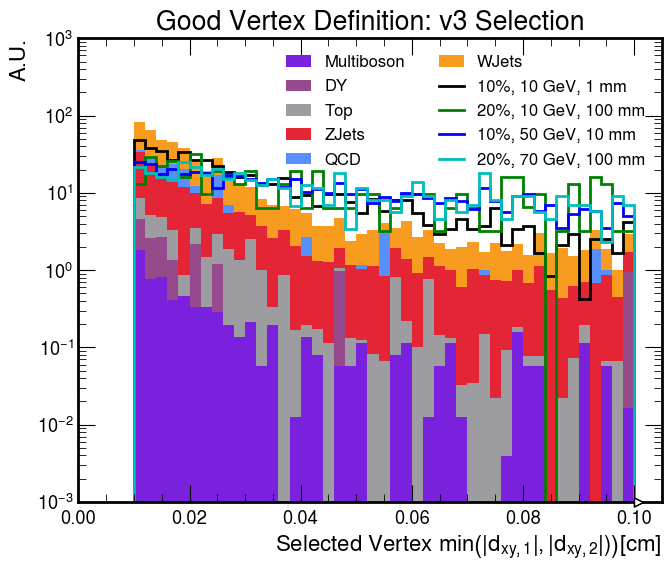

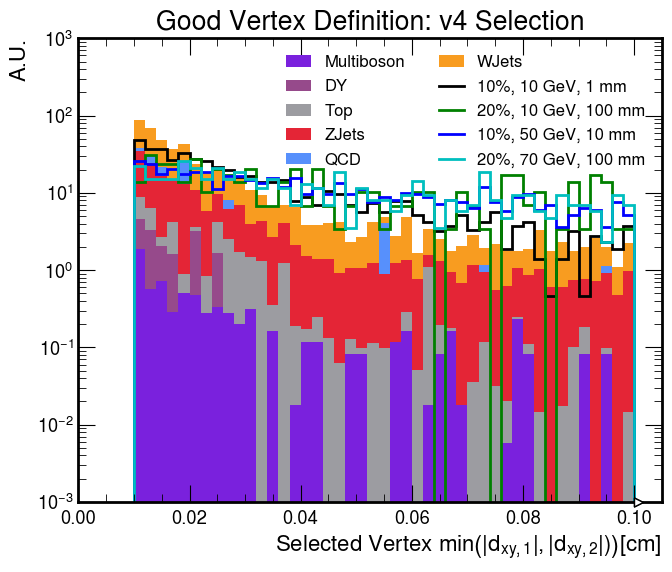

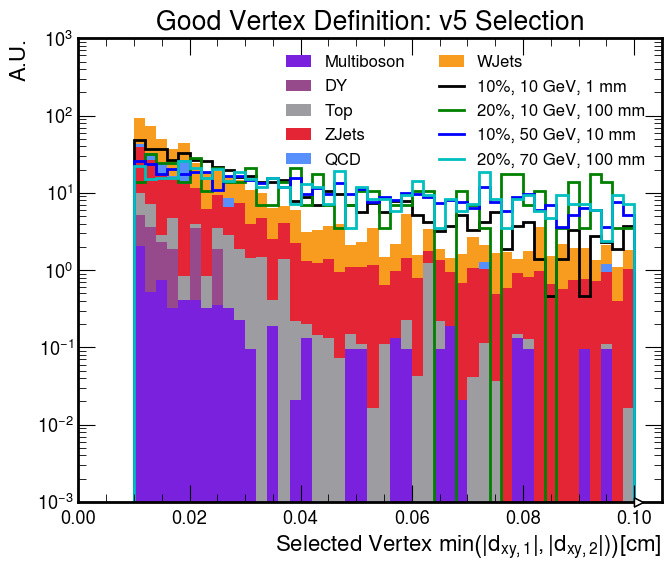

In [57]:
for i,CUT in enumerate(cuts):
    CUT = cuts[i]
    title = f"Good Vertex Definition: {descriptions[i]}"
    outD = f"plots_vtxStudy/plots_observables/{CUT}"
    outName = "sel_vtx_minDxy_low_selectedSignals"+f"_{CUT}"
    selection = {"cut":CUT,"vtype":sum}
    xlabel = r"Selected Vertex $\min\left(|d_{xy,1}|,|d_{xy,2}|)\right) [cm]$"
    plot_samples_sigBkg(hcs,hcb,"sel_vtx_mindxy_low",selection,selected_signals,selected_labels,outName,outD,
                 figsize=(7,6),xlim=[0,None],ylim=[1e-3,1e3],ncol_leg=2,xlabel=xlabel,rebin=20j,
                    save=True,show=True,logy=True,density=True,title=title,histtype='step',yerr=False,legend_loc='upper right')

/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not plac

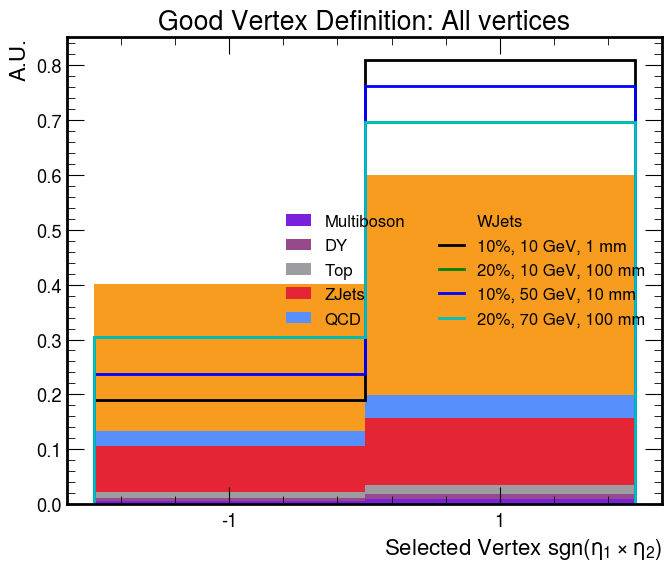

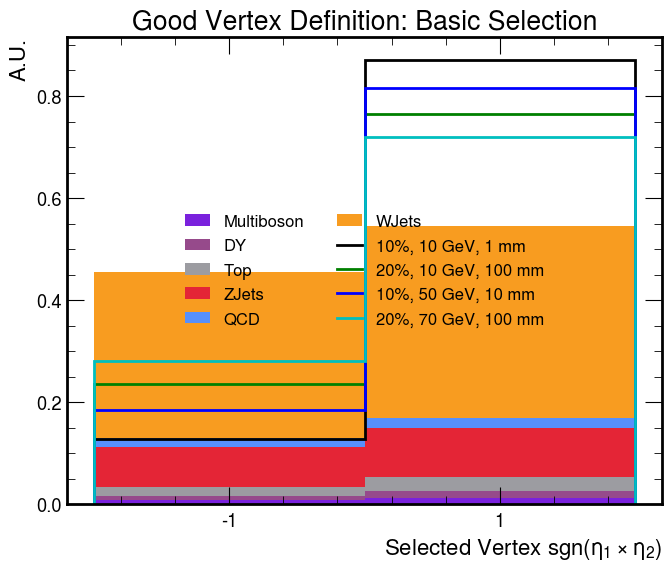

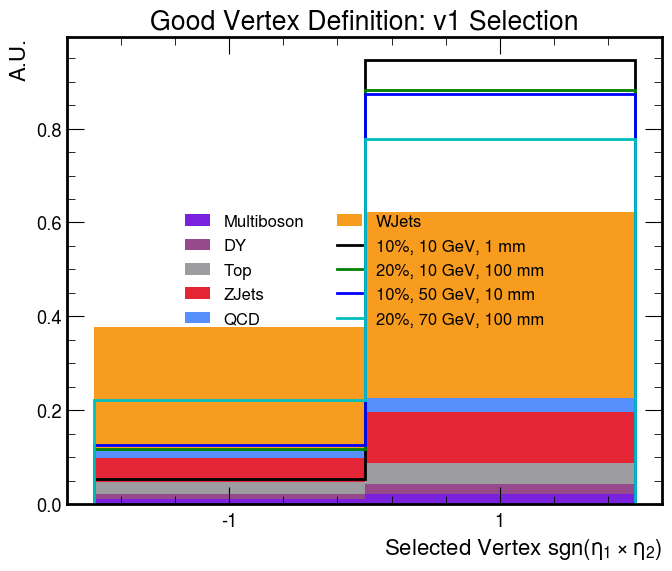

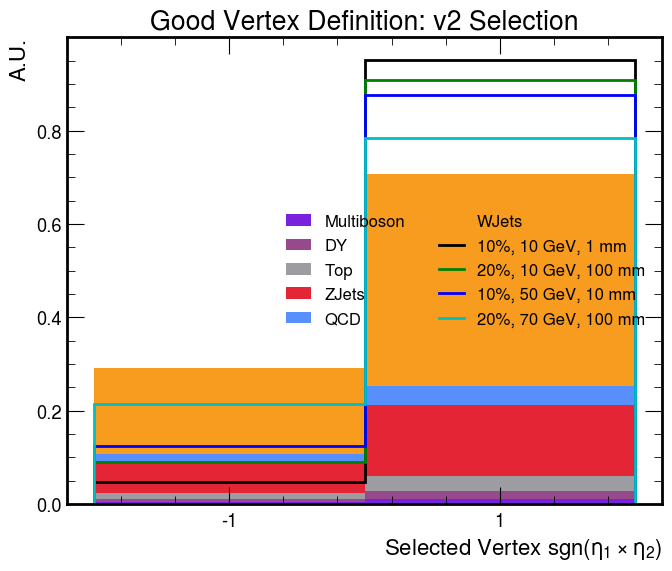

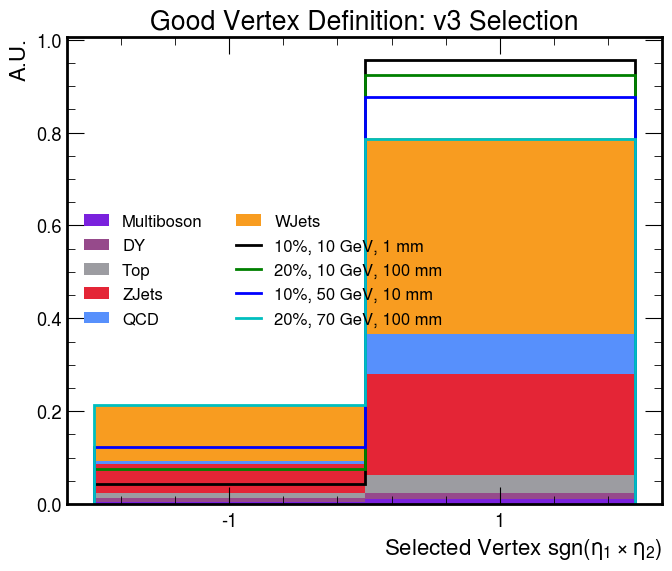

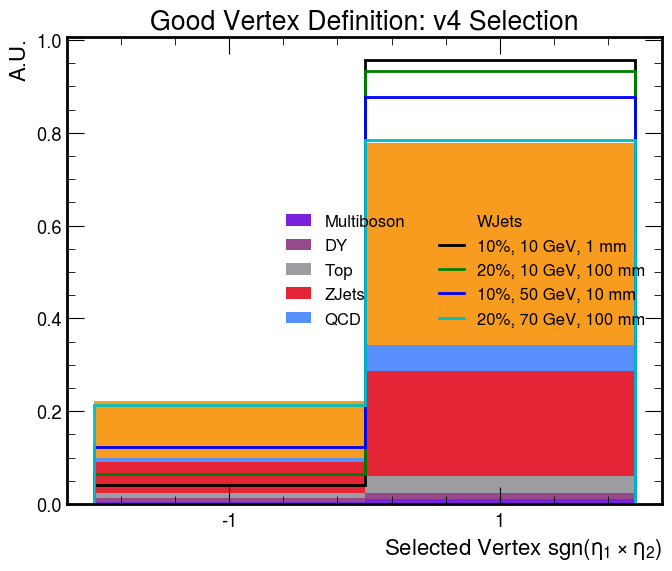

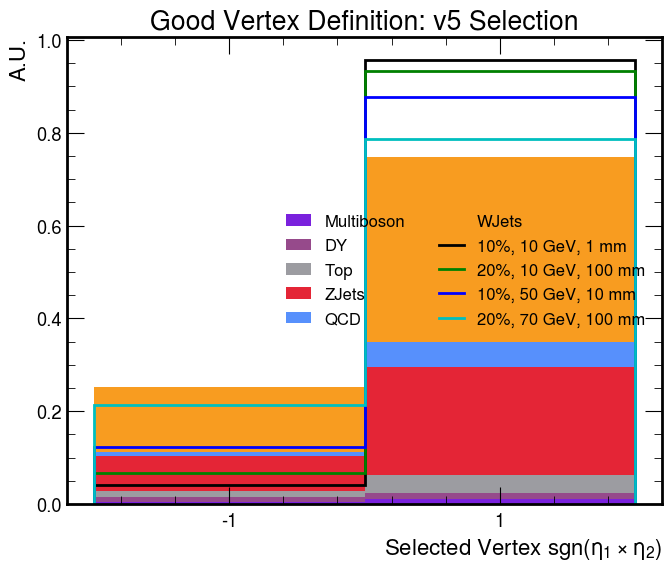

In [22]:
for i,CUT in enumerate(cuts):
    CUT = cuts[i]
    title = f"Good Vertex Definition: {descriptions[i]}"
    outD = f"plots_vtxStudy/plots_observables/{CUT}"
    outName = "sel_vtx_signEtaProd_selectedSignals"+f"_{CUT}"
    selection = {"cut":CUT,"vtype":sum}
    xlabel = r"Selected Vertex $\mathrm{sgn}(\eta_1 \times \eta_2)$"
    plot_samples_sigBkg(hcs,hcb,"sel_vtx_sign_etaProd",selection,selected_signals,selected_labels,outName,outD,
                 figsize=(7,6),xlim=None,ncol_leg=2,xlabel=xlabel,rebin=1j,
                    save=False,show=True,logy=False,density=True,title=title,histtype='step',yerr=False)

/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not plac

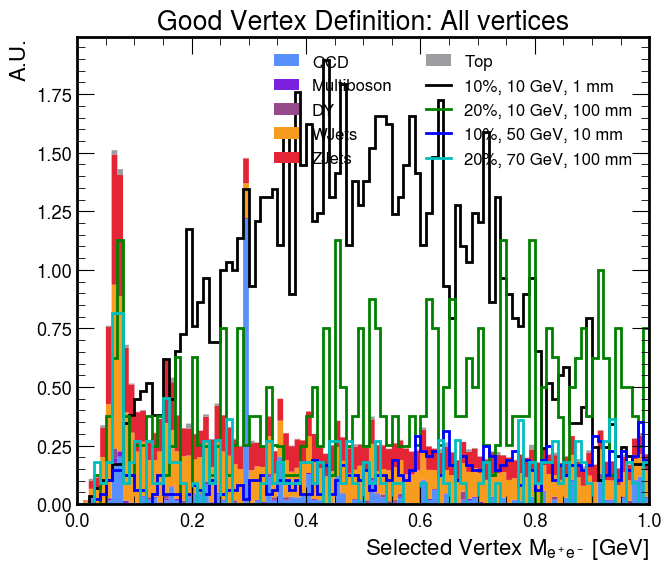

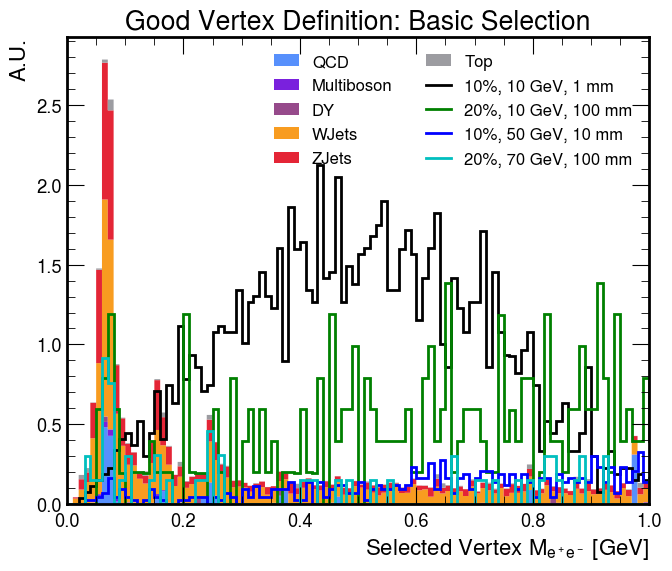

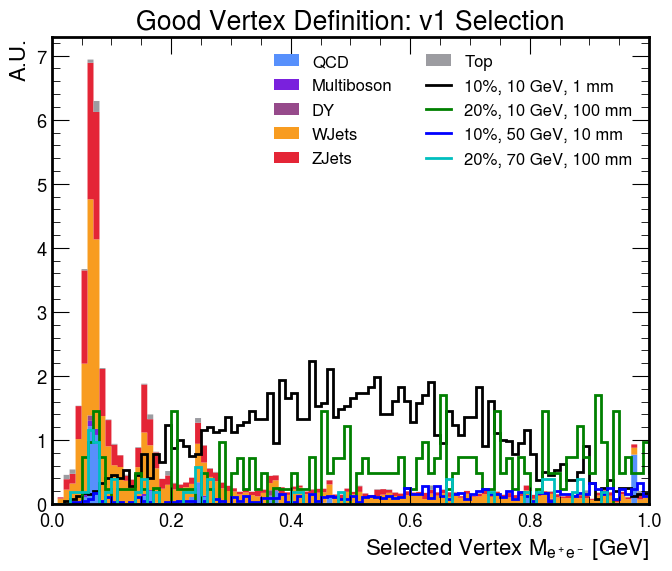

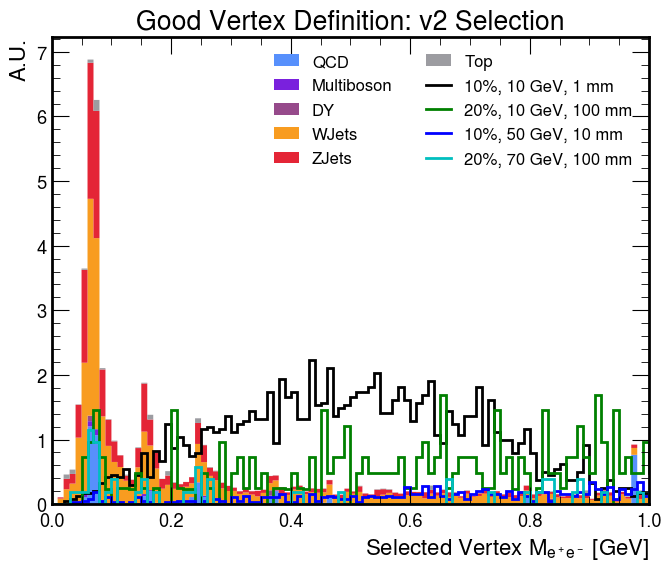

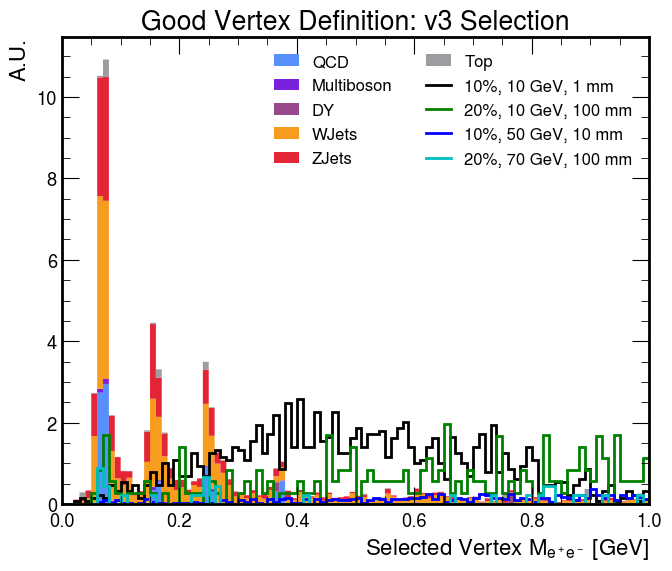

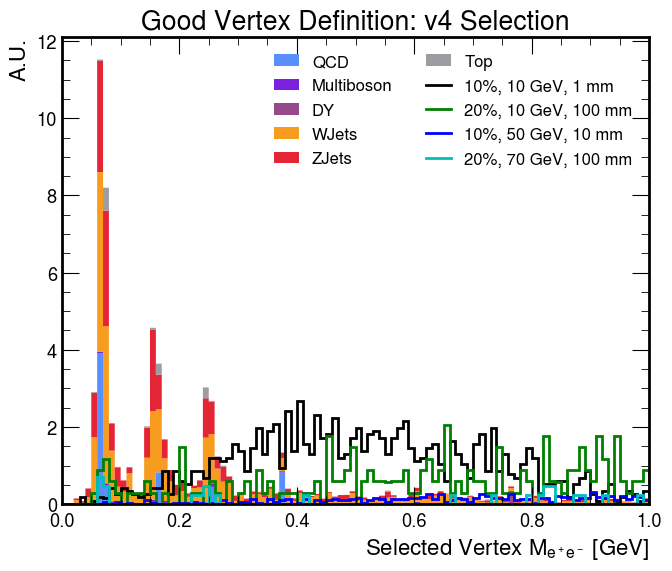

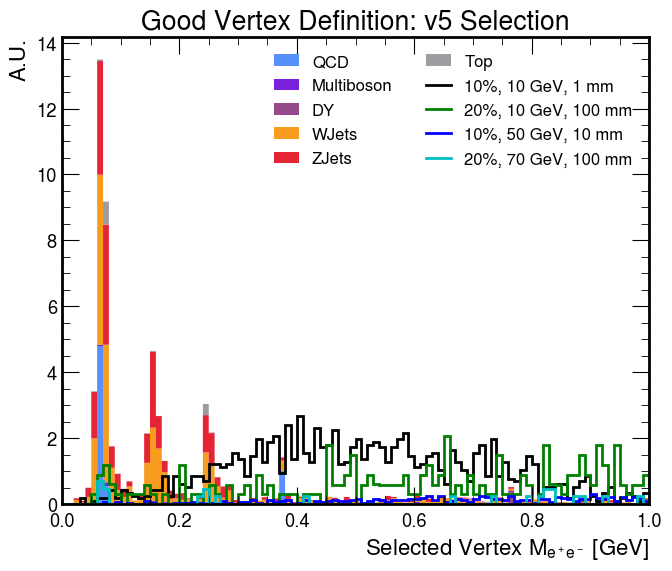

In [10]:
for i,CUT in enumerate(cuts):
    CUT = cuts[i]
    title = f"Good Vertex Definition: {descriptions[i]}"
    outD = f"plots_vtxStudy/plots_observables/{CUT}"
    outName = "sel_vtx_mass_low_selectedSignals"+f"_{CUT}"
    selection = {"cut":CUT,"vtype":sum}
    xlabel = r"Selected Vertex $M_{e^+e^-}$ [GeV]"
    plot_samples_sigBkg(hcs,hcb,"sel_vtx_mass_low",selection,selected_signals,selected_labels,outName,outD,
                 figsize=(7,6),xlim=[0,1],ncol_leg=2,xlabel=xlabel,rebin=1j,
                    save=False,show=True,logy=False,density=True,title=title,histtype='step',yerr=False)

/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not plac

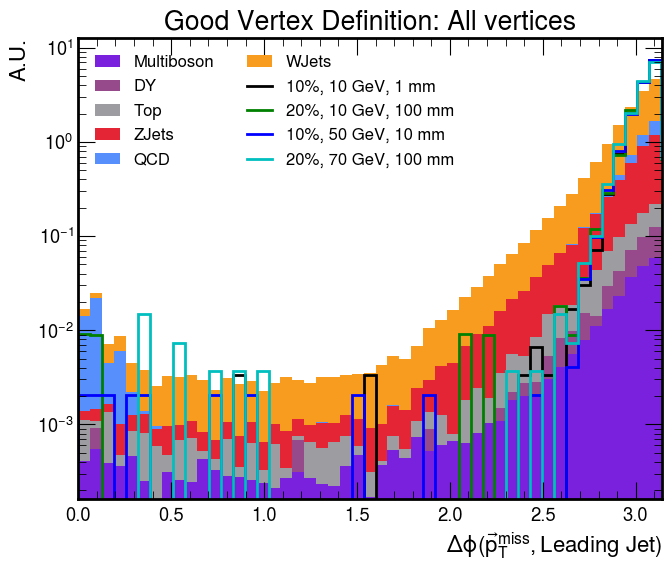

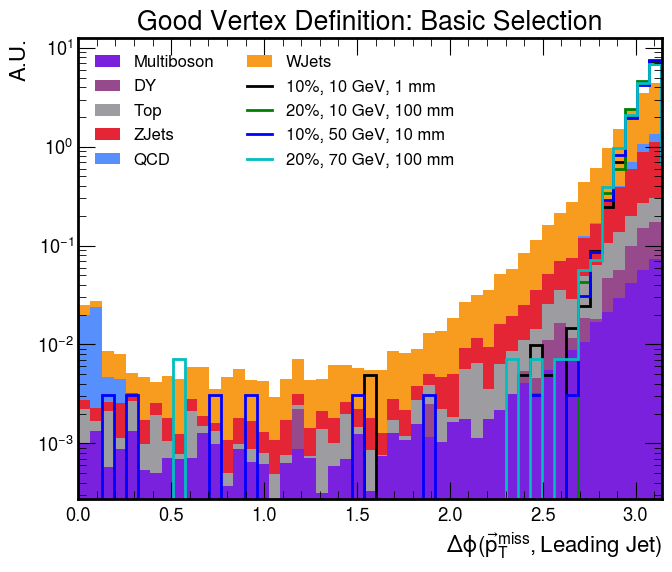

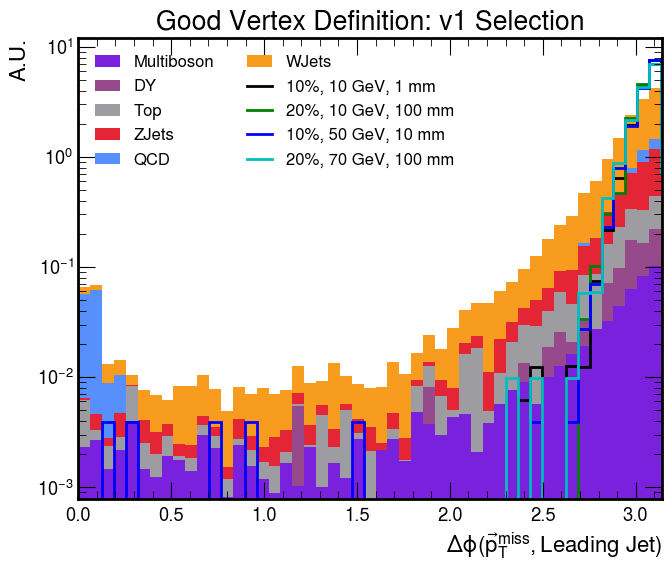

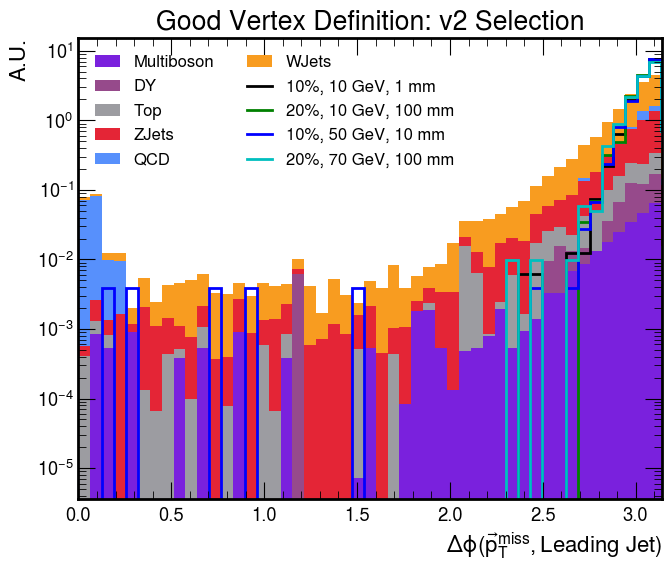

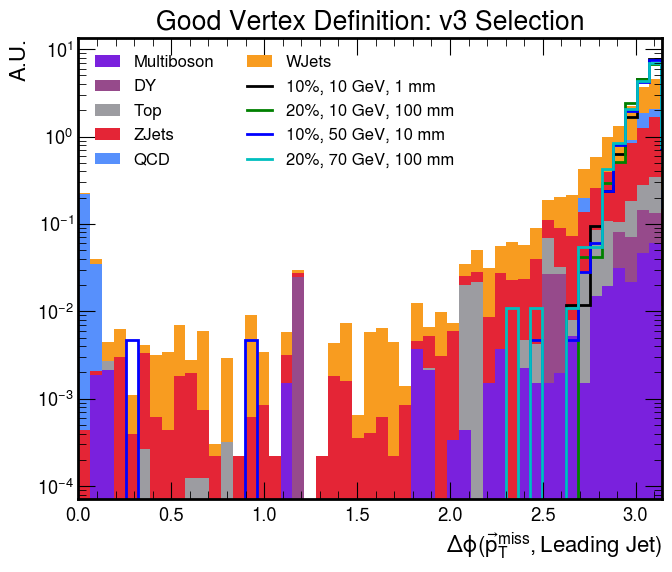

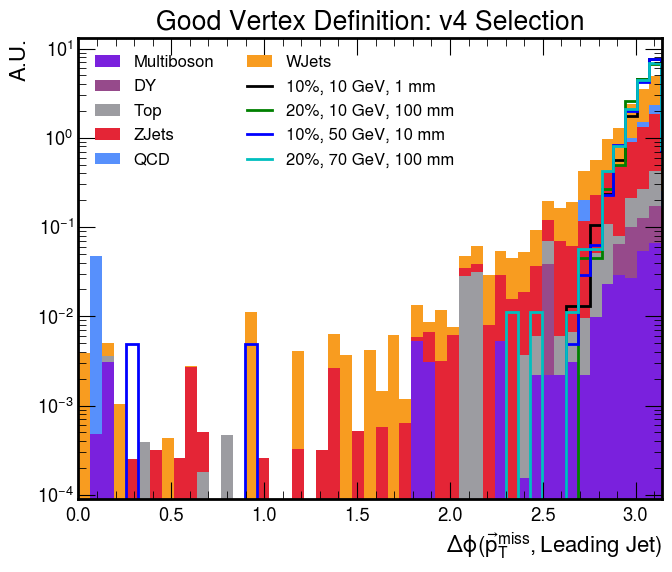

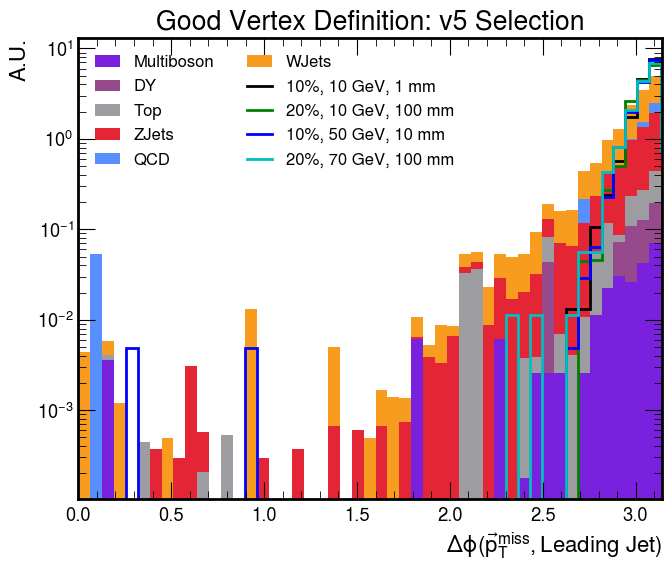

In [24]:
for i,CUT in enumerate(cuts):
    CUT = cuts[i]
    title = f"Good Vertex Definition: {descriptions[i]}"
    outD = f"plots_vtxStudy/plots_observables/{CUT}"
    outName = "jetMETdPhi_selectedSignals"+f"_{CUT}"
    selection = {"cut":CUT}
    xlabel = r"$\Delta \phi(\vec{p}_T^\mathrm{miss},\text{Leading Jet})$"
    plot_samples_sigBkg(hcs,hcb,"jetMETdPhi",selection,selected_signals,selected_labels,outName,outD,
                 figsize=(7,6),xlim=[0,np.pi],ncol_leg=2,xlabel=xlabel,rebin=2j,
                    save=True,show=True,logy=True,density=True,title=title,histtype='step',yerr=False)

/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not plac

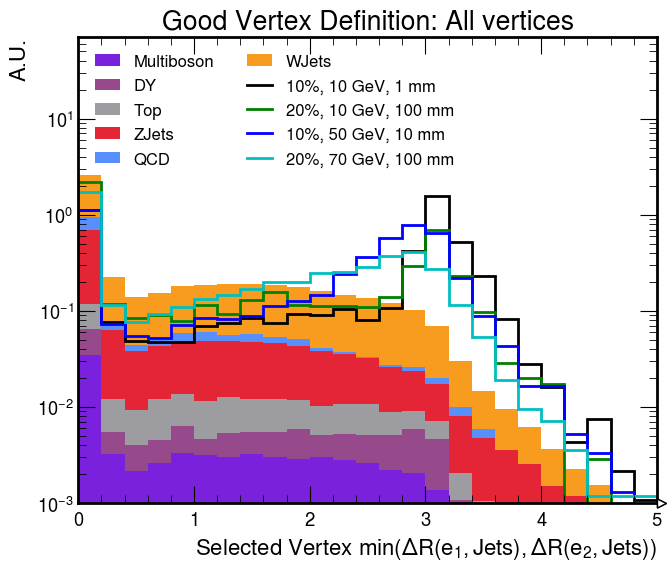

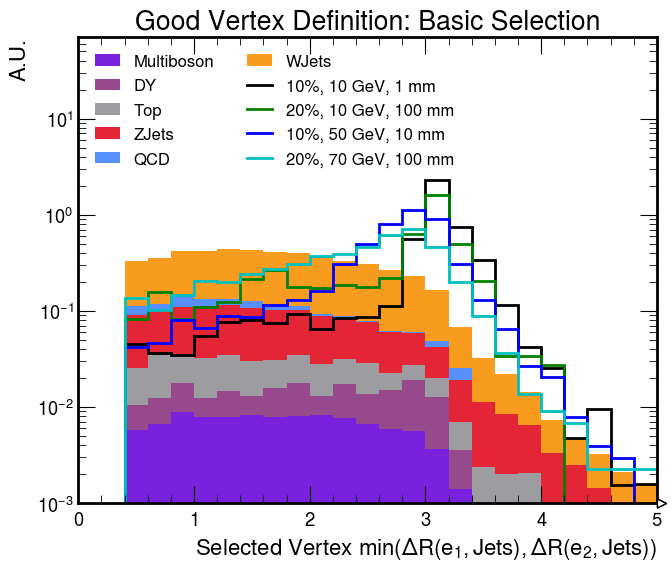

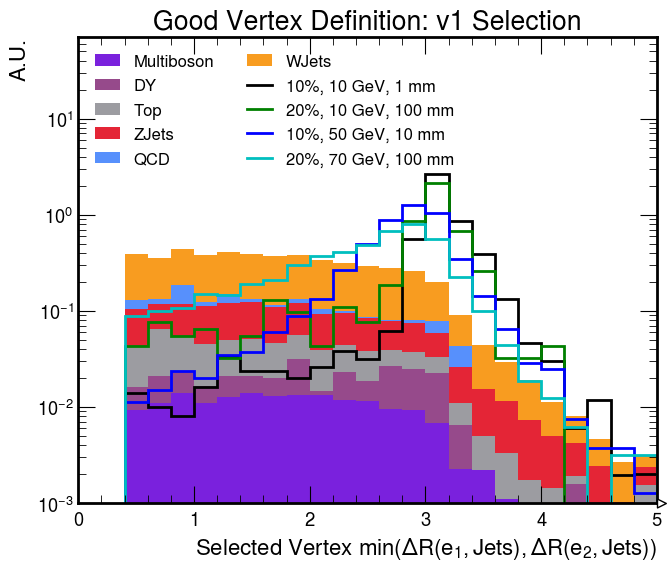

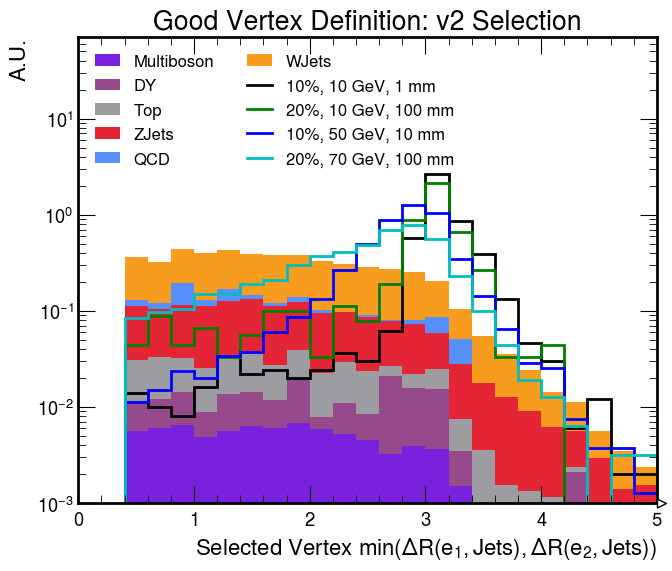

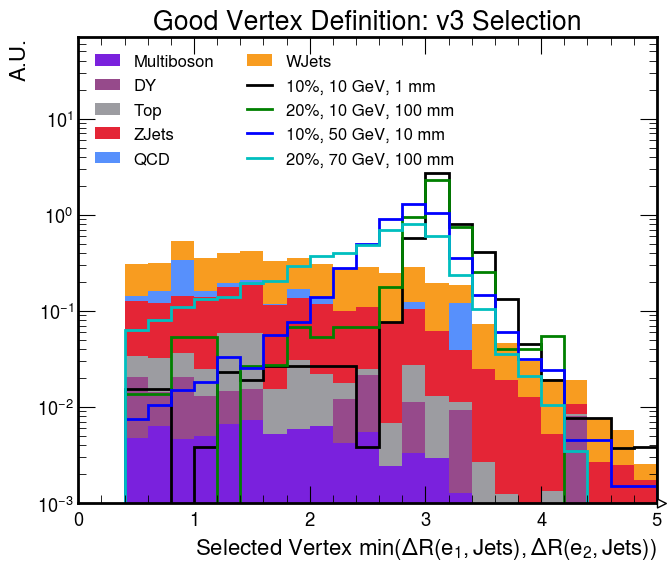

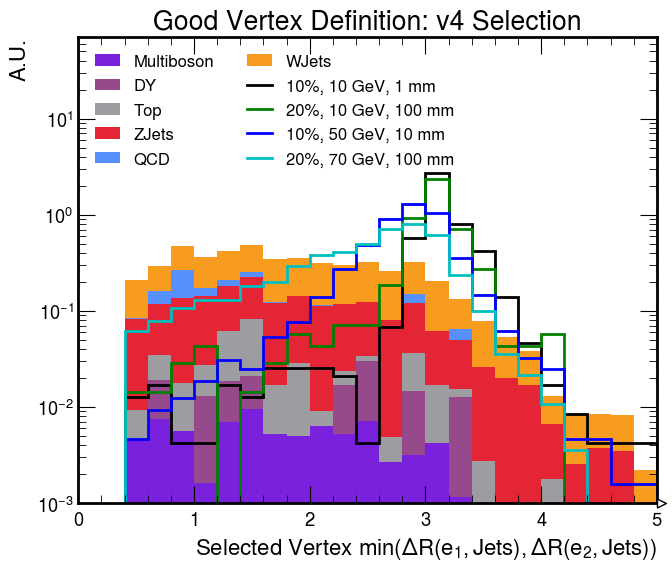

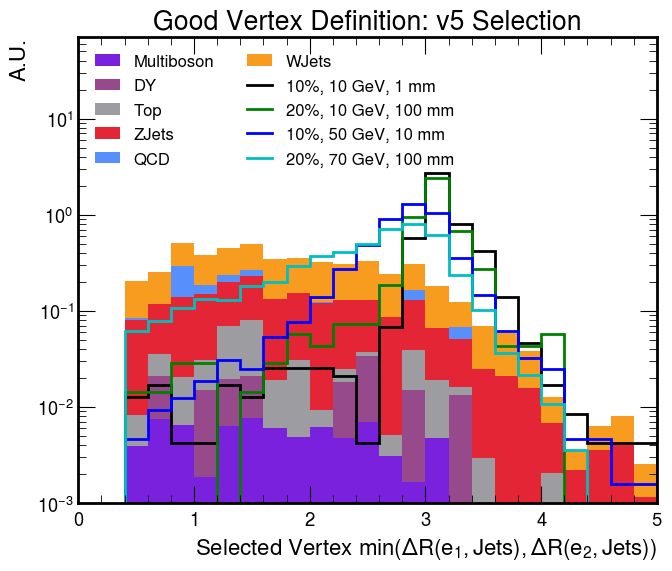

In [25]:
for i,CUT in enumerate(cuts):
    CUT = cuts[i]
    title = f"Good Vertex Definition: {descriptions[i]}"
    outD = f"plots_vtxStudy/plots_observables/{CUT}"
    outName = "sel_vtx_minEleDrJ_selectedSignals"+f"_{CUT}"
    selection = {"cut":CUT,'vtype':sum}
    xlabel = r"Selected Vertex $\min(\Delta R(e_1,\text{Jets}),\Delta R(e_2,\text{Jets}))$"
    plot_samples_sigBkg(hcs,hcb,"sel_vtx_minEleDrJ",selection,selected_signals,selected_labels,outName,outD,
                 figsize=(7,6),xlim=[0,5],ylim=[1e-3,7e1],ncol_leg=2,xlabel=xlabel,rebin=4j,
                    save=True,show=True,logy=True,density=True,title=title,histtype='step',yerr=False,legend_loc='upper left')

/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not plac

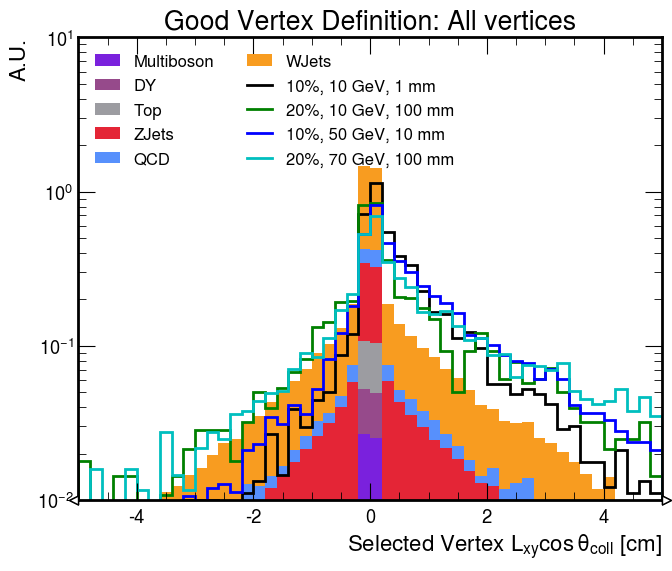

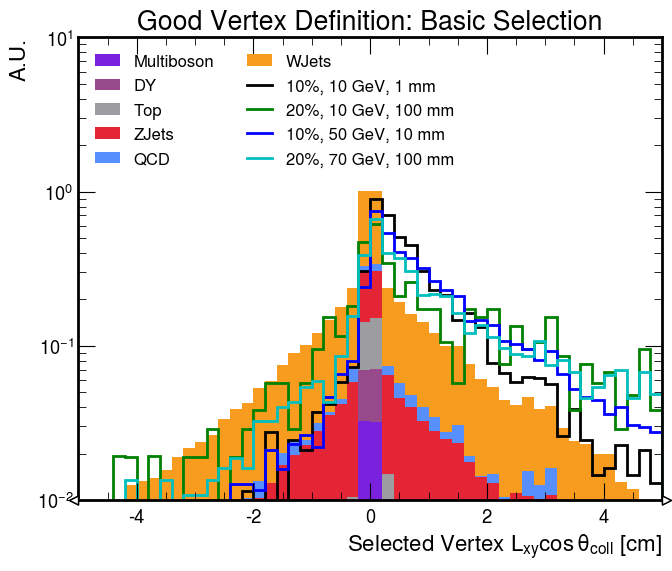

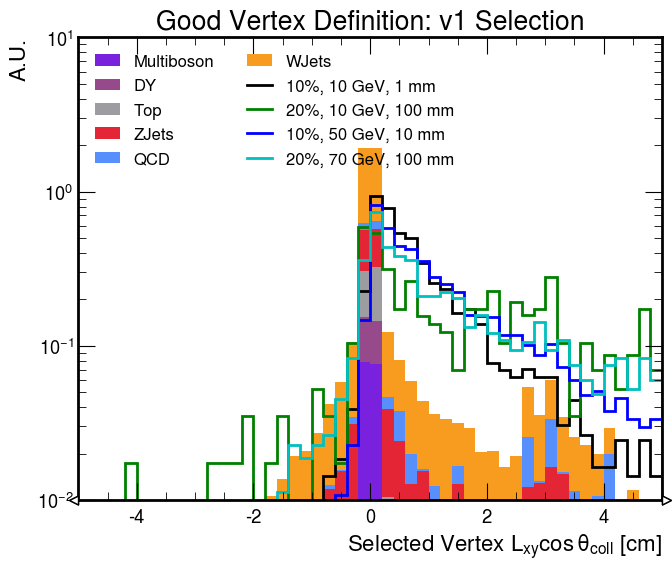

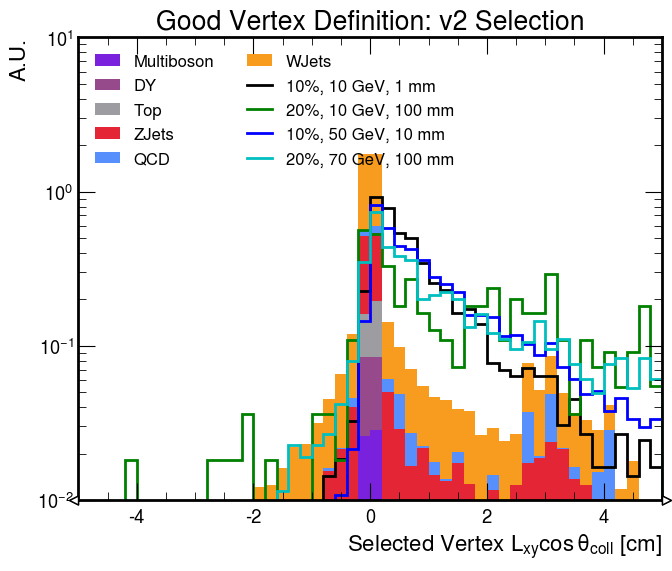

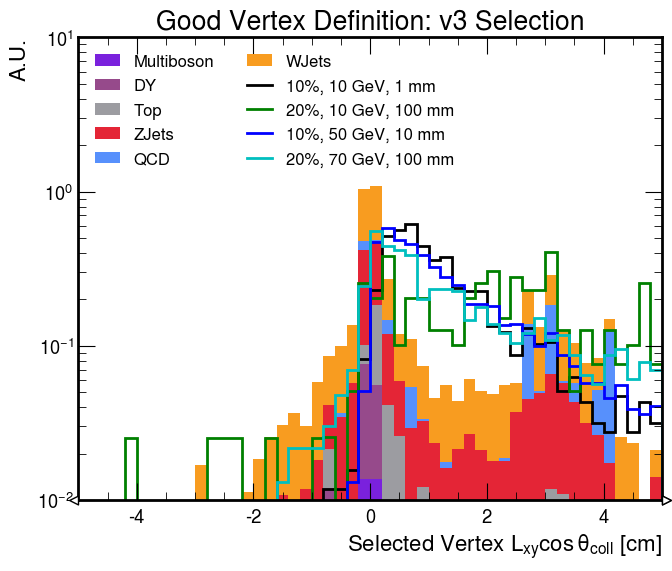

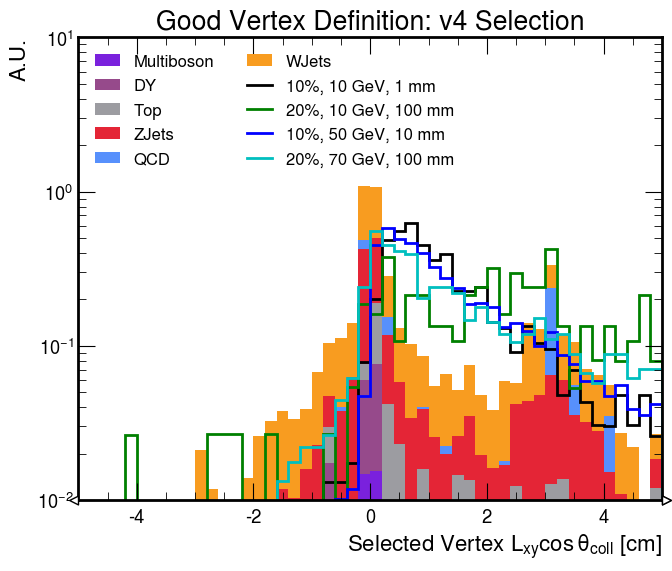

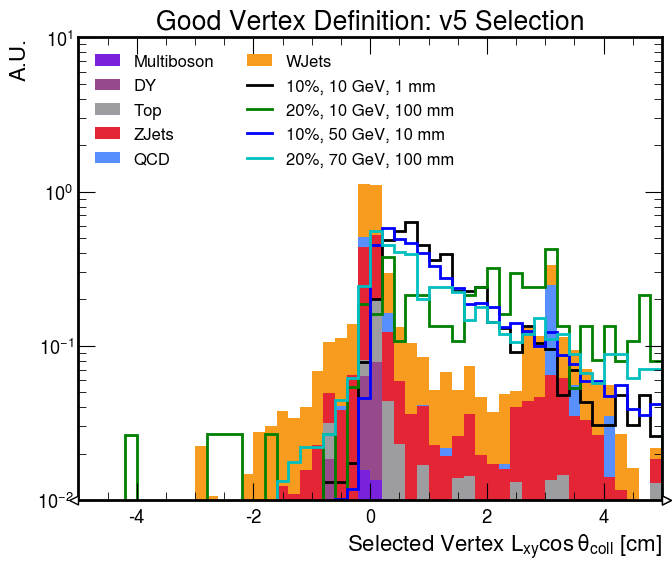

In [26]:
for i,CUT in enumerate(cuts):
    CUT = cuts[i]
    title = f"Good Vertex Definition: {descriptions[i]}"
    outD = f"plots_vtxStudy/plots_observables/{CUT}"
    outName = "sel_vtx_LxyCosThetaCollZoom_selectedSignals"+f"_{CUT}"
    selection = {"cut":CUT,'vtype':sum}
    xlabel = r"Selected Vertex $L_{xy}\cos\theta_\mathrm{coll}$ [cm]"
    plot_samples_sigBkg(hcs,hcb,"sel_vtx_LxyCosThetaCollZoom",selection,selected_signals,selected_labels,outName,outD,
                 figsize=(7,6),xlim=[-5,5],ylim=[1e-2,1e1],legend_loc='upper left',ncol_leg=2,xlabel=xlabel,rebin=2j,
                    save=True,show=True,logy=True,density=True,title=title,histtype='step',yerr=False)

/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not plac

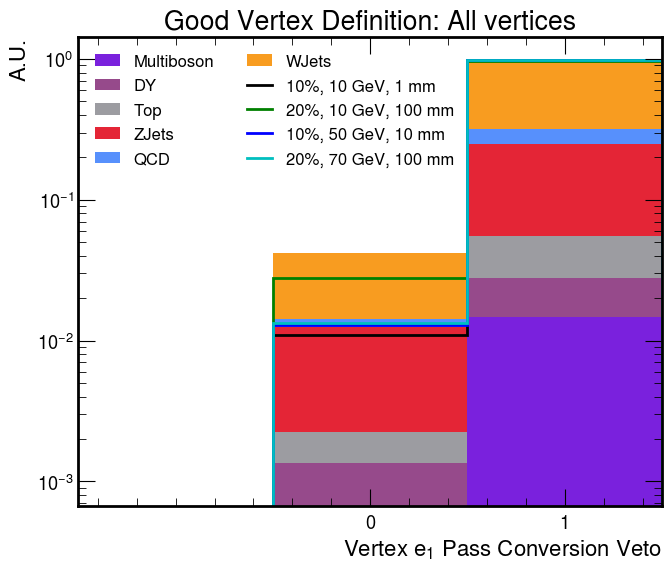

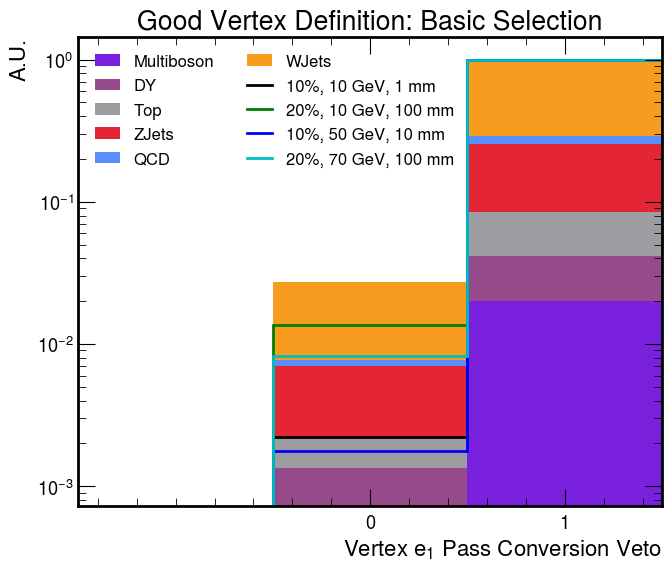

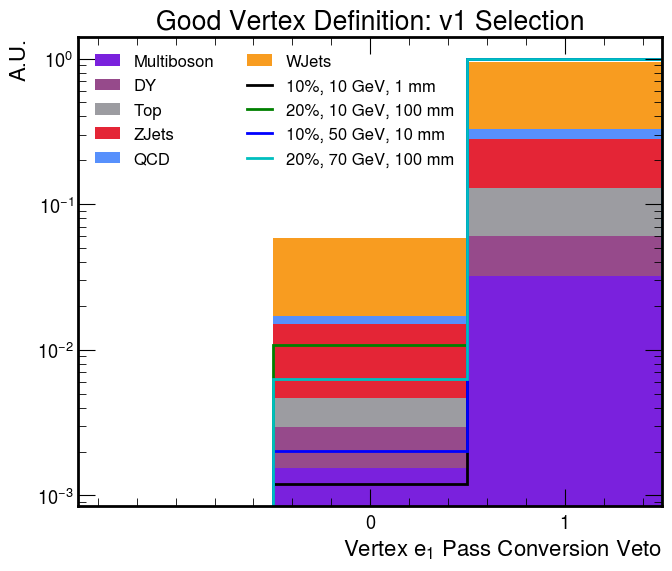

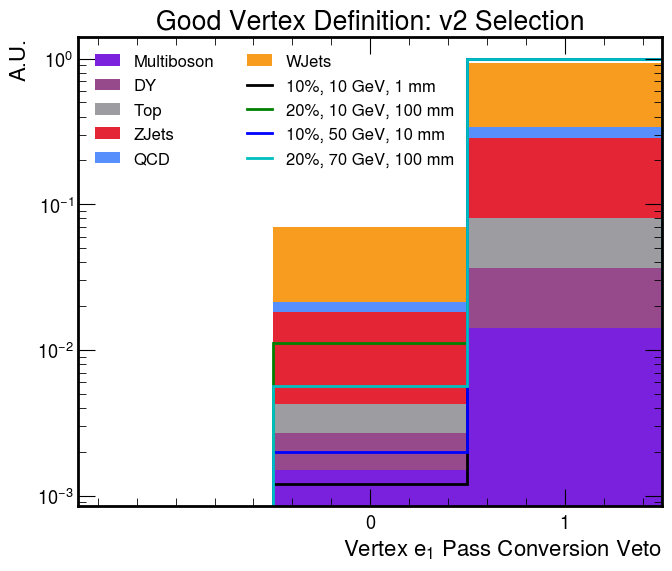

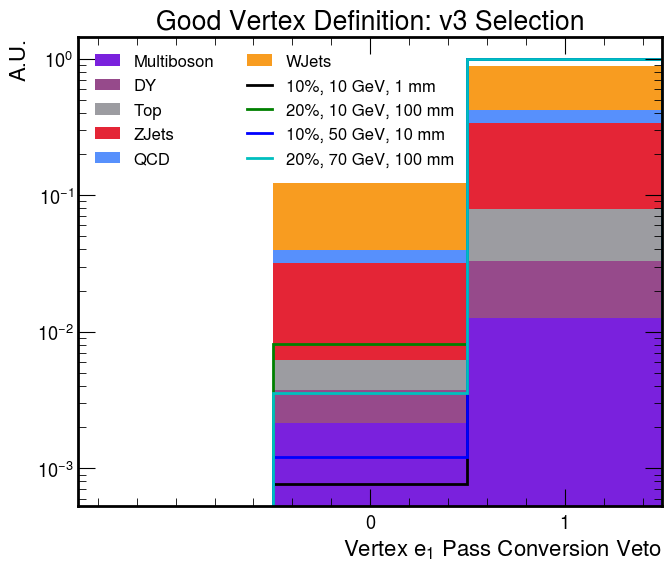

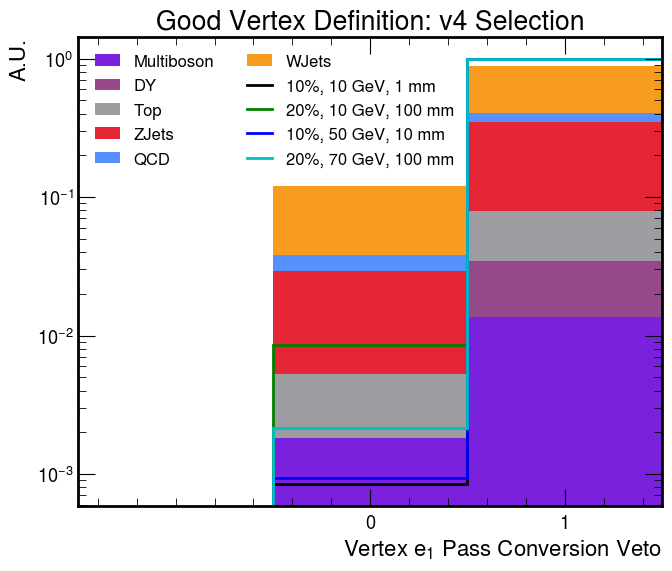

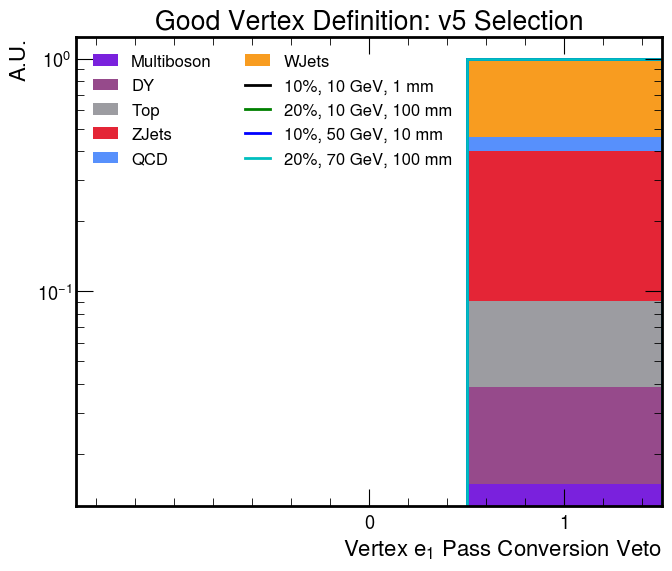

In [27]:
for i,CUT in enumerate(cuts):
    CUT = cuts[i]
    title = f"Good Vertex Definition: {descriptions[i]}"
    outD = f"plots_vtxStudy/plots_observables/{CUT}"
    outName = "sel_e1_passConvVeto_selectedSignals"+f"_{CUT}"
    selection = {"cut":CUT,"ele_type":sum}
    xlabel = r"Vertex $e_1$ Pass Conversion Veto"
    ylabel = "A.U."
    plot_samples_sigBkg(hcs,hcb,"sel_e1_passConvVeto",selection,selected_signals,selected_labels,outName,outD,
                 figsize=(7,6),xlim=[-1,2],ncol_leg=2,xlabel=xlabel,ylabel=ylabel,rebin=1j,legend_loc='upper left',
                    save=True,show=True,logy=True,density=True,title=title,histtype='step',yerr=False)

/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not plac

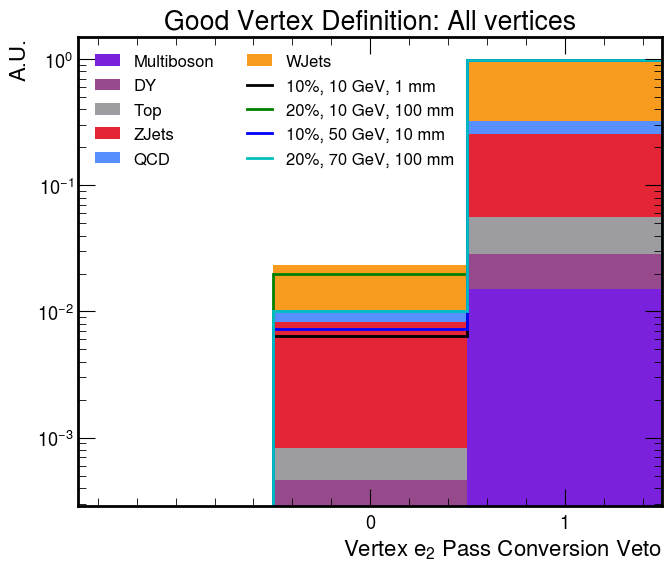

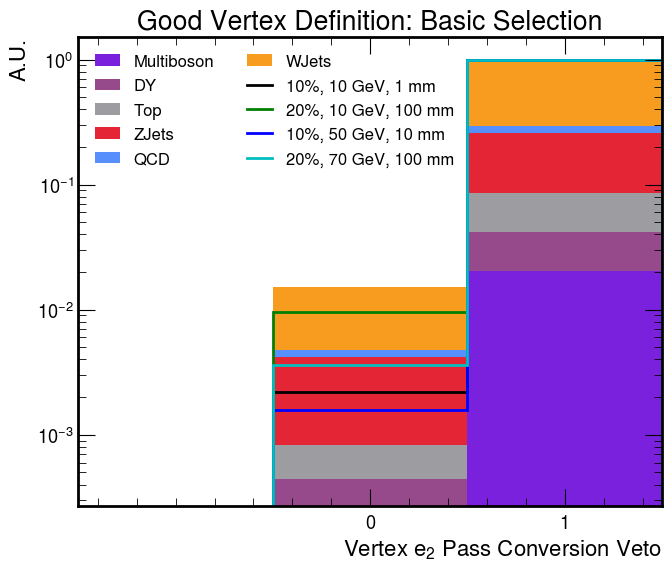

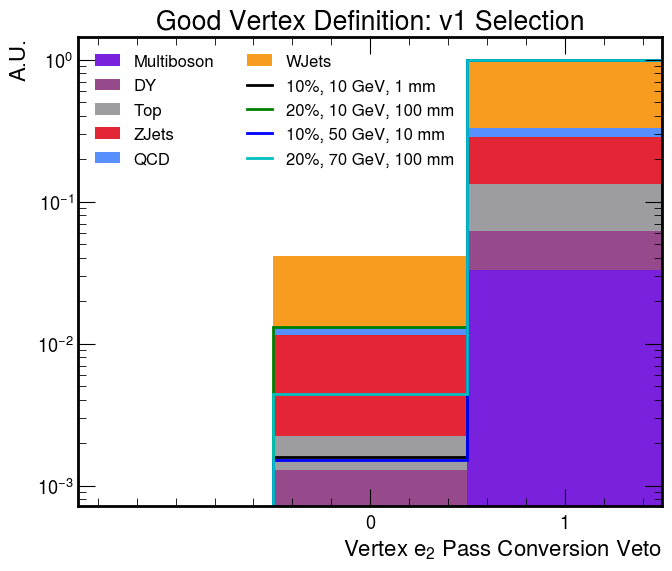

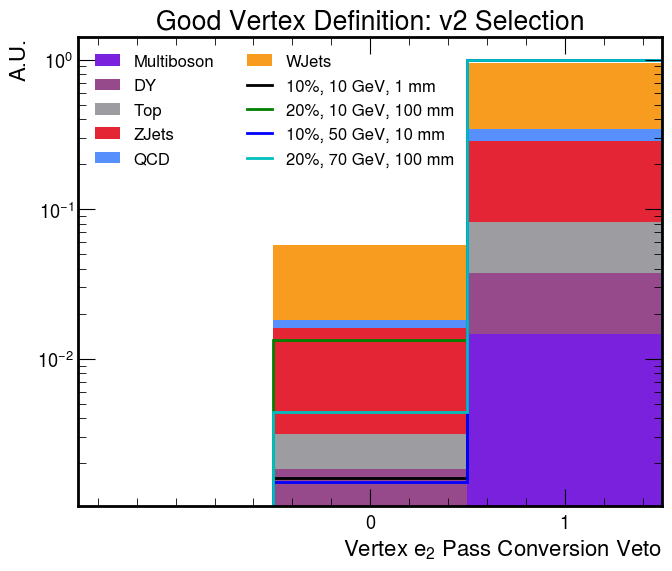

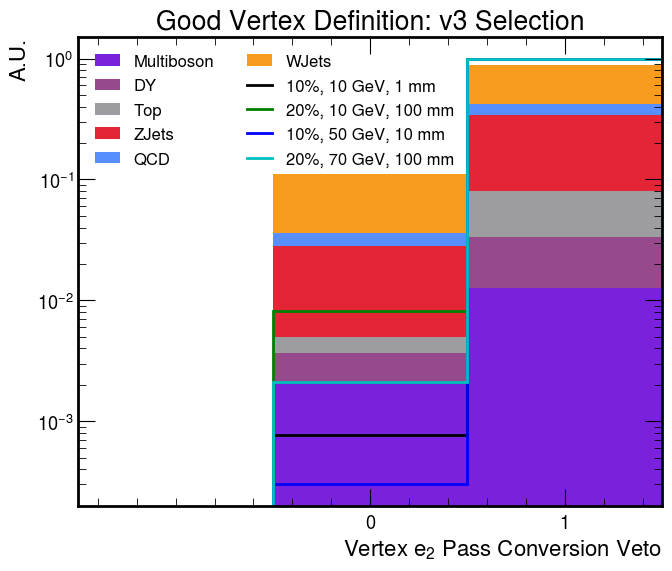

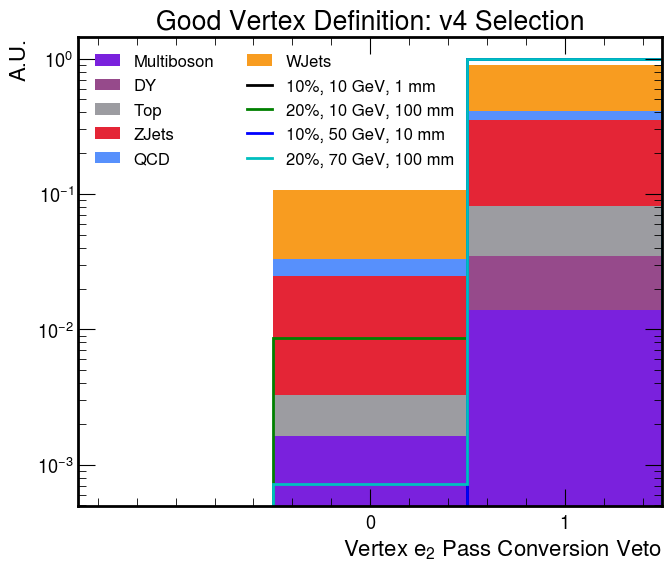

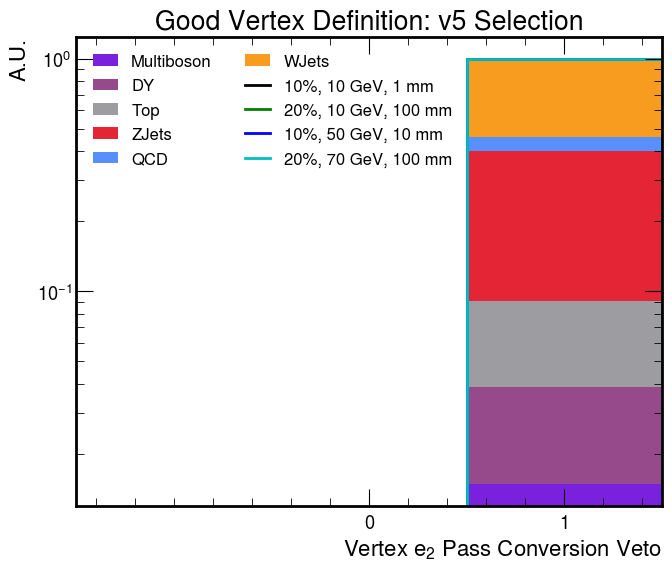

In [28]:
for i,CUT in enumerate(cuts):
    CUT = cuts[i]
    title = f"Good Vertex Definition: {descriptions[i]}"
    outD = f"plots_vtxStudy/plots_observables/{CUT}"
    outName = "sel_e2_passConvVeto_selectedSignals"+f"_{CUT}"
    selection = {"cut":CUT,"ele_type":sum}
    xlabel = r"Vertex $e_2$ Pass Conversion Veto"
    ylabel = "A.U."
    plot_samples_sigBkg(hcs,hcb,"sel_e2_passConvVeto",selection,selected_signals,selected_labels,outName,outD,
                 figsize=(7,6),xlim=[-1,2],ncol_leg=2,xlabel=xlabel,ylabel=ylabel,rebin=1j,legend_loc='upper left',
                    save=True,show=True,logy=True,density=True,title=title,histtype='step',yerr=False)

/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not plac

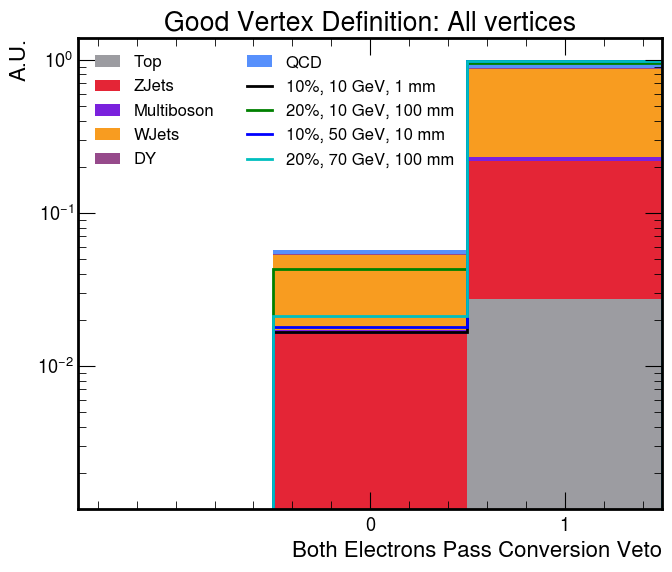

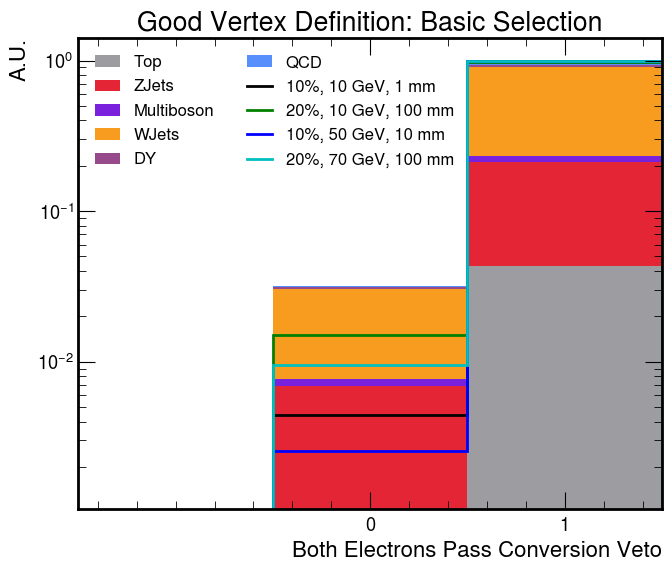

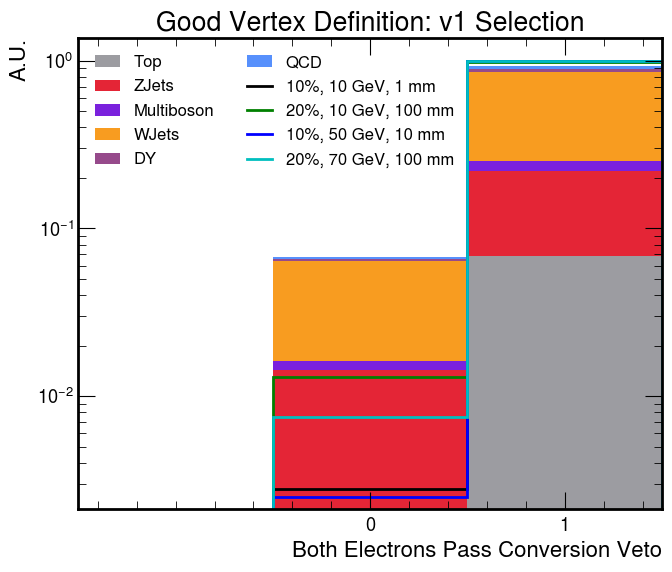

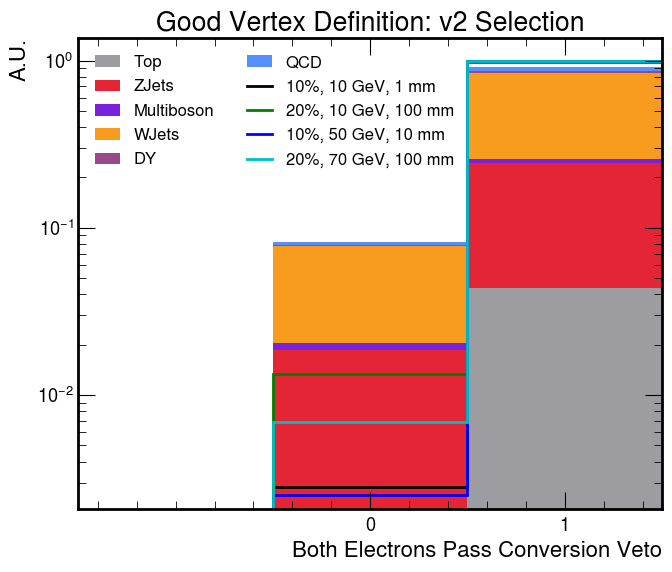

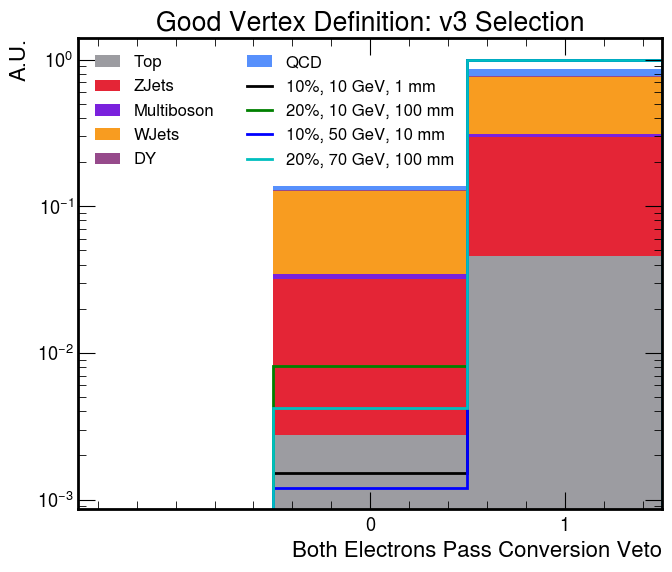

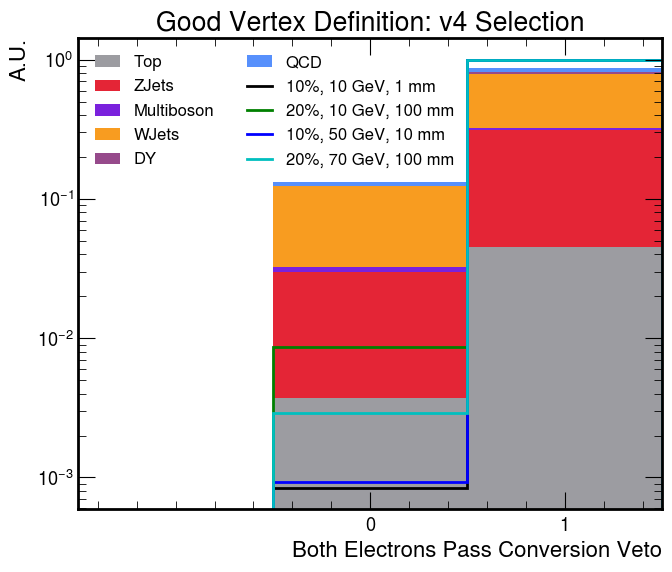

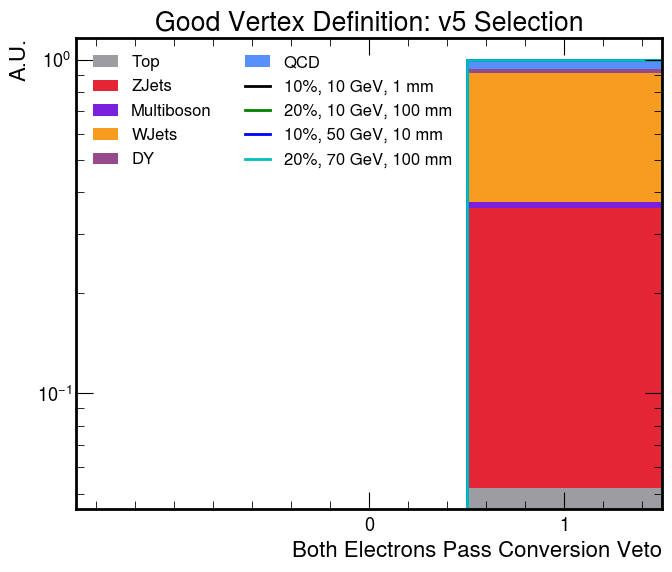

In [9]:
for i,CUT in enumerate(cuts):
    CUT = cuts[i]
    title = f"Good Vertex Definition: {descriptions[i]}"
    outD = f"plots_vtxStudy/plots_observables/{CUT}"
    outName = "sel_vtx_e1e2PassConvVeto_selectedSignals"+f"_{CUT}"
    selection = {"cut":CUT,"vtype":sum}
    xlabel = r"Both Electrons Pass Conversion Veto"
    ylabel = "A.U."
    plot_samples_sigBkg(hcs,hcb,"sel_vtx_e1e2PassConvVeto",selection,selected_signals,selected_labels,outName,outD,
                 figsize=(7,6),xlim=[-1,2],ncol_leg=2,xlabel=xlabel,ylabel=ylabel,rebin=1j,legend_loc='upper left',
                    save=True,show=True,logy=True,density=True,title=title,histtype='step',yerr=False)

# Purity summaries

In [5]:
hcs_withdR = histContainer("skimmed_signal_histos_vtxStudy.coffea")
hcs_nodR = histContainer("skimmed_signal_histos_vtxStudy_IDBasic.coffea")
dfs = utils.get_dict_fromCutflow(hcs_withdR.load('cutflow'))
dfs['legend'] = dfs.apply(make_label,axis=1)

In [6]:
pur = hcs_withdR.load("sel_vtx_recoCat")
pur_base = hcs_nodR.load("sel_vtx_recoCat")

In [7]:
# plot signal composition at each stage
cuts = ['cut0', 'cut1', 'cut2', 'cut3', 'cut4', 'cut5', 'cut6']
#cuts = ['cut0']
cutDesc = hcs_withdR.load('cutDesc')
cutDescs = [cutDesc[c] for c in cuts]
for icut,CUT in enumerate(cuts):
    outDir = f"plots_vtxStudy/signalComposition_byVtxDef/{CUT}/"
    deltas = sorted(list(set(dfs.delta)))
    #fig,axes = plt.subplots(2,3,figsize=(24,12))
    for j,delta in enumerate(deltas):
        dfsel = dfs[dfs.delta==delta]
        ctaus = sorted(list(set(dfsel.ctau)))
        for i,ct in enumerate(ctaus):
            #plt.sca(axes[j,i])
            plt.figure(figsize=(12,6))
            dfsel1 = dfsel[dfsel.ctau==ct]
            m1s = np.array(sorted(list(set(dfsel1.m1))))
            stack_labels = ["No Reco","Reco + Fail ID", "Reco + ID + No Vtx", "Reco + ID + Bad Vtx", 
                            "Reco + ID + Good Vtx + Unsel", "Reco + ID + Good Vtx + Sel"]
            stack = [np.array([]) for _ in stack_labels]
            stack_base = [np.array([]) for _ in stack_labels]
            for i,m1 in enumerate(m1s):
                samp = dfsel1[dfsel1.m1==m1].name.item()

                # Fill stacks for the normal ID (with dR < 0.4)
                hpur = pur[{"samp":samp,"cut":CUT}]
                total = hpur[{"recoCat":"total"}].value
                stack[0] = np.append(stack[0], hpur[{"recoCat":"noEEreco"}].value / total)
                stack[1] = np.append(stack[1], hpur[{"recoCat":"eeReco_noID"}].value / total)
                stack[2] = np.append(stack[2], hpur[{"recoCat":"eeReco_ID_noVtx"}].value / total)
                stack[3] = np.append(stack[3], hpur[{"recoCat":"eeReco_ID_hasVtx_bad"}].value / total)
                stack[4] = np.append(stack[4], hpur[{"recoCat":"eeReco_ID_hasVtx_good_unSel"}].value / total)
                stack[5] = np.append(stack[5], hpur[{"recoCat":"eeReco_ID_hasVtx_good_sel"}].value / total)

                # Fill stacks for the baseline ID
                hpur = pur_base[{"samp":samp,"cut":CUT}]
                total = hpur[{"recoCat":"total"}].value
                stack_base[0] = np.append(stack_base[0], hpur[{"recoCat":"noEEreco"}].value / total)
                stack_base[1] = np.append(stack_base[1], hpur[{"recoCat":"eeReco_noID"}].value / total)
                stack_base[2] = np.append(stack_base[2], hpur[{"recoCat":"eeReco_ID_noVtx"}].value / total)
                stack_base[3] = np.append(stack_base[3], hpur[{"recoCat":"eeReco_ID_hasVtx_bad"}].value / total)
                stack_base[4] = np.append(stack_base[4], hpur[{"recoCat":"eeReco_ID_hasVtx_good_unSel"}].value / total)
                stack_base[5] = np.append(stack_base[5], hpur[{"recoCat":"eeReco_ID_hasVtx_good_sel"}].value / total)

            width = 0.35
            x = np.arange(len(m1s))
            xlabels = [rf"${int(m1)}$ GeV" for m1 in m1s]
            bottoms = np.zeros_like(stack[0])
            bottoms_base = np.zeros_like(stack_base[0])
            handles = []
            for k in range(len(stack)):
                plt.bar(x-0.4,stack[k],bottom=bottoms,width=width,color=f"C{k}",label=stack_labels[k],align='edge')
                bottoms += stack[k]
                plt.bar(x,stack_base[k],width=width,color=f"C{k}",bottom=bottoms_base,align='edge',hatch="o")
                bottoms_base += stack_base[k]
            plt.xticks(x,labels=xlabels,rotation=45)
            plt.grid()
            
            plt.ylim([0,1.3])
            plt.ylabel("Fraction of Surviving Events")
            legend1 = plt.legend(ncol=2,loc='upper left')
            plt.gca().add_artist(legend1)
            
            handles = [Patch(facecolor='forestgreen',edgecolor='black',label=r"ID + $\min\Delta R(e,\mathrm{jets}) > 0.4$"),
                       Patch(facecolor='forestgreen',edgecolor='black',label="ID only",hatch='o')]
            plt.legend(handles=handles,loc='upper right')
            
            plt.title(f"$\Delta = {delta}$, $c\\tau = {int(ct)}$ mm, Vertex: {cutDescs[icut]}")
            outName = f"signalComposition_compareIDTypes_delta{delta}_ctau{int(ct)}_{CUT}.pdf"
            if not os.path.isdir(outDir):
                os.makedirs(outDir,exist_ok=True)
            plt.tight_layout()
            plt.savefig(f"{outDir}/{outName}")
            plt.close()

In [8]:
# plot signal yields at each stage
cuts = ['cut0', 'cut1', 'cut2', 'cut3', 'cut4', 'cut5','cut6']
#cuts = ['cut2']
cutDesc = hcs_withdR.load('cutDesc')
cutDescs = [cutDesc[c] for c in cuts]
for icut,CUT in enumerate(cuts):
    outDir = f"plots_vtxStudy/signalYieldComposition_byVtxDef/{CUT}/"
    deltas = sorted(list(set(dfs.delta)))
    #fig,axes = plt.subplots(2,3,figsize=(24,12))
    for j,delta in enumerate(deltas):
        dfsel = dfs[dfs.delta==delta]
        ctaus = sorted(list(set(dfsel.ctau)))
        for i,ct in enumerate(ctaus):
            #plt.sca(axes[j,i])
            plt.figure(figsize=(12,6))
            dfsel1 = dfsel[dfsel.ctau==ct]
            m1s = np.array(sorted(list(set(dfsel1.m1))))
            stack_labels = ["No Reco","Reco + Fail ID", "Reco + ID + No Vtx", "Reco + ID + Bad Vtx", 
                            "Reco + ID + Good Vtx + Unsel", "Reco + ID + Good Vtx + Sel"]
            stack = [np.array([]) for _ in stack_labels]
            stack_base = [np.array([]) for _ in stack_labels]
            for i,m1 in enumerate(m1s):
                samp = dfsel1[dfsel1.m1==m1].name.item()

                # Fill stacks for the normal ID (with dR < 0.4)
                hpur = pur[{"samp":samp,"cut":CUT}]
                #total = hpur[{"recoCat":"total"}].value
                total = 1
                stack[0] = np.append(stack[0], hpur[{"recoCat":"noEEreco"}].value / total)
                stack[1] = np.append(stack[1], hpur[{"recoCat":"eeReco_noID"}].value / total)
                stack[2] = np.append(stack[2], hpur[{"recoCat":"eeReco_ID_noVtx"}].value / total)
                stack[3] = np.append(stack[3], hpur[{"recoCat":"eeReco_ID_hasVtx_bad"}].value / total)
                stack[4] = np.append(stack[4], hpur[{"recoCat":"eeReco_ID_hasVtx_good_unSel"}].value / total)
                stack[5] = np.append(stack[5], hpur[{"recoCat":"eeReco_ID_hasVtx_good_sel"}].value / total)

                # Fill stacks for the baseline ID
                hpur = pur_base[{"samp":samp,"cut":CUT}]
                #total = hpur[{"recoCat":"total"}].value
                total = 1
                stack_base[0] = np.append(stack_base[0], hpur[{"recoCat":"noEEreco"}].value / total)
                stack_base[1] = np.append(stack_base[1], hpur[{"recoCat":"eeReco_noID"}].value / total)
                stack_base[2] = np.append(stack_base[2], hpur[{"recoCat":"eeReco_ID_noVtx"}].value / total)
                stack_base[3] = np.append(stack_base[3], hpur[{"recoCat":"eeReco_ID_hasVtx_bad"}].value / total)
                stack_base[4] = np.append(stack_base[4], hpur[{"recoCat":"eeReco_ID_hasVtx_good_unSel"}].value / total)
                stack_base[5] = np.append(stack_base[5], hpur[{"recoCat":"eeReco_ID_hasVtx_good_sel"}].value / total)

            width = 0.35
            x = np.arange(len(m1s))
            xlabels = [rf"${int(m1)}$ GeV" for m1 in m1s]
            bottoms = np.zeros_like(stack[0])
            bottoms_base = np.zeros_like(stack_base[0])
            handles = []
            ymax = 0
            for k in range(len(stack)):
                plt.bar(x-0.4,stack[k],bottom=bottoms,width=width,color=f"C{k}",label=stack_labels[k],align='edge')
                bottoms += stack[k]
                plt.bar(x,stack_base[k],width=width,color=f"C{k}",bottom=bottoms_base,align='edge',hatch="o")
                bottoms_base += stack_base[k]
                ymax = max(ymax,max(np.max(stack[k]),np.max(stack_base[k])))
            plt.xticks(x,labels=xlabels,rotation=45)
            plt.grid()
            
            plt.yscale('log')
            plt.ylim([None,10*ymax])
            plt.ylabel("Events")
            legend1 = plt.legend(ncol=2,loc='upper left')
            plt.gca().add_artist(legend1)
            
            handles = [Patch(facecolor='forestgreen',edgecolor='black',label=r"ID + $\min\Delta R(e,\mathrm{jets}) > 0.4$"),
                       Patch(facecolor='forestgreen',edgecolor='black',label="ID only",hatch='o')]
            plt.legend(handles=handles,loc='upper right')
            
            plt.title(f"$\Delta = {delta}$, $c\\tau = {int(ct)}$ mm, Vertex: {cutDescs[icut]}")
            outName = f"signalYieldComposition_compareIDTypes_delta{delta}_ctau{int(ct)}_{CUT}.pdf"
            if not os.path.isdir(outDir):
                os.makedirs(outDir,exist_ok=True)
            plt.tight_layout()
            plt.savefig(f"{outDir}/{outName}")
            plt.close()

## all cuts superimposed, ID with $\Delta R$

In [12]:
# plot signal yields at each stage
cuts = ['cut0', 'cut1', 'cut2', 'cut3', 'cut4', 'cut5','cut6']
cutDesc = hcs_withdR.load('cutDesc')
cutDescs = [cutDesc[c] for c in cuts]
outDir = f"plots_vtxStudy/signalYieldComposition_cutSummary_dRID/"
deltas = sorted(list(set(dfs.delta)))
#fig,axes = plt.subplots(2,3,figsize=(24,12))
for j,delta in enumerate(deltas):
    dfsel = dfs[dfs.delta==delta]
    ctaus = sorted(list(set(dfsel.ctau)))
    for i,ct in enumerate(ctaus):
        #plt.sca(axes[j,i])
        plt.figure(figsize=(12,6))
        dfsel1 = dfsel[dfsel.ctau==ct]
        m1s = np.array(sorted(list(set(dfsel1.m1))))
        stack_labels = ["No Reco","Reco + Fail ID", "Reco + ID + No Vtx", "Reco + ID + Bad Vtx", 
                        "Reco + ID + Good Vtx + Unsel", "Reco + ID + Good Vtx + Sel"]
        stack = [[np.array([]) for _ in stack_labels] for _ in cuts]
        for i,m1 in enumerate(m1s):
            samp = dfsel1[dfsel1.m1==m1].name.item()
            for k,CUT in enumerate(cuts):
                # Fill stacks for the normal ID (with dR < 0.4)
                hpur = pur[{"samp":samp,"cut":CUT}]
                #total = hpur[{"recoCat":"total"}].value
                total = 1
                stack[k][0] = np.append(stack[k][0], hpur[{"recoCat":"noEEreco"}].value / total)
                stack[k][1] = np.append(stack[k][1], hpur[{"recoCat":"eeReco_noID"}].value / total)
                stack[k][2] = np.append(stack[k][2], hpur[{"recoCat":"eeReco_ID_noVtx"}].value / total)
                stack[k][3] = np.append(stack[k][3], hpur[{"recoCat":"eeReco_ID_hasVtx_bad"}].value / total)
                stack[k][4] = np.append(stack[k][4], hpur[{"recoCat":"eeReco_ID_hasVtx_good_unSel"}].value / total)
                stack[k][5] = np.append(stack[k][5], hpur[{"recoCat":"eeReco_ID_hasVtx_good_sel"}].value / total)
        w_total = 0.9
        w_individual = w_total/len(cuts)
        x = np.arange(len(m1s))
        sub_x = [x - w_total/2 + icut*w_individual for icut in range(len(cuts))]
        xlabels = [rf"${int(m1)}$ GeV" for m1 in m1s]
        handles = []
        ymax = 0
        for l in range(len(cuts)):
            bottoms = np.zeros_like(stack[l][0])
            for k in range(len(stack[l])):
                if l==0:
                    plt.bar(sub_x[l],stack[l][k],bottom=bottoms,width=w_individual,color=f"C{k}",label=stack_labels[k],align='edge')
                else:
                    plt.bar(sub_x[l],stack[l][k],bottom=bottoms,width=w_individual,color=f"C{k}",align='edge')
                bottoms += stack[l][k]
                ymax = max(ymax,np.max(stack[l][k]))
            plt.xticks(x,labels=xlabels,rotation=45)
        plt.grid(axis='y')

        plt.yscale('log')
        plt.ylim([None,30*ymax])
        plt.ylabel("Events")
        legend1 = plt.legend(ncol=2,loc='upper left')
        plt.gca().add_artist(legend1)

        plt.title(f"$\Delta = {delta}$, $c\\tau = {int(ct)}$ mm")
        plt.tight_layout()
        outName = f"signalYieldComposition_dRID_delta{delta}_ctau{int(ct)}.pdf"
        if not os.path.isdir(outDir):
            os.makedirs(outDir,exist_ok=True)
        plt.savefig(f"{outDir}/{outName}")
        plt.close()

In [13]:
# plot signal yields at each stage
cuts = ['cut0', 'cut1', 'cut2', 'cut3', 'cut4', 'cut5','cut6']
#cuts = ['cut2']
cutDesc = hcs_withdR.load('cutDesc')
cutDescs = [cutDesc[c] for c in cuts]
outDir = f"plots_vtxStudy/signalComposition_cutSummary_dRID/"
deltas = sorted(list(set(dfs.delta)))
#fig,axes = plt.subplots(2,3,figsize=(24,12))
for j,delta in enumerate(deltas):
    dfsel = dfs[dfs.delta==delta]
    ctaus = sorted(list(set(dfsel.ctau)))
    for i,ct in enumerate(ctaus):
        #plt.sca(axes[j,i])
        plt.figure(figsize=(12,6))
        dfsel1 = dfsel[dfsel.ctau==ct]
        m1s = np.array(sorted(list(set(dfsel1.m1))))
        stack_labels = ["No Reco","Reco + Fail ID", "Reco + ID + No Vtx", "Reco + ID + Bad Vtx", 
                        "Reco + ID + Good Vtx + Unsel", "Reco + ID + Good Vtx + Sel"]
        stack = [[np.array([]) for _ in stack_labels] for _ in cuts]
        for i,m1 in enumerate(m1s):
            samp = dfsel1[dfsel1.m1==m1].name.item()
            for k,CUT in enumerate(cuts):
                # Fill stacks for the normal ID (with dR < 0.4)
                hpur = pur[{"samp":samp,"cut":CUT}]
                total = hpur[{"recoCat":"total"}].value
                #total = 1
                stack[k][0] = np.append(stack[k][0], hpur[{"recoCat":"noEEreco"}].value / total)
                stack[k][1] = np.append(stack[k][1], hpur[{"recoCat":"eeReco_noID"}].value / total)
                stack[k][2] = np.append(stack[k][2], hpur[{"recoCat":"eeReco_ID_noVtx"}].value / total)
                stack[k][3] = np.append(stack[k][3], hpur[{"recoCat":"eeReco_ID_hasVtx_bad"}].value / total)
                stack[k][4] = np.append(stack[k][4], hpur[{"recoCat":"eeReco_ID_hasVtx_good_unSel"}].value / total)
                stack[k][5] = np.append(stack[k][5], hpur[{"recoCat":"eeReco_ID_hasVtx_good_sel"}].value / total)
                
        w_total = 0.9
        w_individual = w_total/len(cuts)
        x = np.arange(len(m1s))
        sub_x = [x - w_total/2 + icut*w_individual for icut in range(len(cuts))]
        xlabels = [rf"${int(m1)}$ GeV" for m1 in m1s]
        handles = []
        ymax = 0
        for l in range(len(cuts)):
            bottoms = np.zeros_like(stack[l][0])
            for k in range(len(stack[l])):
                if l==0:
                    plt.bar(sub_x[l],stack[l][k],bottom=bottoms,width=w_individual,color=f"C{k}",label=stack_labels[k],align='edge')
                else:
                    plt.bar(sub_x[l],stack[l][k],bottom=bottoms,width=w_individual,color=f"C{k}",align='edge')
                bottoms += stack[l][k]
                ymax = max(ymax,np.max(stack[l][k]))
            plt.xticks(x,labels=xlabels,rotation=45)
        plt.grid(axis='y')

        plt.ylim([0,1.3])
        plt.ylabel("Fraction of Surviving Events")
        legend1 = plt.legend(ncol=2,loc='upper left')
        plt.gca().add_artist(legend1)

        plt.title(f"$\Delta = {delta}$, $c\\tau = {int(ct)}$ mm")
        plt.tight_layout()
        outName = f"signalComposition_dRID_delta{delta}_ctau{int(ct)}.pdf"
        if not os.path.isdir(outDir):
            os.makedirs(outDir,exist_ok=True)
        plt.savefig(f"{outDir}/{outName}")
        plt.close()

In [14]:
# plot signal yields at each stage
cuts = ['cut0', 'cut1', 'cut2', 'cut3', 'cut4', 'cut5','cut6']
#cuts = ['cut2']
cutDesc = hcs_withdR.load('cutDesc')
cutDescs = [cutDesc[c] for c in cuts]
outDir = f"plots_vtxStudy/signalComposition_normCut0_dRID_cutSummary/"
deltas = sorted(list(set(dfs.delta)))
#fig,axes = plt.subplots(2,3,figsize=(24,12))
for j,delta in enumerate(deltas):
    dfsel = dfs[dfs.delta==delta]
    ctaus = sorted(list(set(dfsel.ctau)))
    for i,ct in enumerate(ctaus):
        #plt.sca(axes[j,i])
        plt.figure(figsize=(12,6))
        dfsel1 = dfsel[dfsel.ctau==ct]
        m1s = np.array(sorted(list(set(dfsel1.m1))))
        stack_labels = ["No Reco","Reco + Fail ID", "Reco + ID + No Vtx", "Reco + ID + Bad Vtx", 
                        "Reco + ID + Good Vtx + Unsel", "Reco + ID + Good Vtx + Sel"]
        stack = [[np.array([]) for _ in stack_labels] for _ in cuts]
        for i,m1 in enumerate(m1s):
            samp = dfsel1[dfsel1.m1==m1].name.item()
            total = pur[{"samp":samp,"cut":"cut0","recoCat":"total"}].value
            for k,CUT in enumerate(cuts):
                # Fill stacks for the normal ID (with dR < 0.4)
                hpur = pur[{"samp":samp,"cut":CUT}]
                #total = hpur[{"recoCat":"total"}].value
                #total = 1
                stack[k][0] = np.append(stack[k][0], hpur[{"recoCat":"noEEreco"}].value / total)
                stack[k][1] = np.append(stack[k][1], hpur[{"recoCat":"eeReco_noID"}].value / total)
                stack[k][2] = np.append(stack[k][2], hpur[{"recoCat":"eeReco_ID_noVtx"}].value / total)
                stack[k][3] = np.append(stack[k][3], hpur[{"recoCat":"eeReco_ID_hasVtx_bad"}].value / total)
                stack[k][4] = np.append(stack[k][4], hpur[{"recoCat":"eeReco_ID_hasVtx_good_unSel"}].value / total)
                stack[k][5] = np.append(stack[k][5], hpur[{"recoCat":"eeReco_ID_hasVtx_good_sel"}].value / total)
                
        w_total = 0.9
        w_individual = w_total/len(cuts)
        x = np.arange(len(m1s))
        sub_x = [x - w_total/2 + icut*w_individual for icut in range(len(cuts))]
        xlabels = [rf"${int(m1)}$ GeV" for m1 in m1s]
        handles = []
        ymax = 0
        for l in range(len(cuts)):
            bottoms = np.zeros_like(stack[l][0])
            for k in range(len(stack[l])):
                if l==0:
                    plt.bar(sub_x[l],stack[l][k],bottom=bottoms,width=w_individual,color=f"C{k}",label=stack_labels[k],align='edge')
                else:
                    plt.bar(sub_x[l],stack[l][k],bottom=bottoms,width=w_individual,color=f"C{k}",align='edge')
                bottoms += stack[l][k]
                ymax = max(ymax,np.max(stack[l][k]))
            plt.xticks(x,labels=xlabels,rotation=45)
        plt.grid(axis='y')

        plt.ylim([0,1.3])
        plt.ylabel("Fraction (Relative to No Cuts)")
        legend1 = plt.legend(ncol=2,loc='upper left')
        plt.gca().add_artist(legend1)

        plt.title(f"$\Delta = {delta}$, $c\\tau = {int(ct)}$ mm")
        plt.tight_layout()
        outName = f"signalComposition_normCut0_dRID_delta{delta}_ctau{int(ct)}.pdf"
        if not os.path.isdir(outDir):
            os.makedirs(outDir,exist_ok=True)
        plt.savefig(f"{outDir}/{outName}")
        plt.close()

## all cuts superimposed, base ID

In [15]:
# plot signal yields at each stage
cuts = ['cut0', 'cut1', 'cut2', 'cut3', 'cut4', 'cut5']
cutDesc = hcs_withdR.load('cutDesc')
cutDescs = [cutDesc[c] for c in cuts]
outDir = f"plots_vtxStudy/signalYieldComposition_cutSummary_BaseID/"
deltas = sorted(list(set(dfs.delta)))
#fig,axes = plt.subplots(2,3,figsize=(24,12))
for j,delta in enumerate(deltas):
    dfsel = dfs[dfs.delta==delta]
    ctaus = sorted(list(set(dfsel.ctau)))
    for i,ct in enumerate(ctaus):
        #plt.sca(axes[j,i])
        plt.figure(figsize=(12,6))
        dfsel1 = dfsel[dfsel.ctau==ct]
        m1s = np.array(sorted(list(set(dfsel1.m1))))
        stack_labels = ["No Reco","Reco + Fail ID", "Reco + ID + No Vtx", "Reco + ID + Bad Vtx", 
                        "Reco + ID + Good Vtx + Unsel", "Reco + ID + Good Vtx + Sel"]
        stack = [[np.array([]) for _ in stack_labels] for _ in cuts]
        for i,m1 in enumerate(m1s):
            samp = dfsel1[dfsel1.m1==m1].name.item()
            for k,CUT in enumerate(cuts):
                # Fill stacks for the normal ID (with dR < 0.4)
                hpur = pur_base[{"samp":samp,"cut":CUT}]
                #total = hpur[{"recoCat":"total"}].value
                total = 1
                stack[k][0] = np.append(stack[k][0], hpur[{"recoCat":"noEEreco"}].value / total)
                stack[k][1] = np.append(stack[k][1], hpur[{"recoCat":"eeReco_noID"}].value / total)
                stack[k][2] = np.append(stack[k][2], hpur[{"recoCat":"eeReco_ID_noVtx"}].value / total)
                stack[k][3] = np.append(stack[k][3], hpur[{"recoCat":"eeReco_ID_hasVtx_bad"}].value / total)
                stack[k][4] = np.append(stack[k][4], hpur[{"recoCat":"eeReco_ID_hasVtx_good_unSel"}].value / total)
                stack[k][5] = np.append(stack[k][5], hpur[{"recoCat":"eeReco_ID_hasVtx_good_sel"}].value / total)
        w_total = 0.9
        w_individual = w_total/len(cuts)
        x = np.arange(len(m1s))
        sub_x = [x - w_total/2 + icut*w_individual for icut in range(len(cuts))]
        xlabels = [rf"${int(m1)}$ GeV" for m1 in m1s]
        handles = []
        ymax = 0
        for l in range(len(cuts)):
            bottoms = np.zeros_like(stack[l][0])
            for k in range(len(stack[l])):
                if l==0:
                    plt.bar(sub_x[l],stack[l][k],bottom=bottoms,width=w_individual,color=f"C{k}",label=stack_labels[k],align='edge')
                else:
                    plt.bar(sub_x[l],stack[l][k],bottom=bottoms,width=w_individual,color=f"C{k}",align='edge')
                bottoms += stack[l][k]
                ymax = max(ymax,np.max(stack[l][k]))
            plt.xticks(x,labels=xlabels,rotation=45)
        plt.grid(axis='y')

        plt.yscale('log')
        plt.ylim([None,30*ymax])
        plt.ylabel("Events")
        legend1 = plt.legend(ncol=2,loc='upper left')
        plt.gca().add_artist(legend1)

        plt.title(f"$\Delta = {delta}$, $c\\tau = {int(ct)}$ mm")
        plt.tight_layout()
        outName = f"signalYieldComposition_BaseID_delta{delta}_ctau{int(ct)}.pdf"
        if not os.path.isdir(outDir):
            os.makedirs(outDir,exist_ok=True)
        plt.savefig(f"{outDir}/{outName}")
        plt.close()

In [16]:
# plot signal yields at each stage
cuts = ['cut0', 'cut1', 'cut2', 'cut3', 'cut4', 'cut5']
#cuts = ['cut2']
cutDesc = hcs_withdR.load('cutDesc')
cutDescs = [cutDesc[c] for c in cuts]
outDir = f"plots_vtxStudy/signalComposition_cutSummary_BaseID/"
deltas = sorted(list(set(dfs.delta)))
#fig,axes = plt.subplots(2,3,figsize=(24,12))
for j,delta in enumerate(deltas):
    dfsel = dfs[dfs.delta==delta]
    ctaus = sorted(list(set(dfsel.ctau)))
    for i,ct in enumerate(ctaus):
        #plt.sca(axes[j,i])
        plt.figure(figsize=(12,6))
        dfsel1 = dfsel[dfsel.ctau==ct]
        m1s = np.array(sorted(list(set(dfsel1.m1))))
        stack_labels = ["No Reco","Reco + Fail ID", "Reco + ID + No Vtx", "Reco + ID + Bad Vtx", 
                        "Reco + ID + Good Vtx + Unsel", "Reco + ID + Good Vtx + Sel"]
        stack = [[np.array([]) for _ in stack_labels] for _ in cuts]
        for i,m1 in enumerate(m1s):
            samp = dfsel1[dfsel1.m1==m1].name.item()
            for k,CUT in enumerate(cuts):
                # Fill stacks for the normal ID (with dR < 0.4)
                hpur = pur_base[{"samp":samp,"cut":CUT}]
                total = hpur[{"recoCat":"total"}].value
                #total = 1
                stack[k][0] = np.append(stack[k][0], hpur[{"recoCat":"noEEreco"}].value / total)
                stack[k][1] = np.append(stack[k][1], hpur[{"recoCat":"eeReco_noID"}].value / total)
                stack[k][2] = np.append(stack[k][2], hpur[{"recoCat":"eeReco_ID_noVtx"}].value / total)
                stack[k][3] = np.append(stack[k][3], hpur[{"recoCat":"eeReco_ID_hasVtx_bad"}].value / total)
                stack[k][4] = np.append(stack[k][4], hpur[{"recoCat":"eeReco_ID_hasVtx_good_unSel"}].value / total)
                stack[k][5] = np.append(stack[k][5], hpur[{"recoCat":"eeReco_ID_hasVtx_good_sel"}].value / total)
                
        w_total = 0.9
        w_individual = w_total/len(cuts)
        x = np.arange(len(m1s))
        sub_x = [x - w_total/2 + icut*w_individual for icut in range(len(cuts))]
        xlabels = [rf"${int(m1)}$ GeV" for m1 in m1s]
        handles = []
        ymax = 0
        for l in range(len(cuts)):
            bottoms = np.zeros_like(stack[l][0])
            for k in range(len(stack[l])):
                if l==0:
                    plt.bar(sub_x[l],stack[l][k],bottom=bottoms,width=w_individual,color=f"C{k}",label=stack_labels[k],align='edge')
                else:
                    plt.bar(sub_x[l],stack[l][k],bottom=bottoms,width=w_individual,color=f"C{k}",align='edge')
                bottoms += stack[l][k]
                ymax = max(ymax,np.max(stack[l][k]))
            plt.xticks(x,labels=xlabels,rotation=45)
        plt.grid(axis='y')

        plt.ylim([0,1.3])
        plt.ylabel("Fraction of Surviving Events")
        legend1 = plt.legend(ncol=2,loc='upper left')
        plt.gca().add_artist(legend1)

        plt.title(f"$\Delta = {delta}$, $c\\tau = {int(ct)}$ mm")
        plt.tight_layout()
        outName = f"signalComposition_BaseID_delta{delta}_ctau{int(ct)}.pdf"
        if not os.path.isdir(outDir):
            os.makedirs(outDir,exist_ok=True)
        plt.savefig(f"{outDir}/{outName}")
        plt.close()

In [17]:
# plot signal yields at each stage
cuts = ['cut0', 'cut1', 'cut2', 'cut3', 'cut4', 'cut5']
#cuts = ['cut2']
cutDesc = hcs_withdR.load('cutDesc')
cutDescs = [cutDesc[c] for c in cuts]
outDir = f"plots_vtxStudy/signalComposition_normCut0_BaseID_cutSummary/"
deltas = sorted(list(set(dfs.delta)))
#fig,axes = plt.subplots(2,3,figsize=(24,12))
for j,delta in enumerate(deltas):
    dfsel = dfs[dfs.delta==delta]
    ctaus = sorted(list(set(dfsel.ctau)))
    for i,ct in enumerate(ctaus):
        #plt.sca(axes[j,i])
        plt.figure(figsize=(12,6))
        dfsel1 = dfsel[dfsel.ctau==ct]
        m1s = np.array(sorted(list(set(dfsel1.m1))))
        stack_labels = ["No Reco","Reco + Fail ID", "Reco + ID + No Vtx", "Reco + ID + Bad Vtx", 
                        "Reco + ID + Good Vtx + Unsel", "Reco + ID + Good Vtx + Sel"]
        stack = [[np.array([]) for _ in stack_labels] for _ in cuts]
        for i,m1 in enumerate(m1s):
            samp = dfsel1[dfsel1.m1==m1].name.item()
            total = pur[{"samp":samp,"cut":"cut0","recoCat":"total"}].value
            for k,CUT in enumerate(cuts):
                # Fill stacks for the normal ID (with dR < 0.4)
                hpur = pur[{"samp":samp,"cut":CUT}]
                #total = hpur[{"recoCat":"total"}].value
                #total = 1
                stack[k][0] = np.append(stack[k][0], hpur[{"recoCat":"noEEreco"}].value / total)
                stack[k][1] = np.append(stack[k][1], hpur[{"recoCat":"eeReco_noID"}].value / total)
                stack[k][2] = np.append(stack[k][2], hpur[{"recoCat":"eeReco_ID_noVtx"}].value / total)
                stack[k][3] = np.append(stack[k][3], hpur[{"recoCat":"eeReco_ID_hasVtx_bad"}].value / total)
                stack[k][4] = np.append(stack[k][4], hpur[{"recoCat":"eeReco_ID_hasVtx_good_unSel"}].value / total)
                stack[k][5] = np.append(stack[k][5], hpur[{"recoCat":"eeReco_ID_hasVtx_good_sel"}].value / total)
                
        w_total = 0.9
        w_individual = w_total/len(cuts)
        x = np.arange(len(m1s))
        sub_x = [x - w_total/2 + icut*w_individual for icut in range(len(cuts))]
        xlabels = [rf"${int(m1)}$ GeV" for m1 in m1s]
        handles = []
        ymax = 0
        for l in range(len(cuts)):
            bottoms = np.zeros_like(stack[l][0])
            for k in range(len(stack[l])):
                if l==0:
                    plt.bar(sub_x[l],stack[l][k],bottom=bottoms,width=w_individual,color=f"C{k}",label=stack_labels[k],align='edge')
                else:
                    plt.bar(sub_x[l],stack[l][k],bottom=bottoms,width=w_individual,color=f"C{k}",align='edge')
                bottoms += stack[l][k]
                ymax = max(ymax,np.max(stack[l][k]))
            plt.xticks(x,labels=xlabels,rotation=45)
        plt.grid(axis='y')

        plt.ylim([0,1.3])
        plt.ylabel("Fraction (Relative to No Cuts)")
        legend1 = plt.legend(ncol=2,loc='upper left')
        plt.gca().add_artist(legend1)

        plt.title(f"$\Delta = {delta}$, $c\\tau = {int(ct)}$ mm")
        plt.tight_layout()
        outName = f"signalComposition_normCut0_BaseID_delta{delta}_ctau{int(ct)}.pdf"
        if not os.path.isdir(outDir):
            os.makedirs(outDir,exist_ok=True)
        plt.savefig(f"{outDir}/{outName}")
        plt.close()

# Purity across vertexing paradigms

In [100]:
hcs = histContainer("skimmed_signal_histos_vtxStudy.coffea")
hcb = histContainer("skimmed_bkg_histos_vtxStudy.coffea",bkg=True)
dfs = utils.get_dict_fromCutflow(hcs.load('cutflow'))
dfs['legend'] = dfs.apply(make_label,axis=1)
selected_signals = ["sig_2018_Mchi-10p5_dMchi-1p0_ctau-1",
                    "sig_2018_Mchi-11p0_dMchi-2p0_ctau-100",
                    "sig_2018_Mchi-52p5_dMchi-5p0_ctau-10",
                    "sig_2018_Mchi-77p0_dMchi-14p0_ctau-100"]
selected_labels = [dfs[dfs.name==s].legend.item() for s in selected_signals]
cuts = ['cut0', 'cut1', 'cut2', 'cut3', 'cut4', 'cut5','cut6']
descriptions = ['All vertices',"Basic Selection","v1 Selection","v2 Selection","v3 Selection","v4 Selection","v5 Selection"]

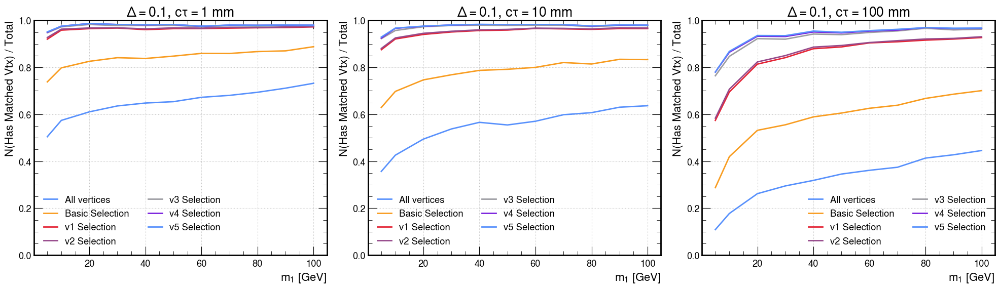

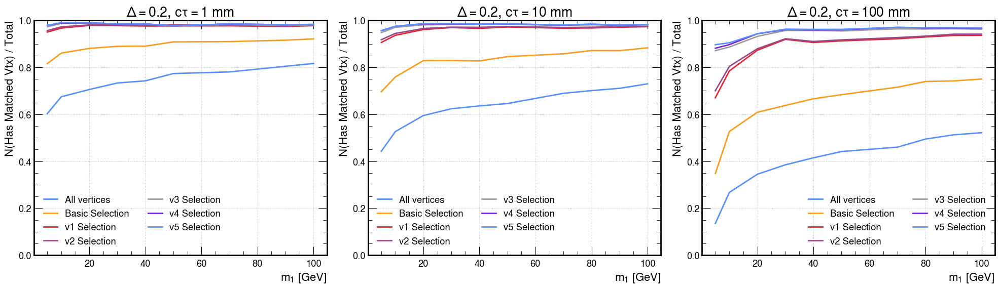

In [104]:
from matplotlib.lines import Line2D

h = hcs.load("sel_vtx_purity")
deltas = sorted(list(set(dfs.delta)))
for delta in deltas:
    fig,axes = plt.subplots(1,3,figsize=(20,6))
    dfsel = dfs[dfs.delta==delta]
    ctaus = sorted(list(set(dfsel.ctau)))
    linestyles = ['-','--','-.']
    for i,ct in enumerate(ctaus):
        plt.sca(axes[i])
        plt.xlabel("$m_1$ [GeV]")
        plt.title(f"$\Delta = {delta}$, $c\\tau = {int(ct)}$ mm")
        dfsel1 = dfsel[dfsel.ctau==ct]
        m1s = sorted(list(set(dfsel1.m1)))
        for j,cut in enumerate(cuts):
            purity = []
            for m1 in m1s:
                samp = dfsel1[dfsel1.m1==m1].name.item()
                hsel = h[{"samp":samp,"cut":cut}]
                num = hsel[{"purity":"n_matched_any"}].value
                denom = hsel[{"purity":"total"}].value
                purity.append(num/denom)
            plt.plot(m1s,purity,linestyle='-',lw=2,color=f"C{j}",label=descriptions[j])
        plt.ylabel("N(Has Matched Vtx) / Total")
        plt.ylim([0,1])
        plt.grid()
        plt.legend(ncol=2)
    plt.tight_layout()
    if not os.path.exists("plots_vtxStudy/efficiencies/"):
        os.makedirs("plots_vtxStudy/efficiencies/",exist_ok=True)
    plt.savefig(f"plots_vtxStudy/efficiencies/hasMatchVtx_any_delta{delta}.pdf")

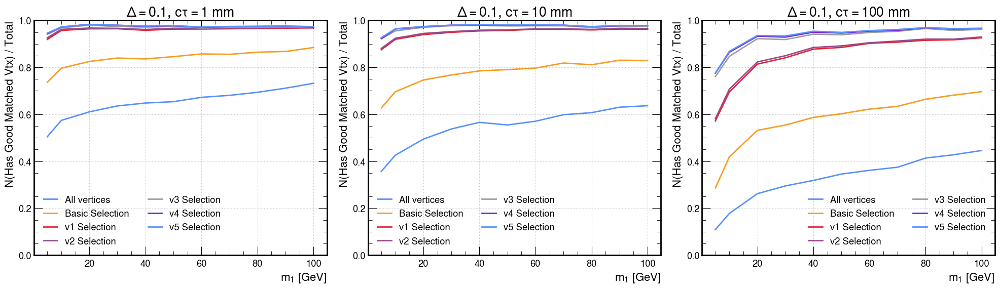

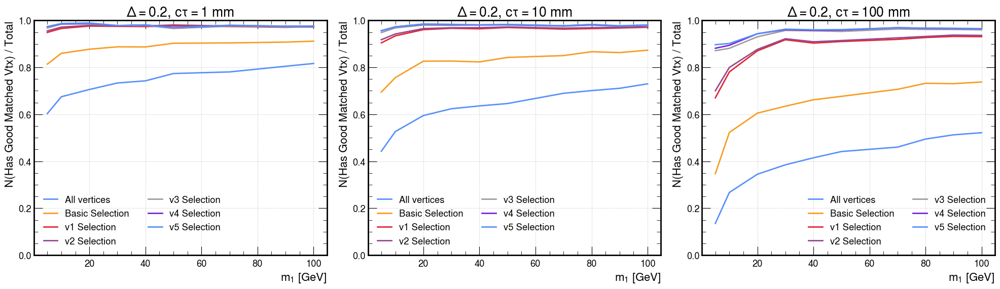

In [107]:
from matplotlib.lines import Line2D

h = hcs.load("sel_vtx_purity")
deltas = sorted(list(set(dfs.delta)))
for delta in deltas:
    fig,axes = plt.subplots(1,3,figsize=(20,6))
    dfsel = dfs[dfs.delta==delta]
    ctaus = sorted(list(set(dfsel.ctau)))
    linestyles = ['-','--','-.']
    for i,ct in enumerate(ctaus):
        plt.sca(axes[i])
        plt.xlabel("$m_1$ [GeV]")
        plt.title(f"$\Delta = {delta}$, $c\\tau = {int(ct)}$ mm")
        dfsel1 = dfsel[dfsel.ctau==ct]
        m1s = sorted(list(set(dfsel1.m1)))
        for j,cut in enumerate(cuts):
            purity = []
            for m1 in m1s:
                samp = dfsel1[dfsel1.m1==m1].name.item()
                hsel = h[{"samp":samp,"cut":cut}]
                num = hsel[{"purity":"n_matched_good"}].value
                denom = hsel[{"purity":"total"}].value
                purity.append(num/denom)
            plt.plot(m1s,purity,linestyle='-',lw=2,color=f"C{j}",label=descriptions[j])
        plt.ylabel("N(Has Good Matched Vtx) / Total")
        plt.ylim([0,1])
        plt.grid()
        plt.legend(ncol=2)
    plt.tight_layout()
    if not os.path.exists("plots_vtxStudy/efficiencies/"):
        os.makedirs("plots_vtxStudy/efficiencies/",exist_ok=True)
    plt.savefig(f"plots_vtxStudy/efficiencies/hasMatchVtx_good_delta{delta}.pdf")

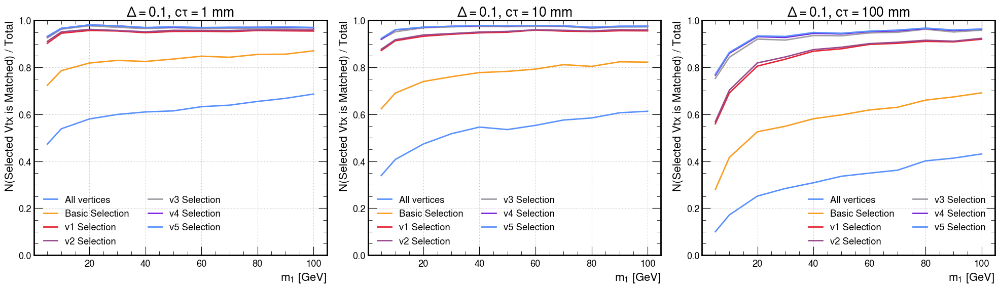

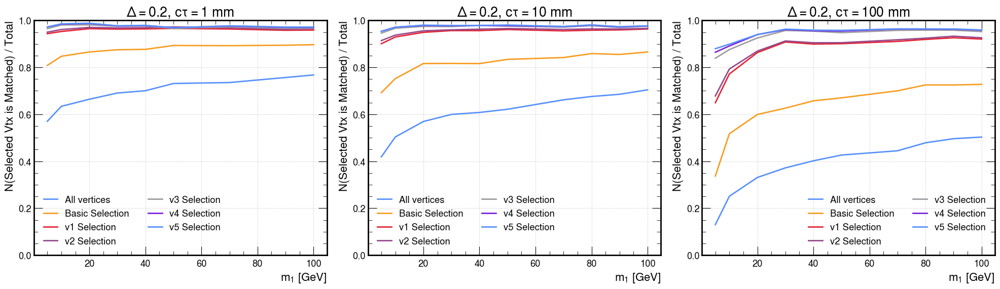

In [108]:
from matplotlib.lines import Line2D

h = hcs.load("sel_vtx_purity")
deltas = sorted(list(set(dfs.delta)))
for delta in deltas:
    fig,axes = plt.subplots(1,3,figsize=(20,6))
    dfsel = dfs[dfs.delta==delta]
    ctaus = sorted(list(set(dfsel.ctau)))
    linestyles = ['-','--','-.']
    for i,ct in enumerate(ctaus):
        plt.sca(axes[i])
        plt.xlabel("$m_1$ [GeV]")
        plt.title(f"$\Delta = {delta}$, $c\\tau = {int(ct)}$ mm")
        dfsel1 = dfsel[dfsel.ctau==ct]
        m1s = sorted(list(set(dfsel1.m1)))
        for j,cut in enumerate(cuts):
            purity = []
            for m1 in m1s:
                samp = dfsel1[dfsel1.m1==m1].name.item()
                hsel = h[{"samp":samp,"cut":cut}]
                num = hsel[{"purity":"n_matched_sel"}].value
                denom = hsel[{"purity":"total"}].value
                purity.append(num/denom)
            plt.plot(m1s,purity,linestyle='-',lw=2,color=f"C{j}",label=descriptions[j])
        plt.ylabel("N(Selected Vtx is Matched) / Total")
        plt.ylim([0,1])
        plt.grid()
        plt.legend(ncol=2)
    plt.tight_layout()
    if not os.path.exists("plots_vtxStudy/efficiencies/"):
        os.makedirs("plots_vtxStudy/efficiencies/",exist_ok=True)
    plt.savefig(f"plots_vtxStudy/efficiencies/hasMatchVtx_sel_delta{delta}.pdf")

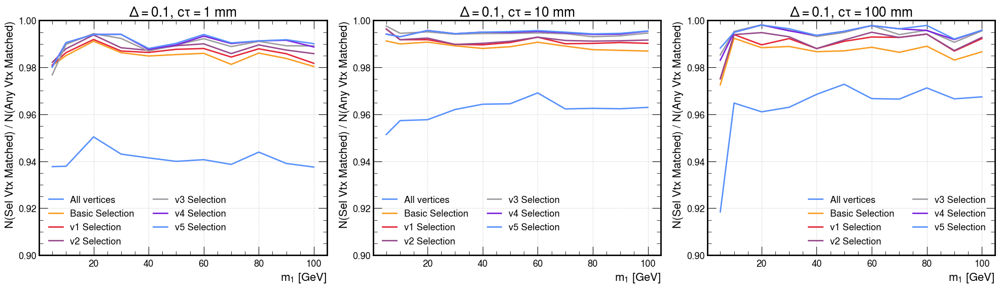

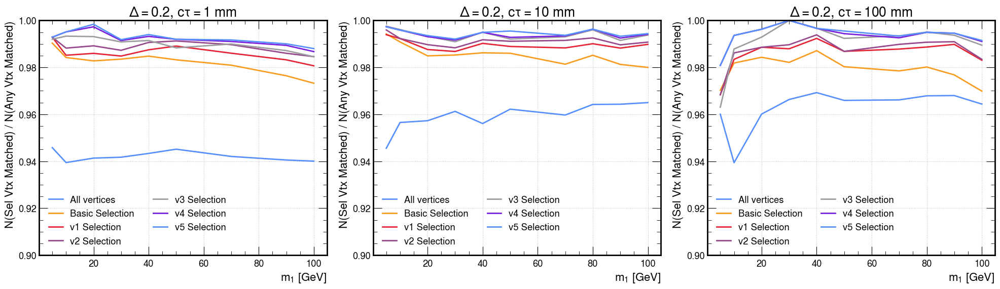

In [112]:
from matplotlib.lines import Line2D

h = hcs.load("sel_vtx_purity")
deltas = sorted(list(set(dfs.delta)))
for delta in deltas:
    fig,axes = plt.subplots(1,3,figsize=(20,6))
    dfsel = dfs[dfs.delta==delta]
    ctaus = sorted(list(set(dfsel.ctau)))
    linestyles = ['-','--','-.']
    for i,ct in enumerate(ctaus):
        plt.sca(axes[i])
        plt.xlabel("$m_1$ [GeV]")
        plt.title(f"$\Delta = {delta}$, $c\\tau = {int(ct)}$ mm")
        dfsel1 = dfsel[dfsel.ctau==ct]
        m1s = sorted(list(set(dfsel1.m1)))
        for j,cut in enumerate(cuts):
            purity = []
            for m1 in m1s:
                samp = dfsel1[dfsel1.m1==m1].name.item()
                hsel = h[{"samp":samp,"cut":cut}]
                num = hsel[{"purity":"n_matched_sel"}].value
                denom = hsel[{"purity":"n_matched_any"}].value
                purity.append(num/denom)
            plt.plot(m1s,purity,linestyle='-',lw=2,color=f"C{j}",label=descriptions[j])
        plt.ylabel("N(Sel Vtx Matched) / N(Any Vtx Matched)")
        plt.ylim([0.9,1])
        plt.grid()
        plt.legend(ncol=2)
    plt.tight_layout()
    if not os.path.exists("plots_vtxStudy/efficiencies/"):
        os.makedirs("plots_vtxStudy/efficiencies/",exist_ok=True)
    plt.savefig(f"plots_vtxStudy/efficiencies/selVtxIsMatched_hasMatchedAny_delta{delta}.pdf")

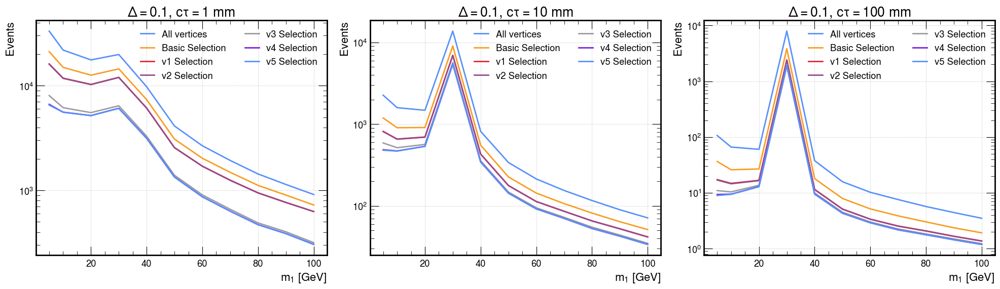

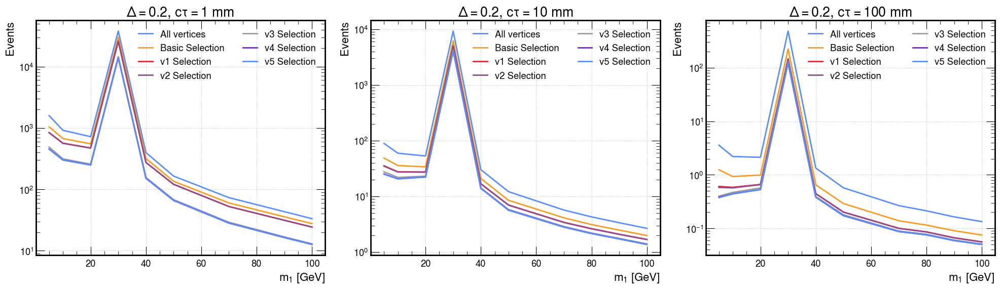

In [115]:
from matplotlib.lines import Line2D

h = hcs.load("sel_vtx_purity")
deltas = sorted(list(set(dfs.delta)))
for delta in deltas:
    fig,axes = plt.subplots(1,3,figsize=(20,6))
    dfsel = dfs[dfs.delta==delta]
    ctaus = sorted(list(set(dfsel.ctau)))
    linestyles = ['-','--','-.']
    for i,ct in enumerate(ctaus):
        plt.sca(axes[i])
        plt.xlabel("$m_1$ [GeV]")
        plt.title(f"$\Delta = {delta}$, $c\\tau = {int(ct)}$ mm")
        dfsel1 = dfsel[dfsel.ctau==ct]
        m1s = sorted(list(set(dfsel1.m1)))
        for j,cut in enumerate(cuts):
            purity = []
            for m1 in m1s:
                samp = dfsel1[dfsel1.m1==m1].name.item()
                hsel = h[{"samp":samp,"cut":cut}]
                num = hsel[{"purity":"total"}].value
                denom = 1
                purity.append(num/denom)
            plt.plot(m1s,purity,linestyle='-',lw=2,color=f"C{j}",label=descriptions[j])
        plt.ylabel("Events")
        plt.yscale('log')
        #plt.ylim([0.9,1])
        plt.grid()
        plt.legend(ncol=2)
    plt.tight_layout()
    if not os.path.exists("plots_vtxStudy/efficiencies/"):
        os.makedirs("plots_vtxStudy/efficiencies/",exist_ok=True)
    plt.savefig(f"plots_vtxStudy/efficiencies/eventYields_delta{delta}.pdf")

# Matched signal vs bkg CDFs

In [59]:
hcs = histContainer("skimmed_signal_histos_vtxStudy.coffea")
hcb = histContainer("skimmed_bkg_histos_vtxStudy.coffea",bkg=True)
cuts = ['cut0', 'cut1', 'cut2', 'cut3', 'cut4', 'cut5','cut6']
descriptions = ['All vertices',"Basic Selection","v1 Selection","v2 Selection","v3 Selection","v4 Selection","v5 Selection"]
dfs = utils.get_dict_fromCutflow(hcs.load('cutflow'))
def make_label(row):
    m1 = int(row['m1'])
    delta = int(100*row['delta'])
    ct = int(row['ctau'])
    label = f"{delta}%, {m1} GeV, {ct} mm"
    return label
dfs['legend'] = dfs.apply(make_label,axis=1)

/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not plac

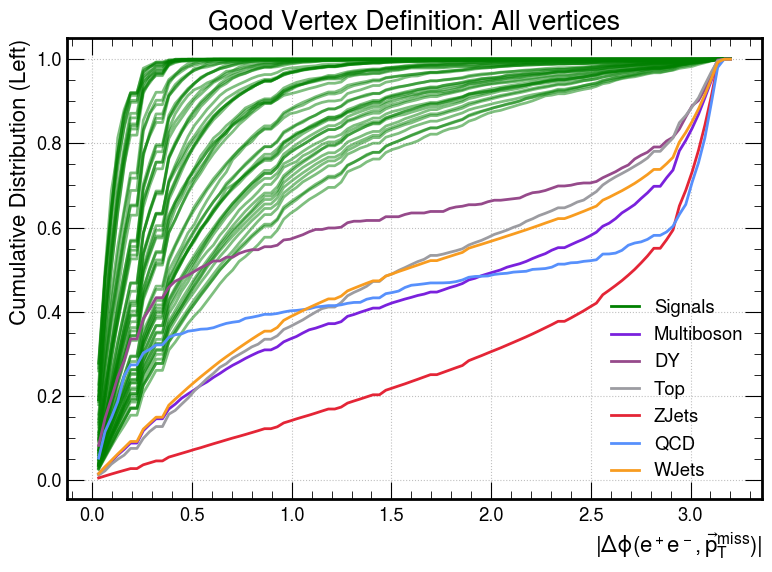

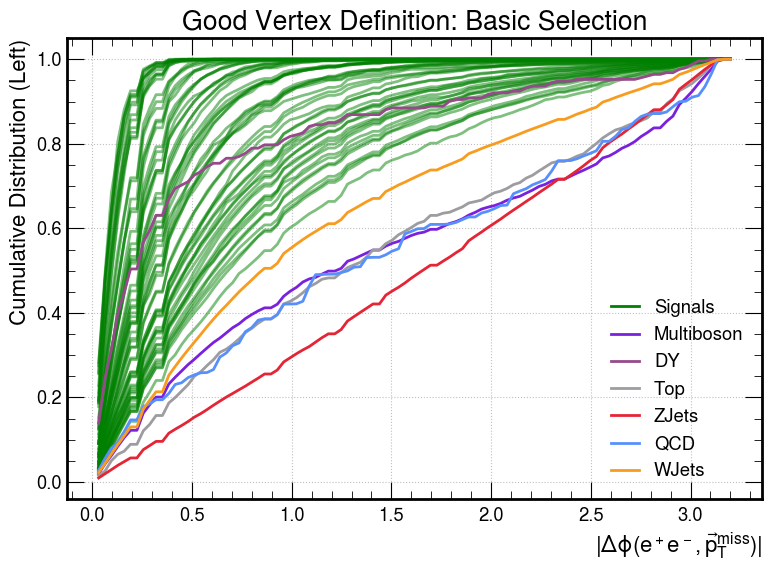

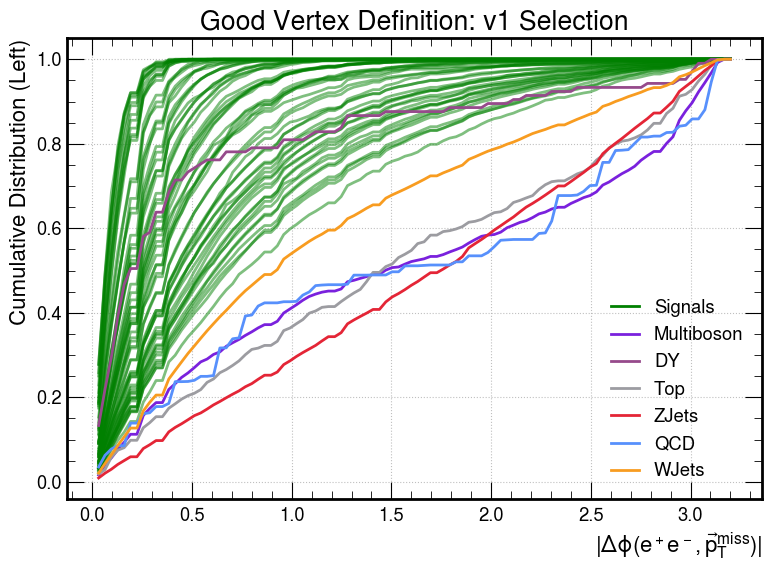

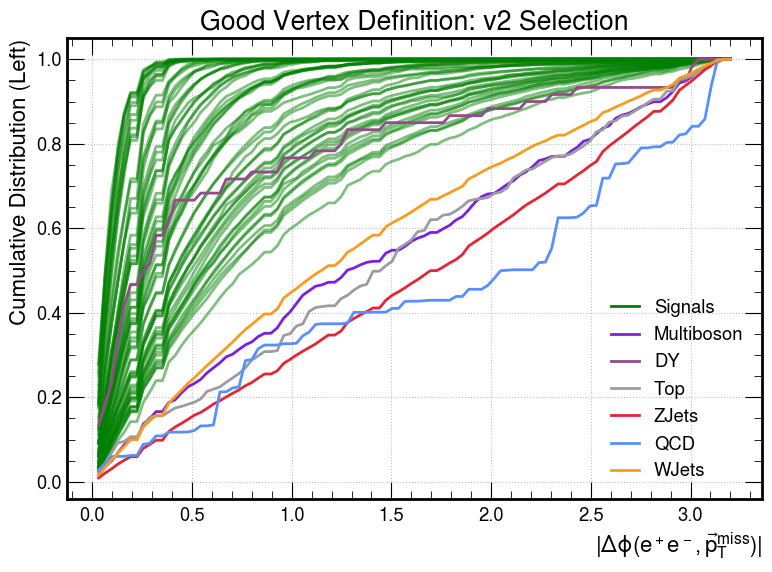

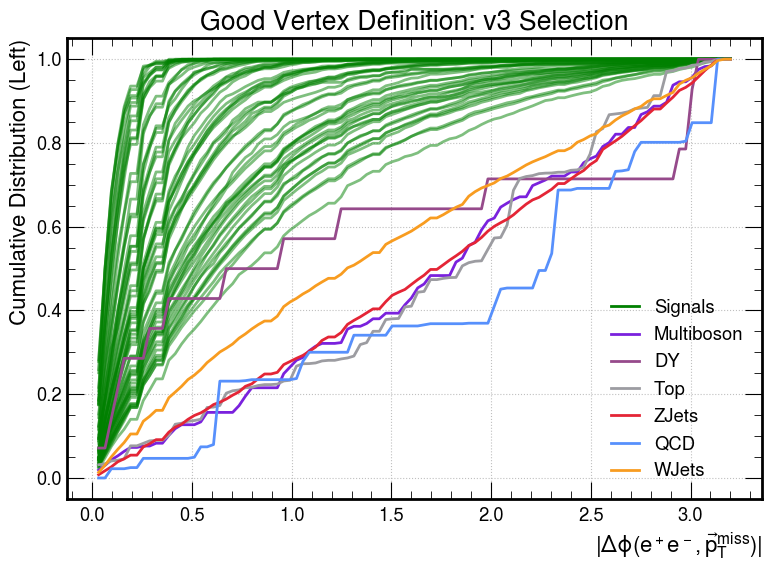

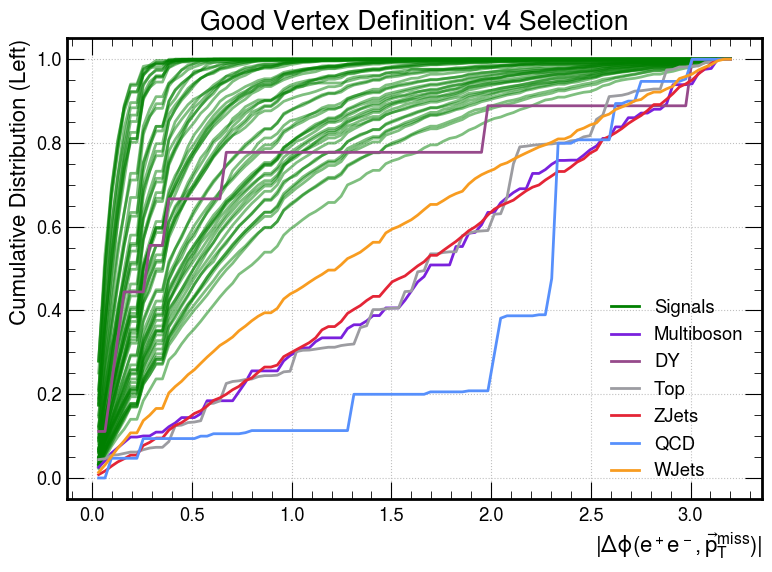

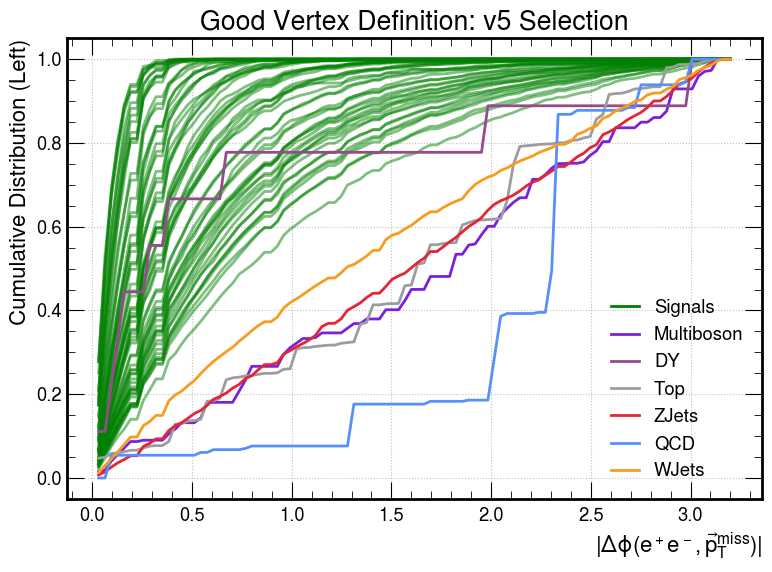

In [30]:
for cut,desc in zip(cuts,descriptions):
    selection = {"cut":cut,"vtype":sum}
    xlabel = r"$|\Delta\phi(e^+e^-,\vec{p}_T^\mathrm{miss})|$"
    title = f"Good Vertex Definition: {desc}"
    hname = "match_vtx_METdPhi"
    hname_bkg = "sel_vtx_METdPhi"
    outD = f"plots_vtxStudy/vertexSelection_cdfs/{cut}/"
    outName = "matchSig_vs_bkg_cdf_vtxMETdPhi"+f"_{cut}"
    make_cdf_summary_sigVsBkg(dfs,hcs,hcb,hname,hname_bkg,selection,outName,outD,xlabel=xlabel,
                              save=True,show=True,right=False,title=title)

/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not plac

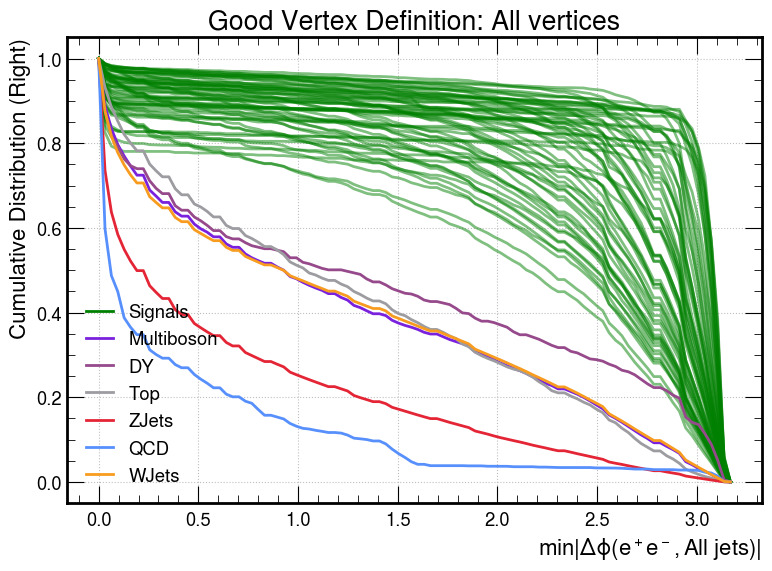

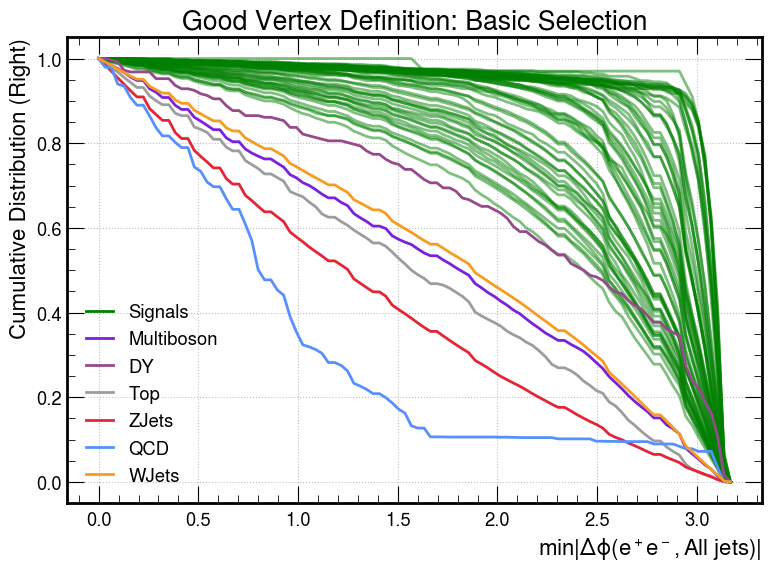

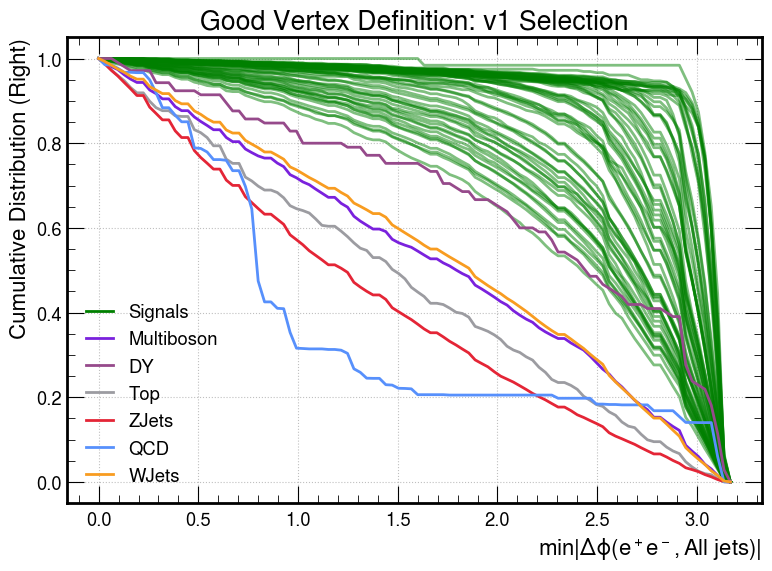

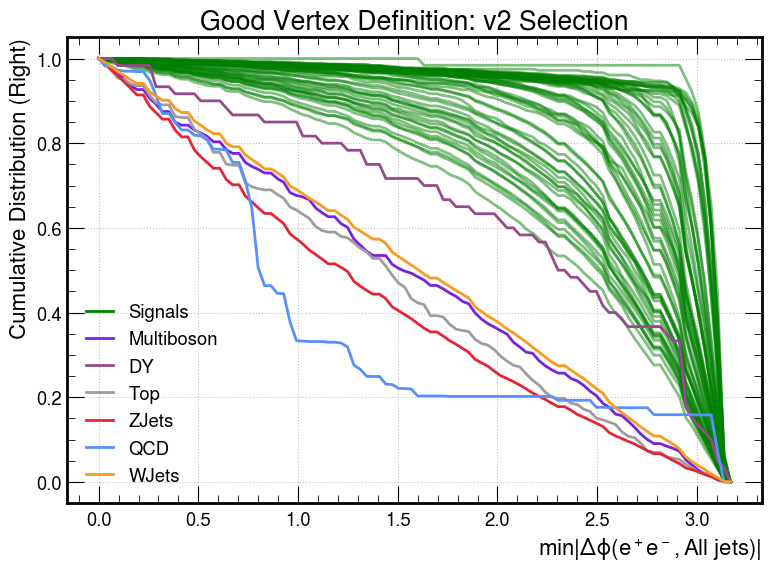

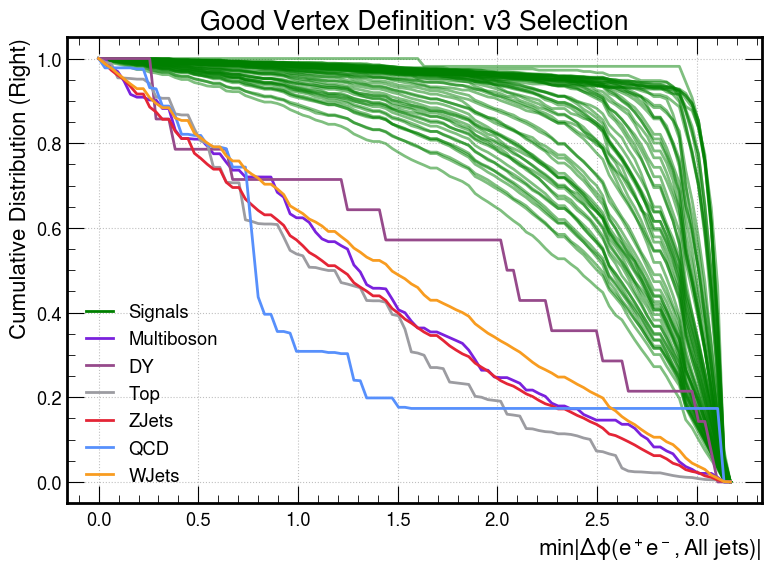

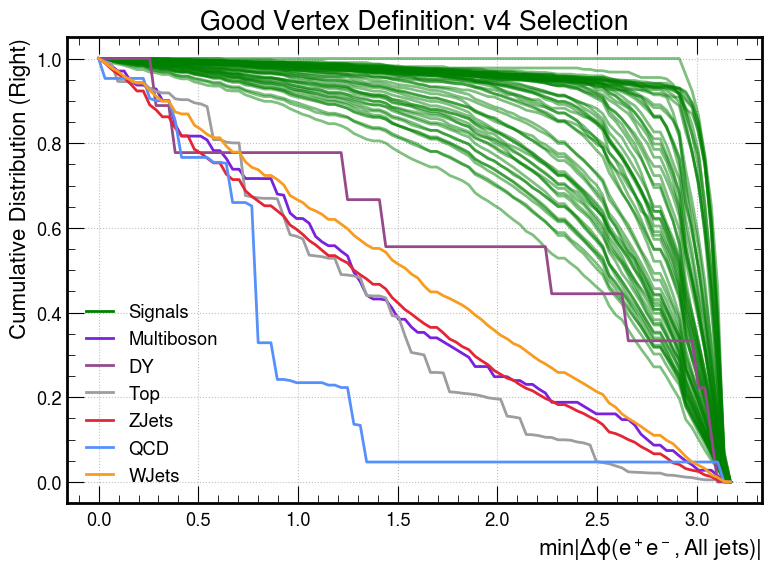

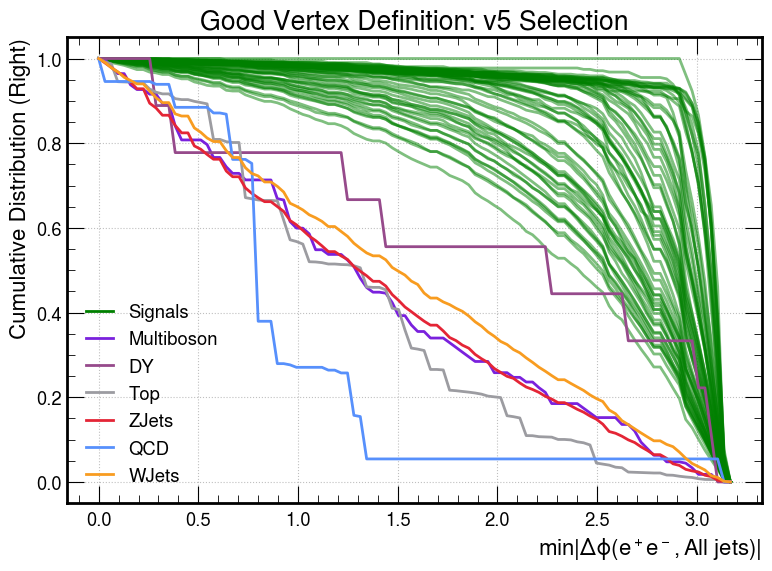

In [31]:
for cut,desc in zip(cuts,descriptions):
    selection = {"cut":cut,"vtype":sum}
    title = f"Good Vertex Definition: {desc}"
    xlabel = r"$\min |\Delta\phi(e^+e^-,\text{All jets})|$"
    ylabel = "A.U."
    hname = "match_vtx_mindPhiJ"
    hname_bkg = "sel_vtx_mindPhiJ"
    outD = f"plots_vtxStudy/vertexSelection_cdfs/{cut}/"
    outName = "matchSig_vs_bkg_cdf_minJetMETdPhi"+f"_{cut}"
    make_cdf_summary_sigVsBkg(dfs,hcs,hcb,hname,hname_bkg,selection,outName,outD,xlabel=xlabel,
                              save=True,show=True,title=title)

/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not plac

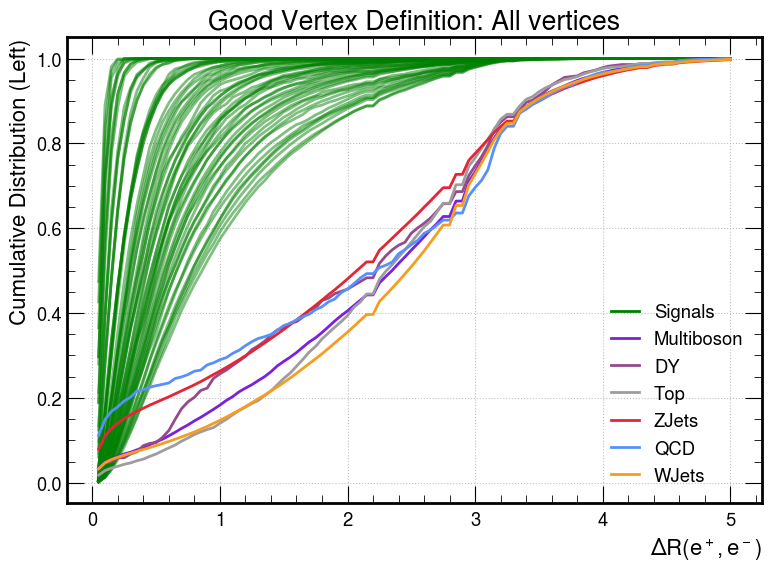

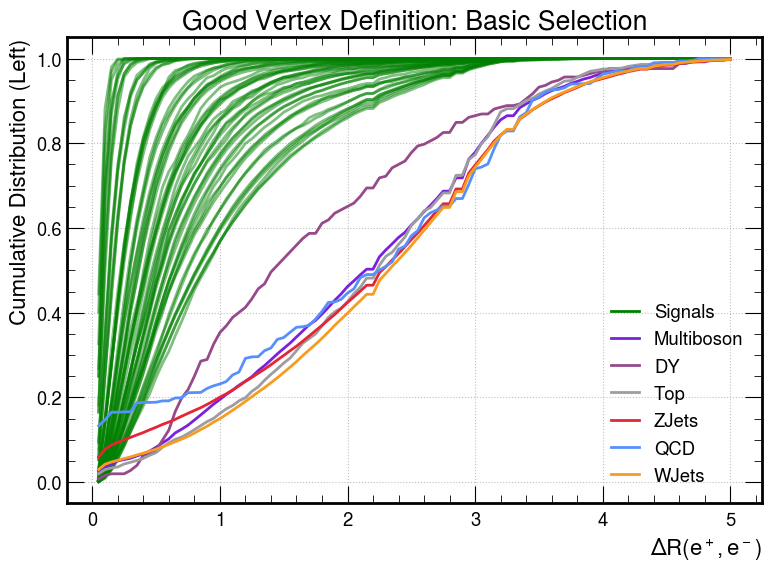

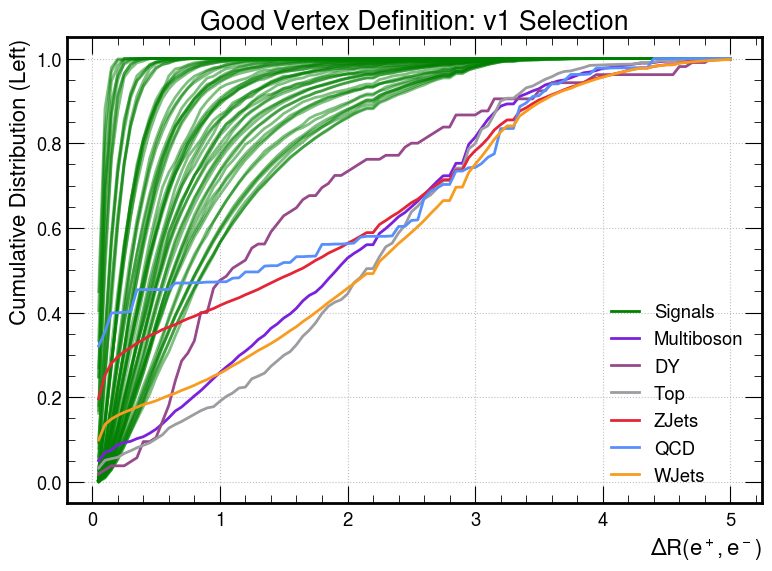

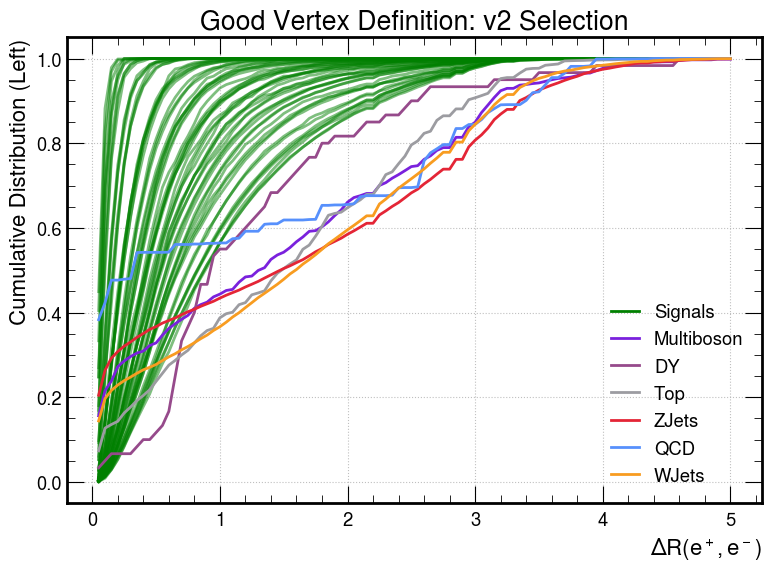

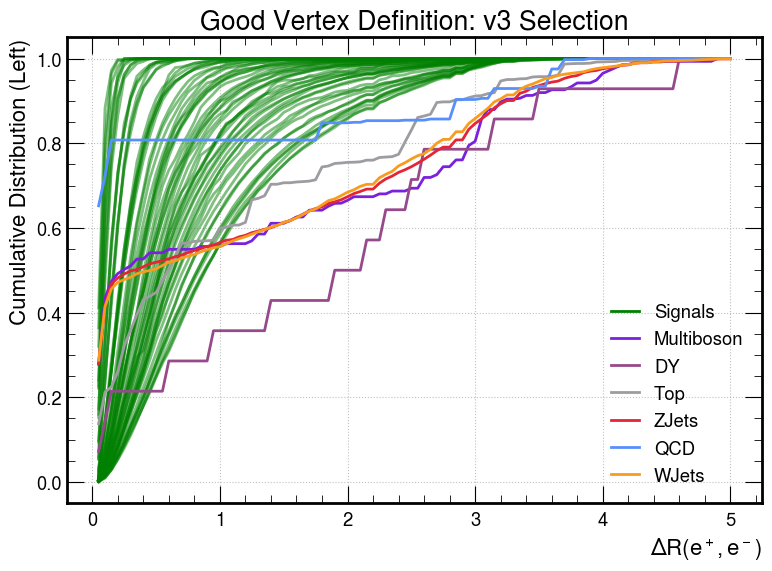

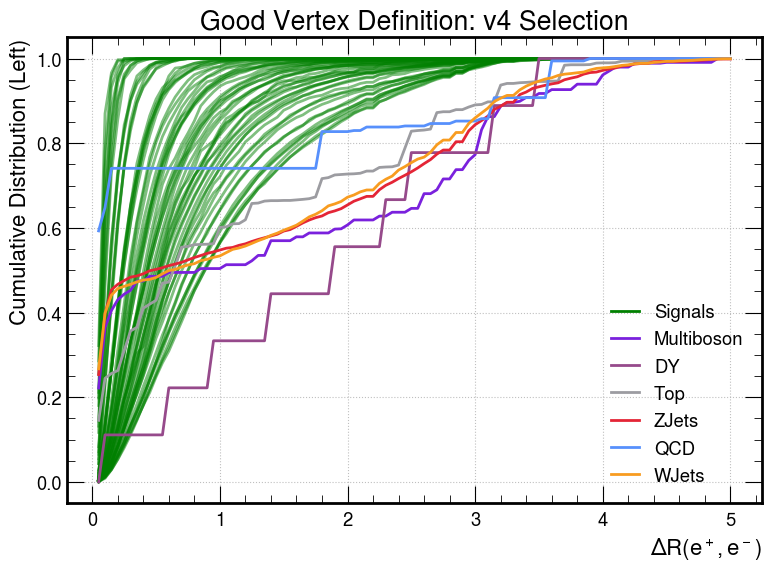

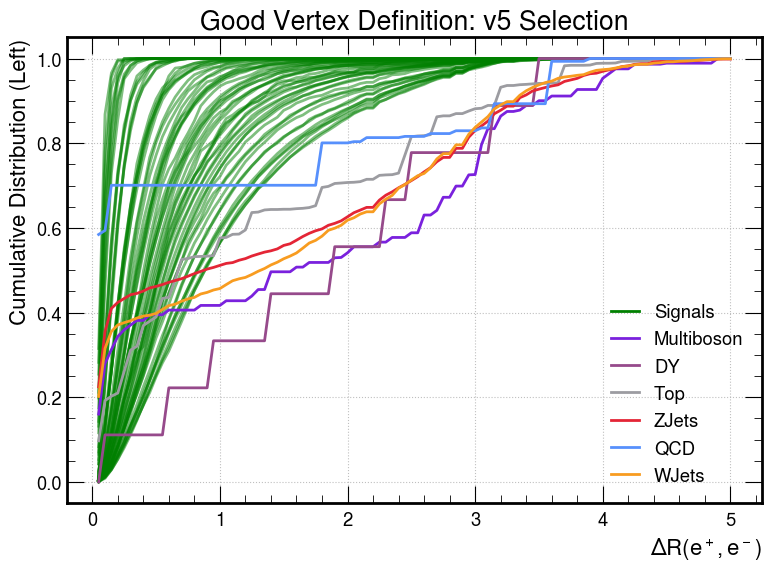

In [32]:
for cut,desc in zip(cuts,descriptions):
    selection = {"cut":cut,"vtype":sum}
    xlabel = r"$\Delta R(e^+,e^-)$"
    title = f"Good Vertex Definition: {desc}"
    ylabel = "A.U."
    hname = "match_vtx_dR"
    hname_bkg = "sel_vtx_dR"
    outD = f"plots_vtxStudy/vertexSelection_cdfs/{cut}/"
    outName = "matchSig_vs_bkg_cdf_vtx_dR"+f"_{cut}"
    make_cdf_summary_sigVsBkg(dfs,hcs,hcb,hname,hname_bkg,selection,outName,outD,xlabel=xlabel,
                              save=True,show=True,right=False,title=title)

/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not plac

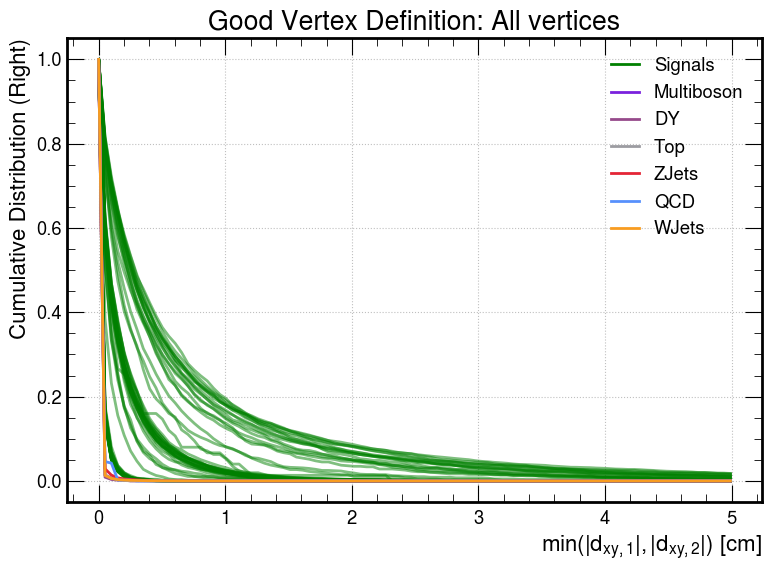

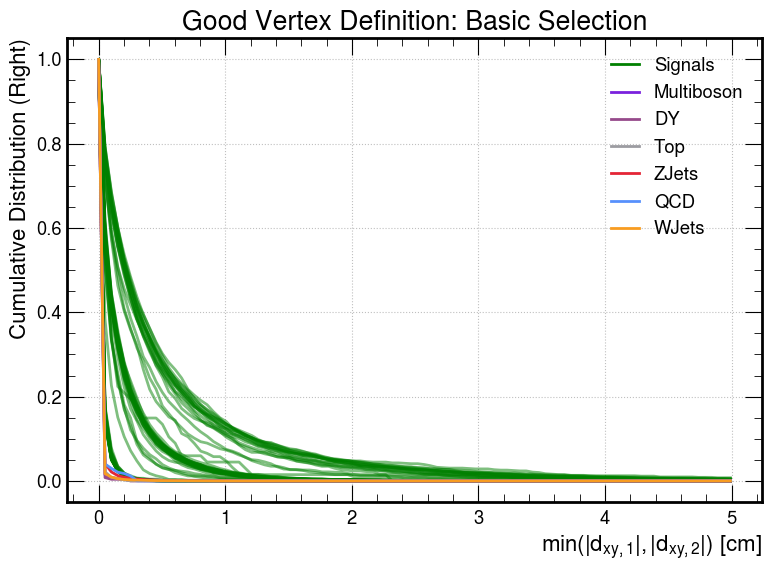

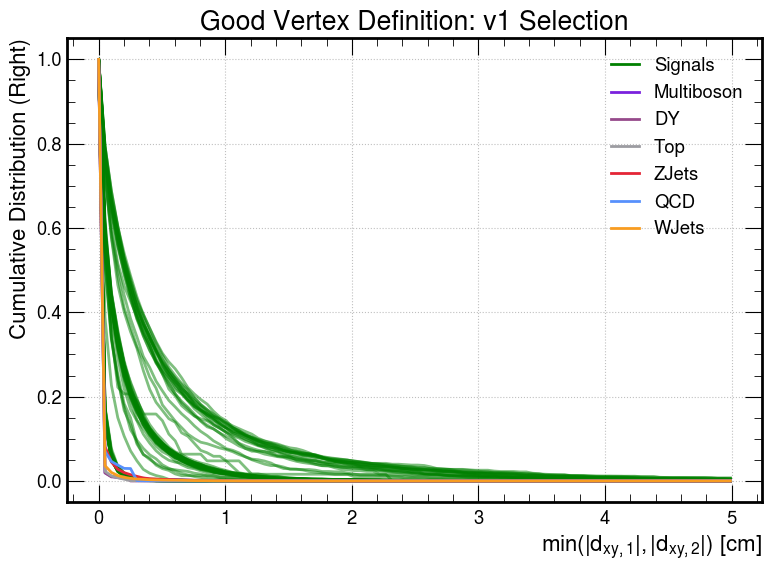

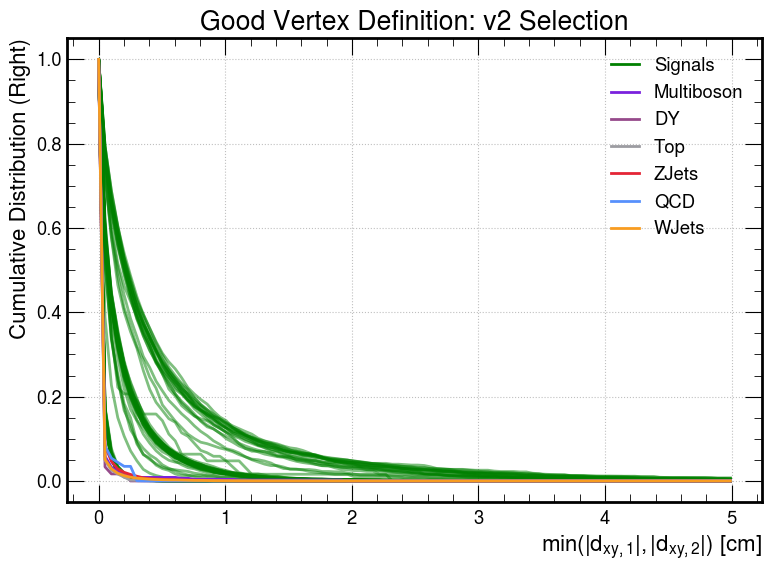

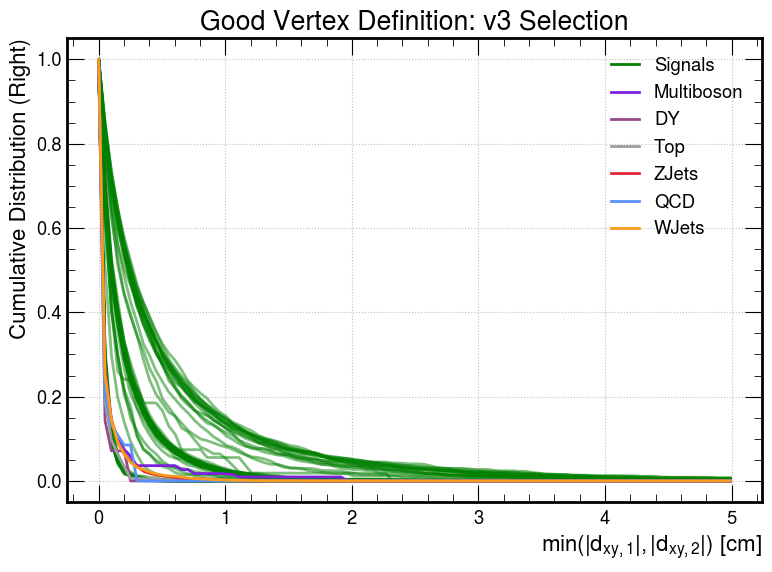

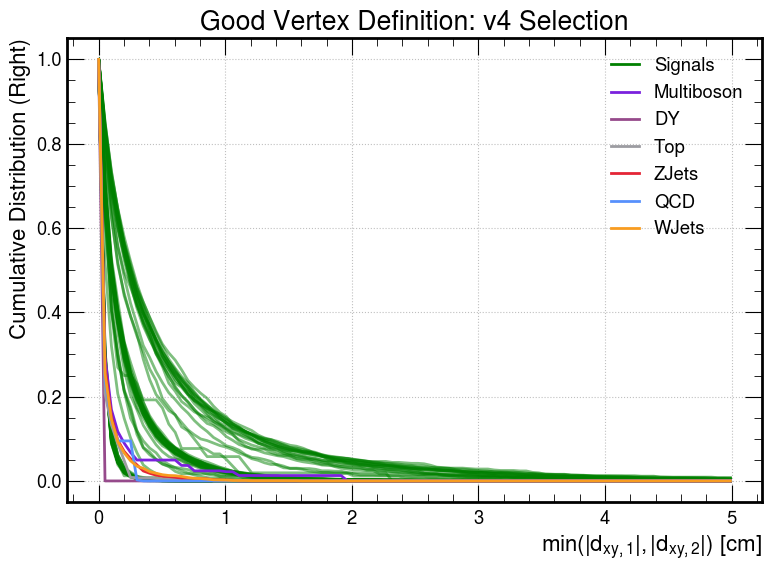

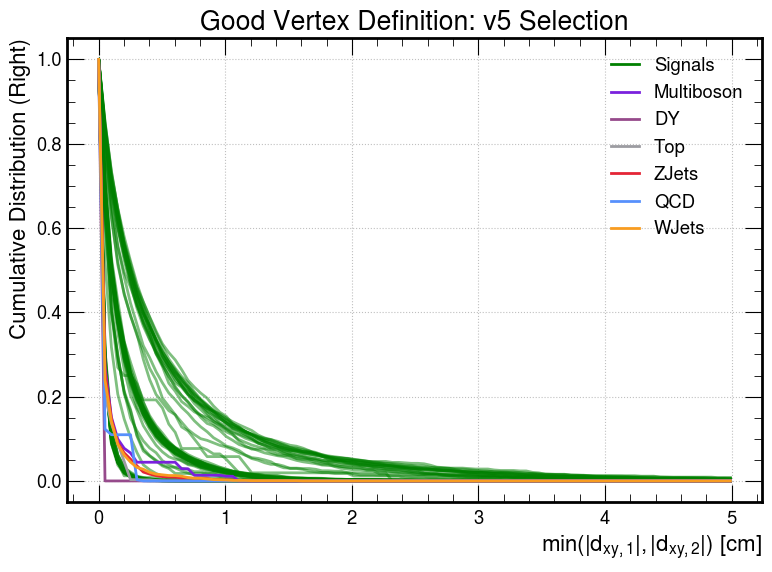

In [33]:
for cut,desc in zip(cuts,descriptions):
    selection = {"cut":cut,"vtype":sum}
    title = f"Good Vertex Definition: {desc}"
    xlabel = r"$\min(|d_{xy,1}|,|d_{xy,2}|)$ [cm]"
    ylabel = "A.U."
    hname = "match_vtx_mindxy"
    hname_bkg = "sel_vtx_mindxy"
    outD = f"plots_vtxStudy/vertexSelection_cdfs/{cut}/"
    outName = "matchSig_vs_bkg_cdf_vtx_minDxy"+f"_{cut}"
    make_cdf_summary_sigVsBkg(dfs,hcs,hcb,hname,hname_bkg,selection,outName,outD,xlabel=xlabel,
                              save=True,show=True,right=True,title=title)

/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not plac

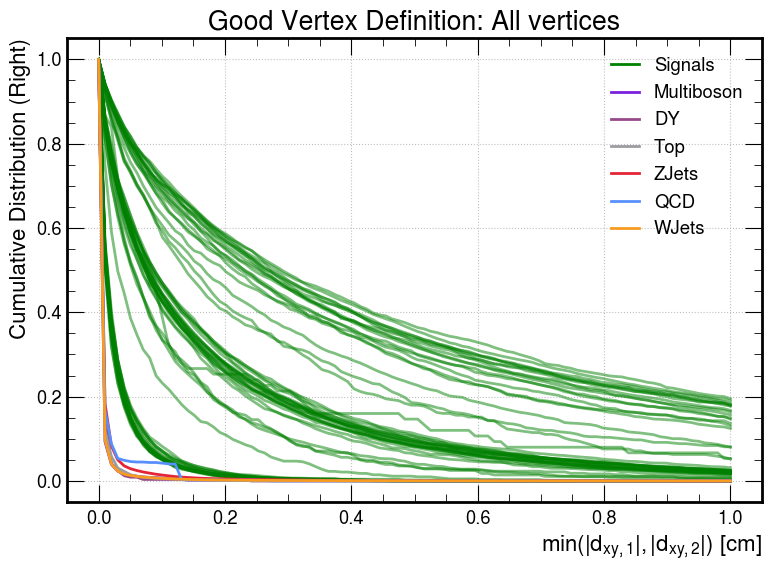

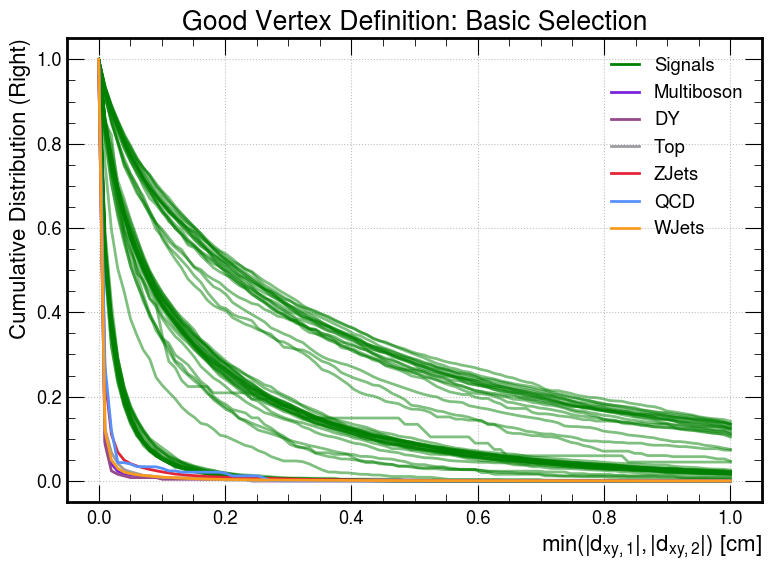

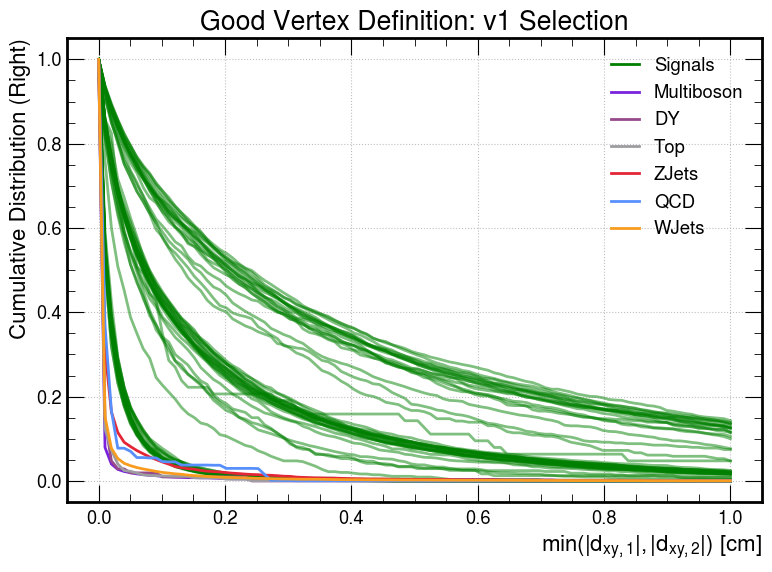

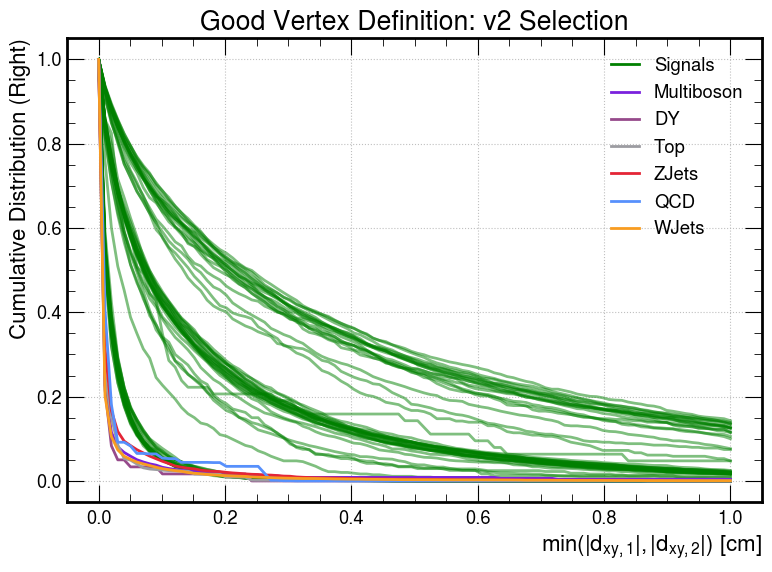

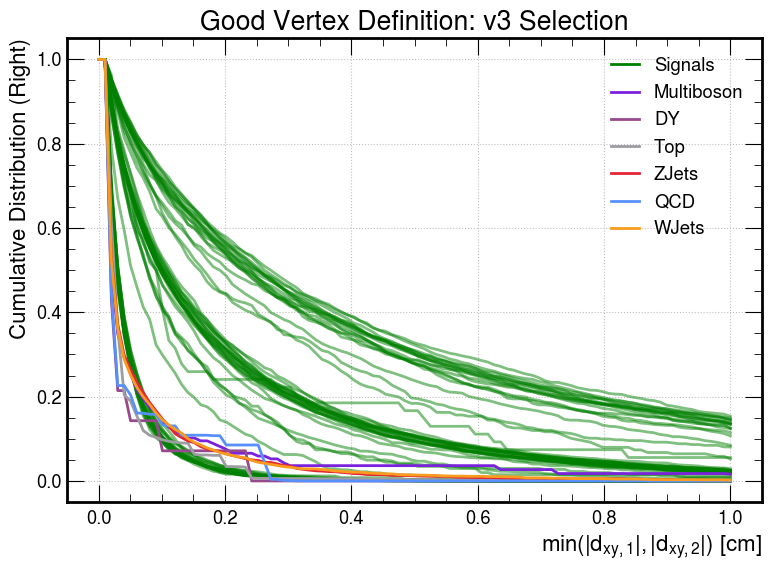

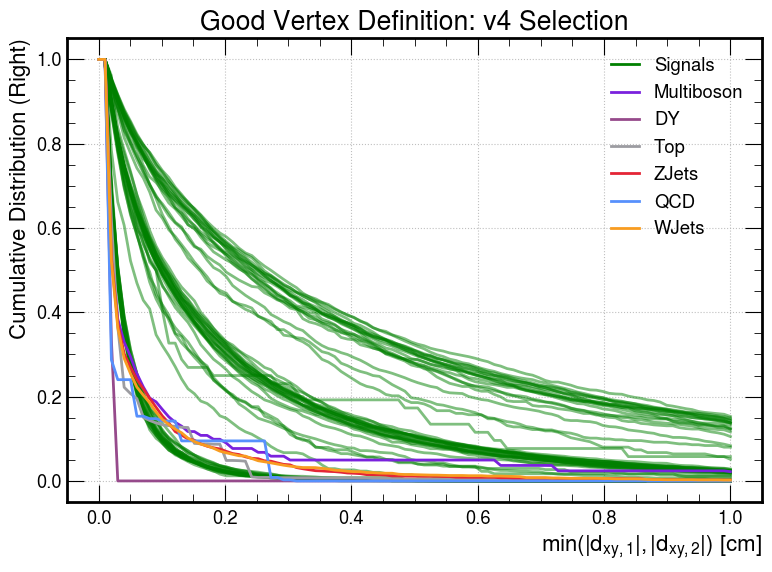

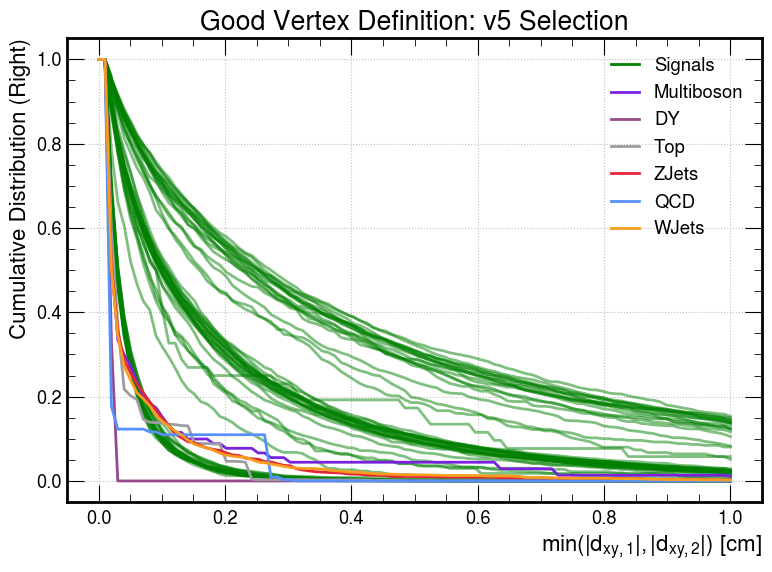

In [34]:
for cut,desc in zip(cuts,descriptions):
    selection = {"cut":cut,"vtype":sum}
    xlabel = r"$\min(|d_{xy,1}|,|d_{xy,2}|)$ [cm]"
    title = f"Good Vertex Definition: {desc}"
    ylabel = "A.U."
    hname = "match_vtx_mindxy"
    hname_bkg = "sel_vtx_mindxy"
    outD = f"plots_vtxStudy/vertexSelection_cdfs/{cut}/"
    outName = "matchSig_vs_bkg_cdf_vtx_minDxyZoom"+f"_{cut}"
    make_cdf_summary_sigVsBkg(dfs,hcs,hcb,hname,hname_bkg,selection,outName,outD,xlim=[0,1],xlabel=xlabel,
                              save=True,show=True,right=True,title=title)

/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not plac

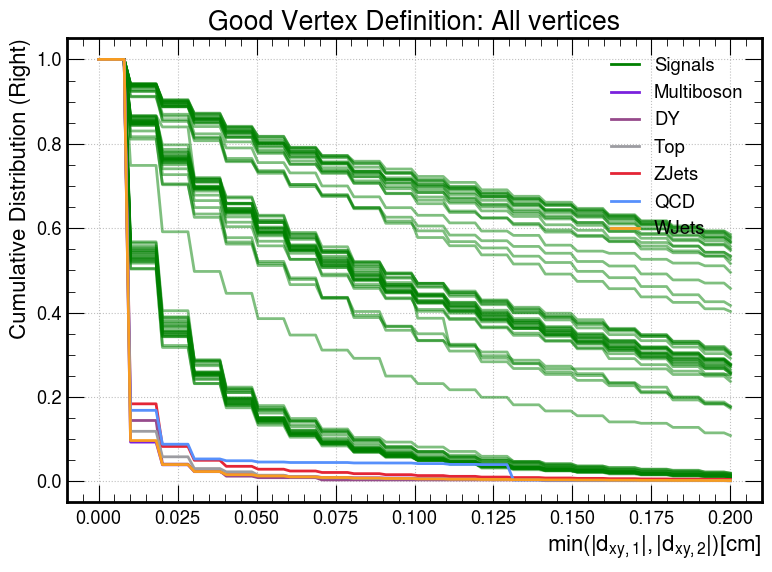

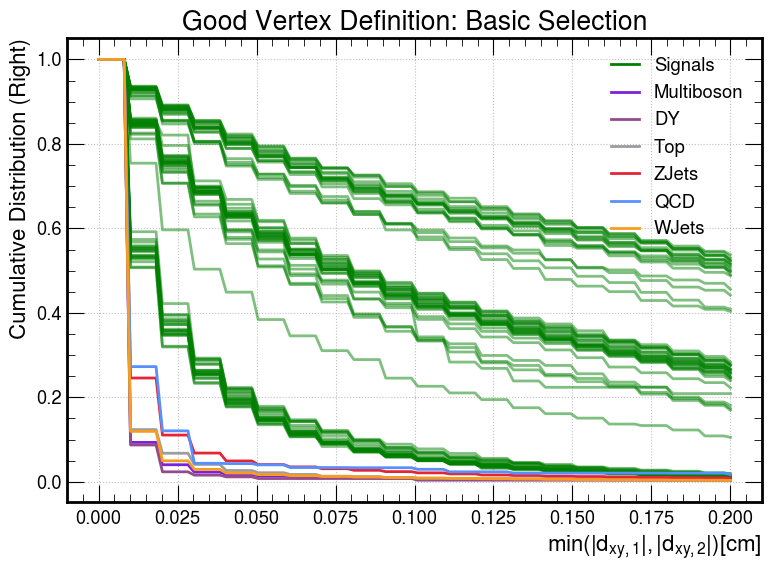

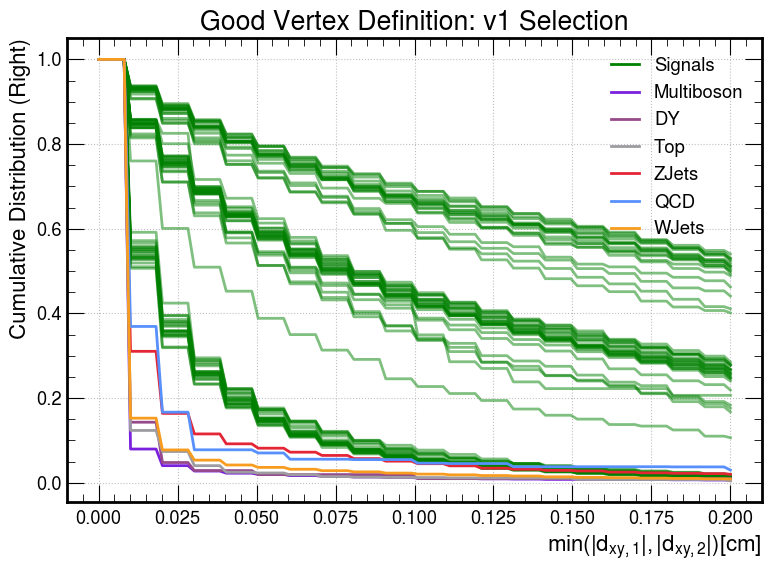

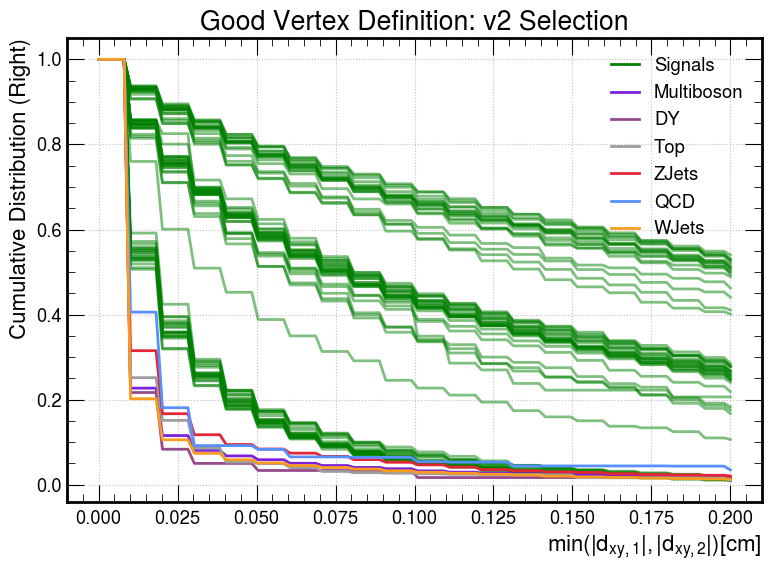

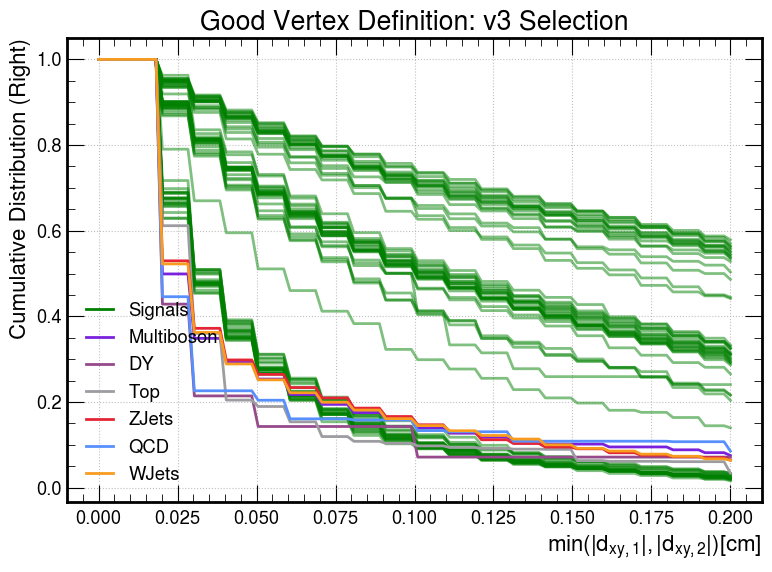

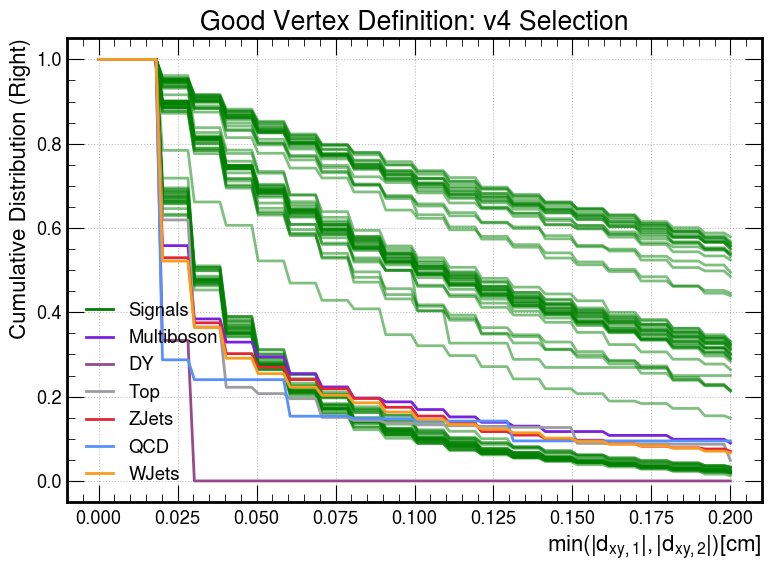

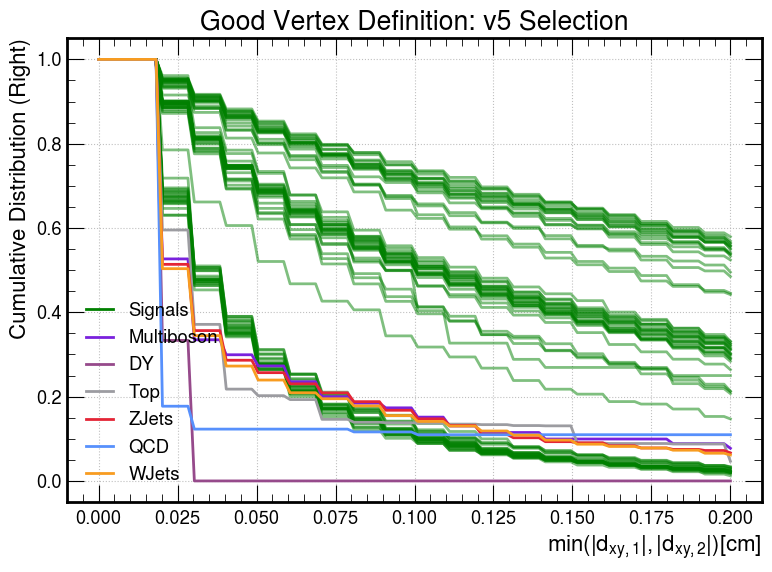

In [35]:
for cut,desc in zip(cuts,descriptions):
    selection = {"cut":cut,"vtype":sum}
    xlabel = r"$\min(|d_{xy,1}|,|d_{xy,2}|) [cm]$"
    title = f"Good Vertex Definition: {desc}"
    ylabel = "A.U."
    hname = "match_vtx_mindxy"
    hname_bkg = "sel_vtx_mindxy"
    outD = f"plots_vtxStudy/vertexSelection_cdfs/{cut}/"
    outName = "matchSig_vs_bkg_cdf_vtx_minDxyZoomZoom"+f"_{cut}"
    make_cdf_summary_sigVsBkg(dfs,hcs,hcb,hname,hname_bkg,selection,outName,outD,xlim=[0,0.2],xlabel=xlabel,
                              save=True,show=True,right=True,title=title)

/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not plac

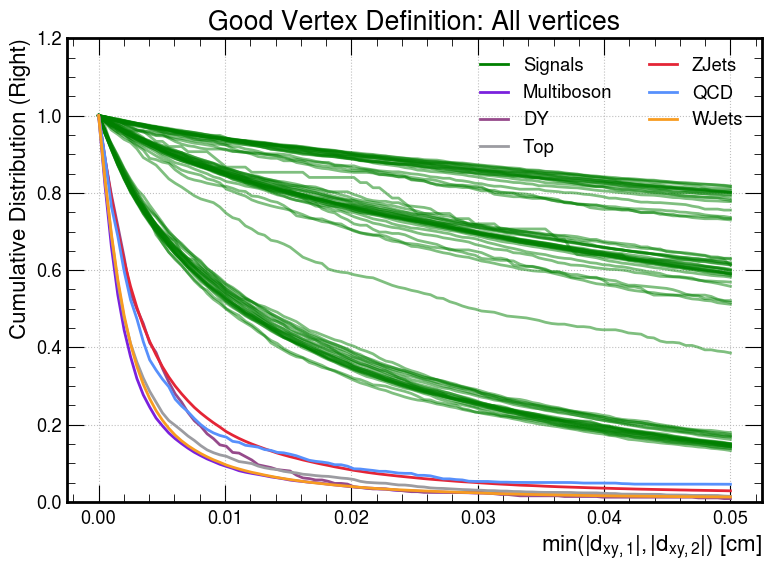

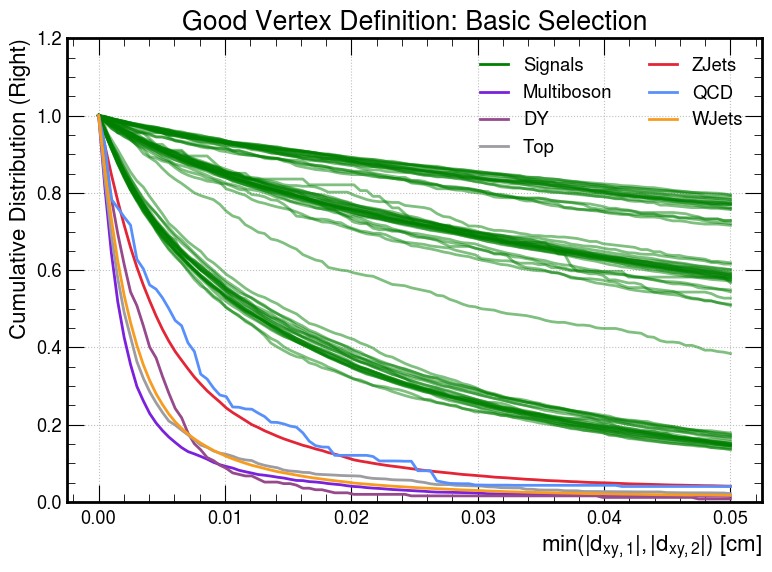

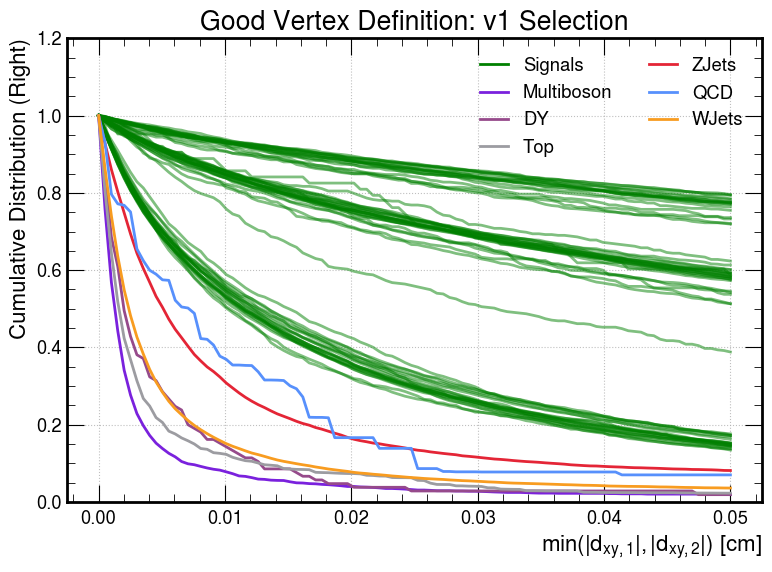

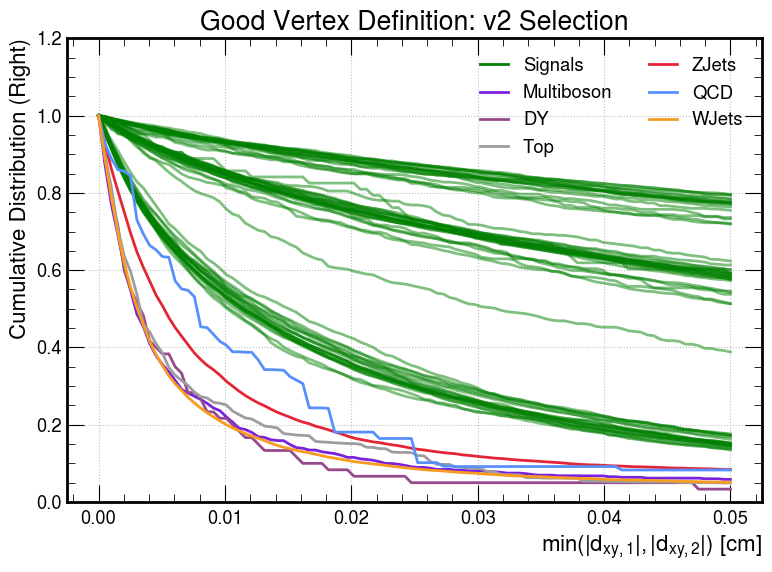

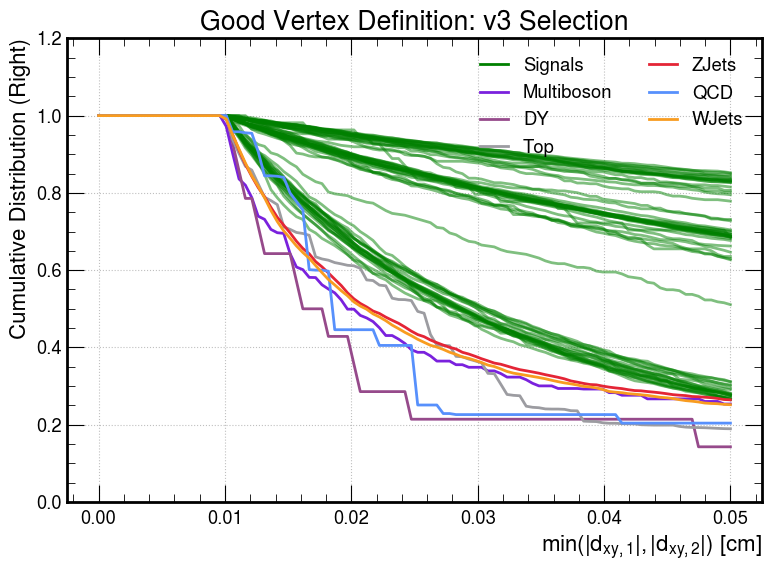

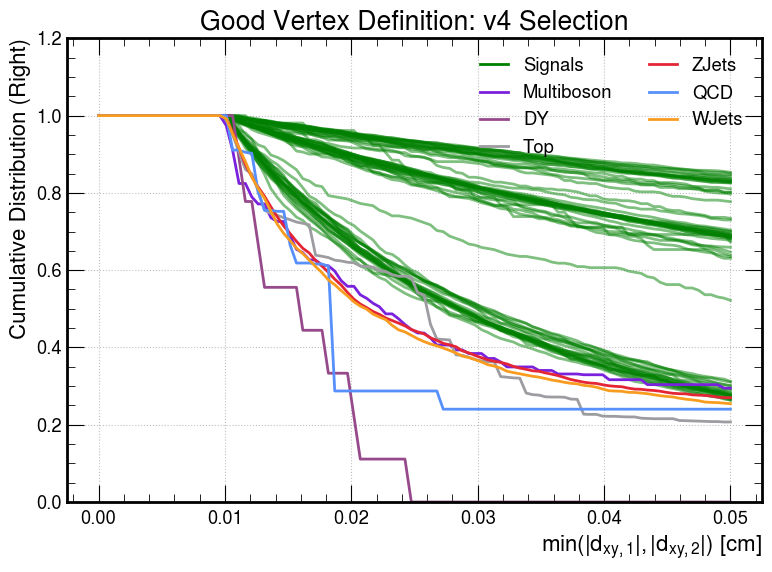

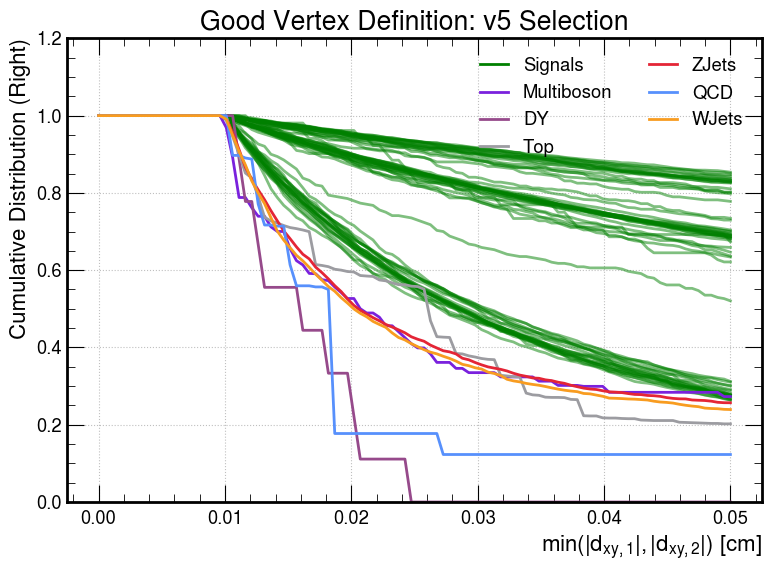

In [36]:
for cut,desc in zip(cuts,descriptions):
    selection = {"cut":cut,"vtype":sum}
    xlabel = r"$\min(|d_{xy,1}|,|d_{xy,2}|)$ [cm]"
    title = f"Good Vertex Definition: {desc}"
    hname = "match_vtx_mindxy_low"
    hname_bkg = "sel_vtx_mindxy_low"
    outD = f"plots_vtxStudy/vertexSelection_cdfs/{cut}/"
    outName = "matchSig_vs_bkg_cdf_vtx_minDxy_low"+f"_{cut}"
    make_cdf_summary_sigVsBkg(dfs,hcs,hcb,hname,hname_bkg,selection,outName,outD,xlim=[0,0.05],ylim=[0,1.2],xlabel=xlabel,
                              save=True,show=True,right=True,title=title,ncol_leg=2,legend_loc='upper right')

/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not plac

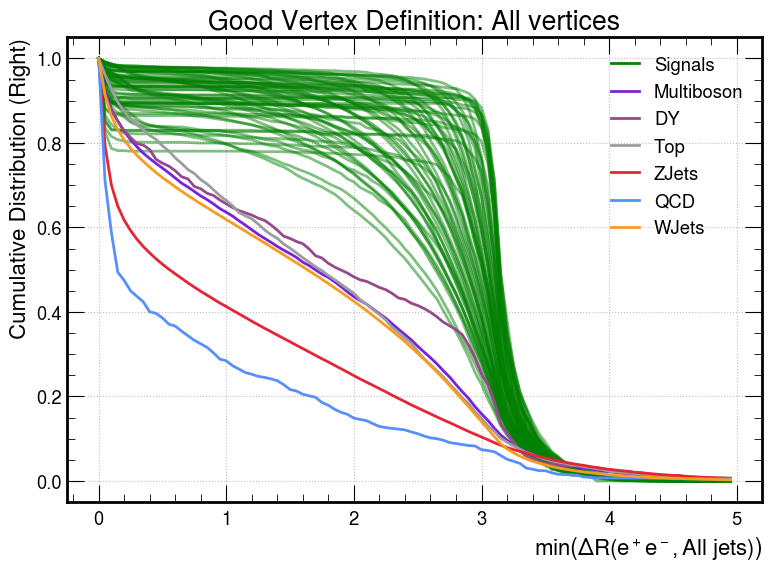

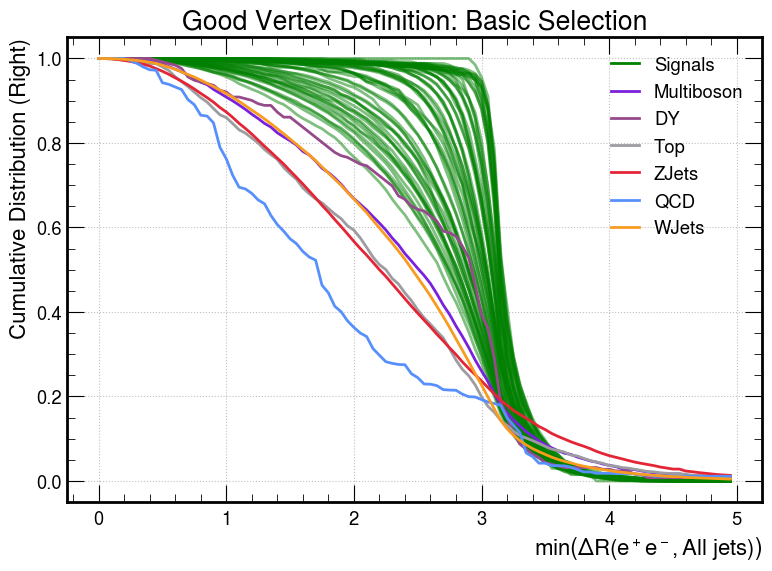

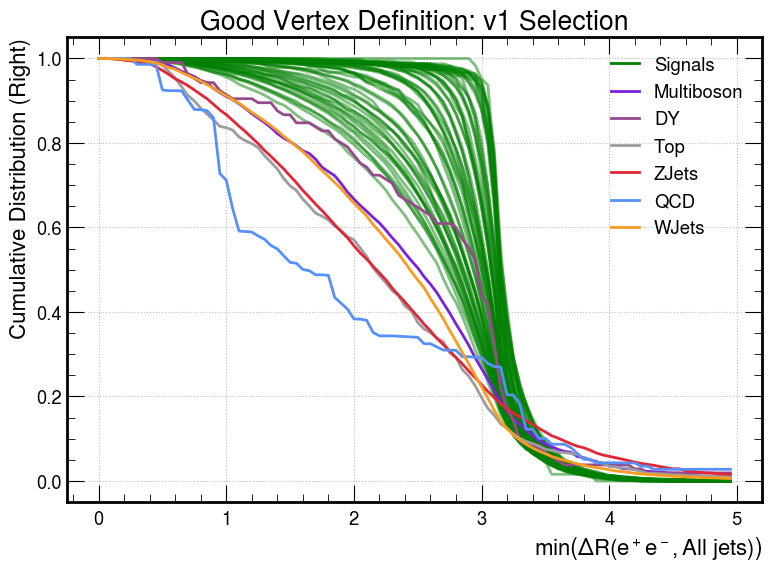

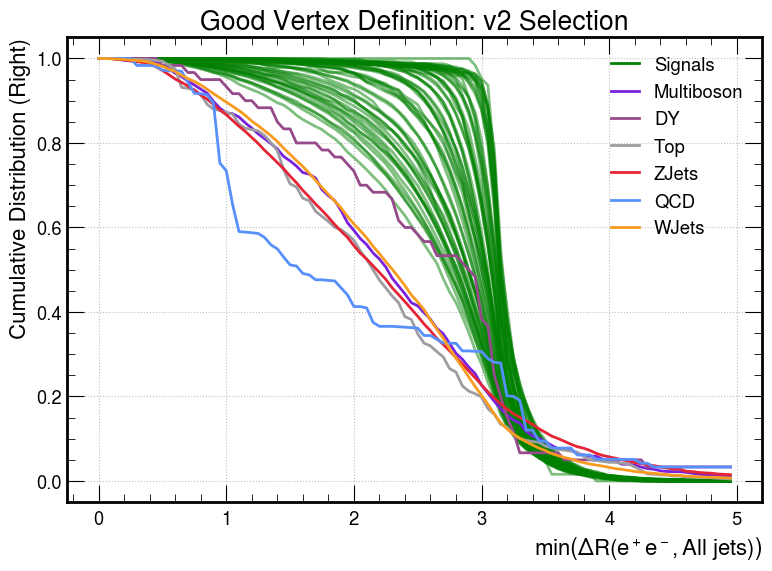

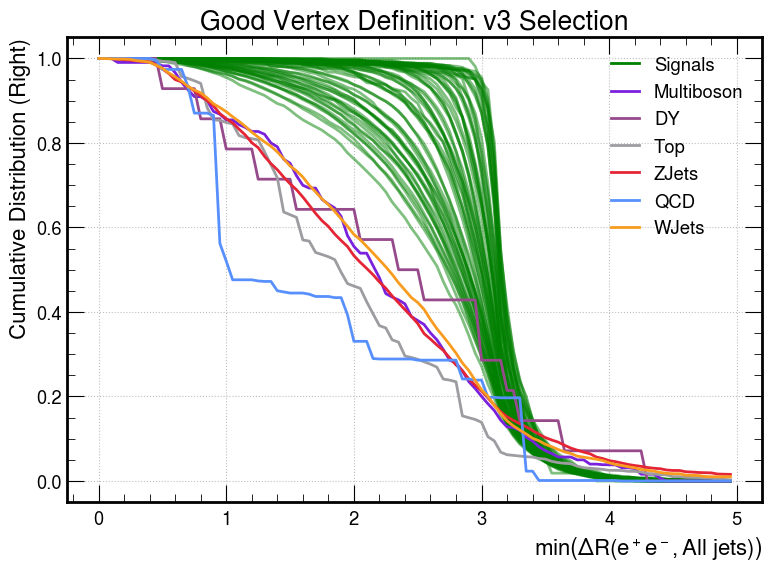

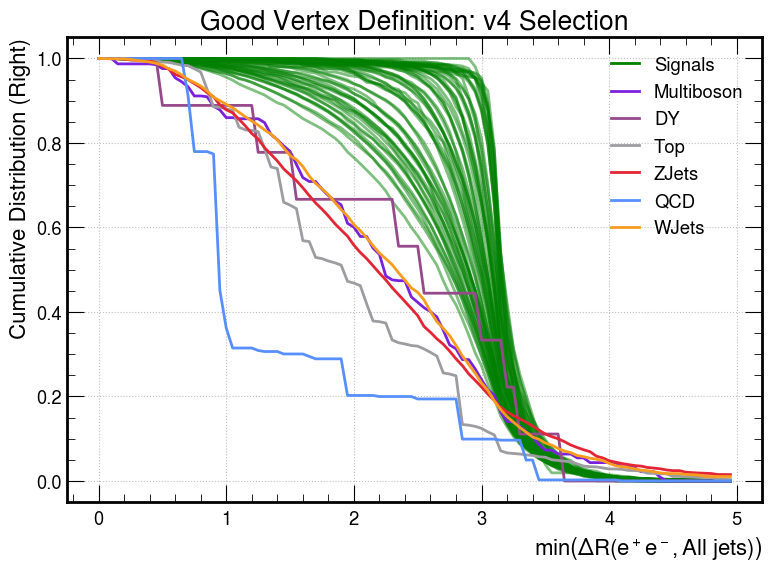

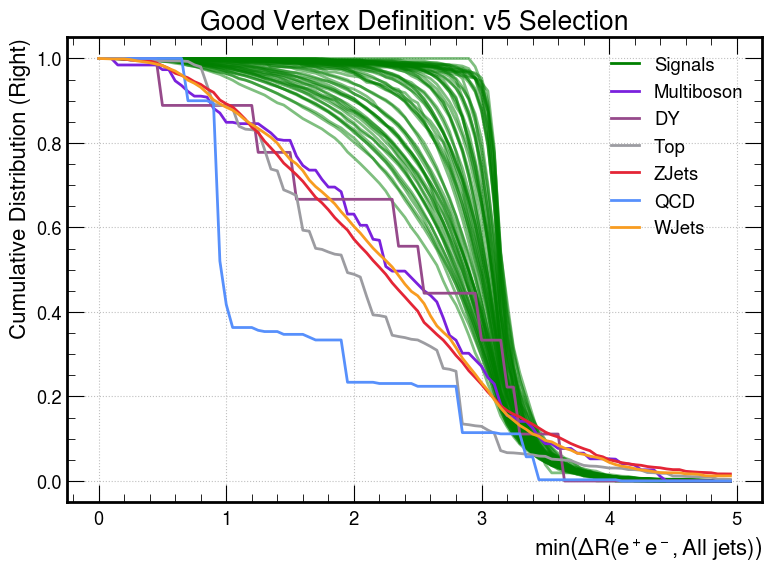

In [37]:
for cut,desc in zip(cuts,descriptions):
    selection = {"cut":cut,"vtype":sum}
    xlabel = r"$\min \left(\Delta R(e^+e^-,\text{All jets})\right)$"
    title = f"Good Vertex Definition: {desc}"
    ylabel = "A.U."
    hname = "match_vtx_mindRj"
    hname_bkg = "sel_vtx_mindRj"
    outD = f"plots_vtxStudy/vertexSelection_cdfs/{cut}/"
    outName = "matchSig_vs_bkg_cdf_vtx_mindRj"+f"_{cut}"
    make_cdf_summary_sigVsBkg(dfs,hcs,hcb,hname,hname_bkg,selection,outName,outD,xlabel=xlabel,
                              save=True,show=True,right=True,title=title)

/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not plac

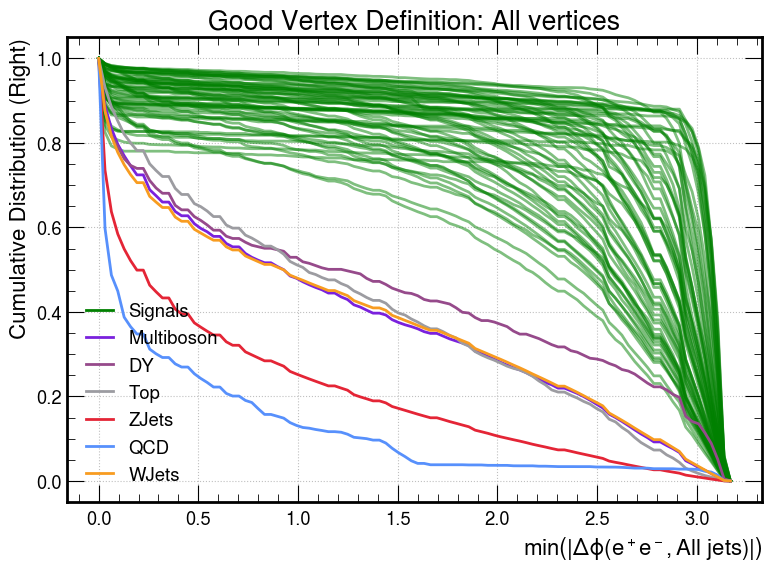

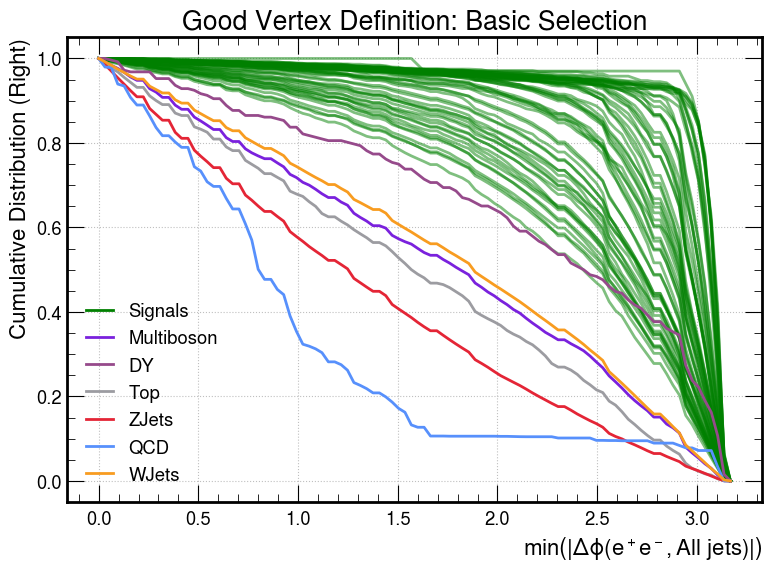

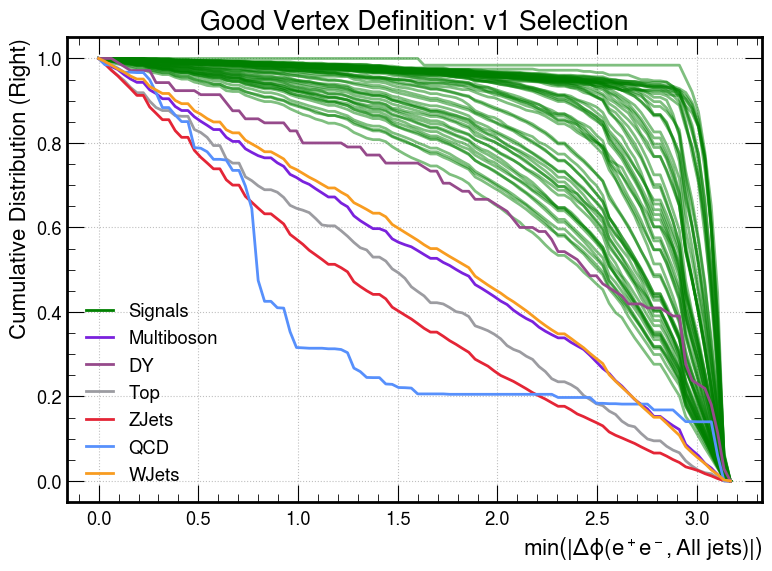

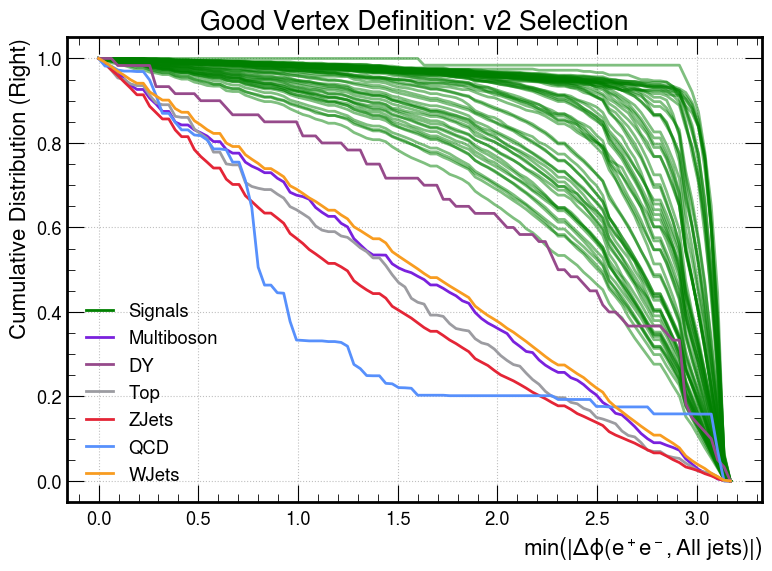

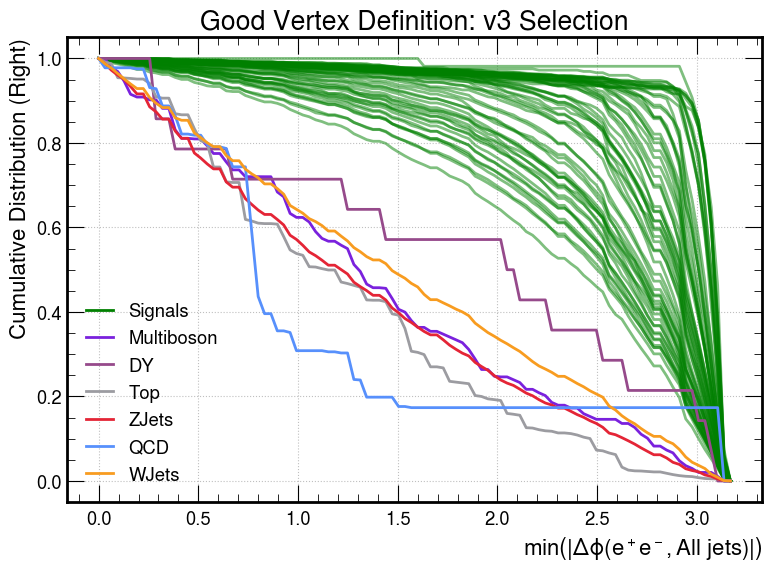

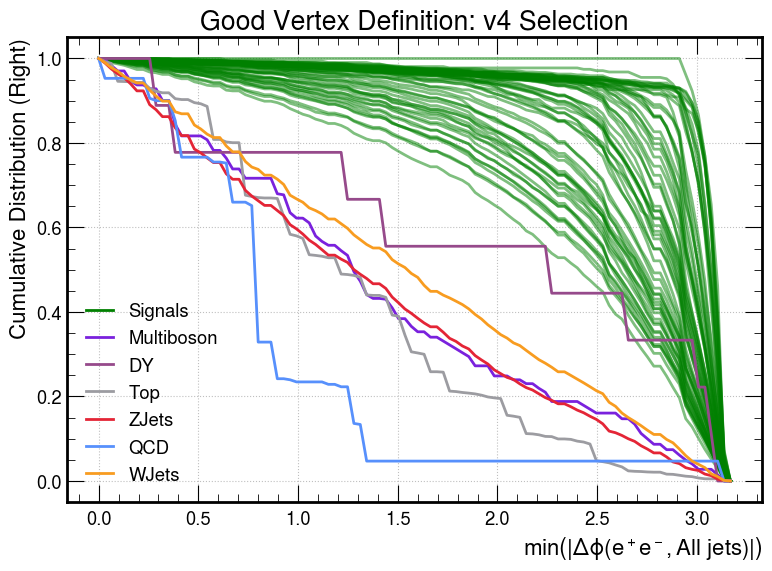

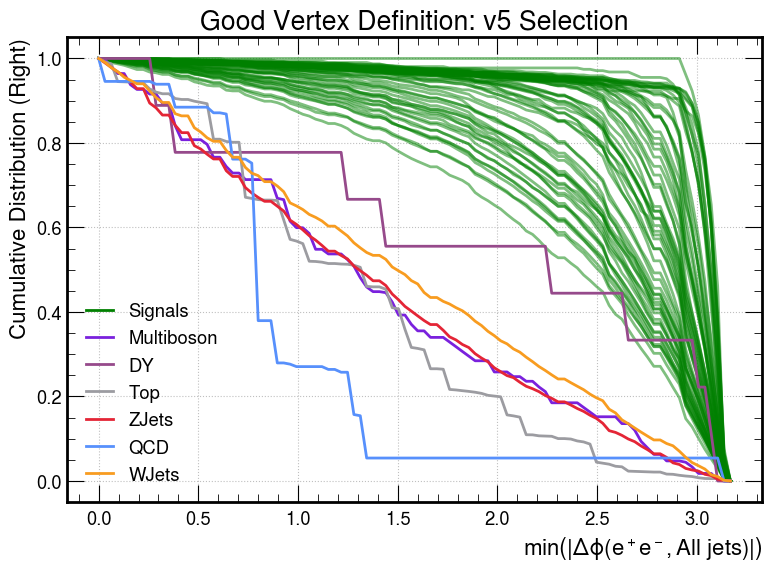

In [38]:
for cut,desc in zip(cuts,descriptions):
    selection = {"cut":cut,"vtype":sum}
    xlabel = r"$\min \left(|\Delta \phi(e^+e^-,\text{All jets})|\right)$"
    title = f"Good Vertex Definition: {desc}"
    ylabel = "A.U."
    hname = "match_vtx_mindPhiJ"
    hname_bkg = "sel_vtx_mindPhiJ"
    outD = f"plots_vtxStudy/vertexSelection_cdfs/{cut}/"
    outName = "matchSig_vs_bkg_cdf_vtx_mindPhiJ"+f"_{cut}"
    make_cdf_summary_sigVsBkg(dfs,hcs,hcb,hname,hname_bkg,selection,outName,outD,xlabel=xlabel,
                              save=True,show=True,right=True,title=title)

/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not plac

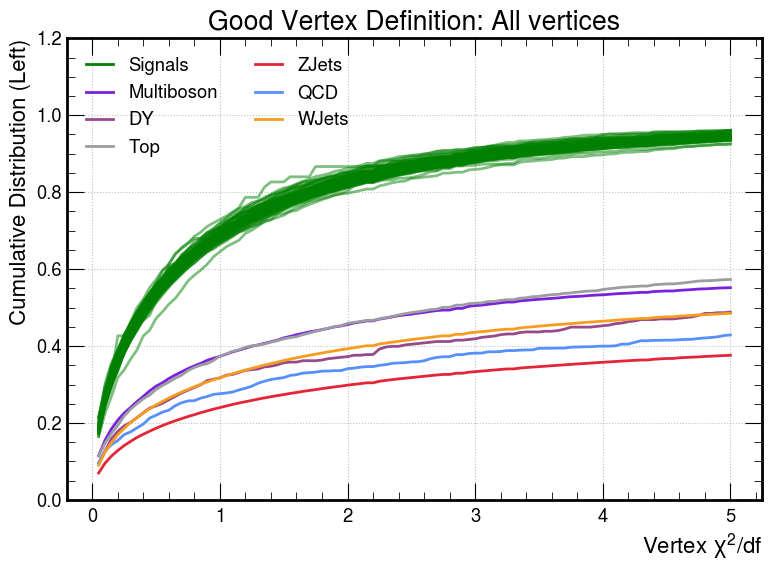

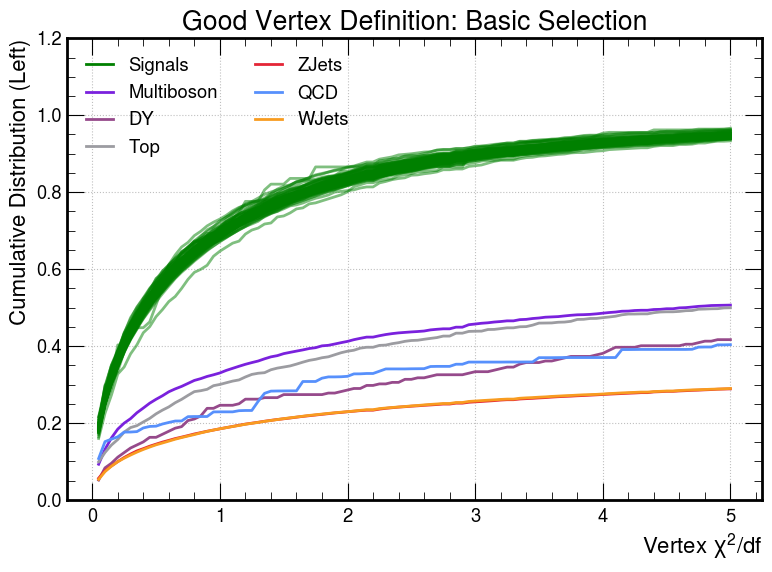

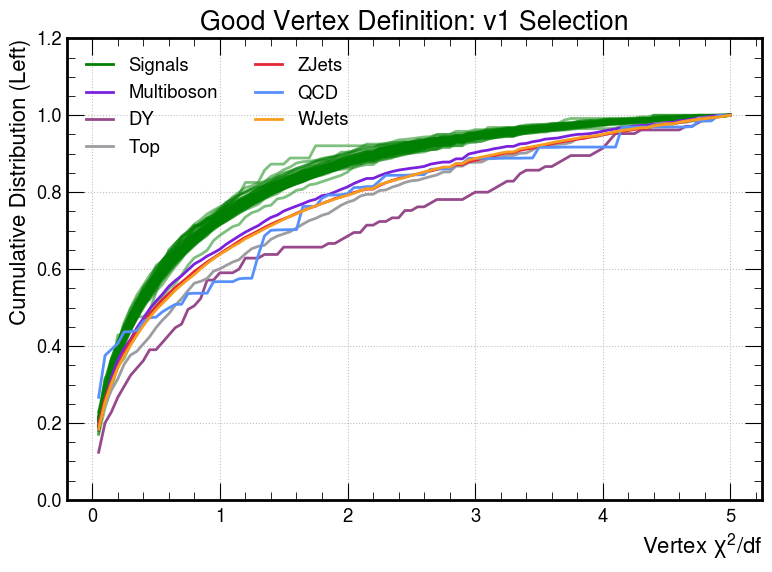

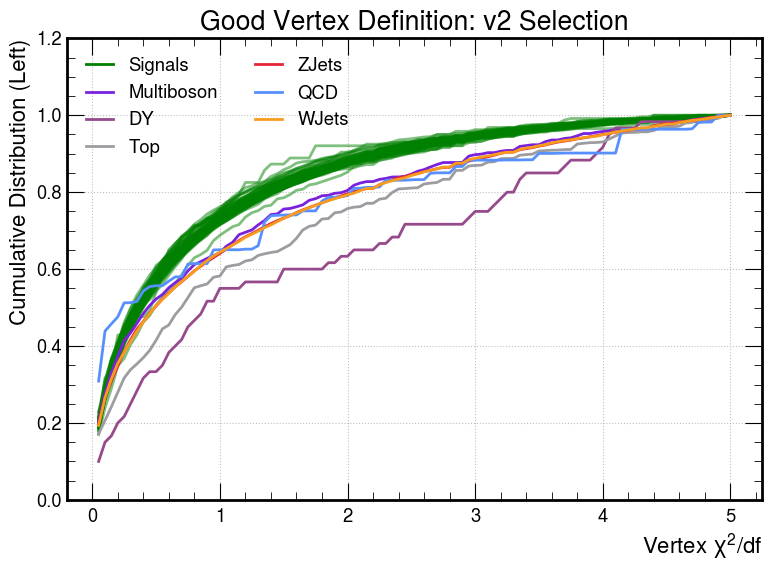

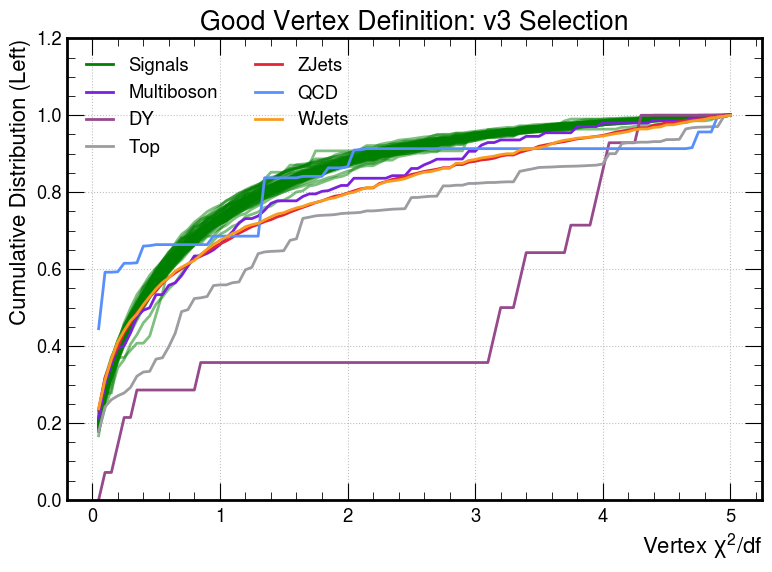

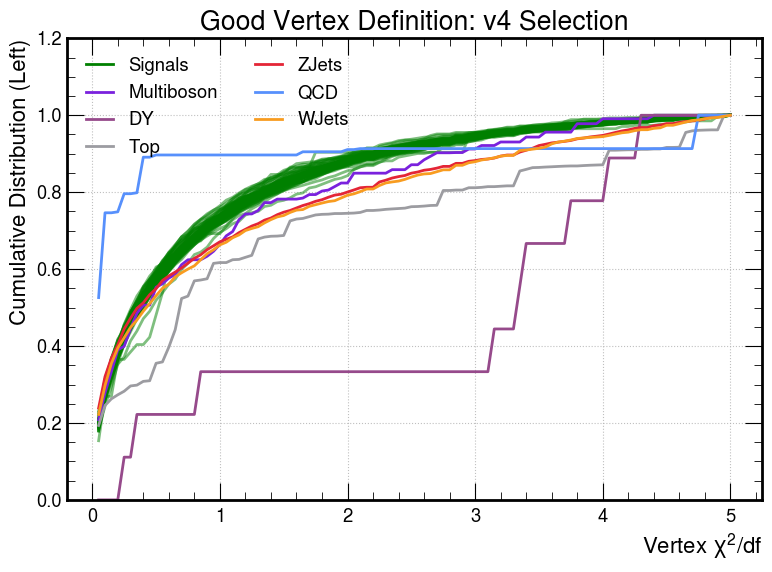

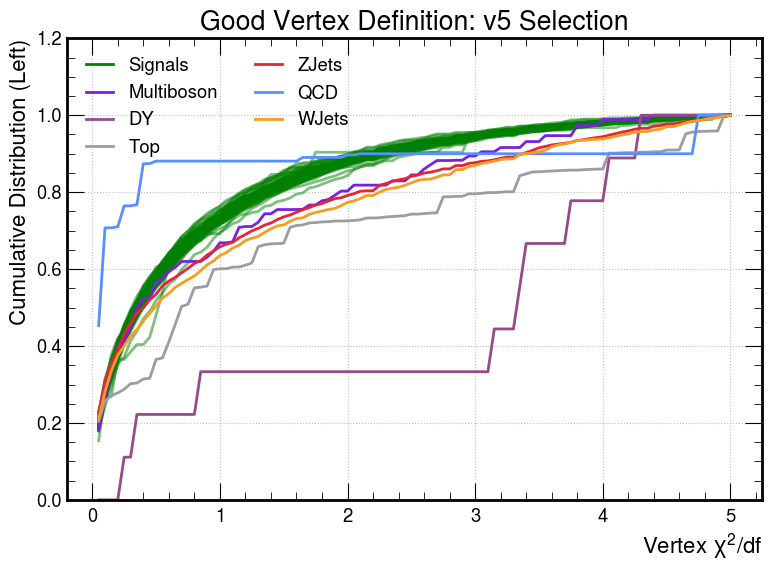

In [39]:
for cut,desc in zip(cuts,descriptions):
    selection = {"cut":cut,"vtype":sum}
    xlabel = r"Vertex $\chi^2/df$"
    title = f"Good Vertex Definition: {desc}"
    ylabel = "A.U."
    hname = "match_vtx_chi2"
    hname_bkg = "sel_vtx_chi2"
    outD = f"plots_vtxStudy/vertexSelection_cdfs/{cut}/"
    outName = "matchSig_vs_bkg_cdf_vtx_chi2"+f"_{cut}"
    make_cdf_summary_sigVsBkg(dfs,hcs,hcb,hname,hname_bkg,selection,outName,outD,xlabel=xlabel,
                              save=True,show=True,right=False,title=title,ncol_leg=2,legend_loc='upper left',ylim=[0,1.2])

/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not plac

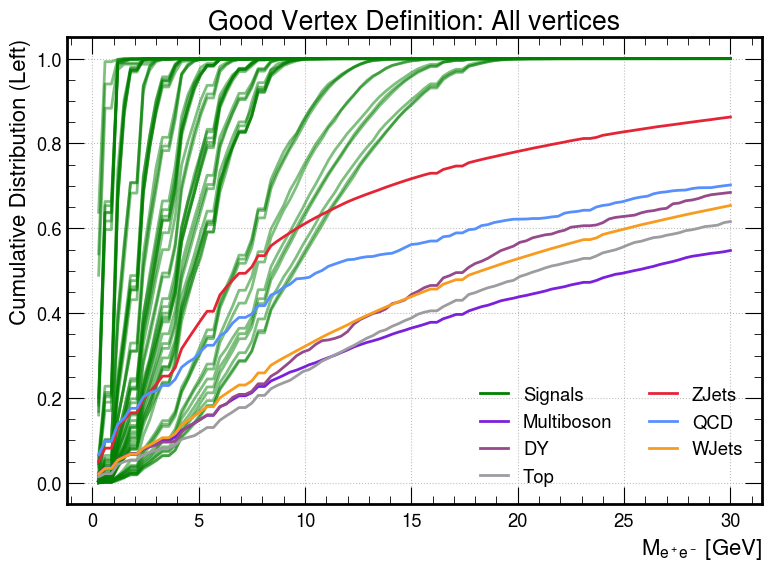

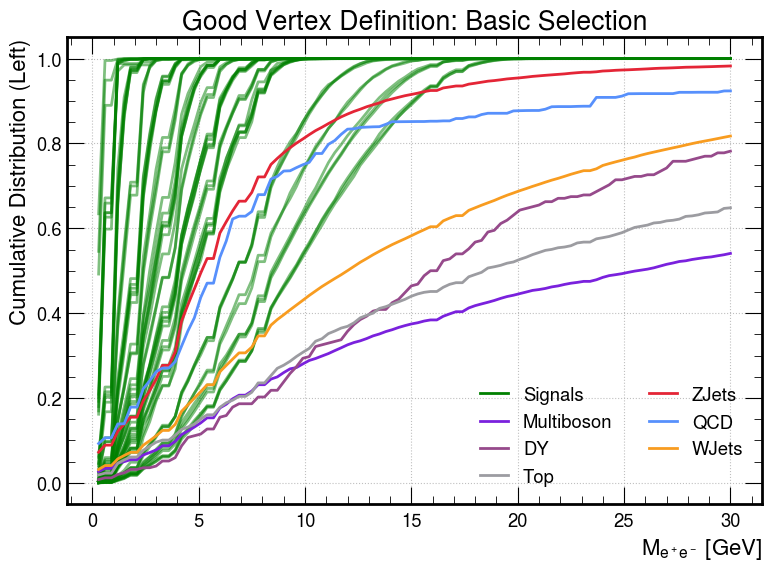

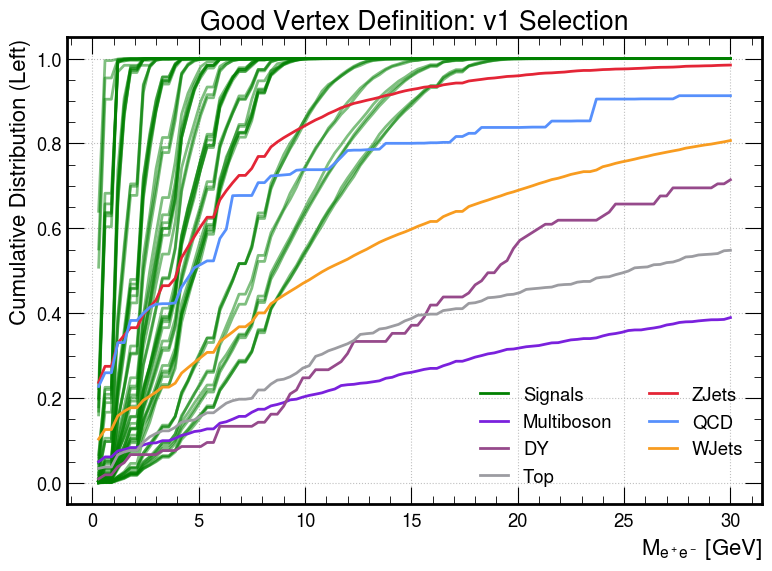

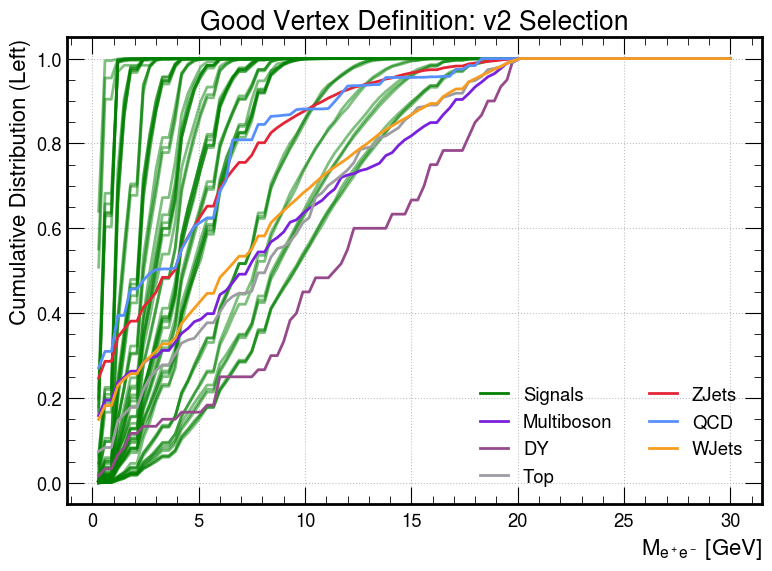

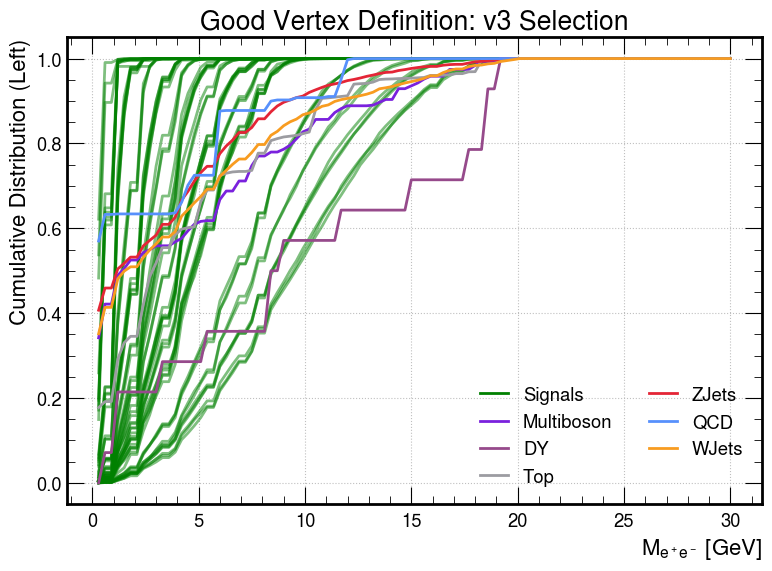

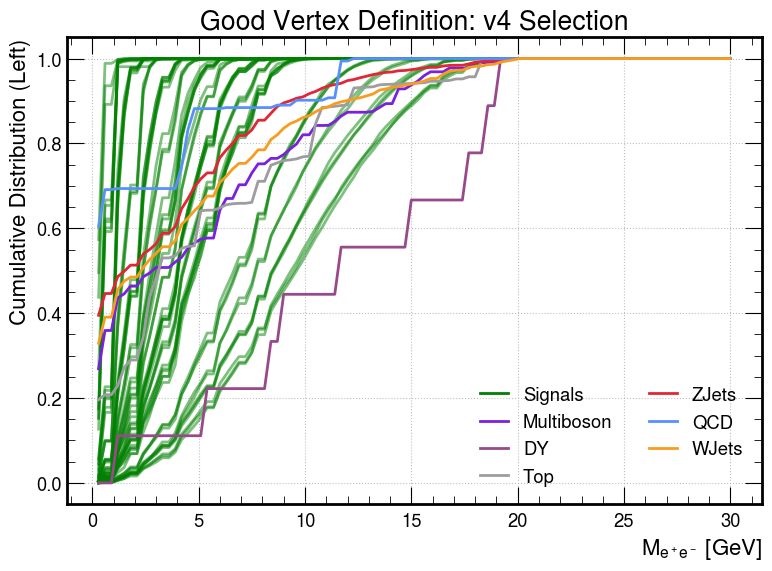

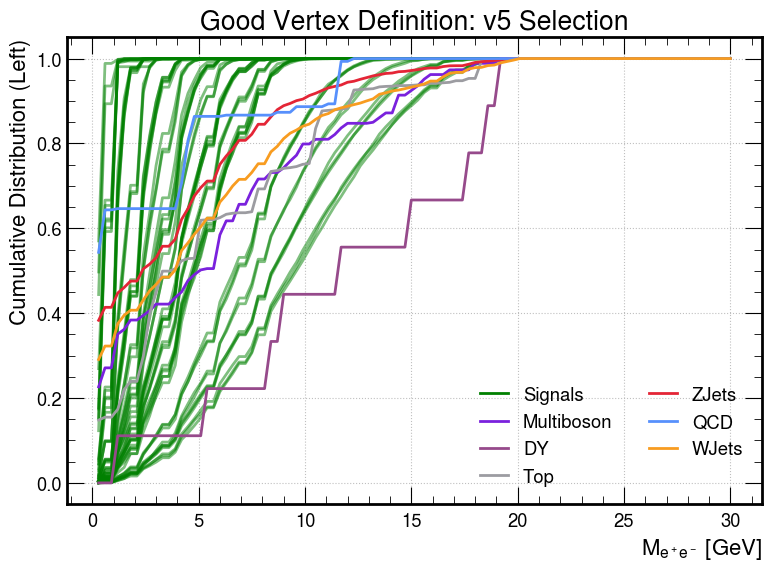

In [40]:
for cut,desc in zip(cuts,descriptions):
    selection = {"cut":cut,"vtype":sum}
    xlabel = r"$M_{e^+e^-}$ [GeV]"
    title = f"Good Vertex Definition: {desc}"
    ylabel = "A.U."
    hname = "match_vtx_mass"
    hname_bkg = "sel_vtx_mass"
    outD = f"plots_vtxStudy/vertexSelection_cdfs/{cut}/"
    outName = "matchSig_vs_bkg_cdf_vtx_mass"+f"_{cut}"
    make_cdf_summary_sigVsBkg(dfs,hcs,hcb,hname,hname_bkg,selection,outName,outD,xlabel=xlabel,
                              save=True,show=True,right=False,title=title,ncol_leg=2)

/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not plac

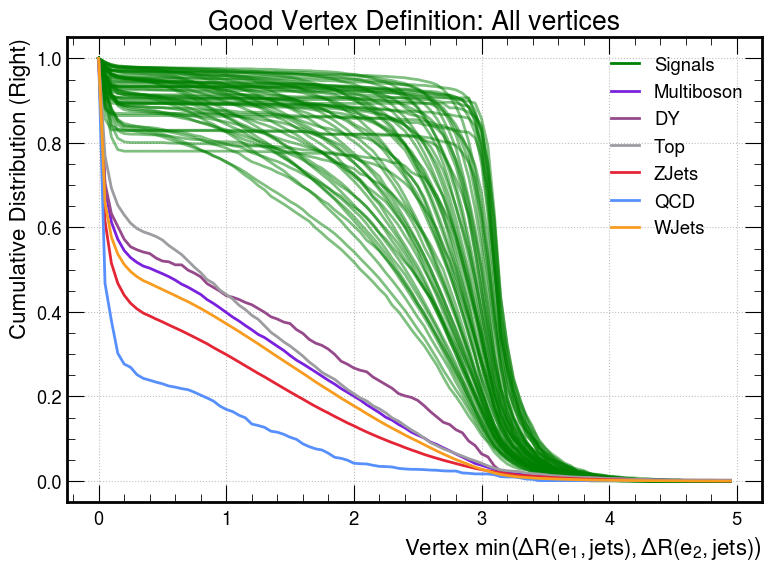

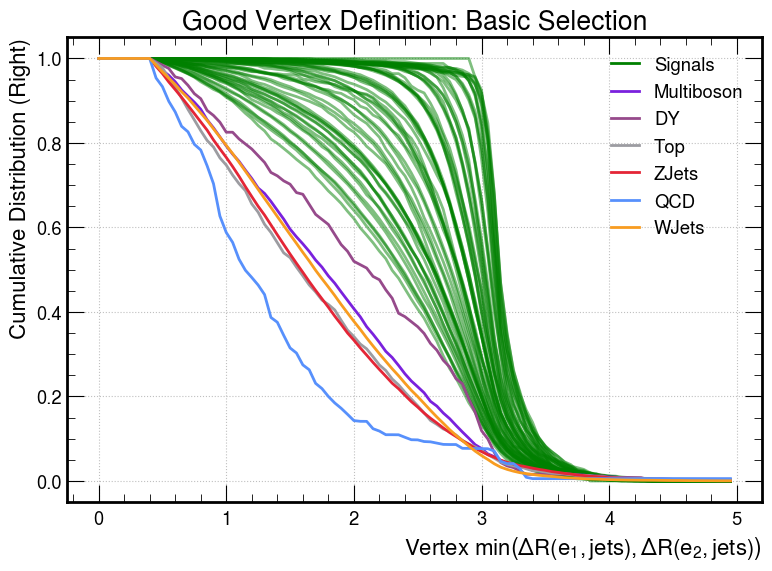

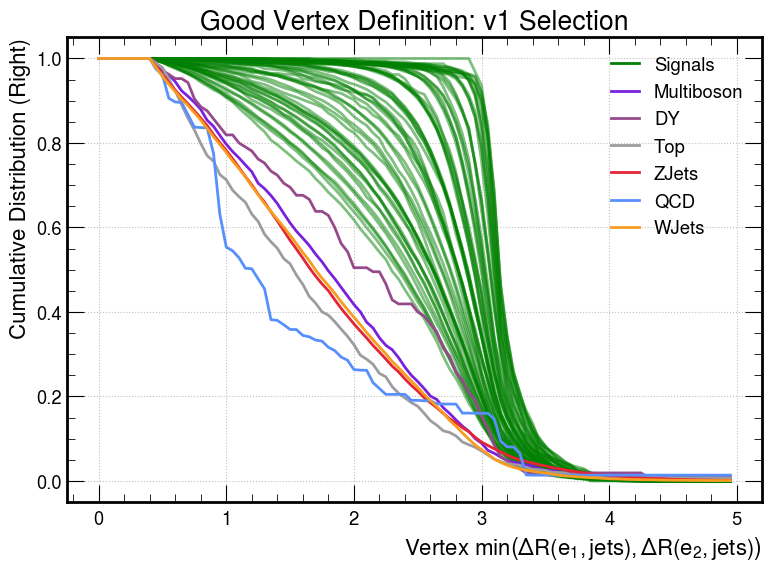

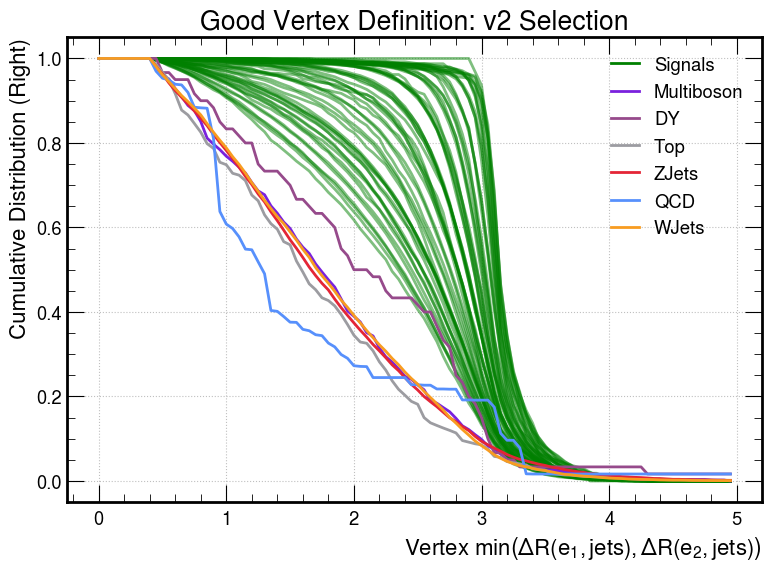

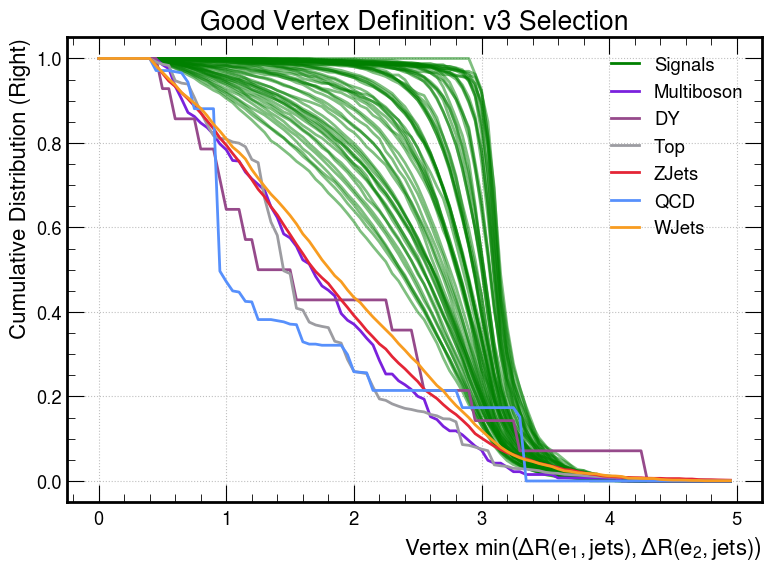

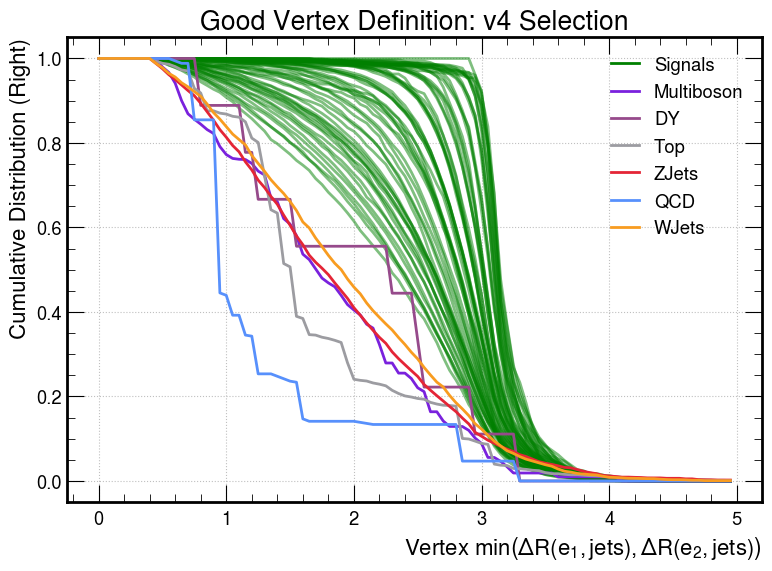

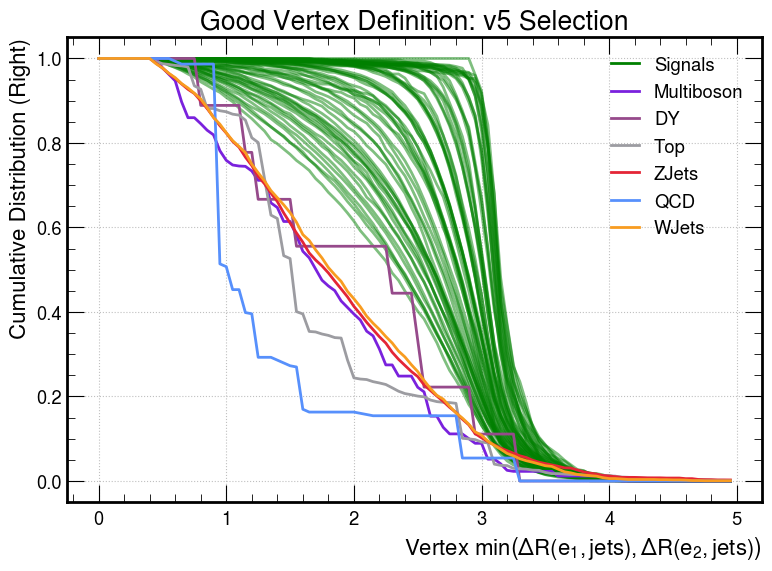

In [41]:
for cut,desc in zip(cuts,descriptions):
    selection = {"cut":cut,"vtype":sum}
    xlabel = r"Vertex $\min\left(\Delta R(e_1,\text{jets}),\Delta R(e_2,\text{jets})\right)$"
    title = f"Good Vertex Definition: {desc}"
    ylabel = "A.U."
    hname = "match_vtx_minEleDrJ"
    hname_bkg = "sel_vtx_minEleDrJ"
    outD = f"plots_vtxStudy/vertexSelection_cdfs/{cut}/"
    outName = "matchSig_vs_bkg_cdf_vtx_minEleDrJ"+f"_{cut}"
    make_cdf_summary_sigVsBkg(dfs,hcs,hcb,hname,hname_bkg,selection,outName,outD,xlabel=xlabel,
                              save=True,show=True,right=True,title=title)

/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not plac

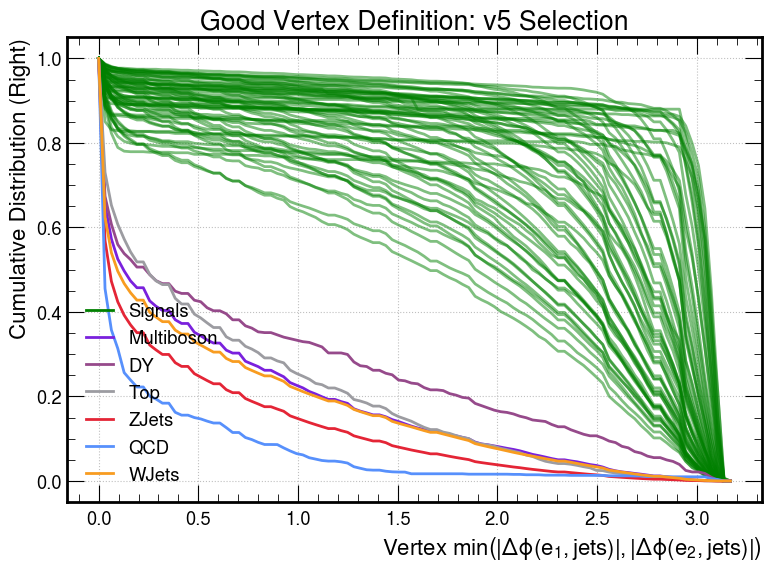

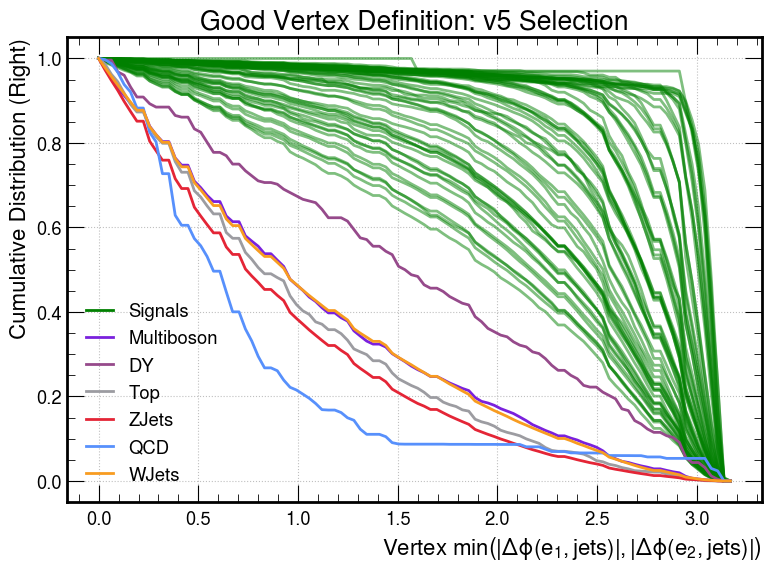

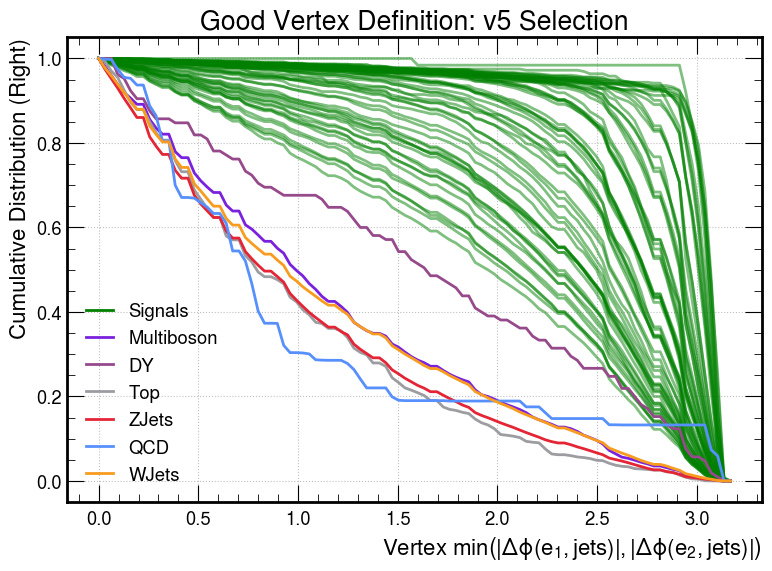

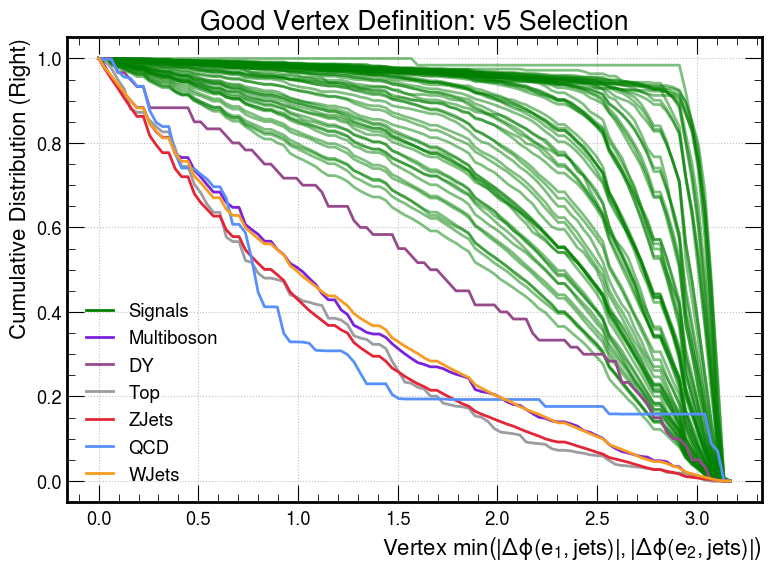

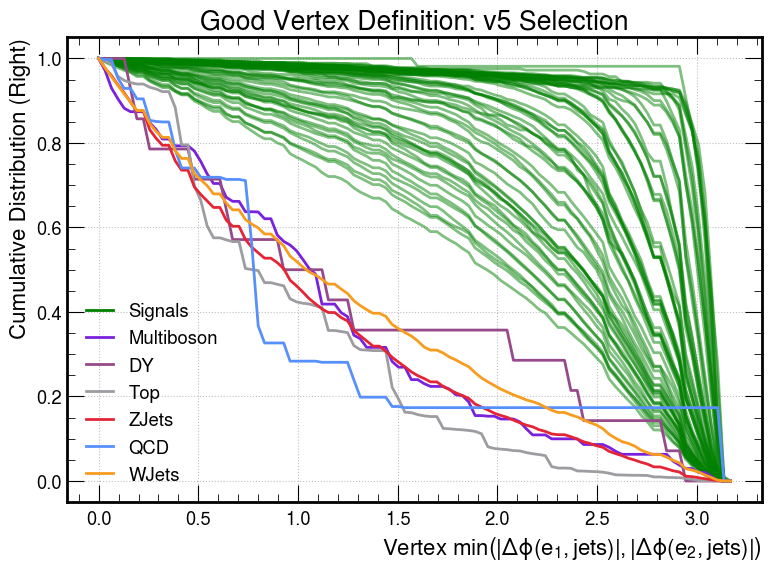

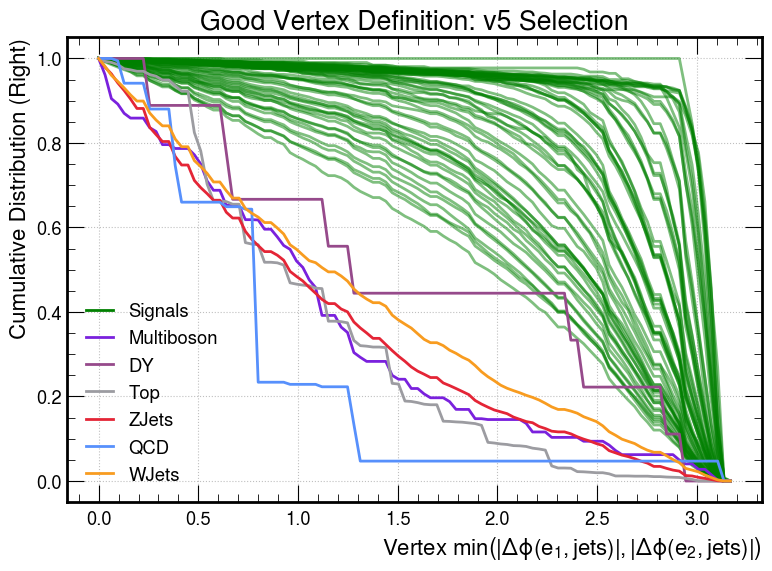

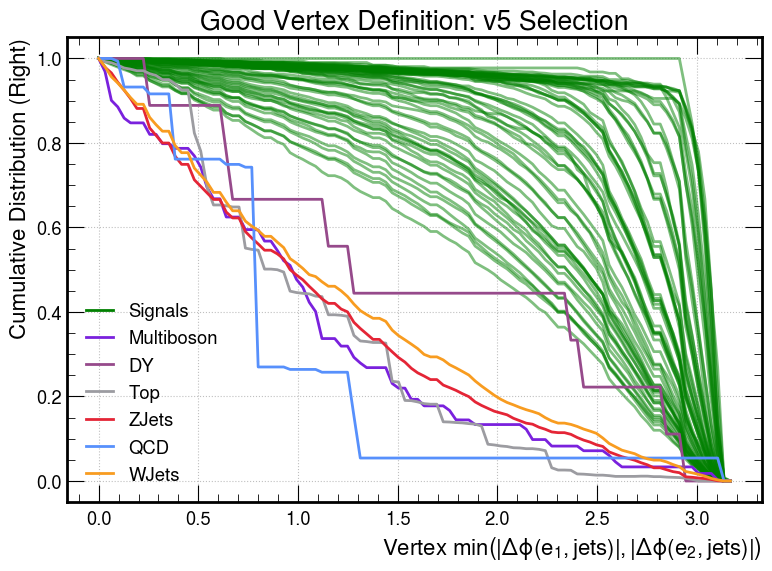

In [42]:
for cut,desc in zip(cuts,descriptions):
    selection = {"cut":cut,"vtype":sum}
    xlabel = r"Vertex $\min\left(|\Delta \phi(e_1,\text{jets})|,|\Delta \phi(e_2,\text{jets})|\right)$"
    ylabel = "A.U."
    hname = "match_vtx_minEleDPhiJ"
    hname_bkg = "sel_vtx_minEleDPhiJ"
    outD = f"plots_vtxStudy/vertexSelection_cdfs/{cut}/"
    outName = "matchSig_vs_bkg_cdf_vtx_minEleDPhiJ"+f"_{cut}"
    make_cdf_summary_sigVsBkg(dfs,hcs,hcb,hname,hname_bkg,selection,outName,outD,xlabel=xlabel,
                              save=True,show=True,right=True,title=title)

/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not plac

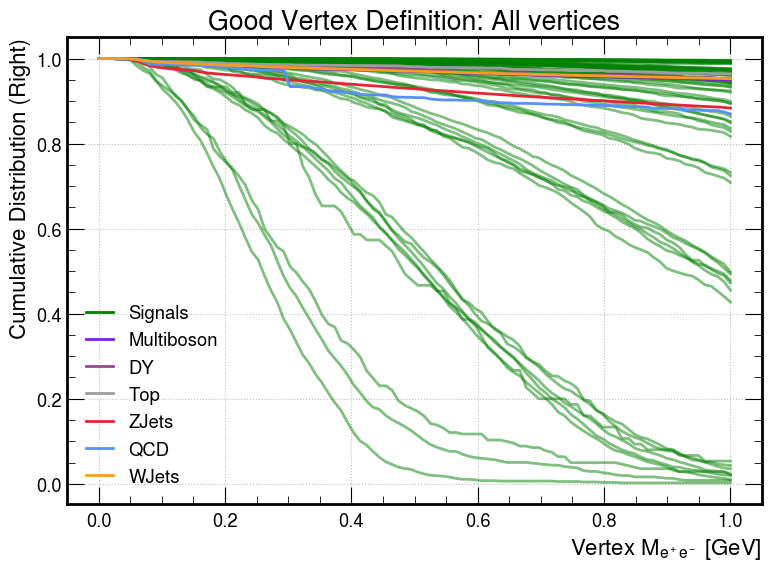

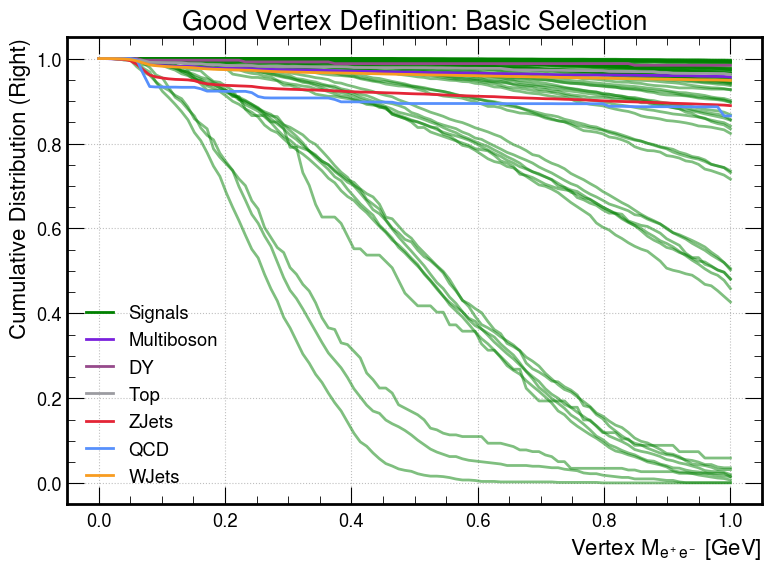

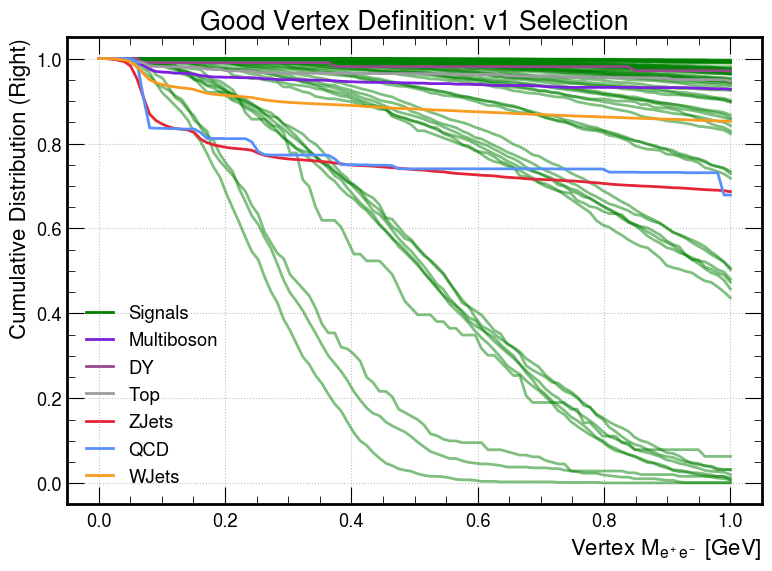

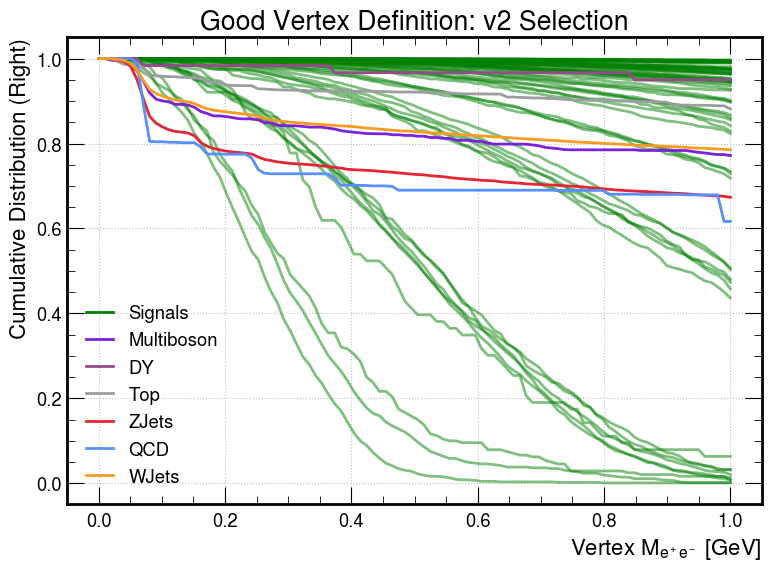

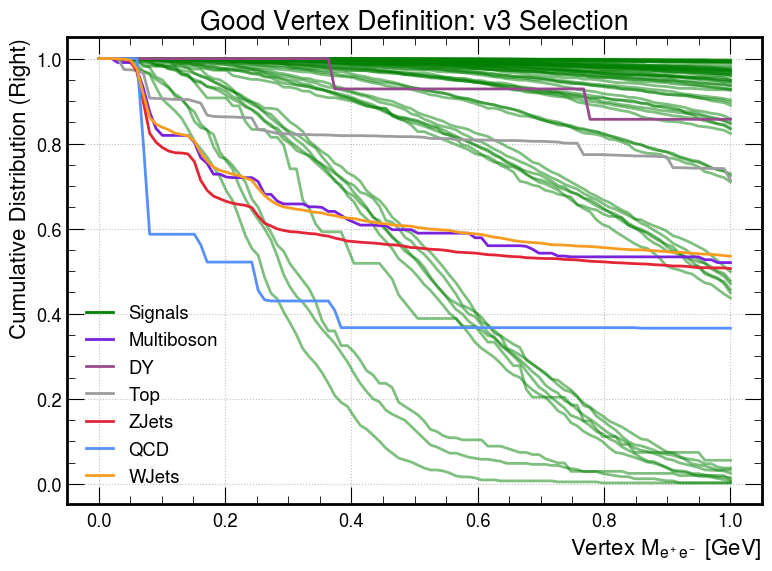

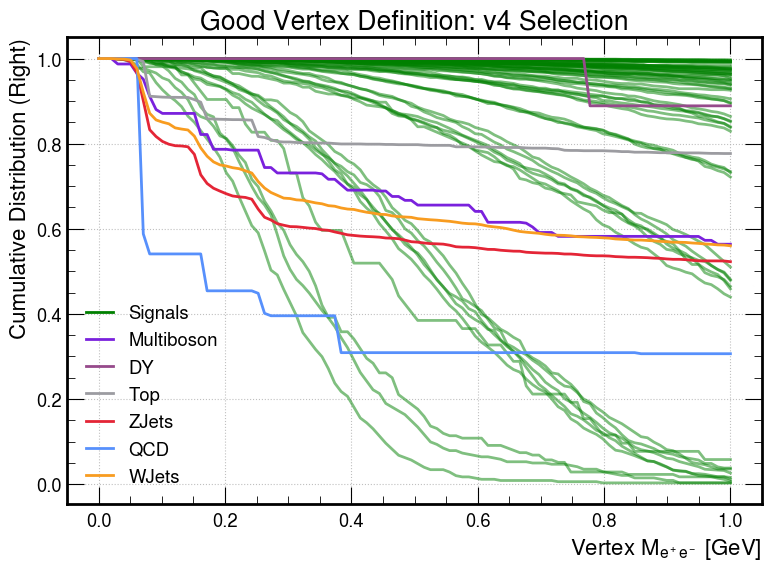

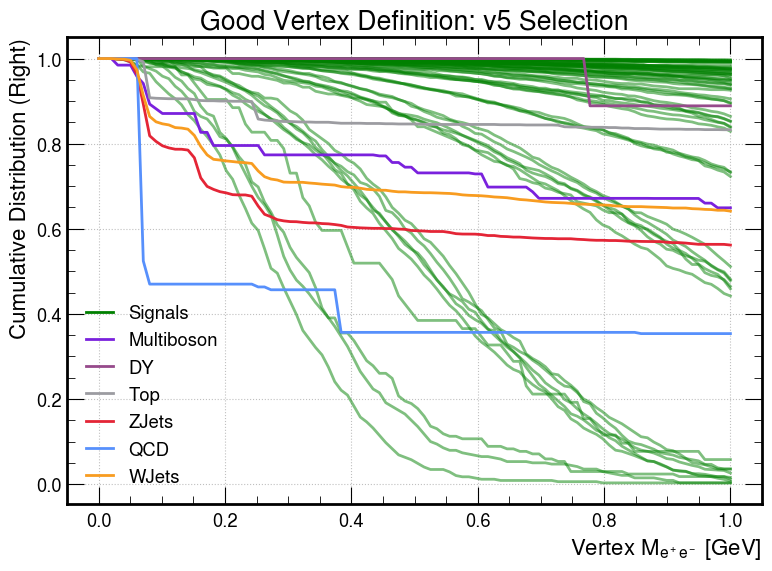

In [43]:
for cut,desc in zip(cuts,descriptions):
    selection = {"cut":cut,"vtype":sum}
    xlabel = r"Vertex $M_{e^+e^-}$ [GeV]"
    title = f"Good Vertex Definition: {desc}"
    ylabel = "A.U."
    hname = "match_vtx_mass_low"
    hname_bkg = "sel_vtx_mass_low"
    outD = f"plots_vtxStudy/vertexSelection_cdfs/{cut}/"
    outName = "matchSig_vs_bkg_cdf_vtx_mass_low"+f"_{cut}"
    make_cdf_summary_sigVsBkg(dfs,hcs,hcb,hname,hname_bkg,selection,outName,outD,xlabel=xlabel,xlim=[0,1],
                              save=True,show=True,right=True,title=title)

/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not plac

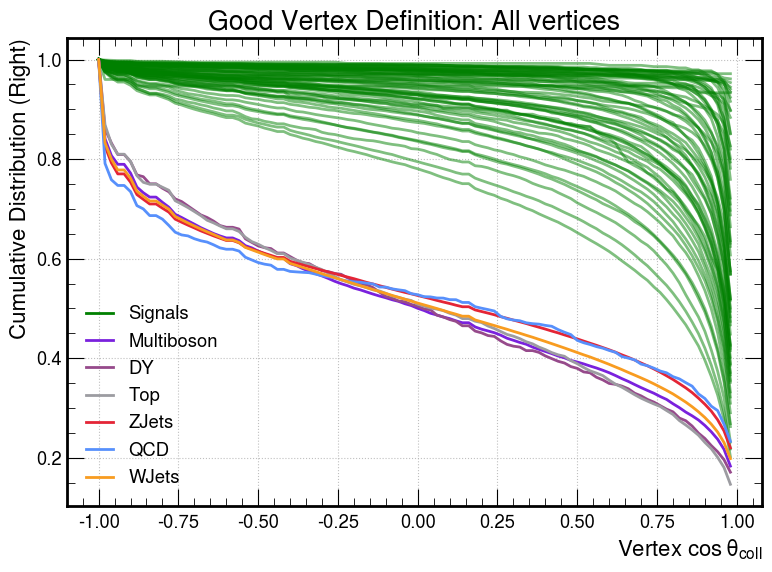

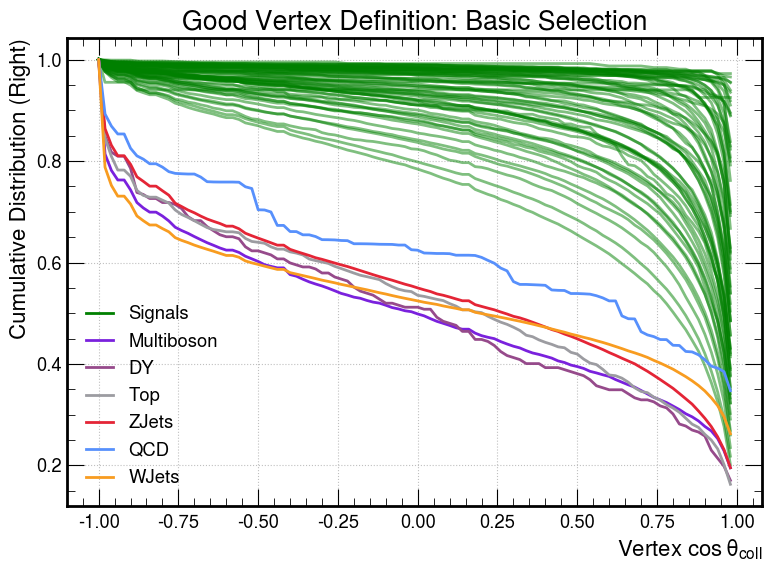

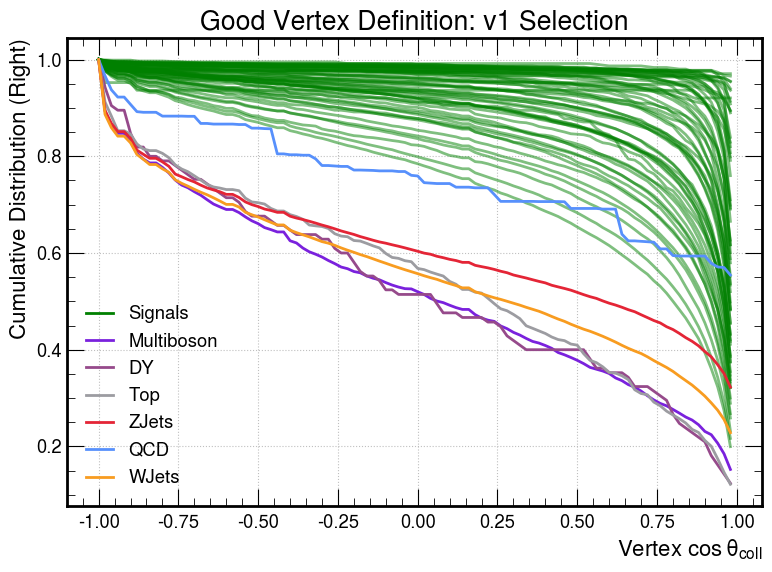

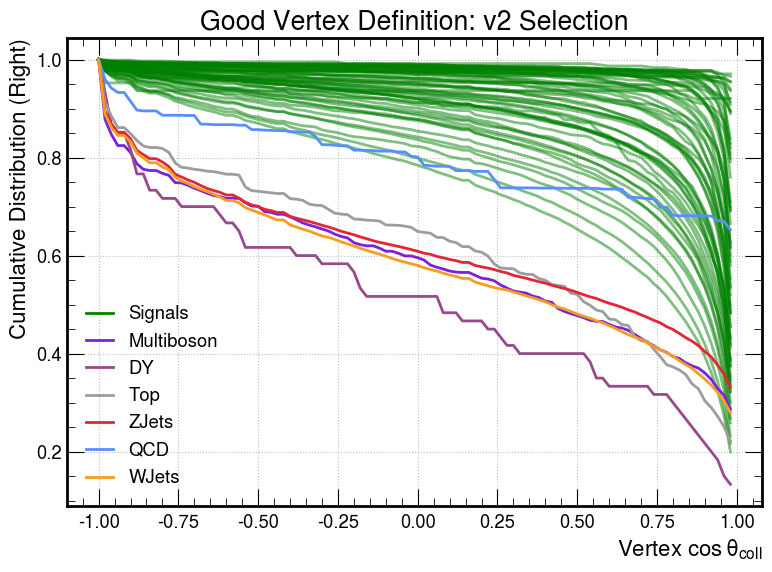

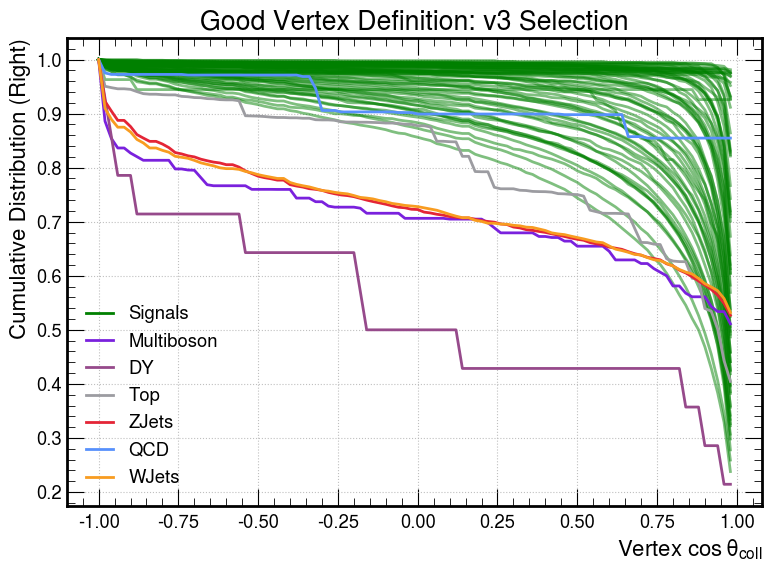

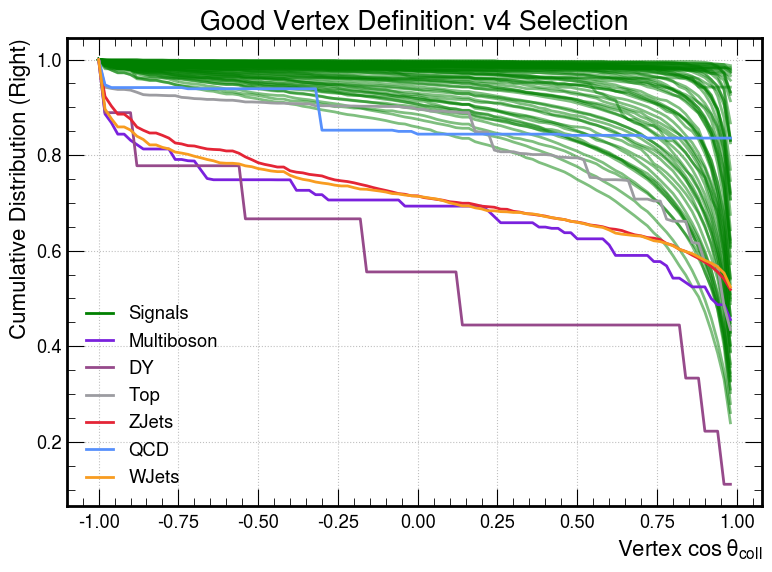

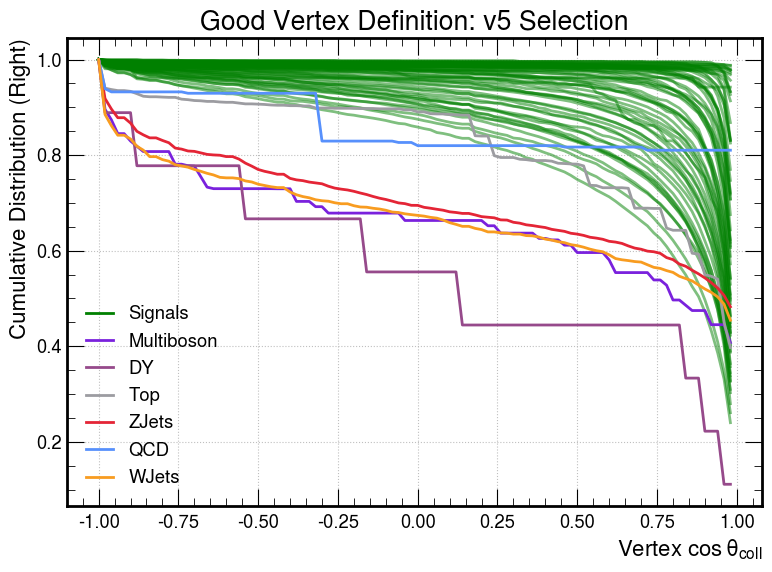

In [44]:
for cut,desc in zip(cuts,descriptions):
    selection = {"cut":cut,"vtype":sum}
    xlabel = r"Vertex $\cos \theta_\mathrm{coll}$"
    title = f"Good Vertex Definition: {desc}"
    ylabel = "A.U."
    hname = "match_vtx_CosThetaColl"
    hname_bkg = "sel_vtx_CosThetaColl"
    outD = f"plots_vtxStudy/vertexSelection_cdfs/{cut}/"
    outName = "matchSig_vs_bkg_cdf_vtx_cosThetaColl"+f"_{cut}"
    make_cdf_summary_sigVsBkg(dfs,hcs,hcb,hname,hname_bkg,selection,outName,outD,xlabel=xlabel,
                              save=True,show=True,right=True,title=title)

/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not plac

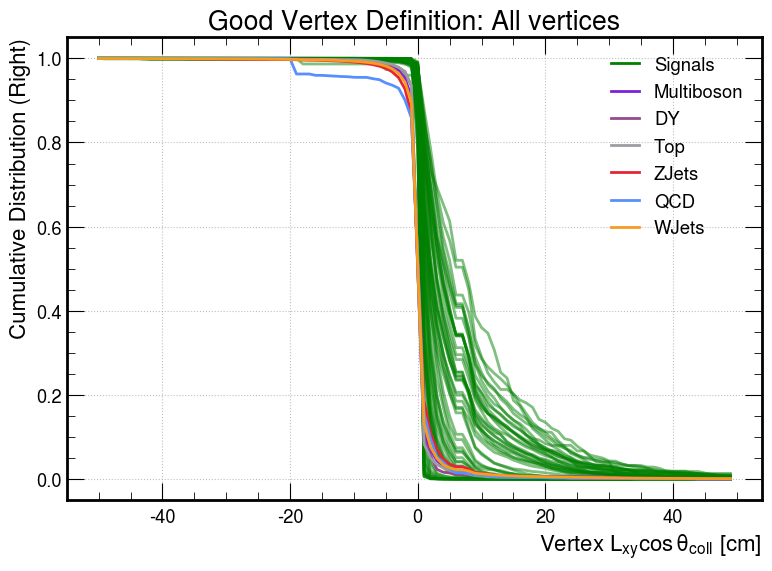

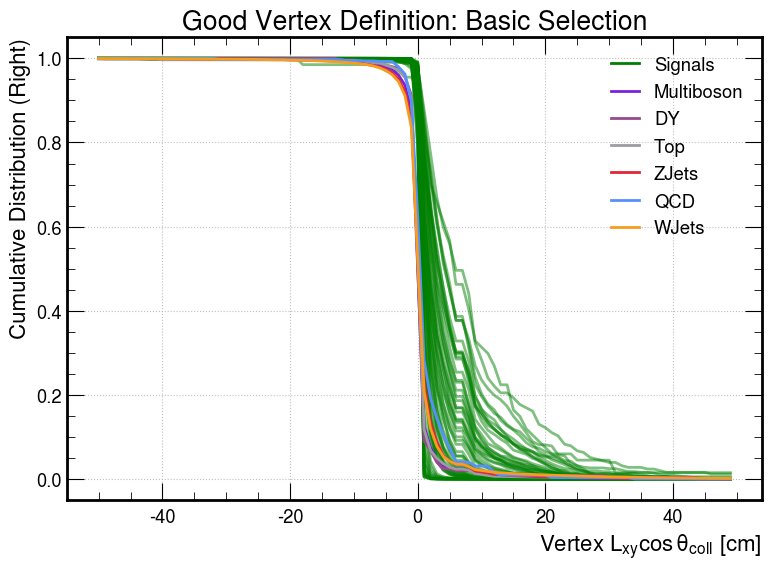

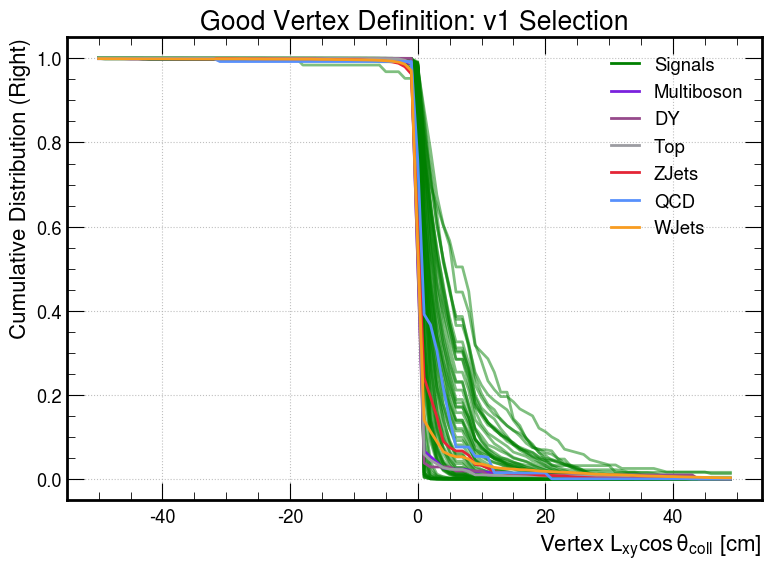

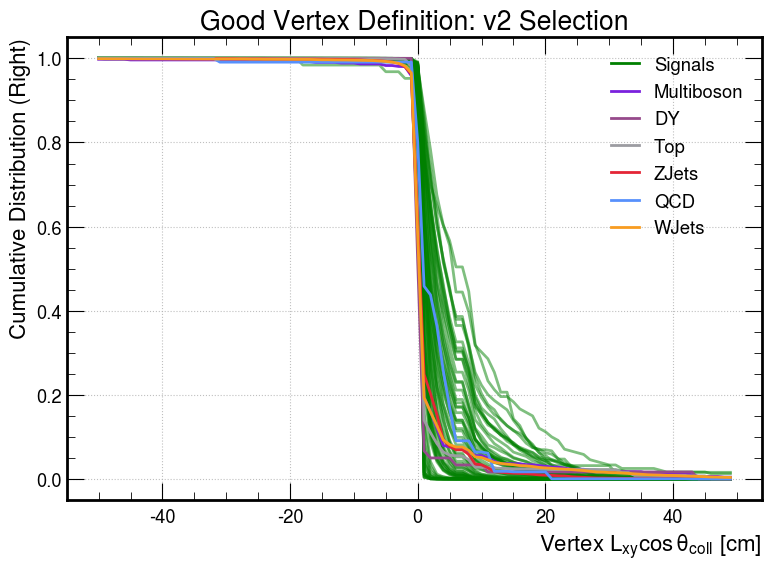

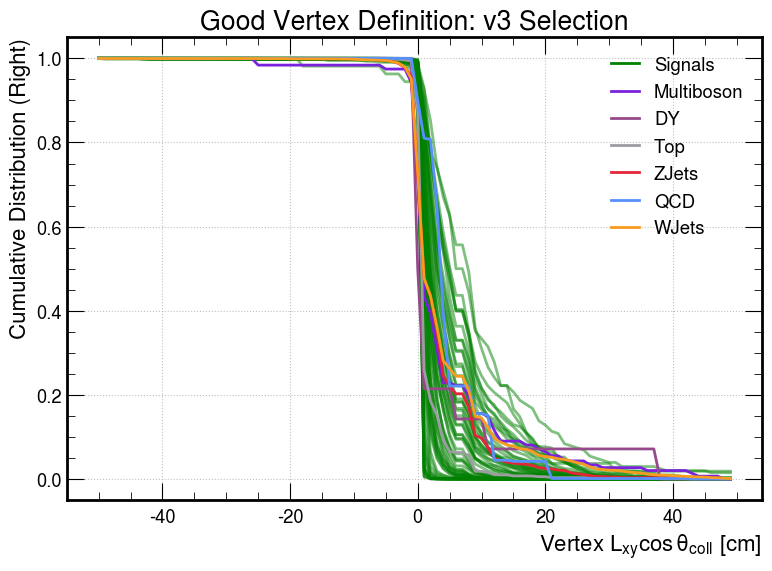

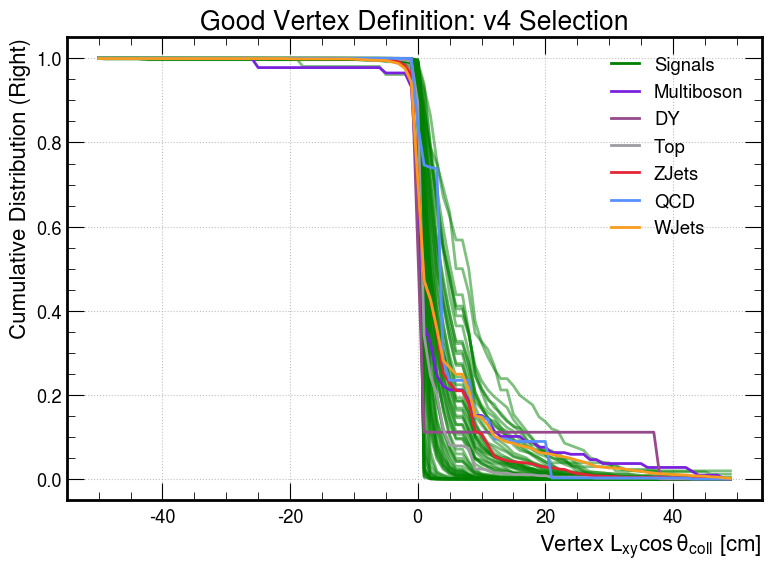

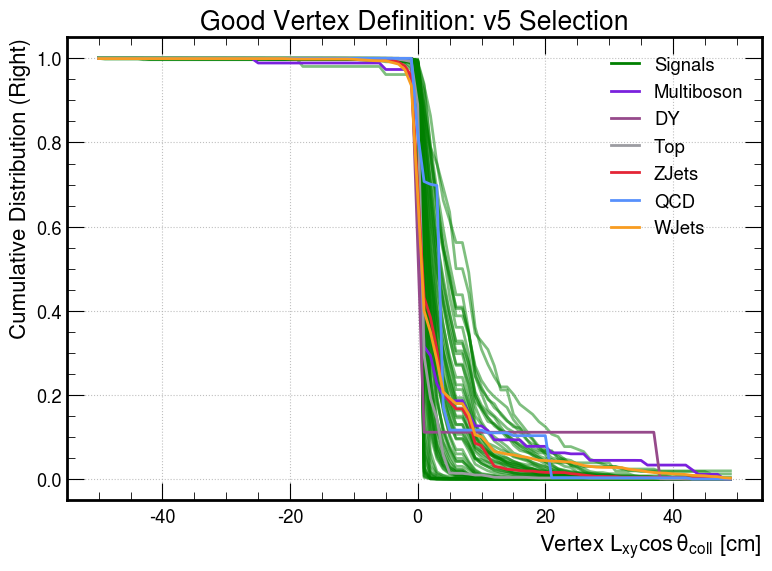

In [45]:
for cut,desc in zip(cuts,descriptions):
    selection = {"cut":cut,"vtype":sum}
    xlabel = r"Vertex $L_{xy}\cos \theta_\mathrm{coll}$ [cm]"
    title = f"Good Vertex Definition: {desc}"
    ylabel = "A.U."
    hname = "match_vtx_LxyCosThetaColl"
    hname_bkg = "sel_vtx_LxyCosThetaColl"
    outD = f"plots_vtxStudy/vertexSelection_cdfs/{cut}/"
    outName = "matchSig_vs_bkg_cdf_vtx_LxyCosThetaColl"+f"_{cut}"
    make_cdf_summary_sigVsBkg(dfs,hcs,hcb,hname,hname_bkg,selection,outName,outD,xlabel=xlabel,
                              save=True,show=True,right=True,title=title)

/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not plac

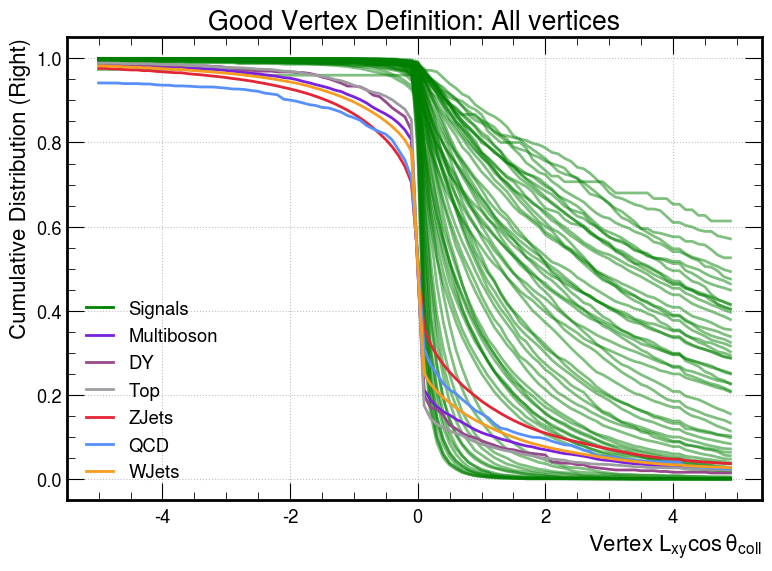

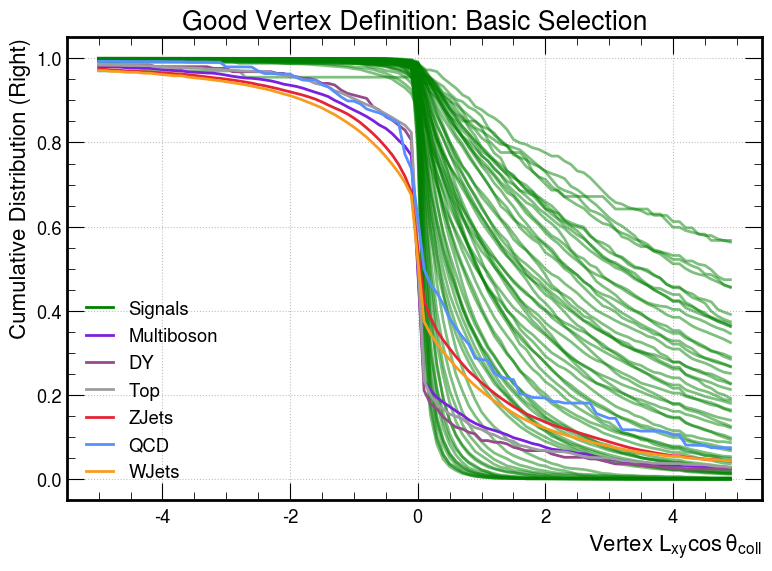

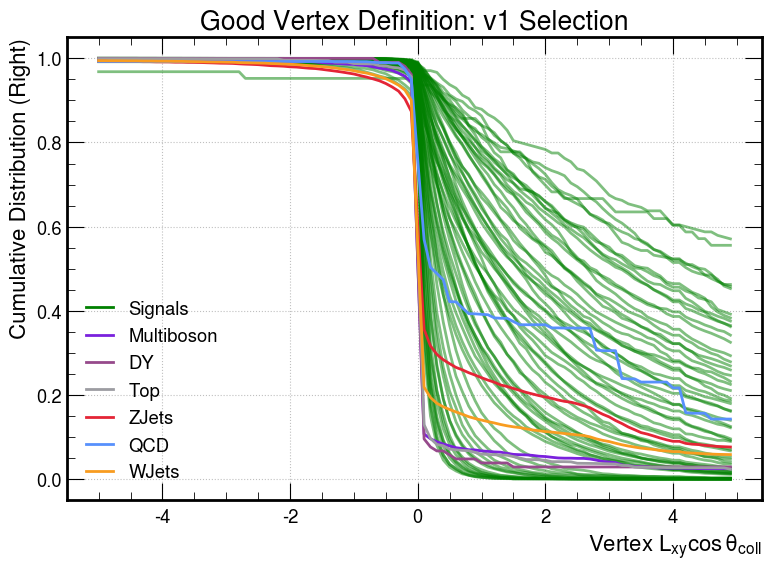

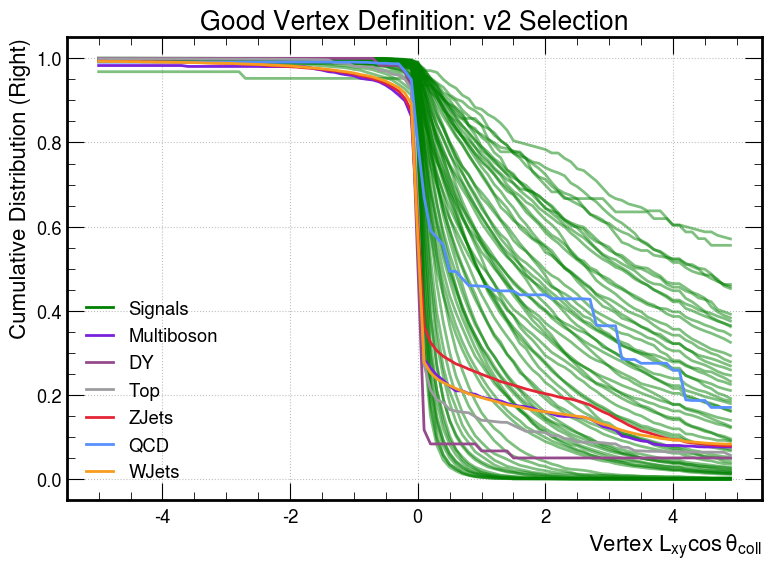

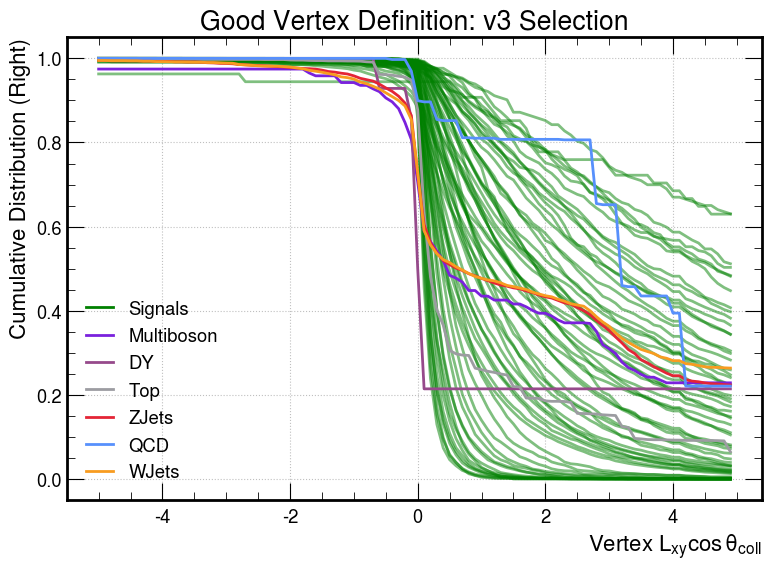

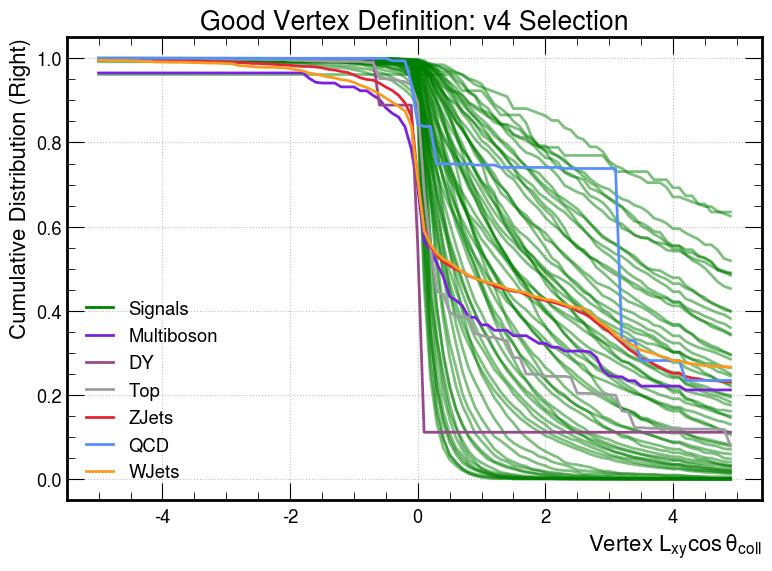

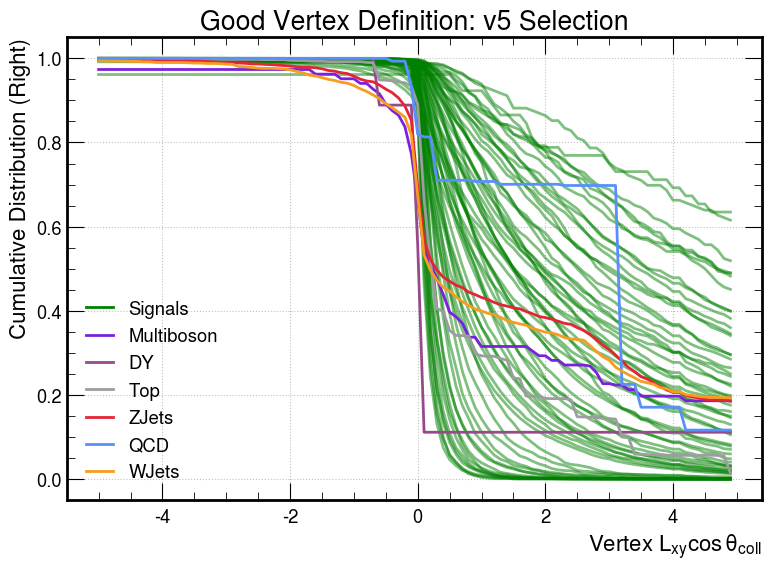

In [46]:
for cut,desc in zip(cuts,descriptions):
    selection = {"cut":cut,"vtype":sum}
    xlabel = r"Vertex $L_{xy}\cos \theta_\mathrm{coll}$"
    title = f"Good Vertex Definition: {desc}"
    hname = "match_vtx_LxyCosThetaCollZoom"
    hname_bkg = "sel_vtx_LxyCosThetaCollZoom"
    outD = f"plots_vtxStudy/vertexSelection_cdfs/{cut}/"
    outName = "matchSig_vs_bkg_cdf_vtx_LxyCosThetaCollZoom"+f"_{cut}"
    make_cdf_summary_sigVsBkg(dfs,hcs,hcb,hname,hname_bkg,selection,outName,outD,xlabel=xlabel,
                              save=True,show=True,right=True,title=title)

/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not plac

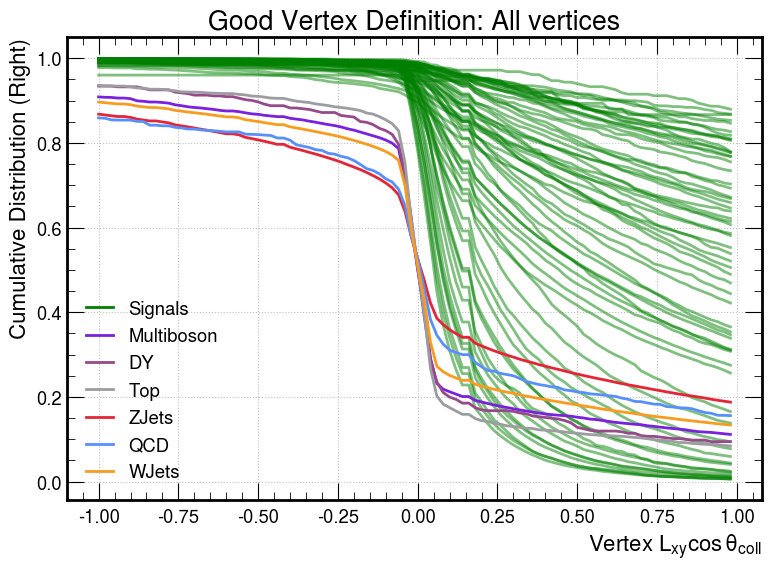

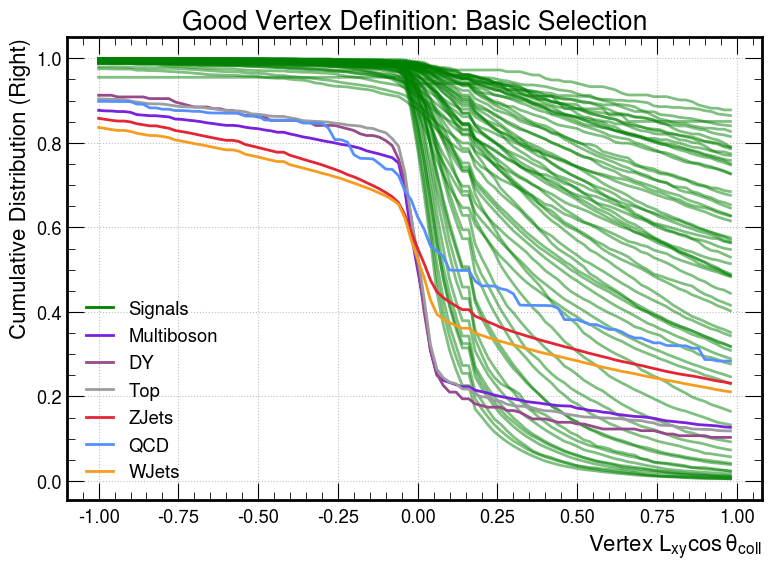

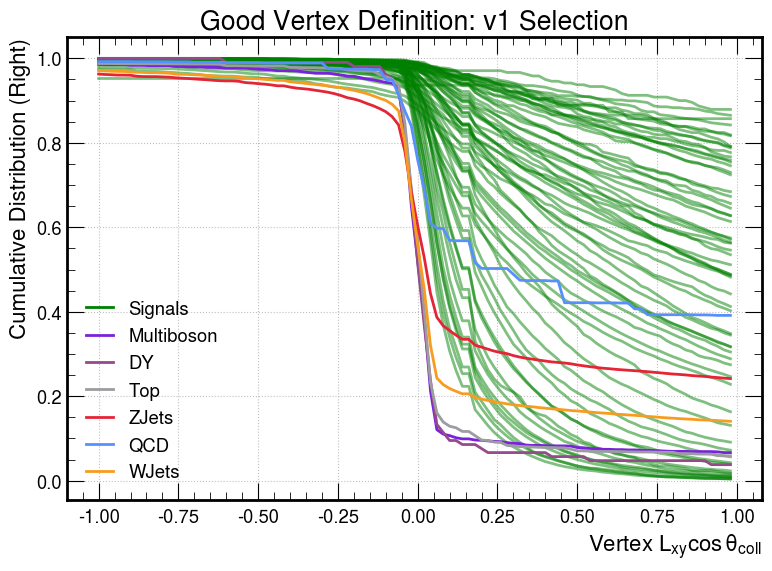

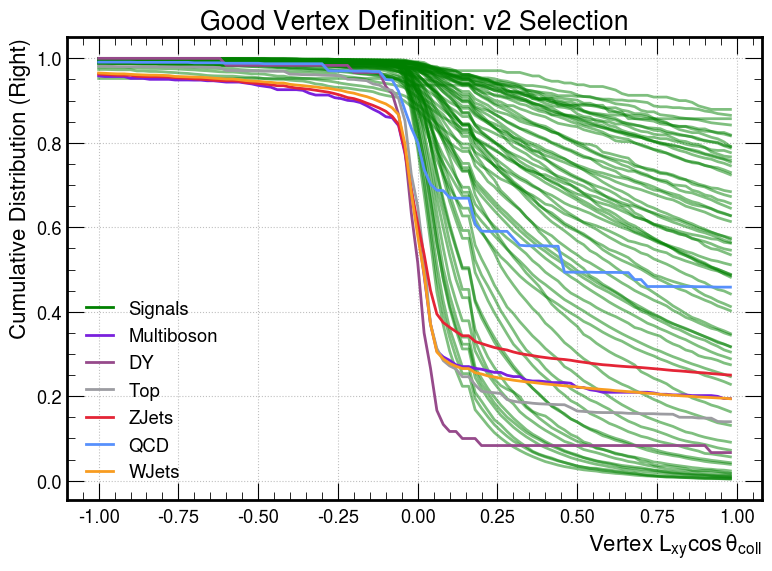

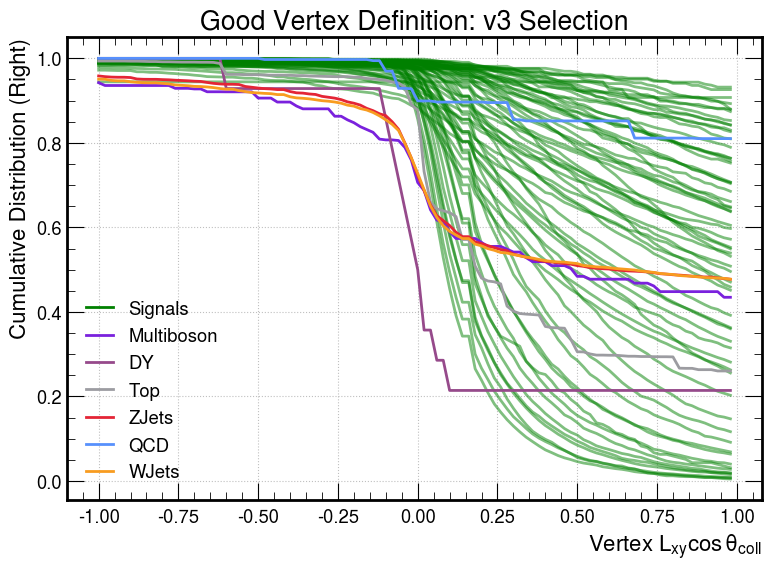

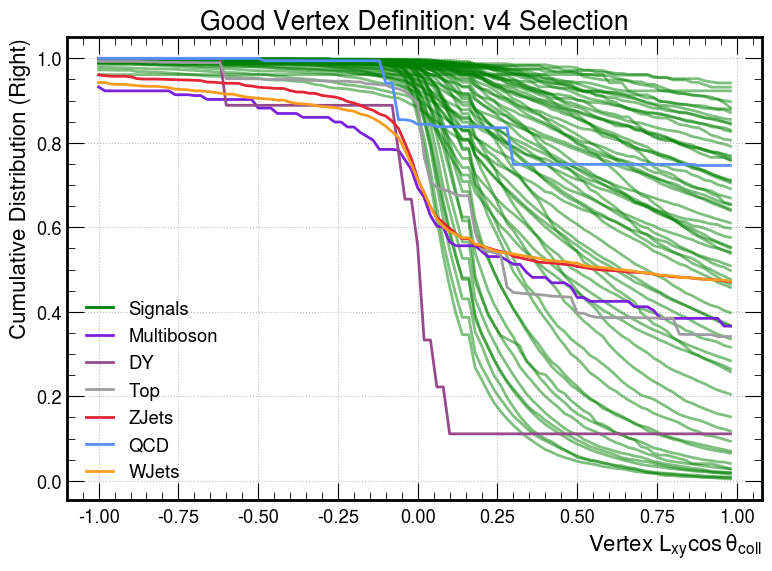

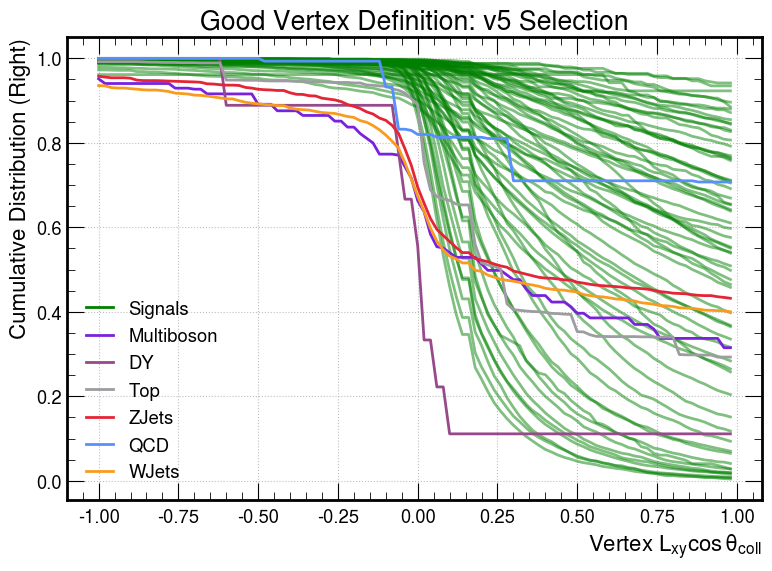

In [47]:
for cut,desc in zip(cuts,descriptions):
    selection = {"cut":cut,"vtype":sum}
    xlabel = r"Vertex $L_{xy}\cos \theta_\mathrm{coll}$"
    ylabel = "A.U."
    title = f"Good Vertex Definition: {desc}"
    hname = "match_vtx_LxyCosThetaCollZoomZoom"
    hname_bkg = "sel_vtx_LxyCosThetaCollZoomZoom"
    outD = f"plots_vtxStudy/vertexSelection_cdfs/{cut}/"
    outName = "matchSig_vs_bkg_cdf_vtx_LxyCosThetaCollZoomZoom"+f"_{cut}"
    make_cdf_summary_sigVsBkg(dfs,hcs,hcb,hname,hname_bkg,selection,outName,outD,xlabel=xlabel,
                              save=True,show=True,right=True,title=title)

/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not plac

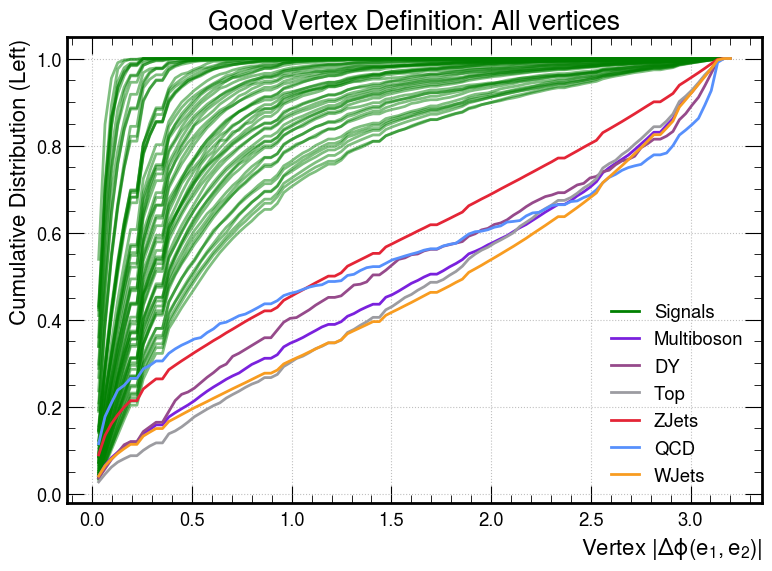

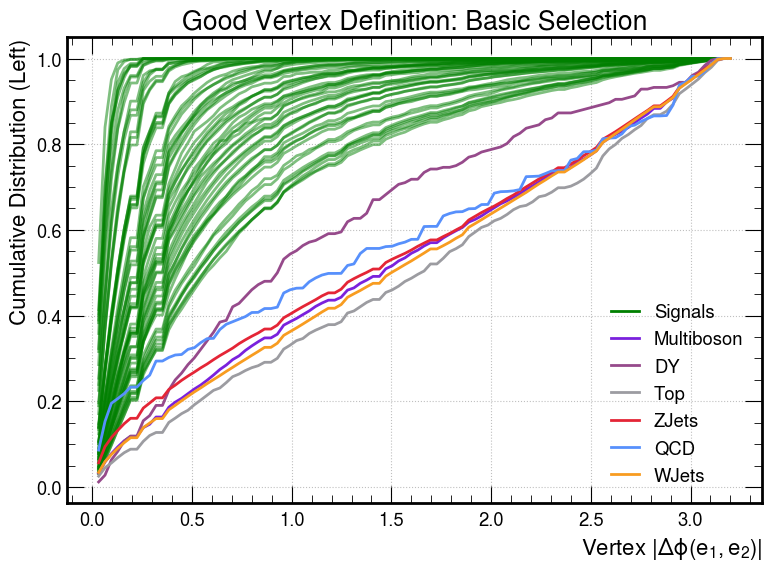

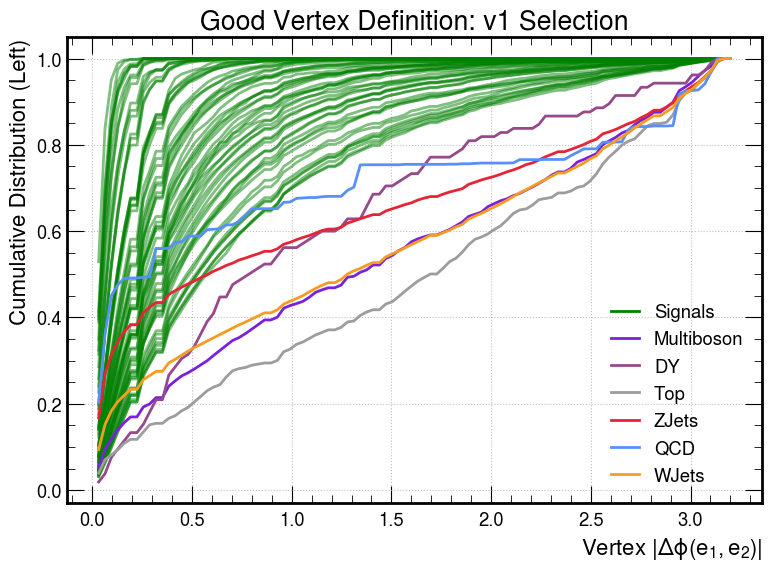

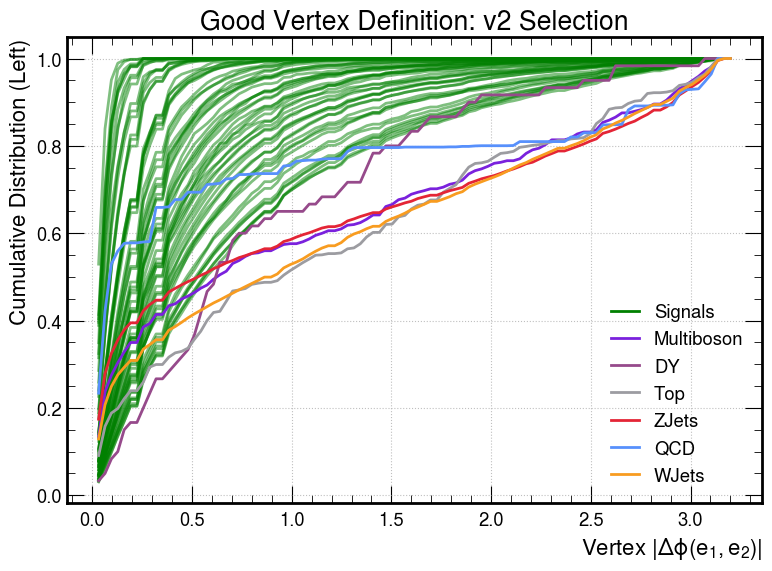

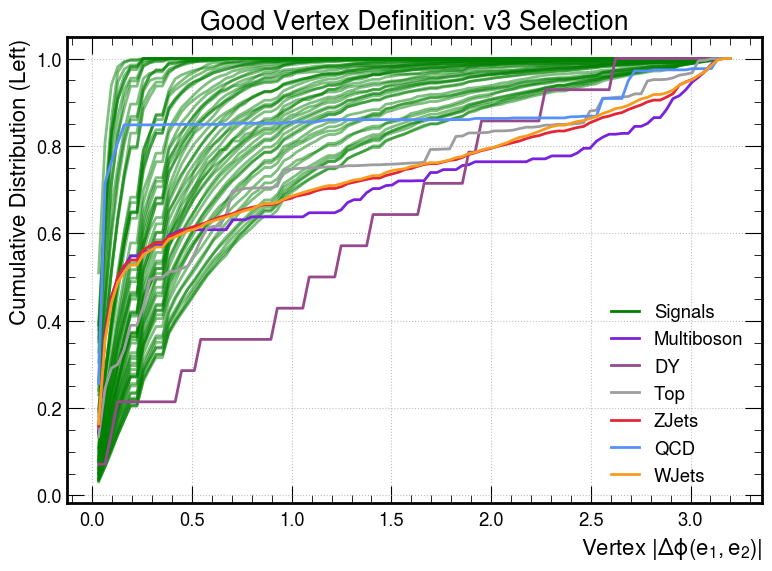

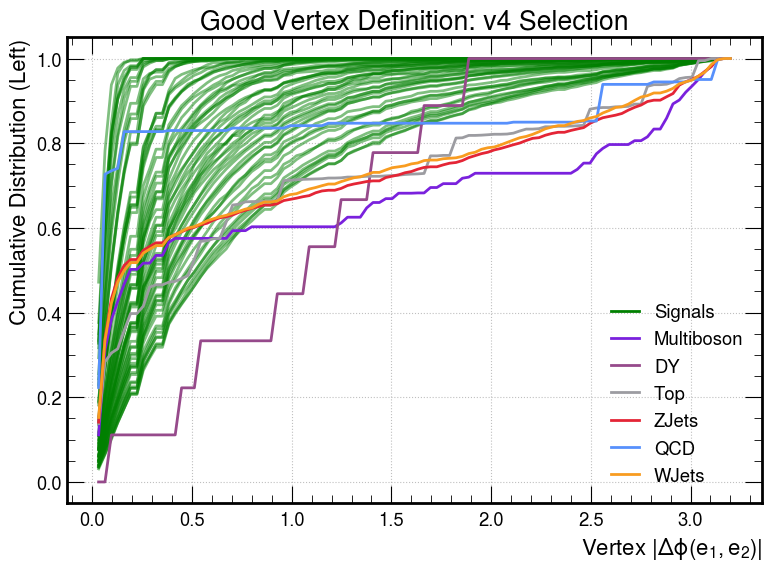

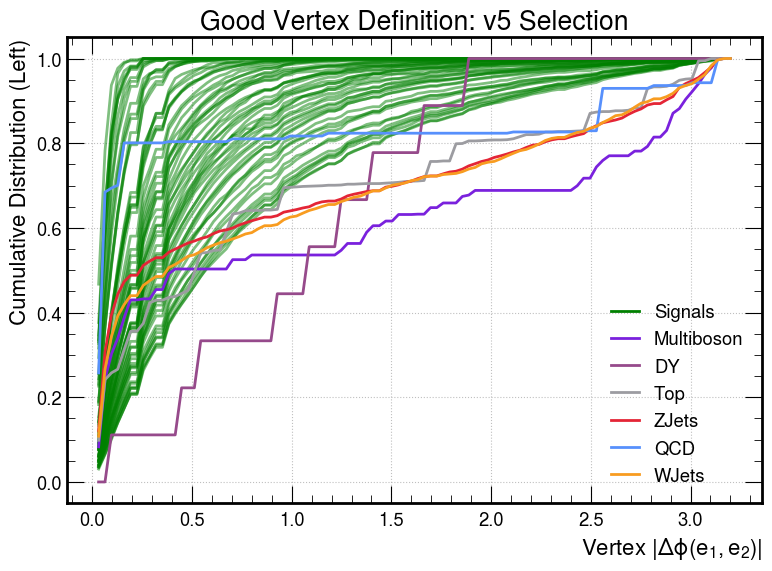

In [48]:
for cut,desc in zip(cuts,descriptions):
    selection = {"cut":cut,"vtype":sum}
    xlabel = r"Vertex $|\Delta \phi(e_1,e_2)|$"
    title = f"Good Vertex Definition: {desc}"
    ylabel = "A.U."
    hname = "match_vtx_eleDphi"
    hname_bkg = "sel_vtx_eleDphi"
    outD = f"plots_vtxStudy/vertexSelection_cdfs/{cut}/"
    outName = "matchSig_vs_bkg_cdf_vtx_eleDphi"+f"_{cut}"
    make_cdf_summary_sigVsBkg(dfs,hcs,hcb,hname,hname_bkg,selection,outName,outD,xlabel=xlabel,
                              save=True,show=True,right=False,title=title)

/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not plac

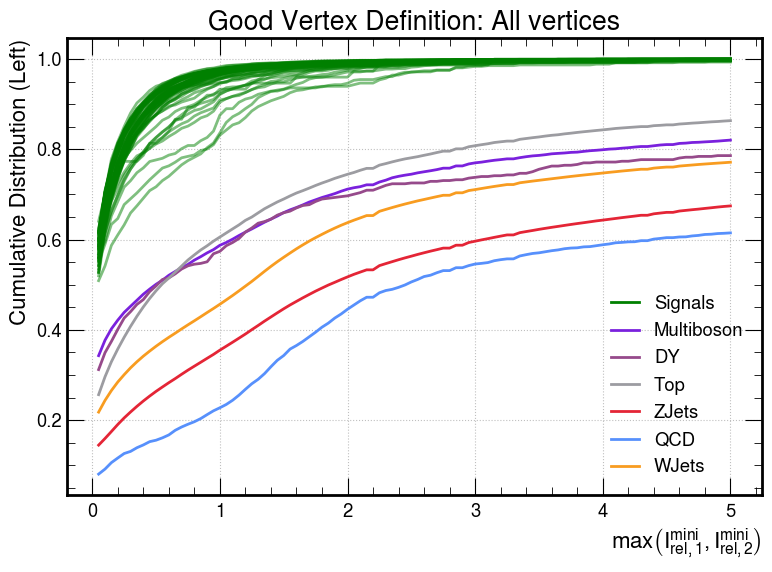

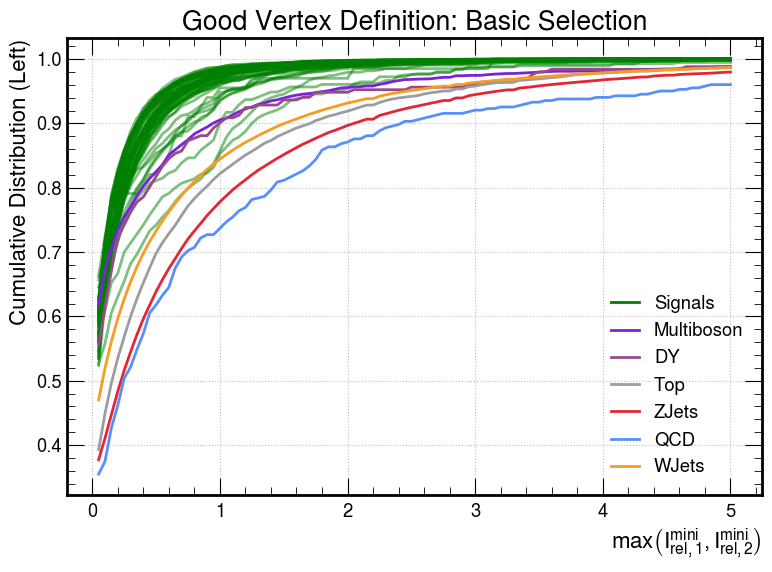

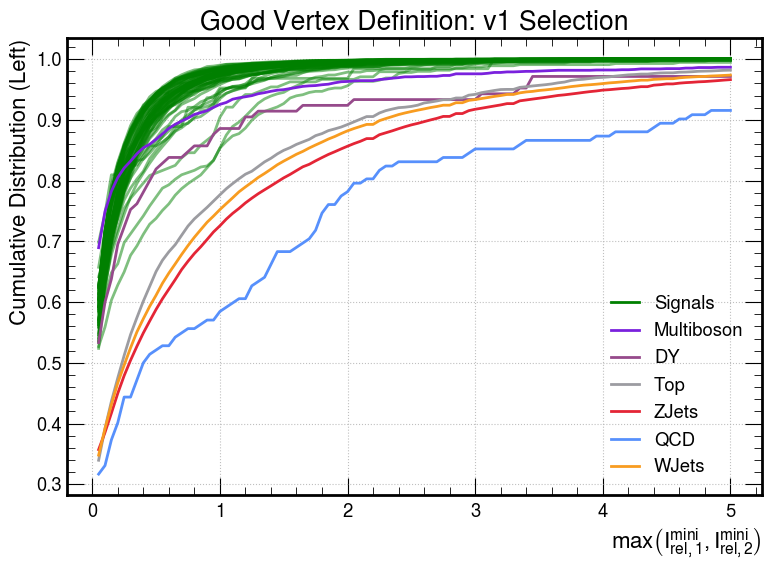

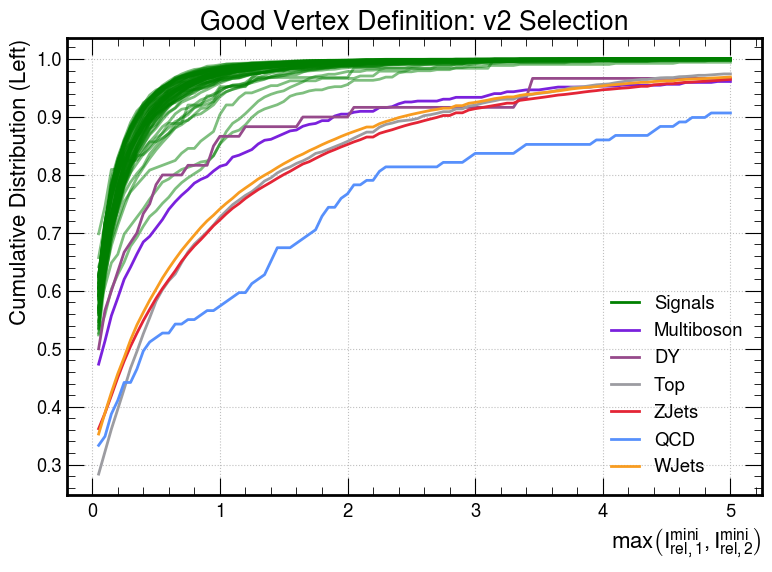

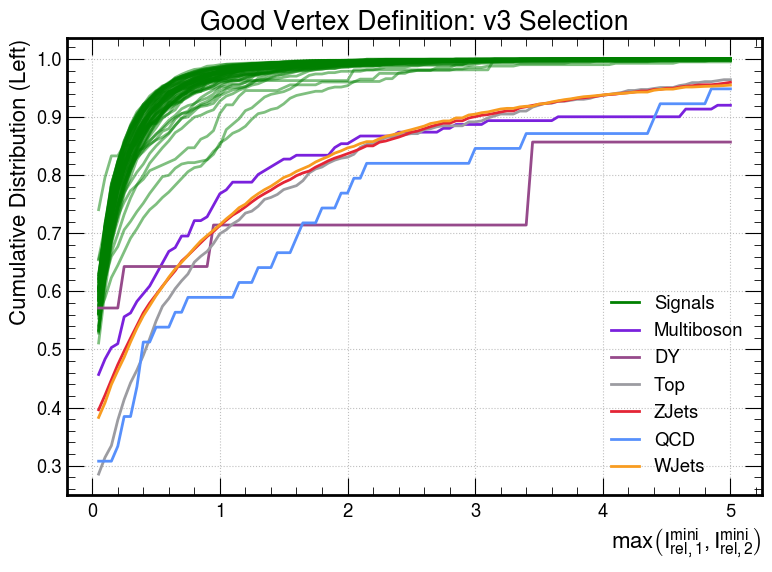

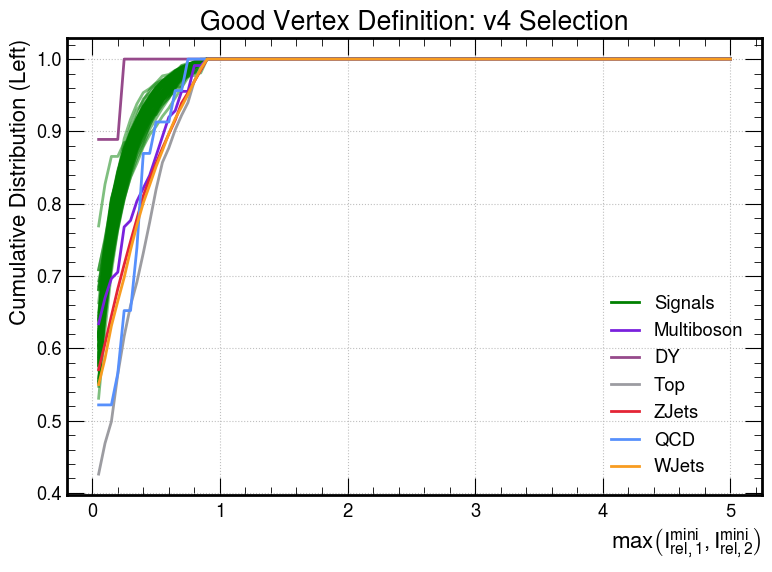

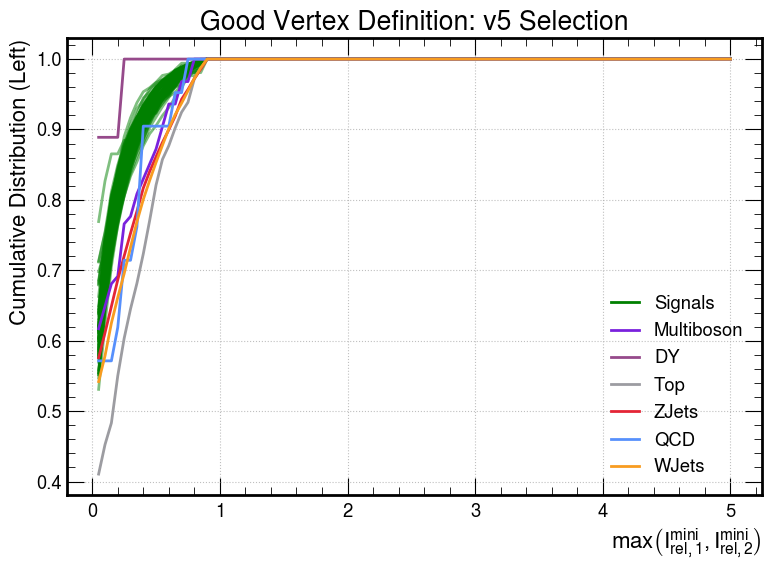

In [49]:
for cut,desc in zip(cuts,descriptions):
    selection = {"cut":cut,"vtype":sum}
    xlabel = r"$\max\left(I_{\mathrm{rel},1}^\mathrm{mini},I_{\mathrm{rel},2}^\mathrm{mini}\right)$"
    title = f"Good Vertex Definition: {desc}"
    ylabel = "A.U."
    hname = "match_vtx_maxMiniRelIsoCorr"
    hname_bkg = "sel_vtx_maxMiniRelIsoCorr"
    outD = f"plots_vtxStudy/vertexSelection_cdfs/{cut}/"
    outName = "matchSig_vs_bkg_cdf_vtx_maxMiniRelIso"+f"_{cut}"
    make_cdf_summary_sigVsBkg(dfs,hcs,hcb,hname,hname_bkg,selection,outName,outD,xlabel=xlabel,
                              save=True,show=True,right=False,title=title)

/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not plac

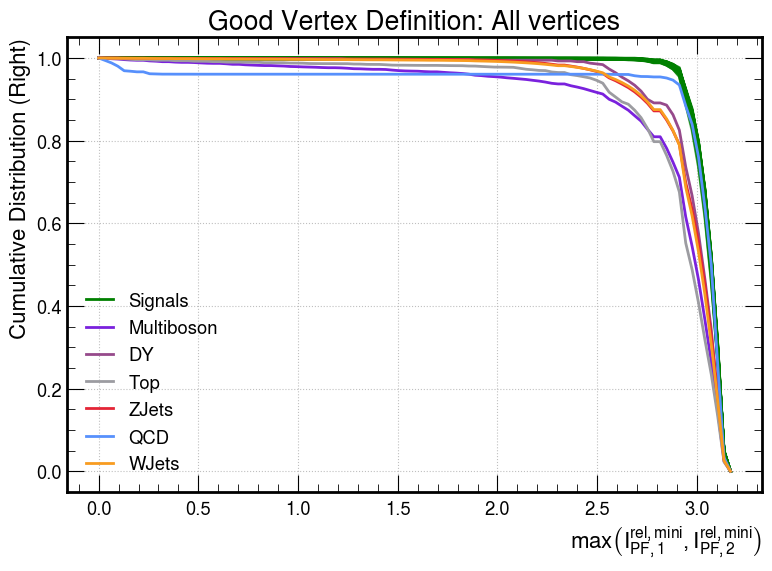

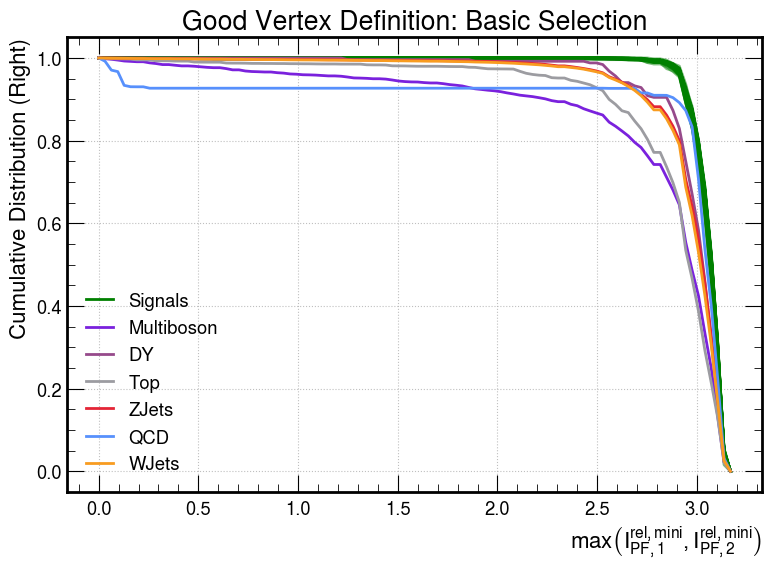

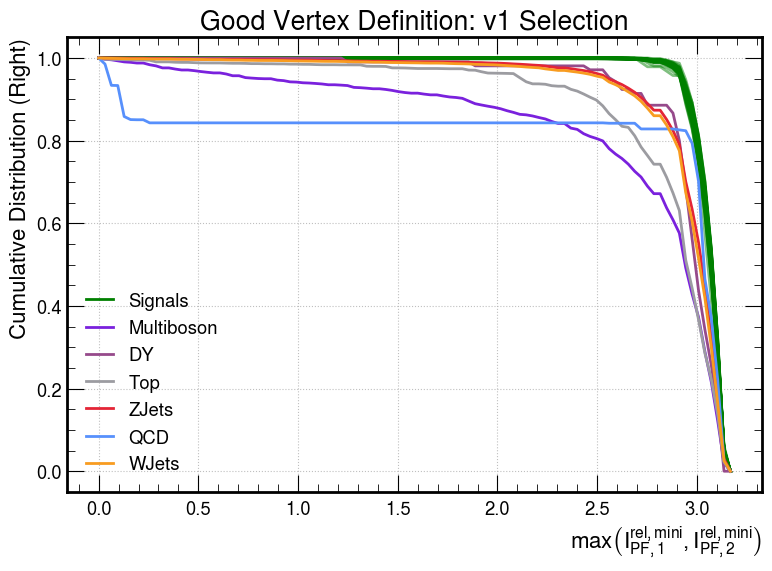

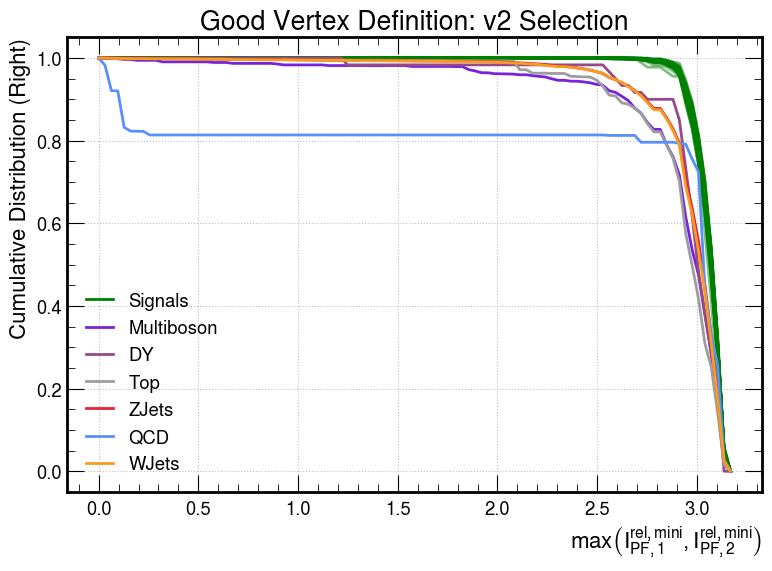

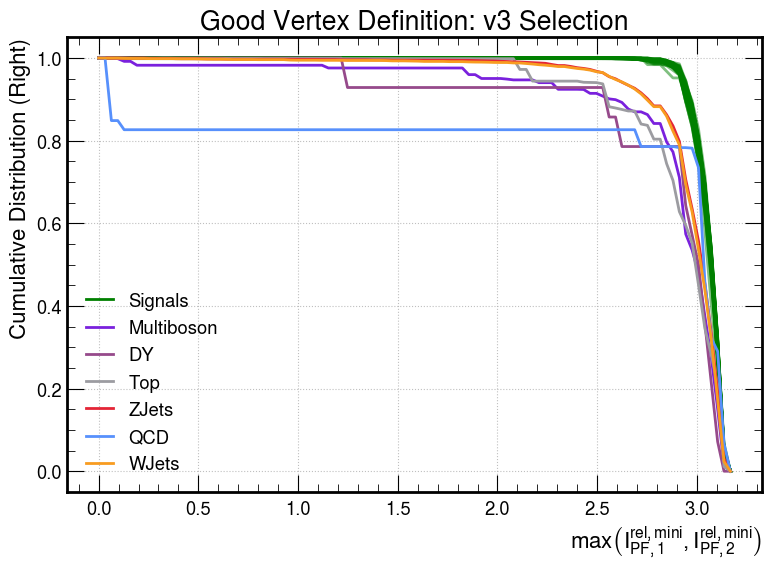

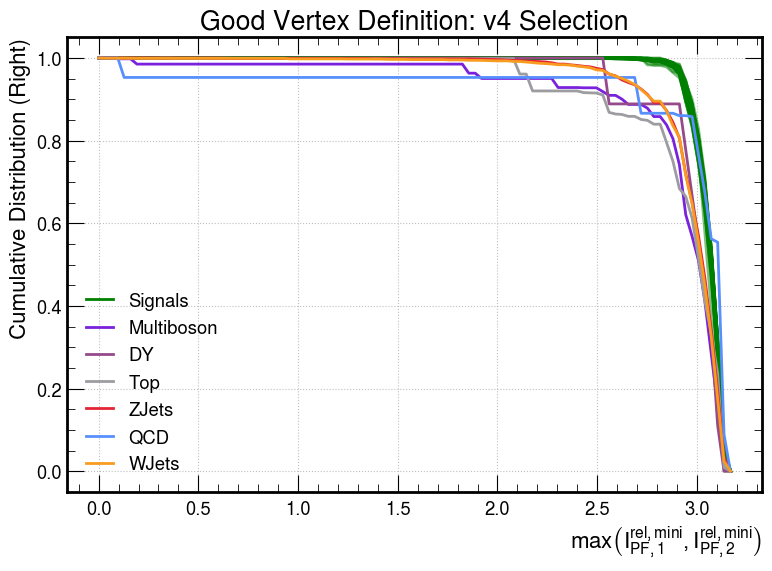

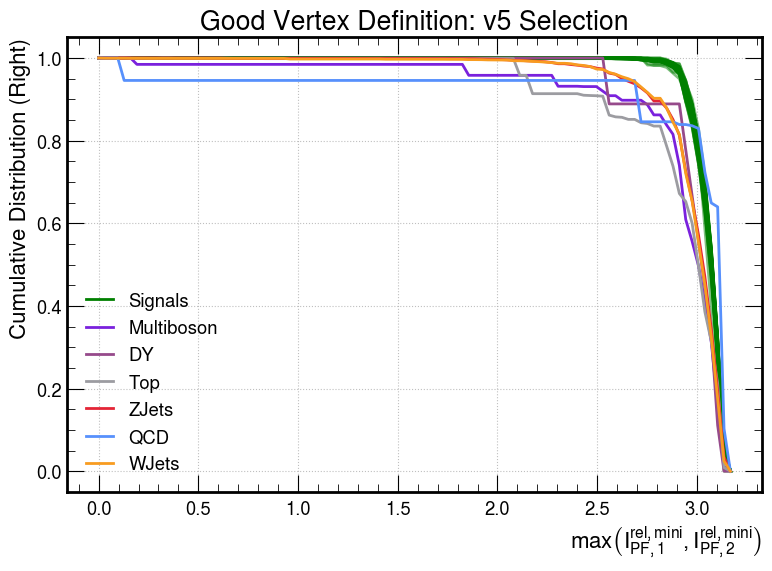

In [50]:
for cut,desc in zip(cuts,descriptions):
    selection = {"cut":cut}
    xlabel = r"$\max\left(I_{\mathrm{PF},1}^\mathrm{rel,mini},I_{\mathrm{PF},2}^\mathrm{rel,mini}\right)$"
    title = f"Good Vertex Definition: {desc}"
    ylabel = "A.U."
    hname = "jetMETdPhi"
    hname_bkg = "jetMETdPhi"
    outD = f"plots_vtxStudy/vertexSelection_cdfs/{cut}/"
    outName = "sig_vs_bkg_cdf_jetMETdPhi"+f"_{cut}"
    make_cdf_summary_sigVsBkg(dfs,hcs,hcb,hname,hname_bkg,selection,outName,outD,xlabel=xlabel,
                              save=True,show=True,right=True,title=title)

/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not placed in overflow.
  return super().__getitem__(self._index_transform(index))
/opt/conda/lib/python3.9/site-packages/hist/basehist.py:400: UserWarning: List indexing selection is experimental. Removed bins are not plac

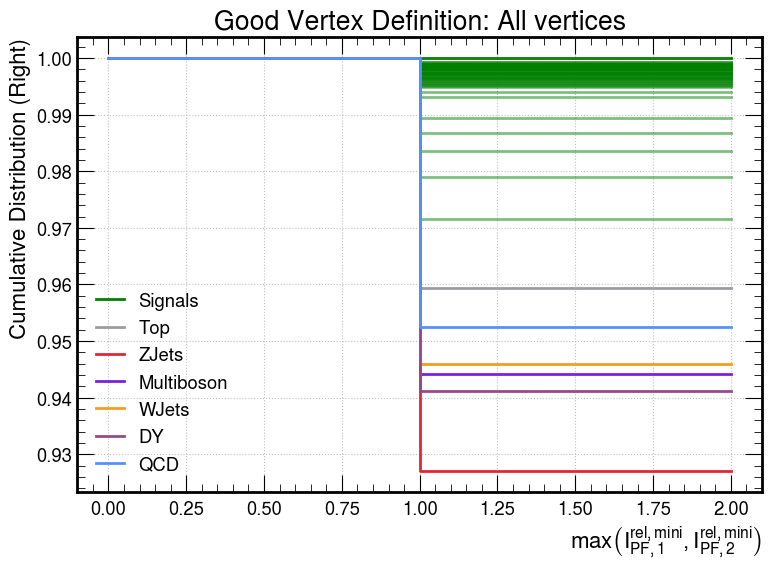

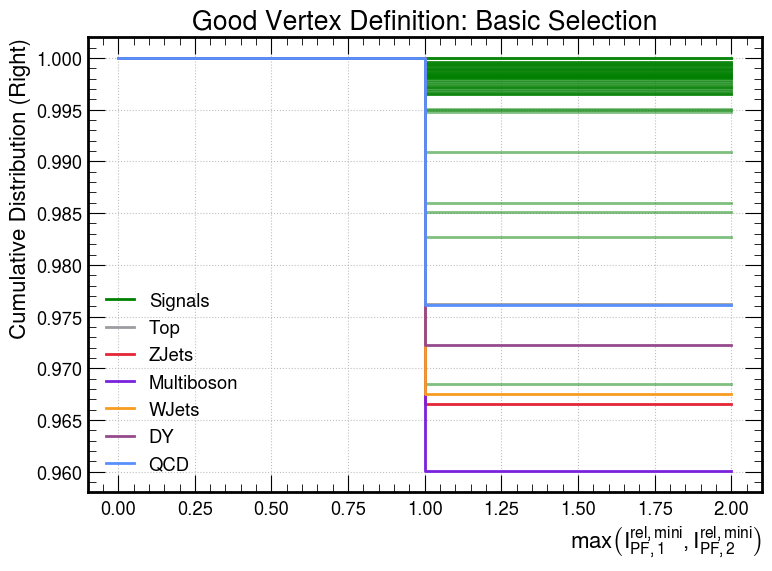

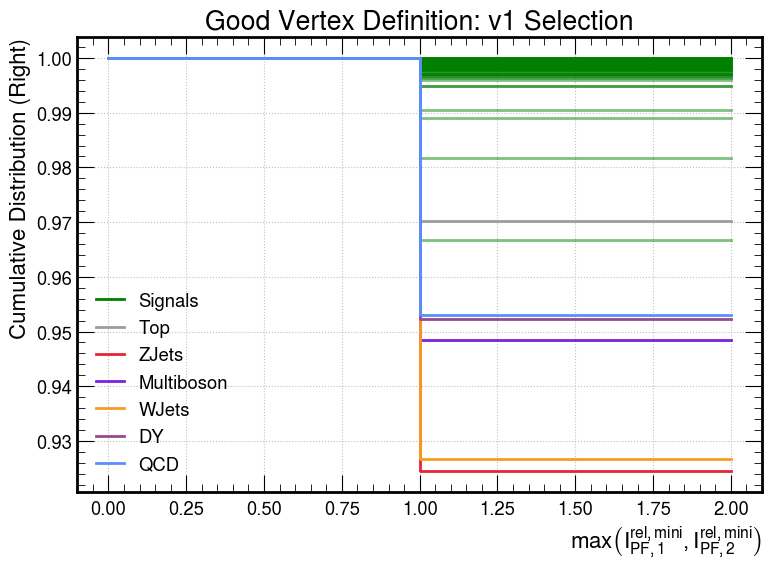

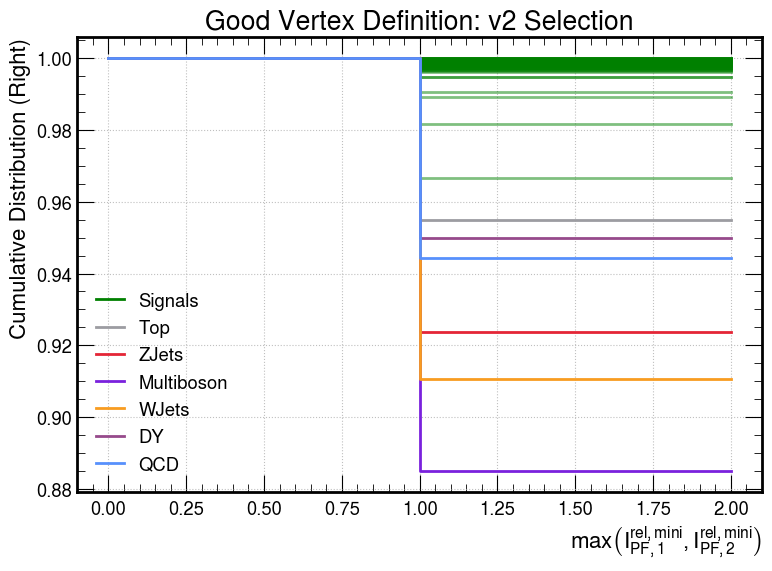

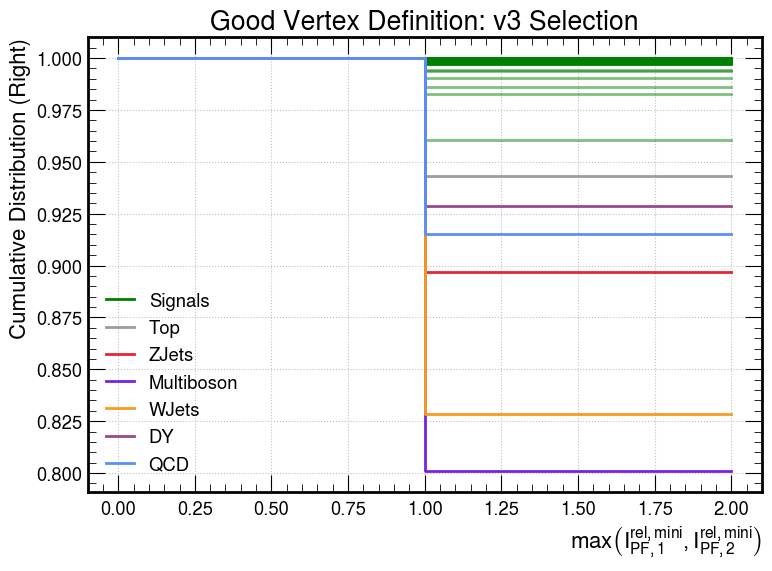

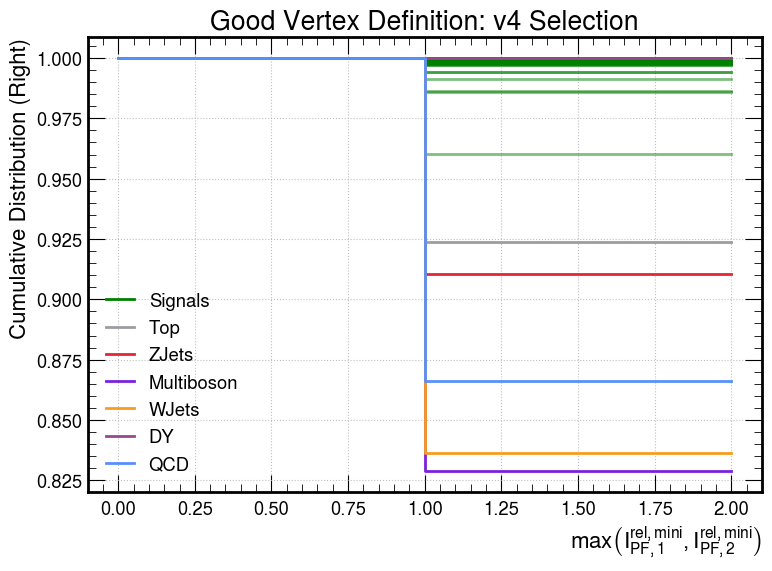

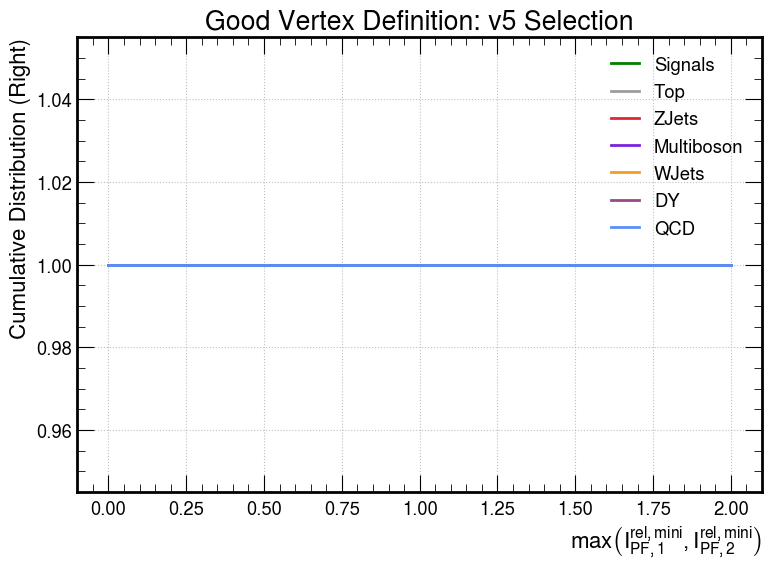

In [13]:
for cut,desc in zip(cuts,descriptions):
    selection = {"cut":cut,"vtype":sum}
    xlabel = r"$\max\left(I_{\mathrm{PF},1}^\mathrm{rel,mini},I_{\mathrm{PF},2}^\mathrm{rel,mini}\right)$"
    title = f"Good Vertex Definition: {desc}"
    ylabel = "A.U."
    hname = "match_vtx_e1e2PassConvVeto"
    hname_bkg = "sel_vtx_e1e2PassConvVeto"
    outD = f"plots_vtxStudy/vertexSelection_cdfs/{cut}/"
    outName = "matchSig_vs_bkg_cdf_e1e2PassConvVeto"+f"_{cut}"
    make_cdf_summary_sigVsBkg(dfs,hcs,hcb,hname,hname_bkg,selection,outName,outD,xlabel=xlabel,
                              save=True,show=True,right=True,title=title,category=True)

In [72]:
edges = h.axes[0].edges[:-1]
#x,eff_real = ptools.makeCDF(hsamp,edges[0],edges[-1],right=right)

In [73]:
edges

array([0., 1.])

In [75]:
h.axes[0].edges

array([0., 1., 2.])

In [76]:
h.values()

array([0.        , 5.65136188])

In [77]:
h.axes[0].centers

array([0.5, 1.5])

In [78]:
cf = hcb.load('cutflow_nevts')
for k in cf.keys():
    print(k,cf[k]['cut6'])

bkg_2018_QCD_QCD_HT300to500 0
bkg_2018_QCD_QCD_HT500to700 1
bkg_2018_Multiboson_WWW 3
bkg_2018_Multiboson_ZZZ 3
bkg_2018_QCD_QCD_HT700to1000 4
bkg_2018_QCD_QCD_HT1000to1500 3
bkg_2018_WJets_WJetsLNu_HT70to100 0
bkg_2018_Multiboson_WZZ 3
bkg_2018_Multiboson_WWZ 8
bkg_2018_QCD_QCD_HT1500to2000 7
bkg_2018_DY_DYJetsToLL 9
bkg_2018_QCD_QCD_HT2000toInf 6
bkg_2018_ZJets_ZJetsNuNu_HT2500toInf 8
bkg_2018_ZJets_ZJetsNuNu_HT1200to2500 11
bkg_2018_Multiboson_ZZ 12
bkg_2018_Top_TTJets 18
bkg_2018_Top_ST_t-channel_top 216
bkg_2018_Top_ST_tW_antitop 13
bkg_2018_Top_ST_tW_top 14
bkg_2018_Top_ST_s-channel 25
bkg_2018_Multiboson_WZ 38
bkg_2018_Top_ST_t-channel_antitop 72
bkg_2018_WJets_WJetsLNu_HT100to200 71
bkg_2018_Multiboson_WW 27
bkg_2018_ZJets_ZJetsNuNu_HT800to1200 74
bkg_2018_ZJets_ZJetsNuNu_HT100to200 152
bkg_2018_WJets_WJetsLNu_HT2500toInf 36
bkg_2018_ZJets_ZJetsNuNu_HT600to800 259
bkg_2018_WJets_WJetsLNu_HT1200to2500 108
bkg_2018_WJets_WJetsLNu_HT600to800 152
bkg_2018_WJets_WJetsLNu_HT800to1200

# Purity, yields, & significance

In [79]:
hcs = histContainer("skimmed_signal_histos_vtxStudy.coffea")
hcb = histContainer("skimmed_bkg_histos_vtxStudy.coffea",bkg=True)
dfs = utils.get_dict_fromCutflow(hcs.load('cutflow'))
dfs['legend'] = dfs.apply(make_label,axis=1)

CUT = 'cut6'

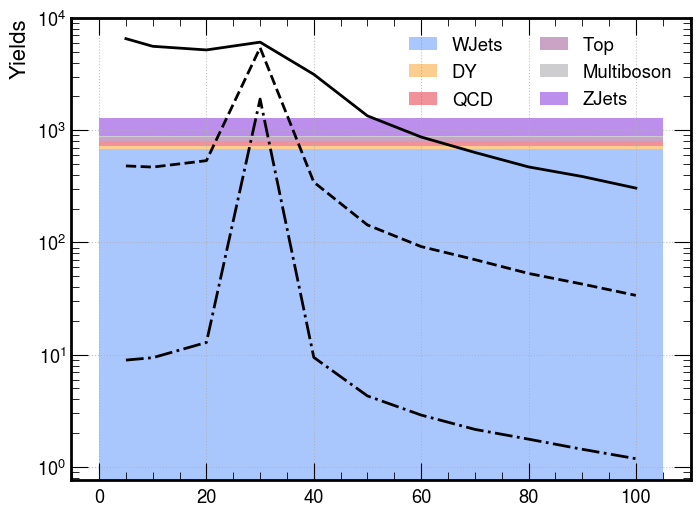

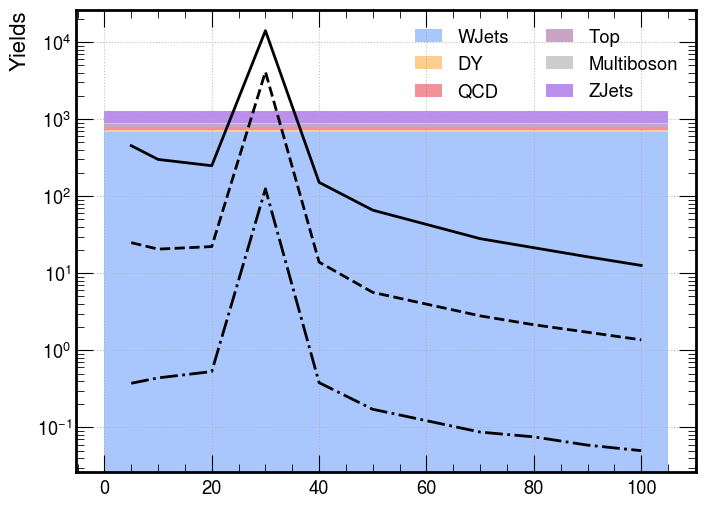

In [80]:
from matplotlib.lines import Line2D
deltas = sorted(list(set(dfs.delta)))
cfb = hcb.load('cutflow_cts')
bkg_sums = {cat:sum([cfb[k][CUT] for k in hcb.catSamps[cat]]) for cat in hcb.cats}
bkg_yields = [np.array([bkg_sums[c]]) for c in hcb.cats]
bkg_labels = hcb.cats
for delta in deltas:
    plt.figure(figsize=(8,6))
    dfsel = dfs[dfs.delta==delta]
    ctaus = sorted(list(set(dfsel.ctau)))
    linestyles = ['-','--','-.']
    ct_handles = []
    bkg_handles=hep.histplot(bkg_yields,label=bkg_labels,bins=np.array([0,105]),stack=True,histtype='fill',alpha=0.5)
    for i,ct in enumerate(ctaus):
        ct_handles.append(Line2D([],[],lw=2,linestyle=linestyles[i],label=rf"$c\tau = {ct}$ mm",color='k'))
        dfsel1 = dfsel[dfsel.ctau==ct]
        m1s = sorted(list(set(dfsel1.m1)))
        yields = []
        for m1 in m1s:
            samp = dfsel1[dfsel1.m1==m1].name.item()
            sig_yield = hcs.load('cutflow_cts')[samp][CUT]
            yields.append(sig_yield)
        plt.plot(m1s,yields,linestyle=linestyles[i],lw=2,color="k")
    #plt.ylim([0.5,1])
    plt.yscale('log')
    plt.ylabel("Yields")
    plt.grid()
    plt.legend(ncol=2)

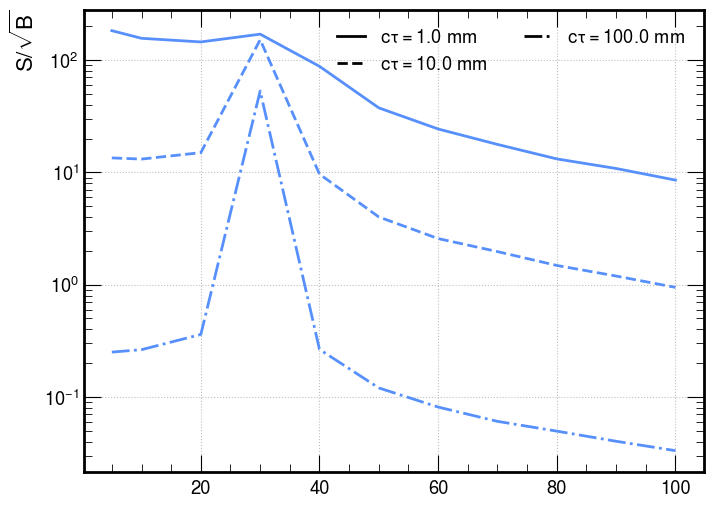

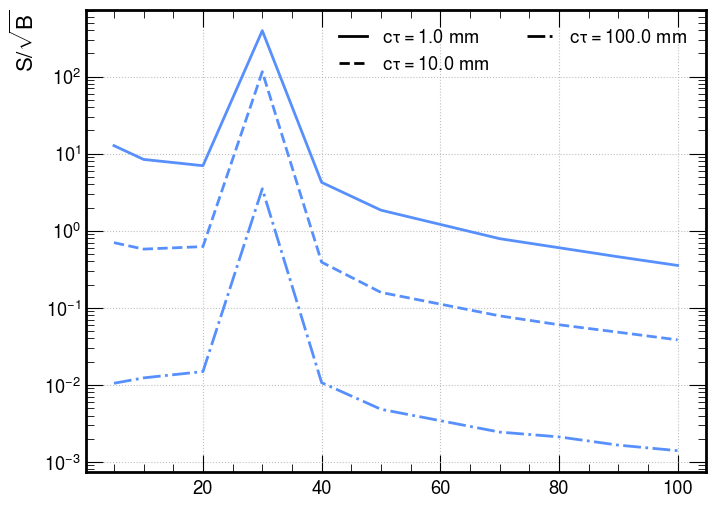

In [81]:
hcs = histContainer("skimmed_signal_histos_vtxStudy.coffea")
hcb = histContainer("skimmed_bkg_histos_vtxStudy.coffea",bkg=True)
from matplotlib.lines import Line2D
deltas = sorted(list(set(dfs.delta)))
cfb = hcb.load('cutflow_cts')
bkg_yield = sum([cfb[k][CUT] for k in cfb.keys()])
for delta in deltas:
    plt.figure(figsize=(8,6))
    dfsel = dfs[dfs.delta==delta]
    ctaus = sorted(list(set(dfsel.ctau)))
    linestyles = ['-','--','-.']
    ct_handles = []
    for i,ct in enumerate(ctaus):
        ct_handles.append(Line2D([],[],lw=2,linestyle=linestyles[i],label=rf"$c\tau = {ct}$ mm",color='k'))
        dfsel1 = dfsel[dfsel.ctau==ct]
        m1s = sorted(list(set(dfsel1.m1)))
        sOverRtB = []
        for m1 in m1s:
            samp = dfsel1[dfsel1.m1==m1].name.item()
            sig_yield = hcs.load('cutflow_cts')[samp][CUT]
            sOverRtB.append(sig_yield/np.sqrt(bkg_yield))
        plt.plot(m1s,sOverRtB,linestyle=linestyles[i],lw=2,color=f"C0")
    #plt.ylim([0.5,1])
    plt.yscale('log')
    plt.ylabel(r"$S/\sqrt{B}$")
    plt.grid()
    plt.legend(handles=ct_handles,ncol=2)